In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container {width: 95% !important; }</style>"))

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">IMPORTING LIBRARIES</p>

First I imported the libraries needed for data analytics.

In [2]:
import numpy as np
import pandas as pd
import datetime
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import colors
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt, numpy as np
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import AgglomerativeClustering
from matplotlib.colors import ListedColormap
from sklearn import metrics
import warnings
import sys
if not sys.warnoptions:
    warnings.simplefilter("ignore")
np.random.seed(42)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">LOADING DATASET</p>

In [3]:
data = pd.read_csv('C:/Users/Ivan/Desktop/Hey.car/ALL/4.from_base.csv')
data['Year of production'] = pd.to_datetime(data['Year of production'])

print("Number of datapoints:", len(data))
display(data.head(10))  
display(data.tail(10)) 

Number of datapoints: 11237


,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location
0,Volkswagen up,e-up!,2018-02-01,5,82,Electric,Automatic,14577,0.0,0,14750,Bayreuth
1,Ford Ka,Ka Black White 1.2l Klima+SHZ+Tel.Vorb. PDC+ZV,2019-05-01,4,86,Gasoline,Manual,12747,5.0,114,11530,Erbach
2,Hyundai i10,Intro,2021-01-01,2,67,Gasoline,Manual,3620,4.5,104,14998,Wölfersheim
3,Lada Kalina,Cross Luxus,2017-10-01,6,98,Gasoline,Manual,11270,6.7,154,8950,Neuss
4,Volkswagen Golf Variant,Golf Variant VII 1.0 Trendline BMT TSI Navi,2020-02-01,3,116,Gasoline,Manual,5000,4.9,113,19990,Vordorf
5,Skoda Citigo,Cool Edition,2019-03-01,4,60,Gasoline,Manual,28500,4.1,96,10880,Kreuzwertheim
6,Seat Leon,Style,2020-12-01,3,131,Gasoline,Manual,12790,5.1,117,21940,Nürnberg
7,Toyota Aygo,Aygo X 1.0 VVT-i 72 CVT ACC SmartCo Kam Klim,2023-04-01,0,72,Gasoline,Automatic,10,4.8,110,17188,Freiburg
8,Nissan Pixo,Pixo AUTOMATIK+SITZHEIZUNG+EINPARKHILFE,2011-09-01,12,68,Gasoline,Automatic,11000,5.2,122,8976,Dietztenbach
9,Fiat 500,Cult,2023-05-01,0,69,Hybrid/Gasoline,Manual,10,5.5,93,18390,Köln


,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location
11227,Polestar 2,POLESTAR 2 Standard Range Single Motor,2022-11-01,1,231,Electric,Automatic,6200,0.0,0,42950,Herne
11228,Renault Grand Scenic,Limited,2023-04-01,0,140,Gasoline,Automatic,0,6.3,136,39939,Chemnitz
11229,Opel Corsa,Corsa E 120 Jahre *CarPlay*SHZ*PDC*Klima*Lenkr...,2019-06-01,4,69,Gasoline,Manual,18889,5.6,148,12740,Dormagen
11230,Volkswagen Golf,GTE,2021-01-01,2,245,Hybrid/Gasoline,Automatic,27201,1.5,34,29980,Bendorf
11231,Volkswagen Golf Variant,Comfortline,2018-07-01,5,150,Gasoline,Automatic,90500,4.9,112,18960,Aach
11232,Volkswagen Golf,Golf VIII 2.0 TDI DSG Active AHK/NAVI/KAMERA/ACC,2022-09-01,1,150,Diesel,Automatic,9309,3.8,101,31998,Mayen
11233,Audi Q5,S line,2023-03-01,0,204,Diesel,Automatic,2601,5.4,142,65990,Aachen
11234,Volkswagen up,colour up! sandstorm yellow,2019-05-01,4,60,Gasoline,Manual,25990,4.2,95,11990,Bremerhaven
11235,Renault Clio,Business Edition,2022-09-01,1,91,Gasoline,Manual,8061,5.1,117,17990,Berlin
11236,Opel Corsa,Corsa,2022-03-01,1,101,Gasoline,Manual,6329,5.3,123,18440,Berlin


In [ ]:
#To remove the "Hybrid/Diesel" category from the "Fuel type"
data = data[data['Fuel type'] != 'Hybrid/Diesel']

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">EXPLORING AND UNDERSTANDING THE DATASET</p>

At the beginning, after importing the data I tried to explore and understand the data to get meaningful insights.

In [6]:
data.shape

(11237, 12)

In [7]:
data.dtypes

Model                                         object
Edition                                       object
Year of production                    datetime64[ns]
Age(years)                                     int64
Power(hp)                                      int64
Fuel type                                     object
Gearbox                                       object
Mileage(km)                                    int64
Fuel consumption (l/100km - comb.)           float64
CO2 emissions (g CO2/km - comb.)               int64
Price(€)                                       int64
Location                                      object
dtype: object

In [8]:
data.describe()

,Age(years),Power(hp),Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€)
count,11237.00000,11237.000000,11237.000000,11237.000000,11237.000000,11237.000000
mean,1.87995,121.020201,17101.676070,4.599486,105.593219,24912.219632
std,2.11647,52.436057,26286.442247,2.584382,43.433777,14366.926331
min,0.00000,3.000000,0.000000,0.000000,0.000000,1150.000000
25%,0.00000,91.000000,15.000000,4.300000,103.000000,17876.000000
50%,1.00000,110.000000,9000.000000,4.900000,113.000000,22548.000000
75%,3.00000,140.000000,22328.000000,5.400000,125.000000,27700.000000
max,23.00000,680.000000,565317.000000,66.700000,366.000000,285900.000000


In [9]:
data.isnull().sum()

Model                                   0
Edition                               550
Year of production                      0
Age(years)                              0
Power(hp)                               0
Fuel type                               0
Gearbox                                 0
Mileage(km)                             0
Fuel consumption (l/100km - comb.)      0
CO2 emissions (g CO2/km - comb.)        0
Price(€)                                0
Location                                0
dtype: int64

In [10]:
data.columns

Index(['Model', 'Edition', 'Year of production', 'Age(years)', 'Power(hp)',
       'Fuel type', 'Gearbox', 'Mileage(km)',
       'Fuel consumption (l/100km - comb.)',
       'CO2 emissions (g CO2/km - comb.)', 'Price(€)', 'Location'],
      dtype='object')

In [11]:
data.nunique()

Model                                  406
Edition                               4516
Year of production                     169
Age(years)                              21
Power(hp)                              179
Fuel type                                8
Gearbox                                  2
Mileage(km)                           5731
Fuel consumption (l/100km - comb.)     124
CO2 emissions (g CO2/km - comb.)       221
Price(€)                              3730
Location                               903
dtype: int64

In [12]:
data['Model'].unique()

array(['Volkswagen up', 'Ford Ka', 'Hyundai i10', 'Lada Kalina',
       'Volkswagen Golf Variant', 'Skoda Citigo', 'Seat Leon',
       'Toyota Aygo', 'Nissan Pixo', 'Fiat 500', 'Seat Ibiza',
       'Seat Arona', 'Renault Clio', 'Kia Picanto', 'Volkswagen Polo',
       'Dacia Sandero', 'Volkswagen Touran', 'MINI One',
       'Ford Transit Courier', 'Skoda Fabia', 'Mitsubishi Space Star',
       'Dacia Spring', 'Volkswagen Golf', 'Skoda Kamiq', 'Ford Fiesta',
       'Kia Rio', 'Opel Corsa', 'smart EQ fortwo', 'Renault Captur',
       'Dacia Jogger', 'Volkswagen T-Cross', 'Fiat 500E', 'Ford B-Max',
       'Dacia Duster', 'Peugeot 108', 'Skoda Octavia', 'Suzuki Vitara',
       'Ford Focus', 'Citroën C1', 'Nissan Micra', 'Fiat 500C',
       'Opel Crossland X', 'Toyota Yaris', 'Citroën C3', 'Renault ZOE',
       'Renault Twingo', 'smart ForFour', 'Ford EcoSport',
       'Volkswagen T-Roc Cabriolet', 'Ford Puma', 'Seat Ateca', 'Mazda 2',
       'smart ForTwo', 'Dacia Lodgy', 'Opel Mokka', 'Su

In [13]:
data['Age(years)'].unique()

array([ 5,  4,  2,  6,  3,  0, 12,  1,  8,  7, 16, 18, 15, 14,  9, 10, 13,
       17, 11, 23, 21], dtype=int64)

In [14]:
data['Gearbox'].unique()

array(['Automatic', 'Manual'], dtype=object)

In [15]:
data['Fuel type'].unique()

array(['Electric', 'Gasoline', 'Hybrid/Gasoline', 'Diesel', 'LPG', 'CNG',
       'Others', 'Hybrid/Diesel'], dtype=object)

In [16]:
data['Fuel consumption (l/100km - comb.)'].unique()

array([ 0.  ,  5.  ,  4.5 ,  6.7 ,  4.9 ,  4.1 ,  5.1 ,  4.8 ,  5.2 ,
        5.5 ,  4.  ,  4.2 ,  4.3 ,  4.7 ,  5.6 ,  5.4 ,  4.4 ,  7.  ,
        5.7 ,  1.4 ,  3.7 ,  4.6 ,  5.9 ,  5.8 ,  3.8 ,  3.4 ,  5.3 ,
        7.8 ,  6.  ,  3.5 , 66.7 ,  2.8 ,  2.9 ,  6.6 ,  6.3 ,  1.5 ,
        6.4 ,  7.1 ,  3.  ,  1.2 ,  3.2 ,  6.5 ,  7.7 ,  6.1 ,  6.2 ,
        3.9 ,  7.4 ,  3.3 ,  6.8 ,  3.6 , 62.5 ,  6.9 ,  7.2 ,  1.6 ,
        7.6 ,  8.5 ,  1.1 ,  1.3 ,  8.8 ,  8.7 ,  1.7 ,  7.3 , 12.  ,
       12.5 ,  8.  ,  9.3 ,  8.1 , 43.  ,  1.8 ,  9.9 ,  9.7 ,  1.9 ,
        5.43,  7.5 , 12.7 , 13.8 ,  8.6 , 13.6 ,  9.8 ,  8.2 ,  8.9 ,
        9.4 ,  8.3 , 10.2 ,  8.4 ,  9.  ,  7.07, 11.3 ,  9.1 ,  6.34,
        2.  , 63.  ,  3.1 , 12.3 , 14.  , 11.8 , 11.2 ,  7.9 ,  1.  ,
       14.9 , 10.5 ,  2.6 , 10.8 , 11.5 , 10.4 ,  9.5 , 12.6 , 49.  ,
        4.96, 15.4 ,  6.26,  9.6 , 13.3 , 12.2 , 56.  ,  9.2 , 10.3 ,
        6.05,  4.74, 10.  , 10.1 ,  4.87, 10.7 ,  2.5 ])

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">CORRELATION MATRIX OF DATASET</p>

I used correlation matrix of a dataset to determine how each variable in the dataset is related to every other variable. E.g. in my hey.car dataset price and power are positively correlated, while price and mileage are negatively correlated.

<Axes: >

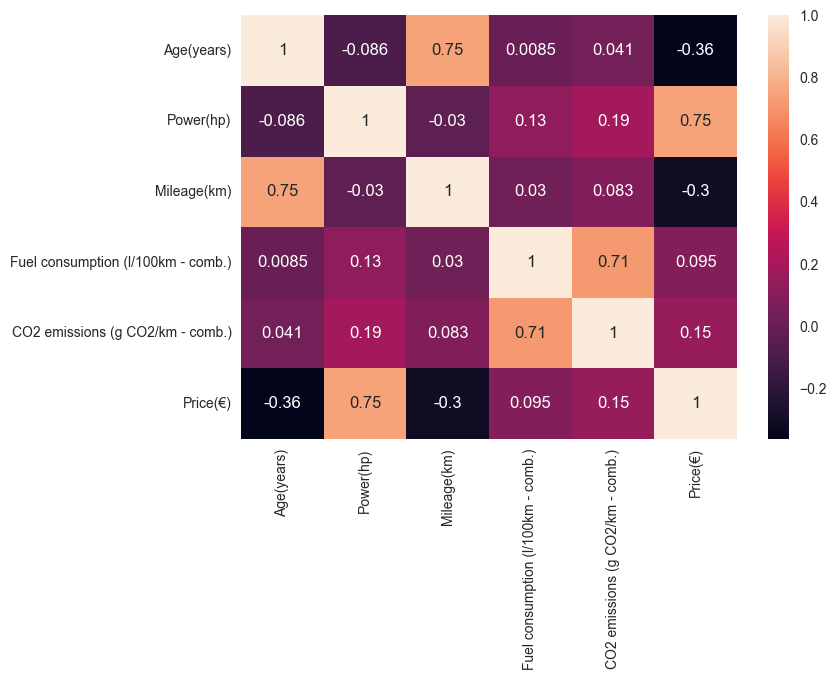

In [17]:
corelation = data.corr()
sns.heatmap(corelation, xticklabels=corelation.columns, yticklabels=corelation.columns
            ,annot=True)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">To check distribution-Skewness</p>

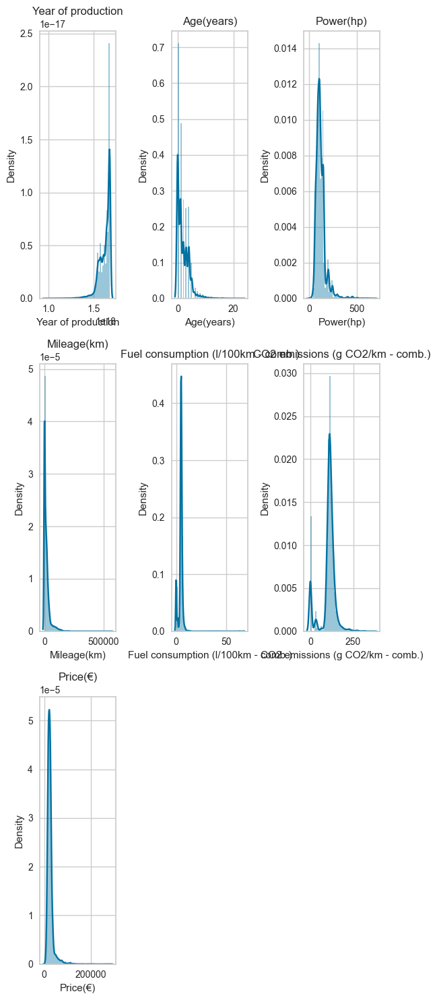

In [9]:

# Define the list of column names to plot
columns_to_plot = [ 'Year of production', 'Age(years)', 'Power(hp)', 'Mileage(km)',
       'Fuel consumption (l/100km - comb.)',
       'CO2 emissions (g CO2/km - comb.)', 'Price(€)']

# Calculate the number of columns and rows based on the number of variables
number_of_columns = int(np.ceil(np.sqrt(len(columns_to_plot))))
number_of_rows = int(np.ceil(len(columns_to_plot) / number_of_columns))

# Create a figure with subplots for each variable
plt.figure(figsize=(2 * number_of_columns, 5 * number_of_rows))

# Plot the distribution-skewness for each column
for i, column in enumerate(columns_to_plot):
    plt.subplot(number_of_rows, number_of_columns, i+1)
    sns.distplot(data[column], kde=True)
    plt.title(column)

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">VISUALIZING DISTRIBUTION OF VARIABLES</p>

With pairplot I visualized the relationships between numerical variables. With histogram, I explored the shape of data and the frequency of individual variables. Both showed outliers.

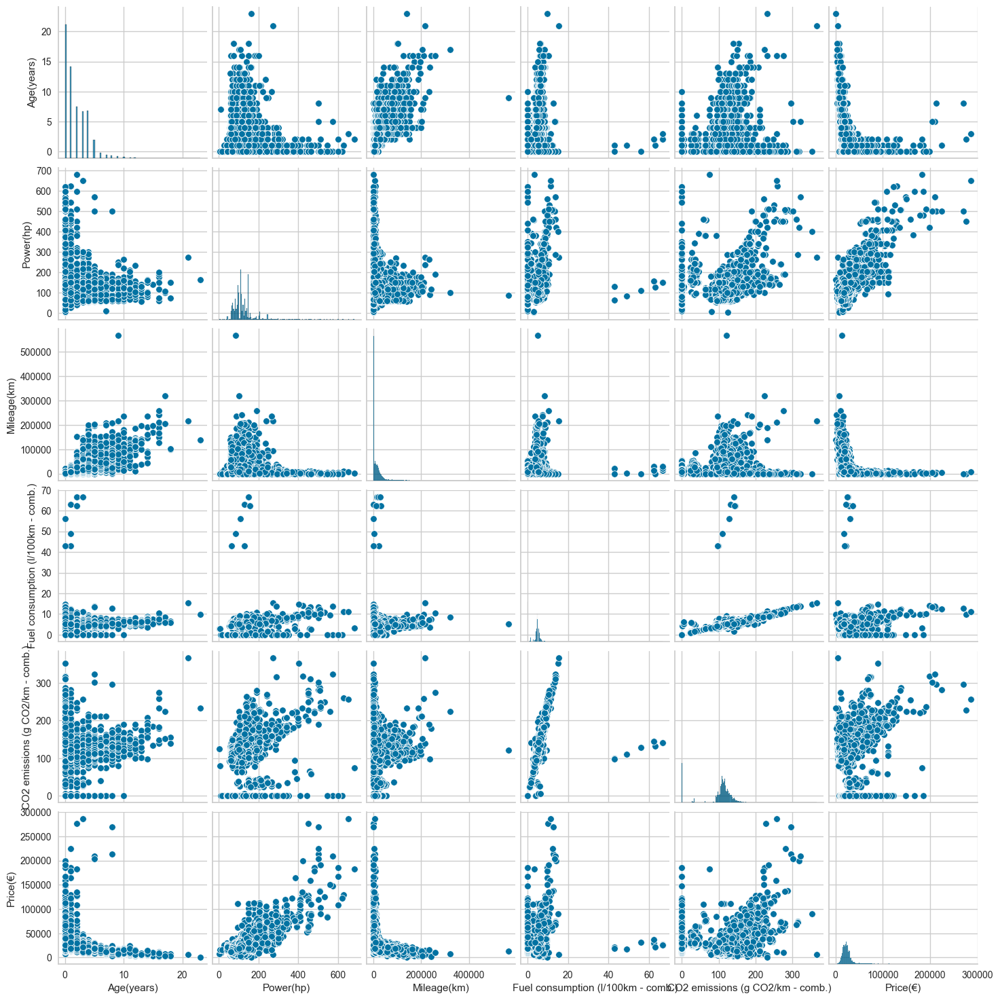

In [18]:
sns.pairplot(data)

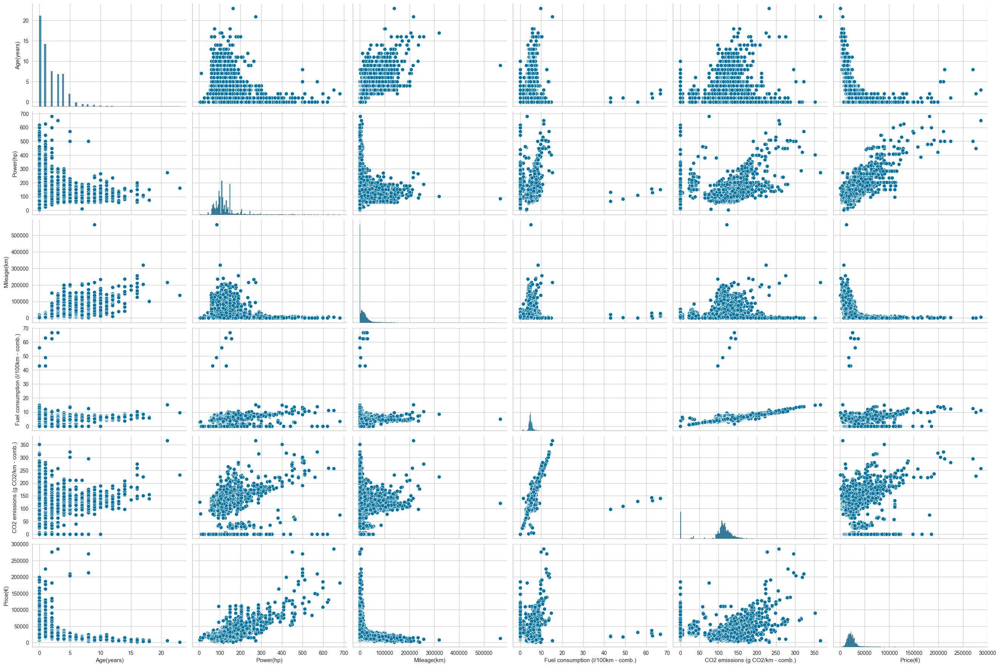

In [19]:
sns.pairplot(data, height=3, aspect=1.5)

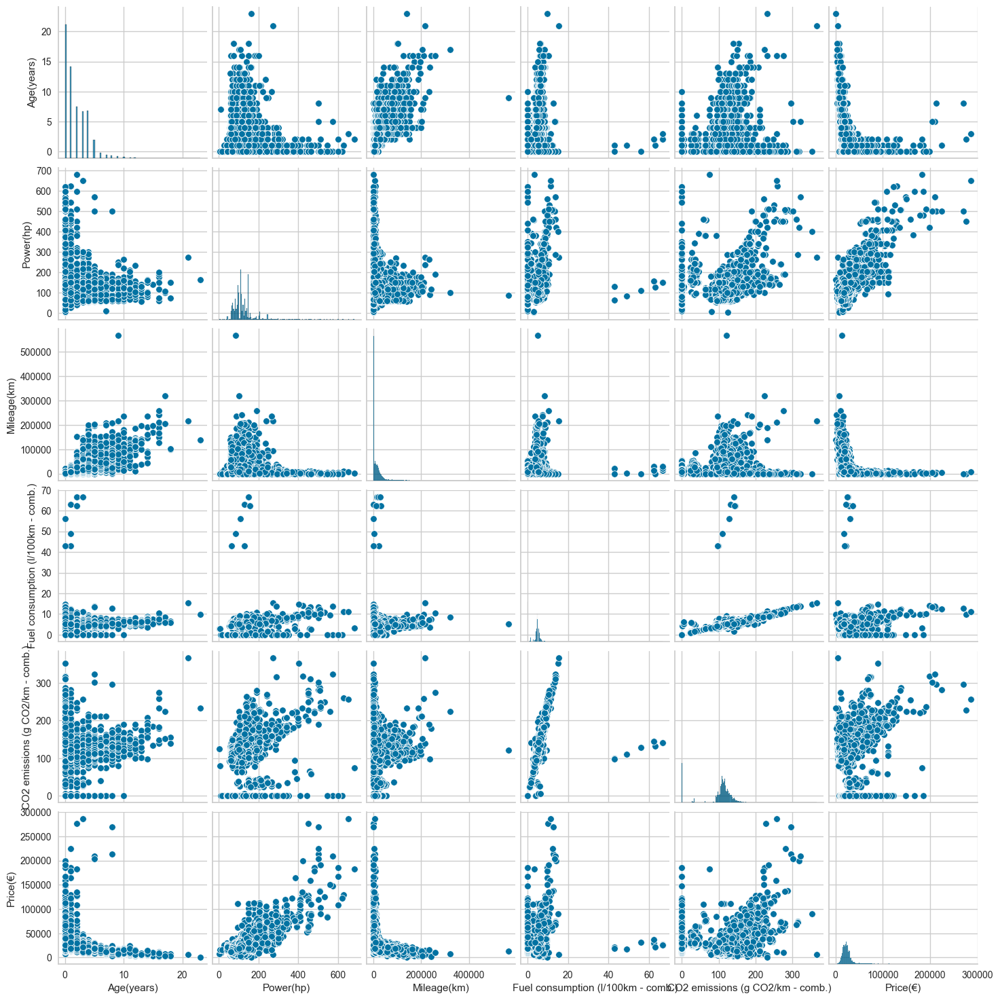

In [20]:
# Select the numerical columns you want to include in the plot
numerical_columns = ['Age(years)', 'Power(hp)', 'Mileage(km)', 'Fuel consumption (l/100km - comb.)', 'CO2 emissions (g CO2/km - comb.)', 'Price(€)']

# Create a DataFrame with only the selected numerical columns
numerical_data = data[numerical_columns]

# Generate the pairplot for all combinations of numerical columns
sns.pairplot(numerical_data)

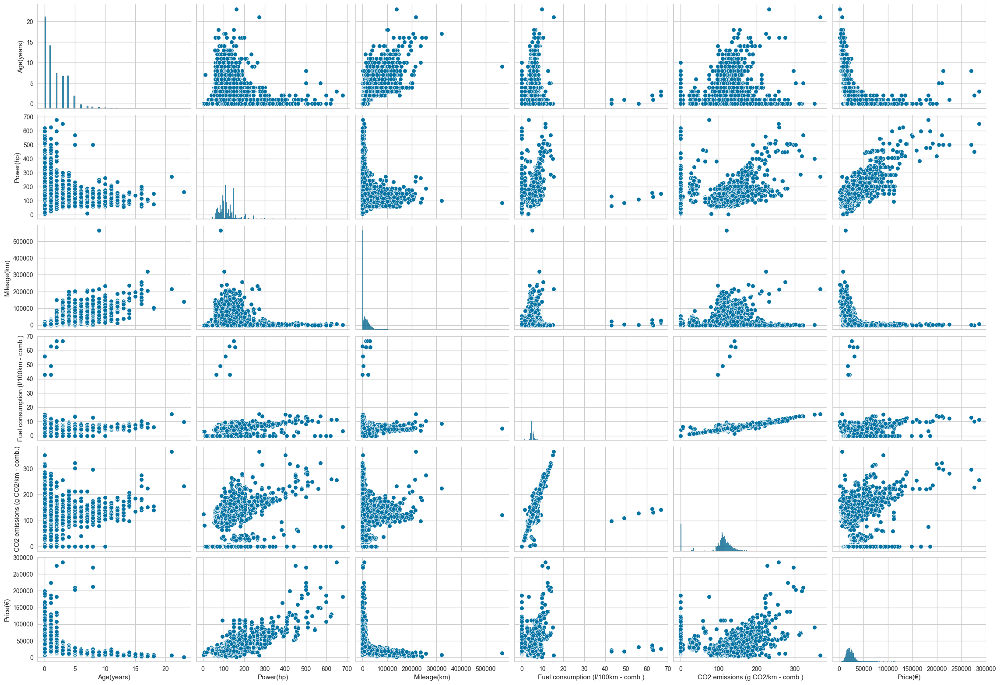

In [21]:
# Select the numerical columns you want to include in the plot
numerical_columns = ['Age(years)', 'Power(hp)', 'Mileage(km)', 'Fuel consumption (l/100km - comb.)', 'CO2 emissions (g CO2/km - comb.)', 'Price(€)']

# Create a DataFrame with only the selected numerical columns
numerical_data = data[numerical_columns]

# Generate the pairplot for all combinations of numerical columns
plot = sns.pairplot(numerical_data)

# Adjust the figure size
plot.fig.set_size_inches(24, 16)

# Rotate the x-axis labels
plt.xticks(rotation=45)

# Show the plot
plt.show()

In [22]:
# List of numerical columns
columns = ['Age(years)', 'Power(hp)', 'Mileage(km)', 'Fuel consumption (l/100km - comb.)',
           'CO2 emissions (g CO2/km - comb.)', 'Price(€)']

# Generate separate sns.relplot codes for each combination
for x_column in columns:
    for y_column in columns:
        if x_column != y_column:
            code = "sns.relplot(x='{}', y='{}', hue='Price(€)', data=data)".format(x_column, y_column)
            print(code)

sns.relplot(x='Age(years)', y='Power(hp)', hue='Price(€)', data=data)
sns.relplot(x='Age(years)', y='Mileage(km)', hue='Price(€)', data=data)
sns.relplot(x='Age(years)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)
sns.relplot(x='Age(years)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)
sns.relplot(x='Age(years)', y='Price(€)', hue='Price(€)', data=data)
sns.relplot(x='Power(hp)', y='Age(years)', hue='Price(€)', data=data)
sns.relplot(x='Power(hp)', y='Mileage(km)', hue='Price(€)', data=data)
sns.relplot(x='Power(hp)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)
sns.relplot(x='Power(hp)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)
sns.relplot(x='Power(hp)', y='Price(€)', hue='Price(€)', data=data)
sns.relplot(x='Mileage(km)', y='Age(years)', hue='Price(€)', data=data)
sns.relplot(x='Mileage(km)', y='Power(hp)', hue='Price(€)', data=data)
sns.relplot(x='Mileage(km)', y='Fuel consumption (l/100km - com

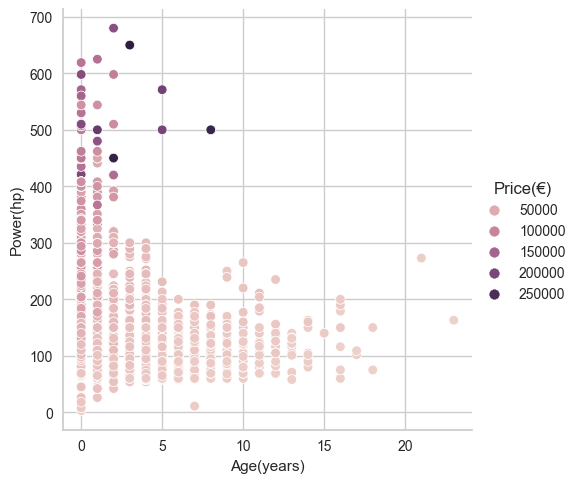

In [23]:
sns.relplot(x='Age(years)', y='Power(hp)', hue='Price(€)', data=data)

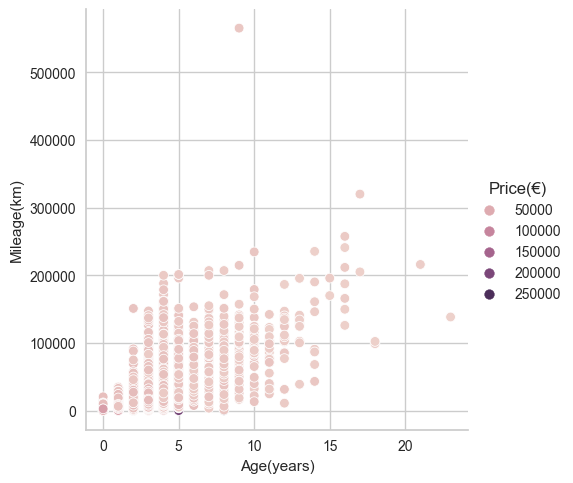

In [24]:
sns.relplot(x='Age(years)', y='Mileage(km)', hue='Price(€)', data=data)

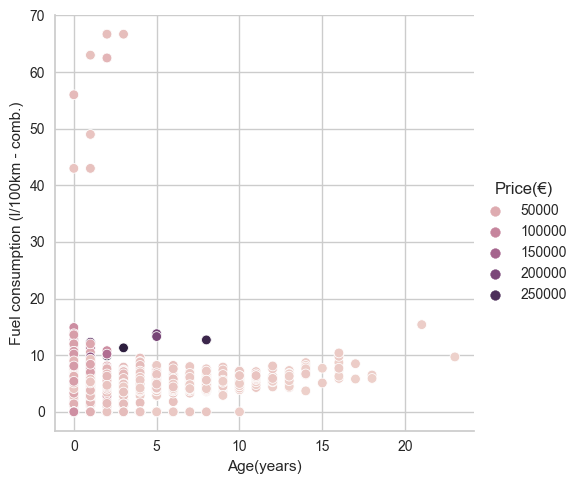

In [25]:
sns.relplot(x='Age(years)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)

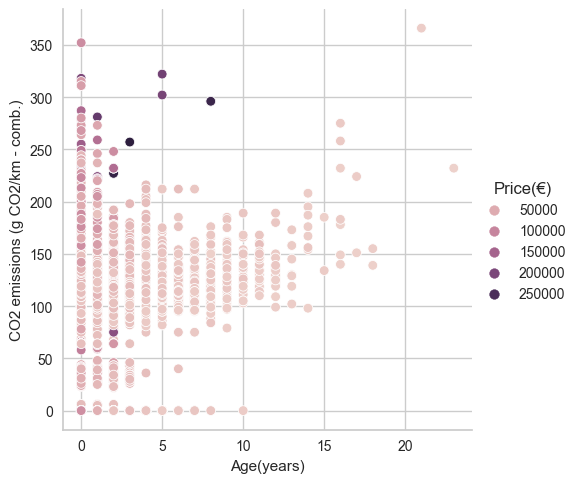

In [26]:
sns.relplot(x='Age(years)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)

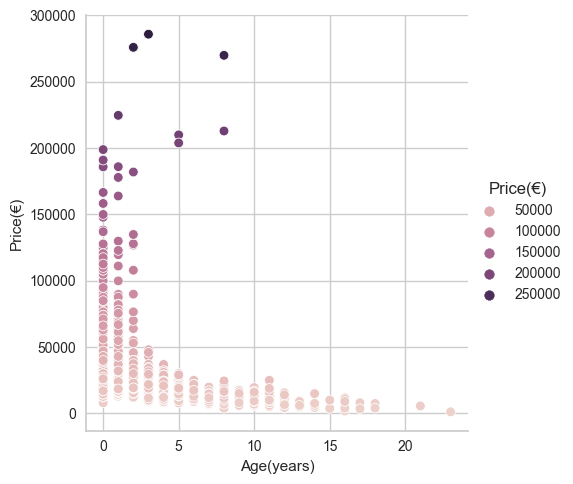

In [27]:
sns.relplot(x='Age(years)', y='Price(€)', hue='Price(€)', data=data)

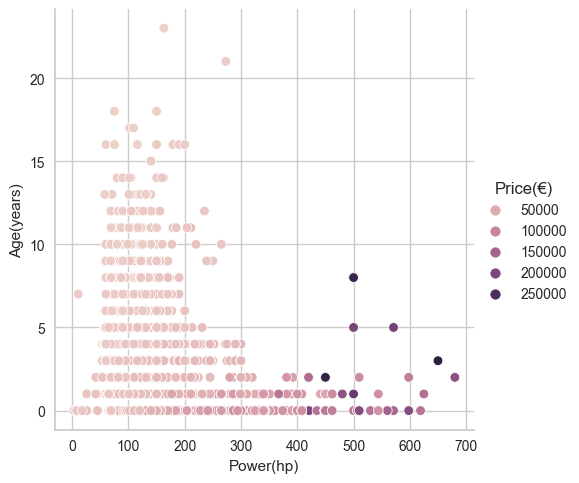

In [28]:
sns.relplot(x='Power(hp)', y='Age(years)', hue='Price(€)', data=data)

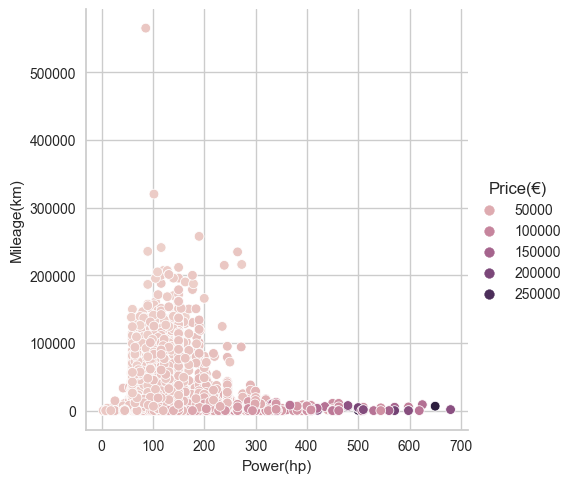

In [29]:
sns.relplot(x='Power(hp)', y='Mileage(km)', hue='Price(€)', data=data)

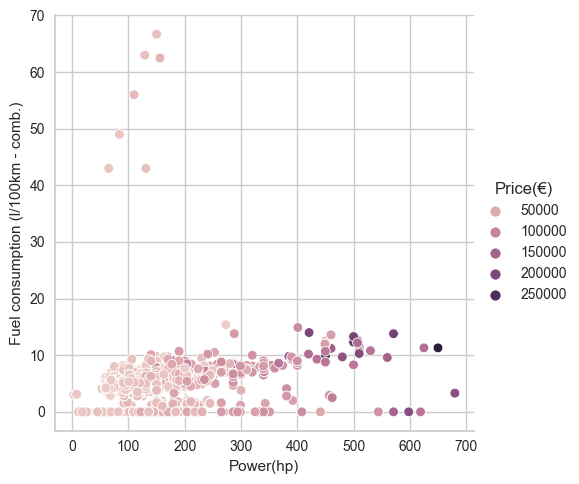

In [30]:
sns.relplot(x='Power(hp)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)

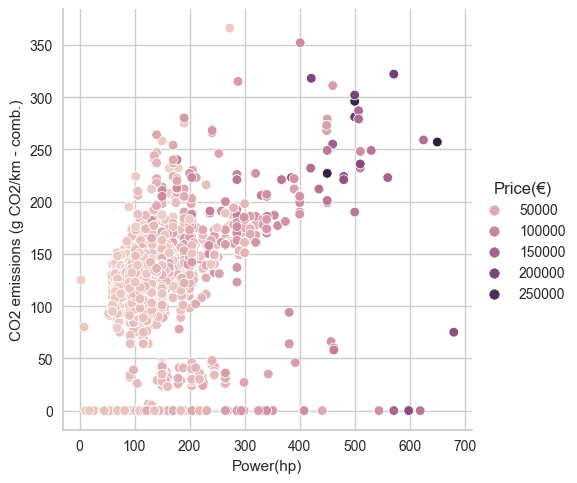

In [31]:
sns.relplot(x='Power(hp)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)

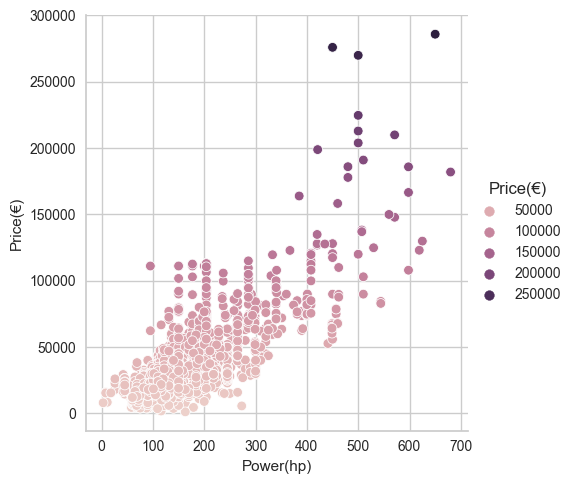

In [32]:
sns.relplot(x='Power(hp)', y='Price(€)', hue='Price(€)', data=data)


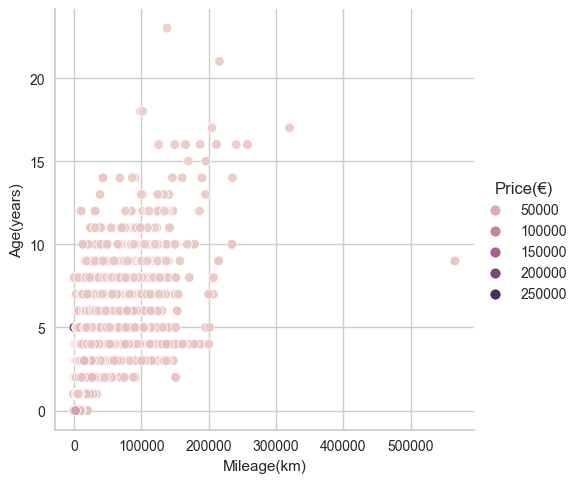

In [33]:
sns.relplot(x='Mileage(km)', y='Age(years)', hue='Price(€)', data=data)

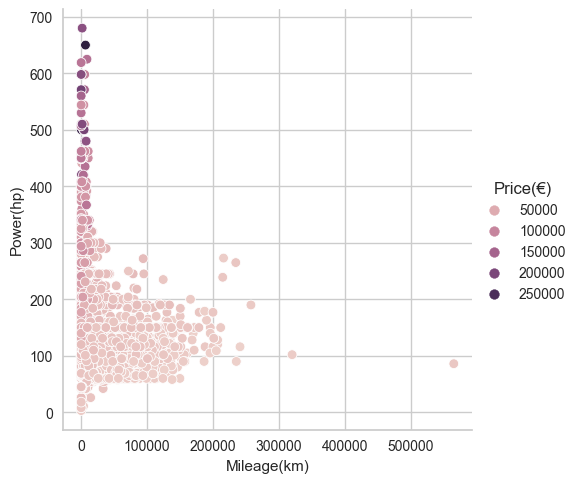

In [34]:
sns.relplot(x='Mileage(km)', y='Power(hp)', hue='Price(€)', data=data)

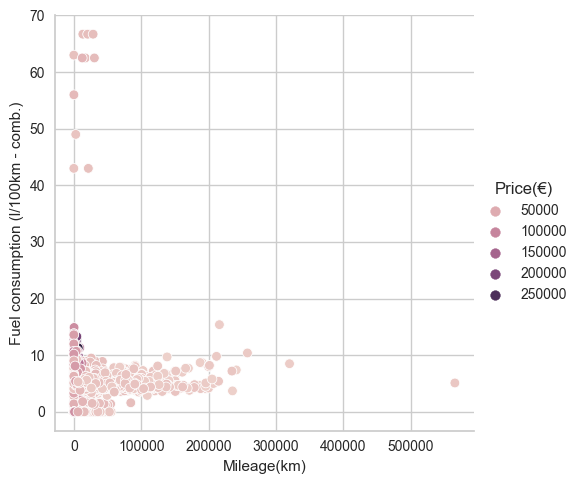

In [35]:
sns.relplot(x='Mileage(km)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)



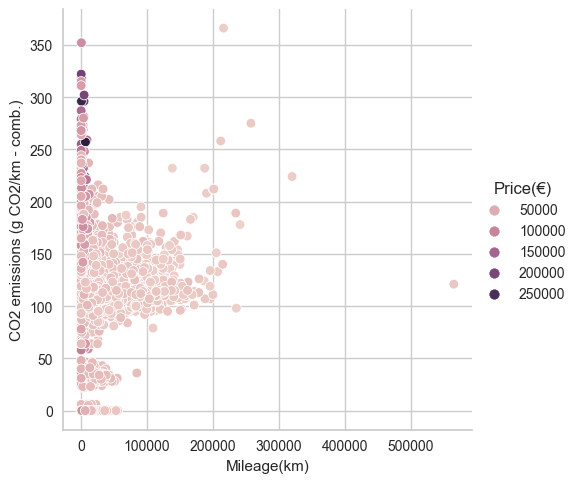

In [36]:
sns.relplot(x='Mileage(km)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)

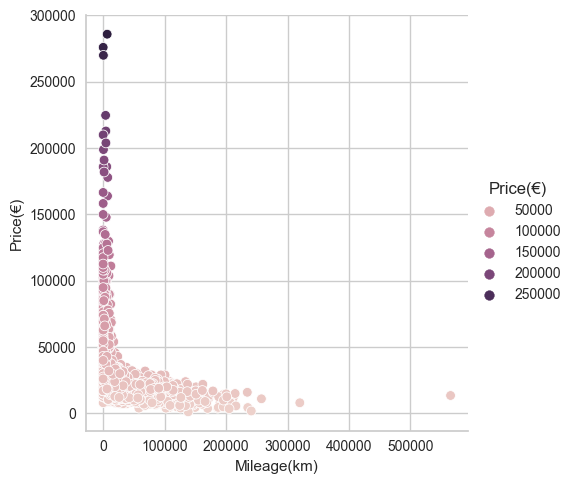

In [37]:
sns.relplot(x='Mileage(km)', y='Price(€)', hue='Price(€)', data=data)

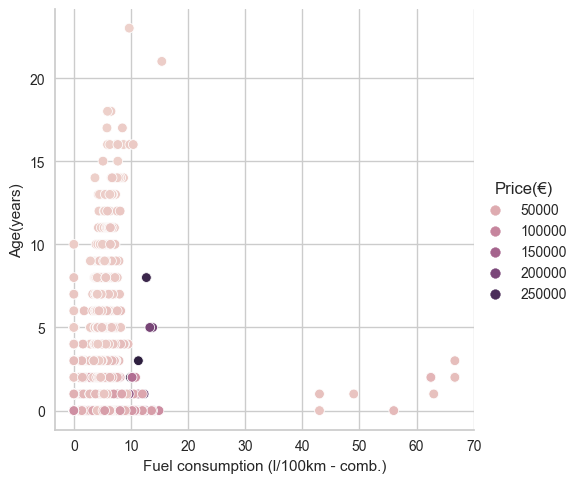

In [38]:
sns.relplot(x='Fuel consumption (l/100km - comb.)', y='Age(years)', hue='Price(€)', data=data)

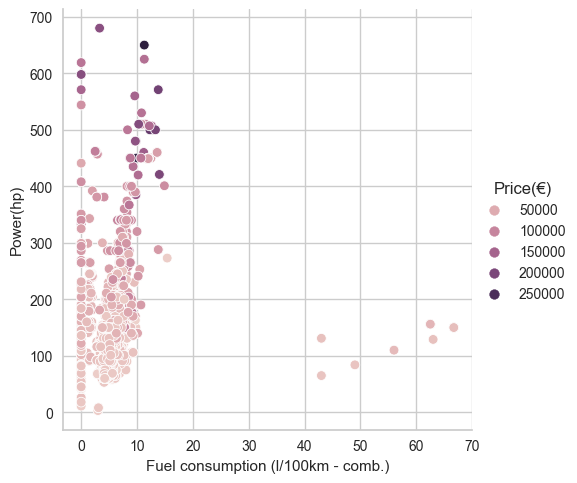

In [39]:
sns.relplot(x='Fuel consumption (l/100km - comb.)', y='Power(hp)', hue='Price(€)', data=data)

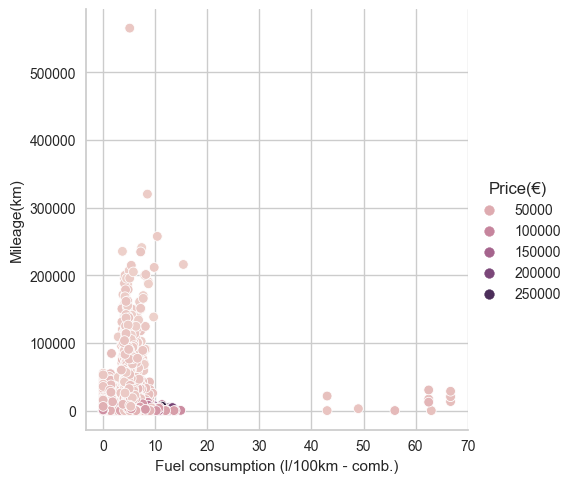

In [40]:
sns.relplot(x='Fuel consumption (l/100km - comb.)', y='Mileage(km)', hue='Price(€)', data=data)

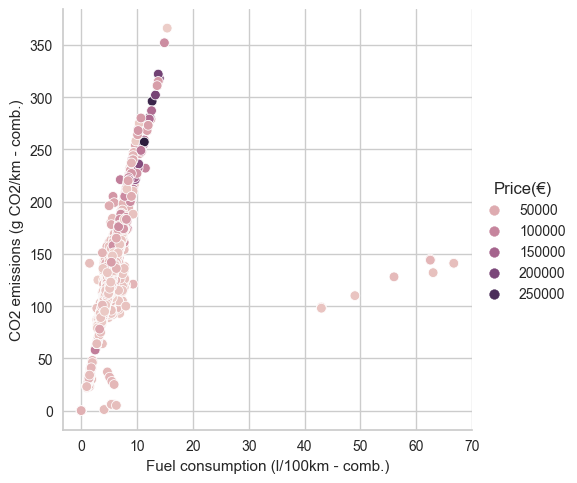

In [41]:
sns.relplot(x='Fuel consumption (l/100km - comb.)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)

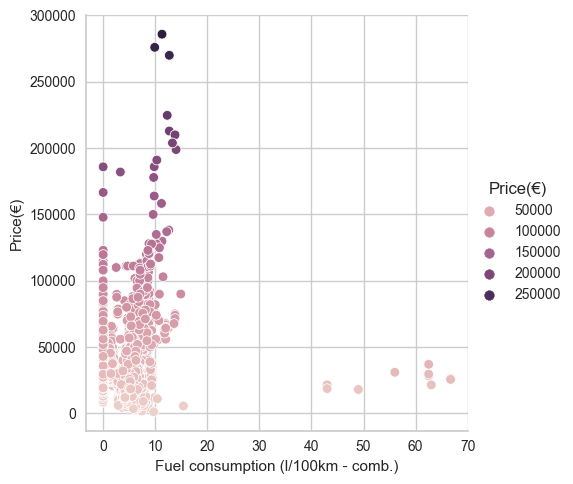

In [42]:
sns.relplot(x='Fuel consumption (l/100km - comb.)', y='Price(€)', hue='Price(€)', data=data)

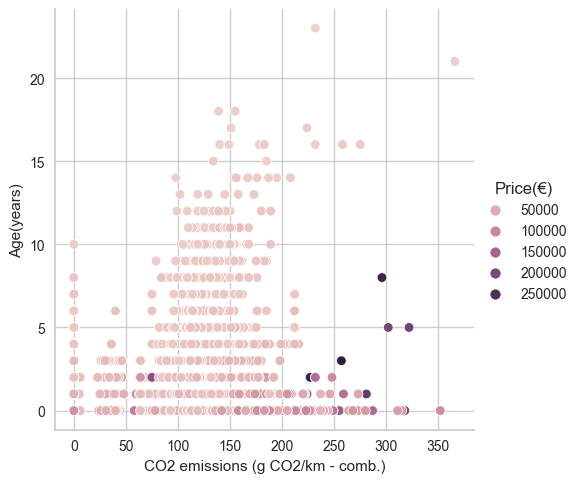

In [43]:
sns.relplot(x='CO2 emissions (g CO2/km - comb.)', y='Age(years)', hue='Price(€)', data=data)

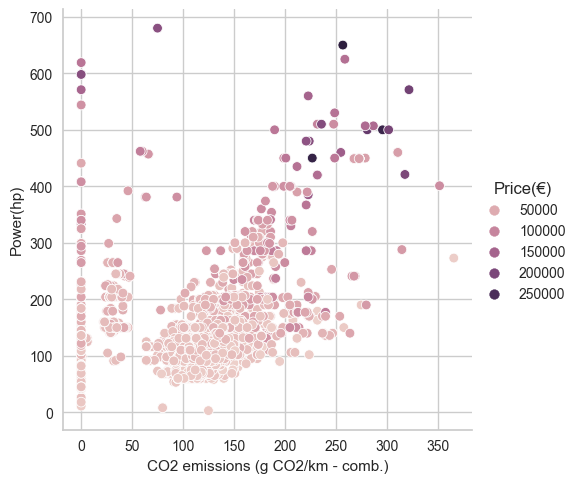

In [44]:
sns.relplot(x='CO2 emissions (g CO2/km - comb.)', y='Power(hp)', hue='Price(€)', data=data)

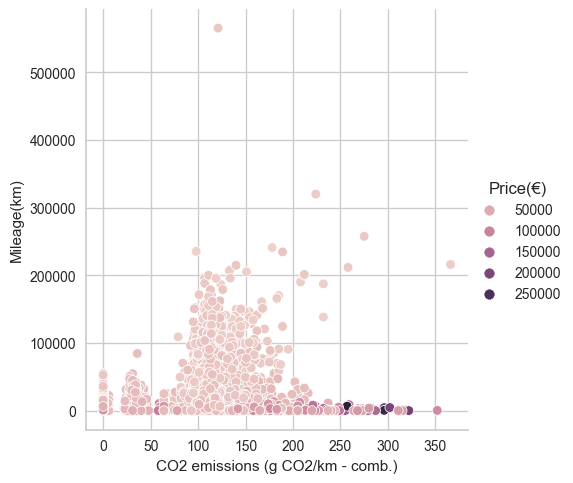

In [45]:
sns.relplot(x='CO2 emissions (g CO2/km - comb.)', y='Mileage(km)', hue='Price(€)', data=data)

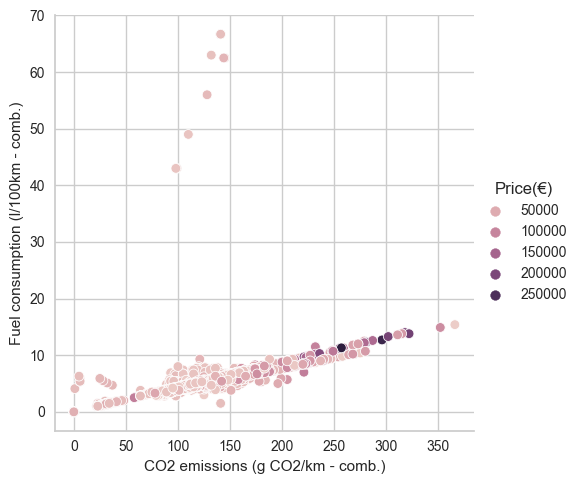

In [46]:
sns.relplot(x='CO2 emissions (g CO2/km - comb.)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)

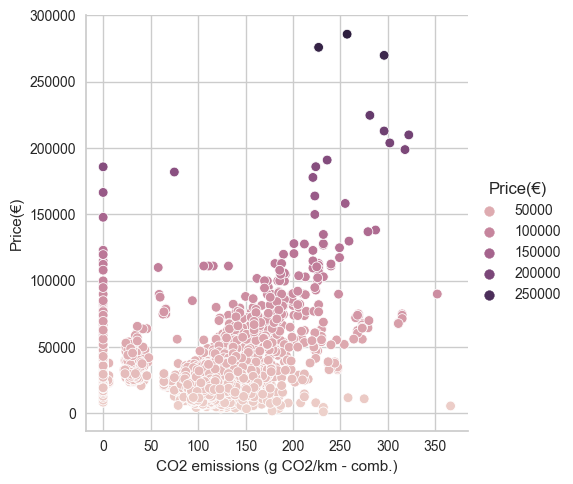

In [47]:
sns.relplot(x='CO2 emissions (g CO2/km - comb.)', y='Price(€)', hue='Price(€)', data=data)

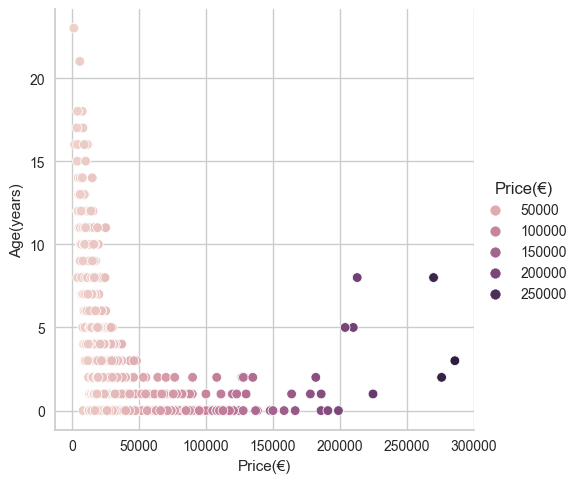

In [48]:
sns.relplot(x='Price(€)', y='Age(years)', hue='Price(€)', data=data)

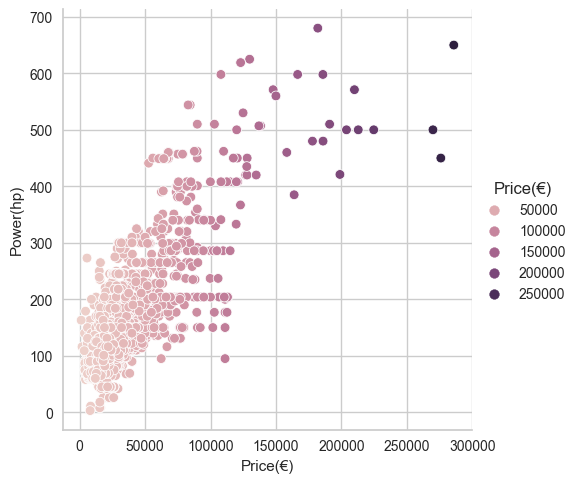

In [49]:
sns.relplot(x='Price(€)', y='Power(hp)', hue='Price(€)', data=data)

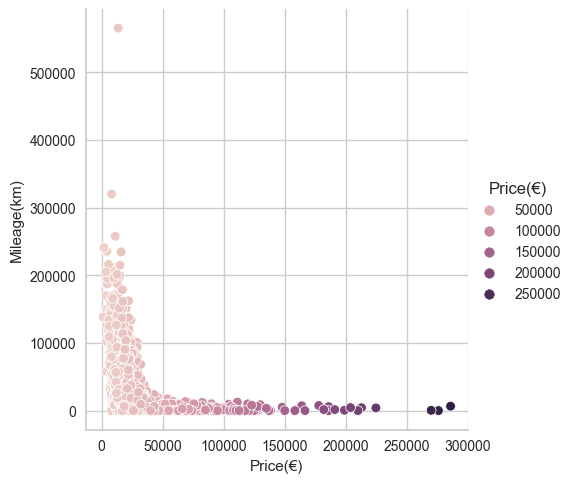

In [50]:
sns.relplot(x='Price(€)', y='Mileage(km)', hue='Price(€)', data=data)

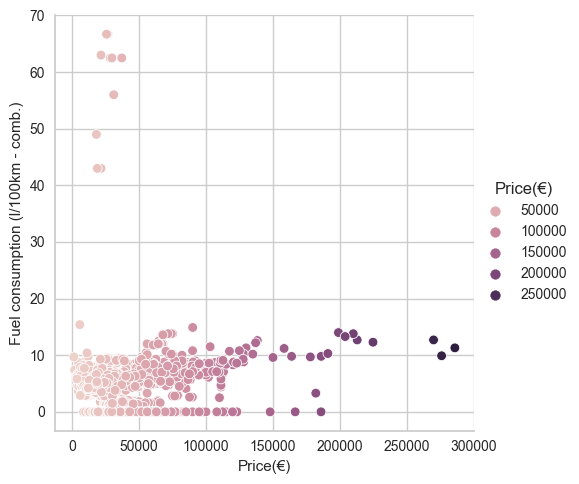

In [51]:
sns.relplot(x='Price(€)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)

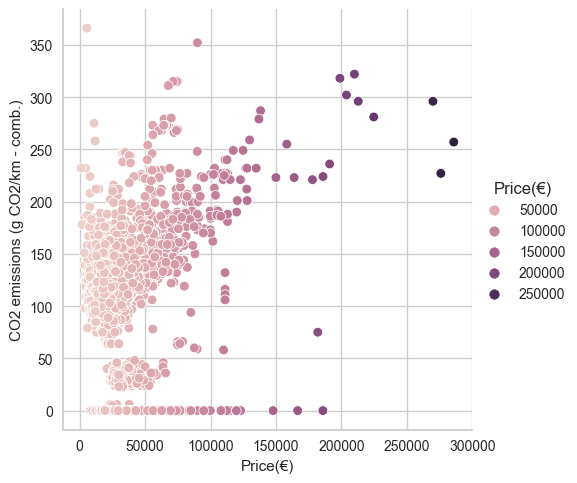

In [52]:
sns.relplot(x='Price(€)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)

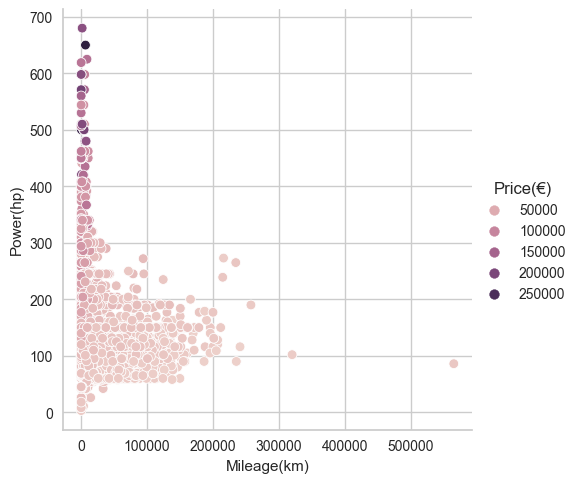

In [53]:
#moji stari plotovi tu pocinju
sns.relplot(x= 'Mileage(km)', y='Power(hp)', hue='Price(€)', data=data)

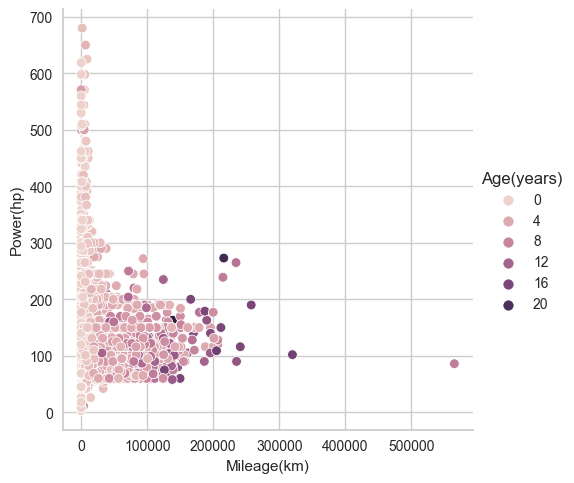

In [54]:
sns.relplot(x= 'Mileage(km)', y='Power(hp)', hue='Age(years)', data=data)

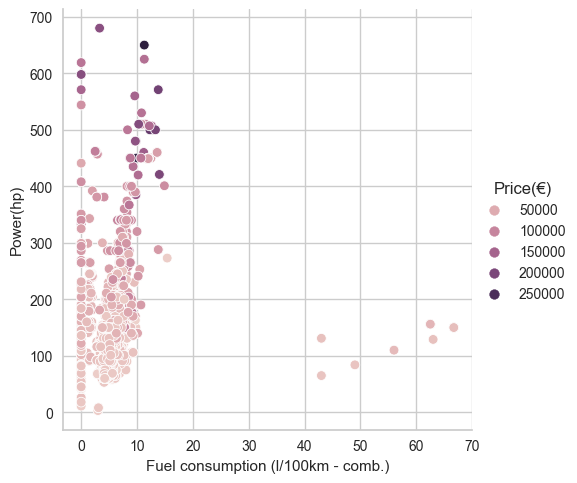

In [55]:
sns.relplot(x= 'Fuel consumption (l/100km - comb.)', y='Power(hp)', hue='Price(€)', data=data)

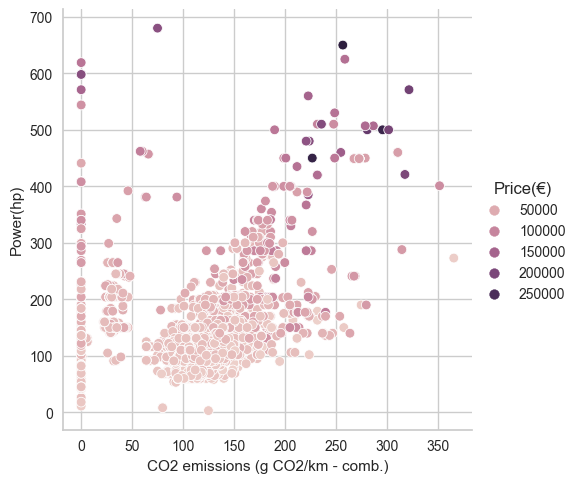

In [56]:
sns.relplot(x= 'CO2 emissions (g CO2/km - comb.)', y='Power(hp)', hue='Price(€)', data=data)

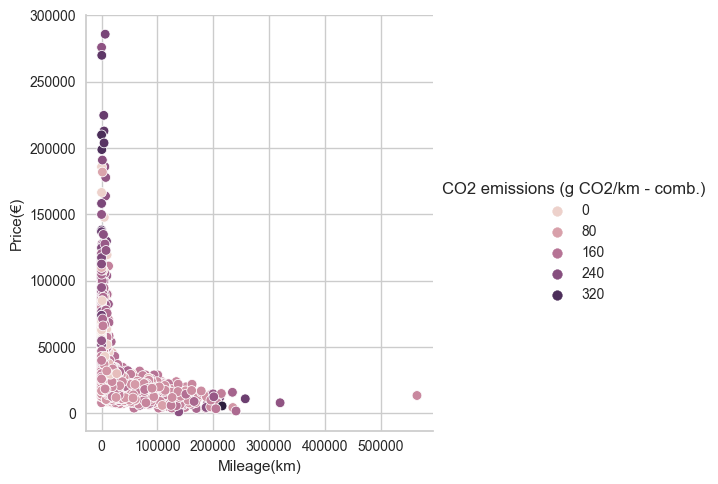

In [57]:
sns.relplot(x= 'Mileage(km)', y='Price(€)', hue='CO2 emissions (g CO2/km - comb.)', data=data)

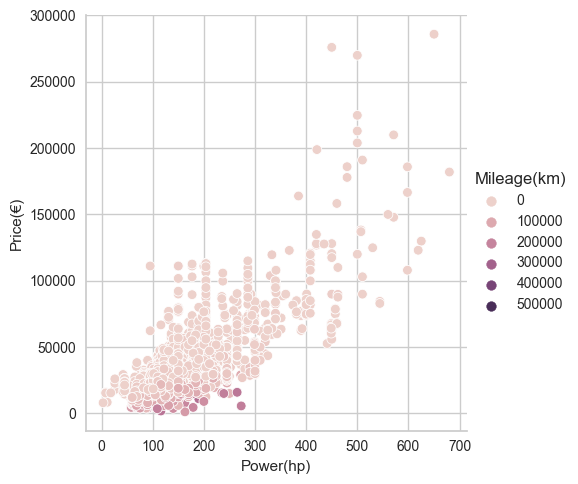

In [58]:
sns.relplot(x= 'Power(hp)', y='Price(€)', hue='Mileage(km)', data=data)

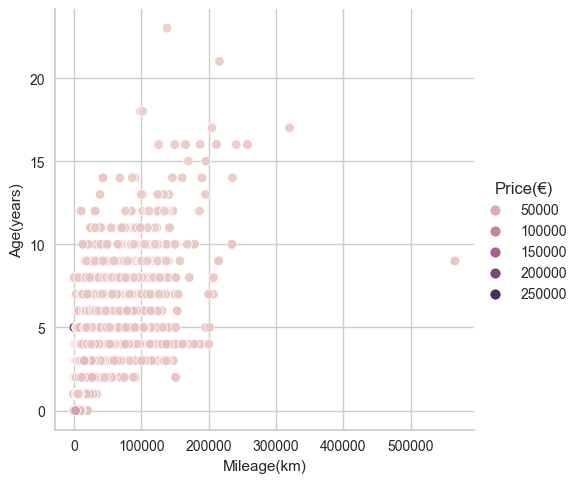

In [59]:
sns.relplot(x= 'Mileage(km)', y='Age(years)', hue='Price(€)', data=data)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">Scatter Plot</p>

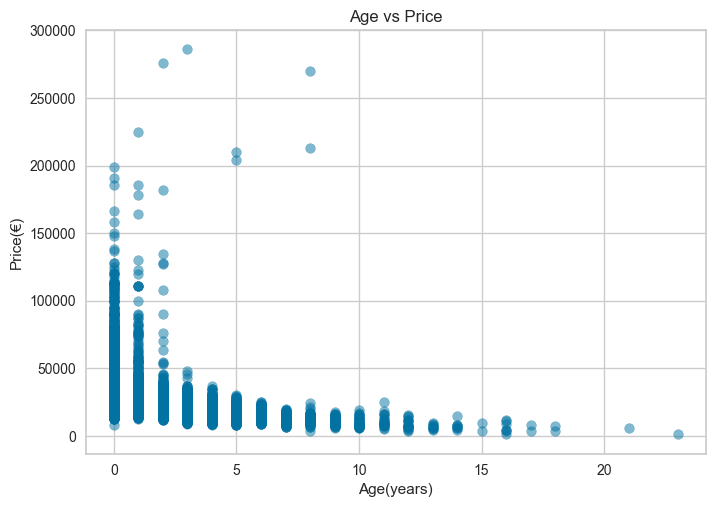

In [78]:
# Create a scatter plot of Age(years) vs Price(€)
plt.scatter(data['Age(years)'], data['Price(€)'], alpha=0.5)

# Set the x-axis label
plt.xlabel('Age(years)')

# Set the y-axis label
plt.ylabel('Price(€)')

# Set the title
plt.title('Age vs Price')

# Display the plot
plt.show()


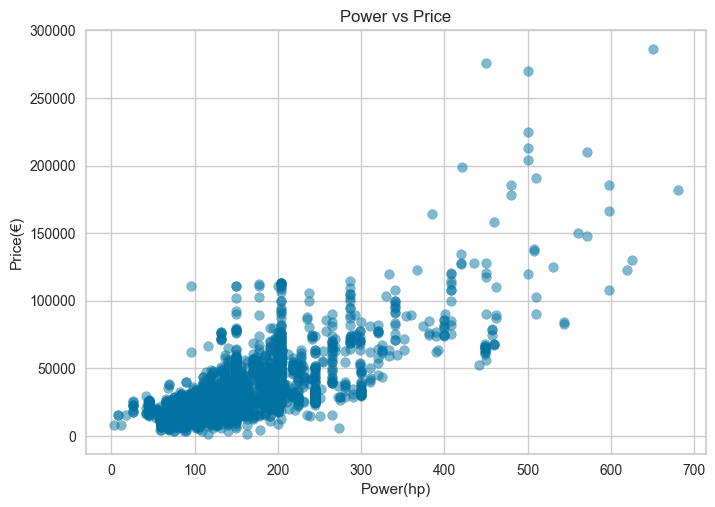

In [79]:
# Create a scatter plot of Power(hp) vs Price(€)
plt.scatter(data['Power(hp)'], data['Price(€)'], alpha=0.5)

# Set the x-axis label
plt.xlabel('Power(hp)')

# Set the y-axis label
plt.ylabel('Price(€)')

# Set the title
plt.title('Power vs Price')

# Display the plot
plt.show()


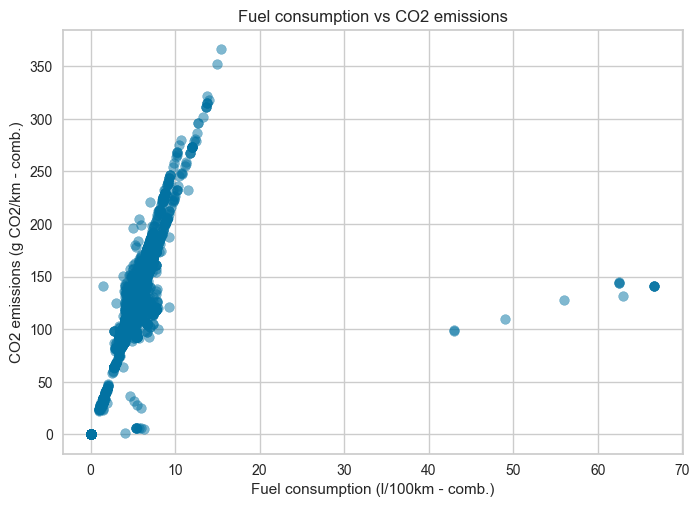

In [80]:
# Create a scatter plot of Fuel consumption (l/100km - comb.) vs CO2 emissions (g CO2/km - comb.)
plt.scatter(data['Fuel consumption (l/100km - comb.)'], data['CO2 emissions (g CO2/km - comb.)'], alpha=0.5)

# Set the x-axis label
plt.xlabel('Fuel consumption (l/100km - comb.)')

# Set the y-axis label
plt.ylabel('CO2 emissions (g CO2/km - comb.)')

# Set the title
plt.title('Fuel consumption vs CO2 emissions')

# Display the plot
plt.show()


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">Age vs Price</p>

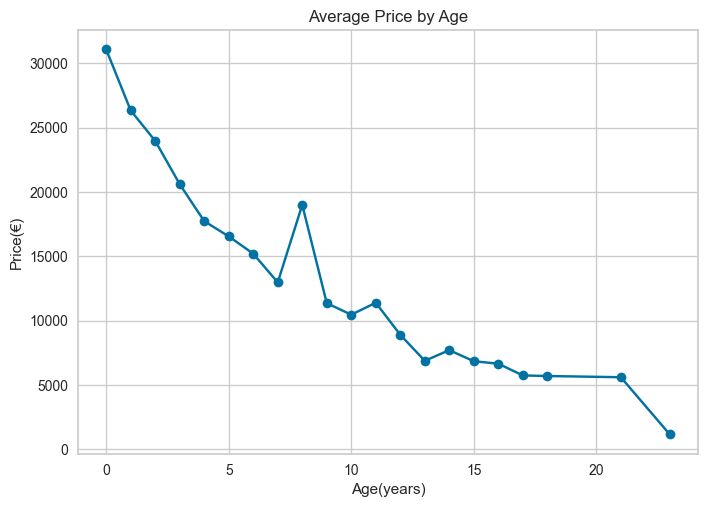

In [81]:
# Group the data by age and calculate the average price for each age group
average_price_by_age = data.groupby('Age(years)')['Price(€)'].mean()

# Create the line plot
plt.plot(average_price_by_age.index, average_price_by_age.values, marker='o')

# Set the x-axis label
plt.xlabel('Age(years)')

# Set the y-axis label
plt.ylabel('Price(€)')

# Set the title
plt.title('Average Price by Age')

# Display the plot
plt.show()


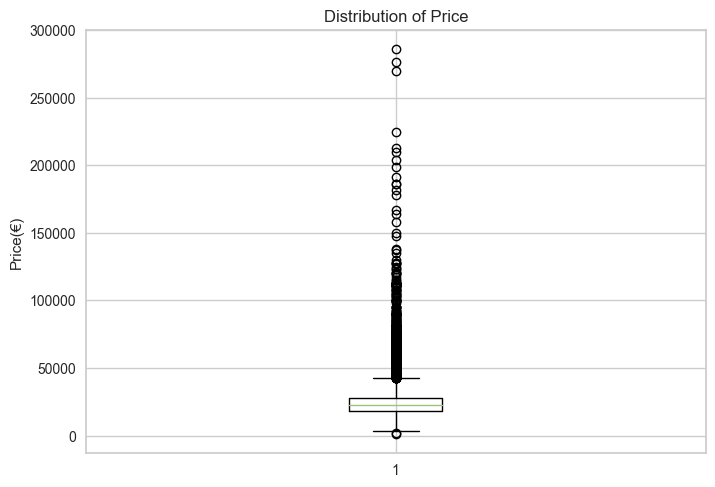

In [82]:
# Create the box plot
plt.boxplot(data['Price(€)'])

# Set the y-axis label
plt.ylabel('Price(€)')

# Set the title
plt.title('Distribution of Price')

# Display the plot
plt.show()


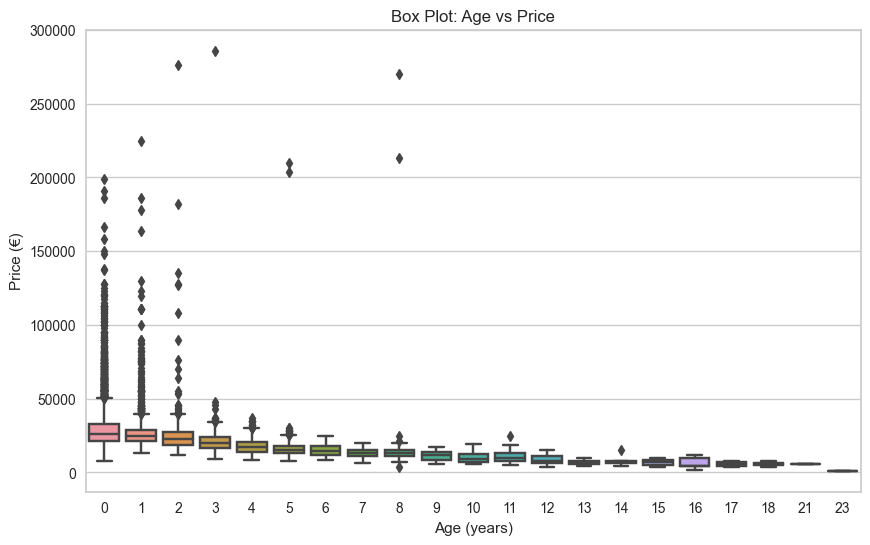

In [85]:
# Create a box plot
plt.figure(figsize=(10, 6))
sns.boxplot(x='Age(years)', y='Price(€)', data=data)

# Set labels and title
plt.xlabel('Age (years)')
plt.ylabel('Price (€)')
plt.title('Box Plot: Age vs Price')

# Show the plot
plt.show()


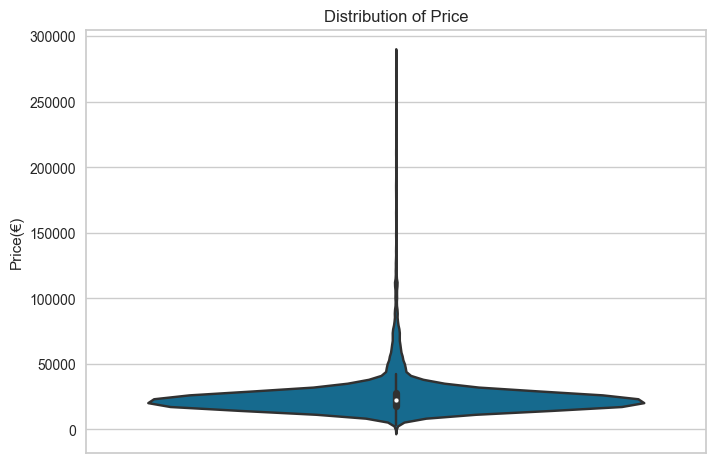

In [83]:
# Create the violin plot
sns.violinplot(y=data['Price(€)'])

# Set the y-axis label
plt.ylabel('Price(€)')

# Set the title
plt.title('Distribution of Price')

# Display the plot
plt.show()


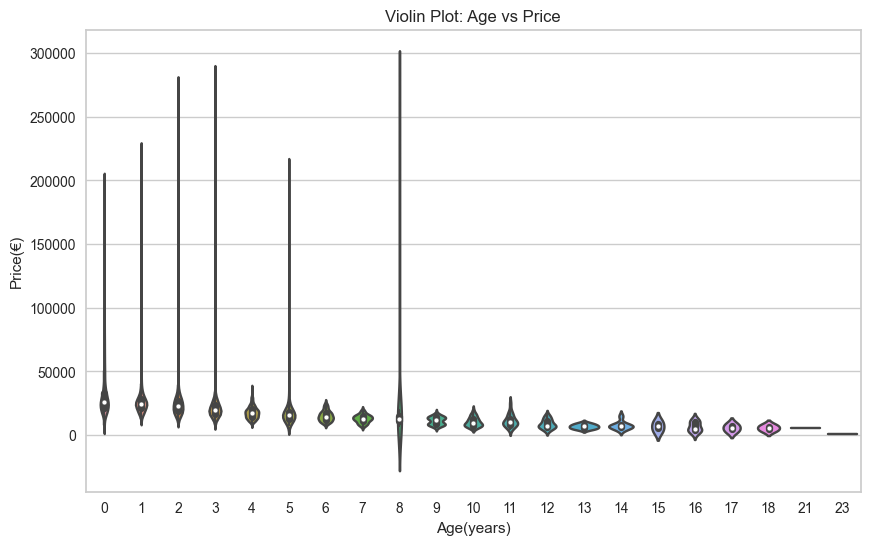

In [86]:
# Create a violin plot
plt.figure(figsize=(10, 6))
sns.violinplot(x='Age(years)', y='Price(€)', data=data)

# Set the title and labels
plt.title('Violin Plot: Age vs Price')
plt.xlabel('Age(years)')
plt.ylabel('Price(€)')

# Show the plot
plt.show()


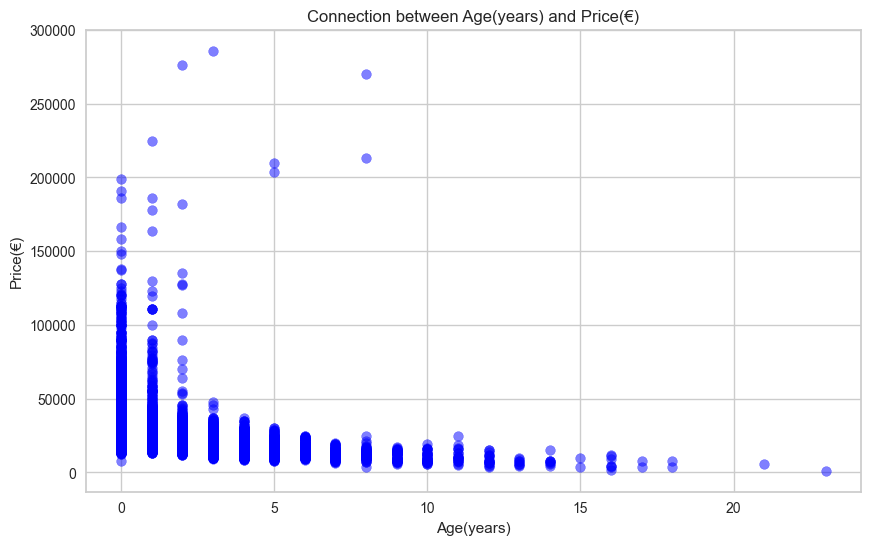

In [88]:
# Create a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(data['Age(years)'], data['Price(€)'], color='blue', alpha=0.5)

# Set the axis labels and title
plt.xlabel('Age(years)')
plt.ylabel('Price(€)')
plt.title('Connection between Age(years) and Price(€)')

# Show the plot
plt.show()


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">Age Distribution</p>

In [26]:
data['Age(years)'].value_counts()

0     3674
1     2521
2     1425
4     1315
3     1295
5      511
6      156
7      100
8       74
9       58
10      36
11      21
12      19
13       9
14       8
16       7
15       2
17       2
18       2
23       1
21       1
Name: Age(years), dtype: int64

<Axes: title={'center': 'Top 10 Years'}>

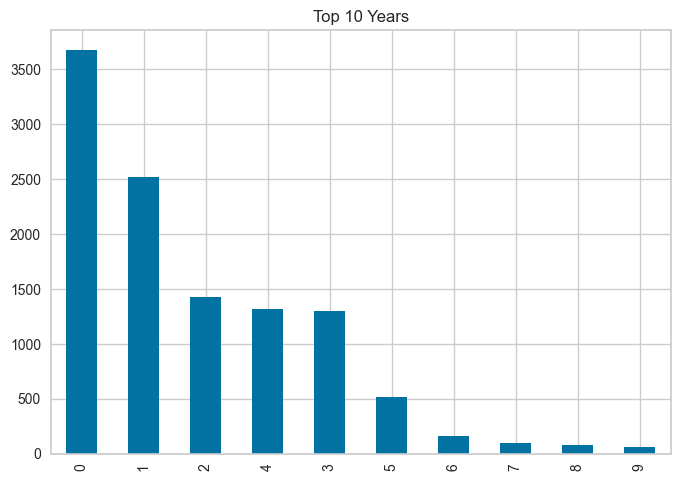

In [27]:
data['Age(years)'].value_counts() \
        .head(10) \
        .plot(kind='bar', title='Top 10 Years')

<Axes: title={'center': 'Top 10 Years'}>

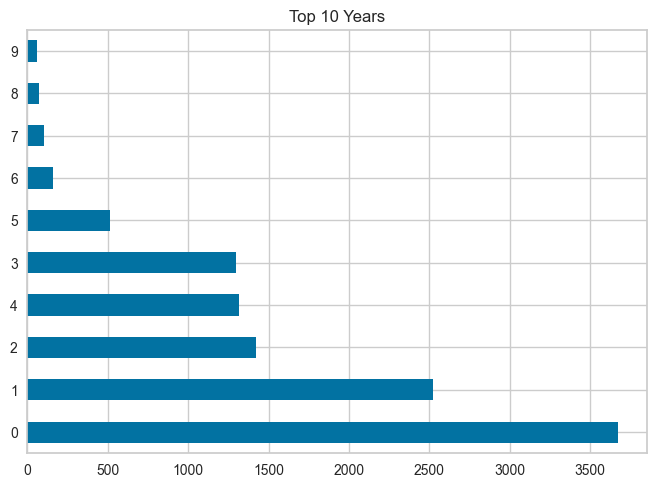

In [28]:
data['Age(years)'].value_counts() \
        .head(10) \
        .plot(kind='barh', title='Top 10 Years')

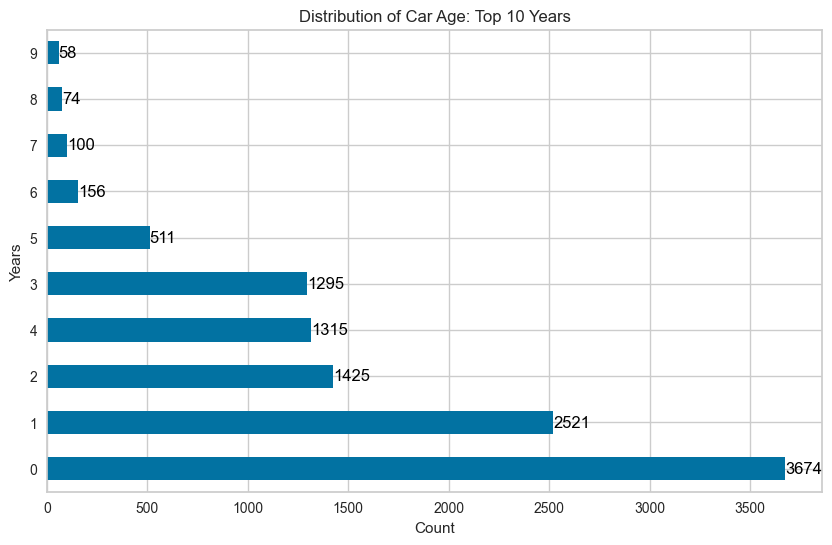

In [32]:
top_10_years = data['Age(years)'].value_counts().head(10)

plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='barh', title='Distribution of Car Age: Top 10 Years')

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(v, i, str(v), color='black', va='center')

plt.xlabel('Count')
plt.ylabel('Years')
plt.show()


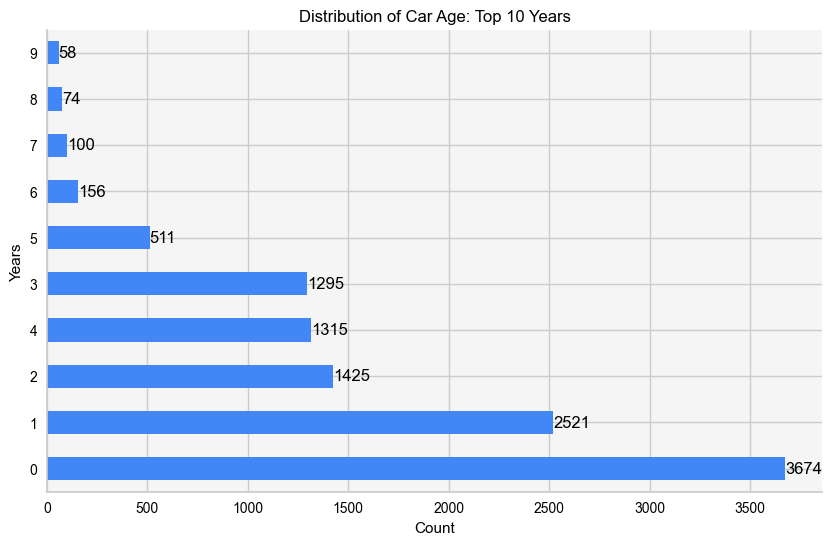

In [33]:
top_10_years = data['Age(years)'].value_counts().head(10)

# Set the Seaborn style
sns.set_style("whitegrid")

# Define custom colors
bar_color = '#4287f5'
text_color = 'black'
background_color = '#f5f5f5'

plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='barh', title='Distribution of Car Age: Top 10 Years', color=bar_color, edgecolor='none')

# Set the background color
ax.set_facecolor(background_color)

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(v, i, str(v), color=text_color, va='center')

# Customize the axes labels
plt.xlabel('Count', color=text_color)
plt.ylabel('Years', color=text_color)

# Customize the tick colors
ax.tick_params(axis='x', colors=text_color)
ax.tick_params(axis='y', colors=text_color)

# Remove the spines (borders) of the axes
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Set the title color
ax.title.set_color(text_color)

# Set the background color of the plot
plt.gca().set_facecolor(background_color)

plt.show()


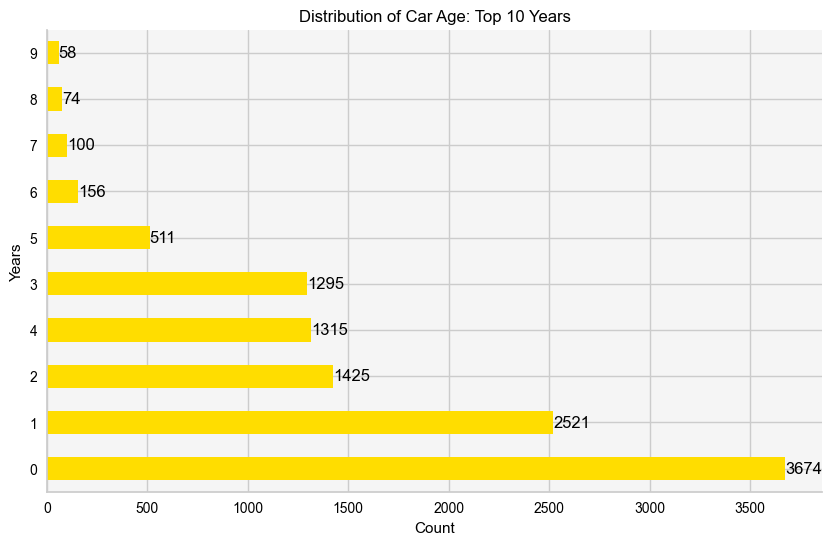

In [34]:
top_10_years = data['Age(years)'].value_counts().head(10)

# Set the Seaborn style
sns.set_style("whitegrid")

# Define custom colors
bar_color = '#ffdd00'
text_color = 'black'
background_color = '#f5f5f5'

plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='barh', title='Distribution of Car Age: Top 10 Years', color=bar_color, edgecolor='none')

# Set the background color
ax.set_facecolor(background_color)

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(v, i, str(v), color=text_color, va='center')

# Customize the axes labels
plt.xlabel('Count', color=text_color)
plt.ylabel('Years', color=text_color)

# Customize the tick colors
ax.tick_params(axis='x', colors=text_color)
ax.tick_params(axis='y', colors=text_color)

# Remove the spines (borders) of the axes
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Set the title color
ax.title.set_color(text_color)

# Set the background color of the plot
plt.gca().set_facecolor(background_color)

plt.show()


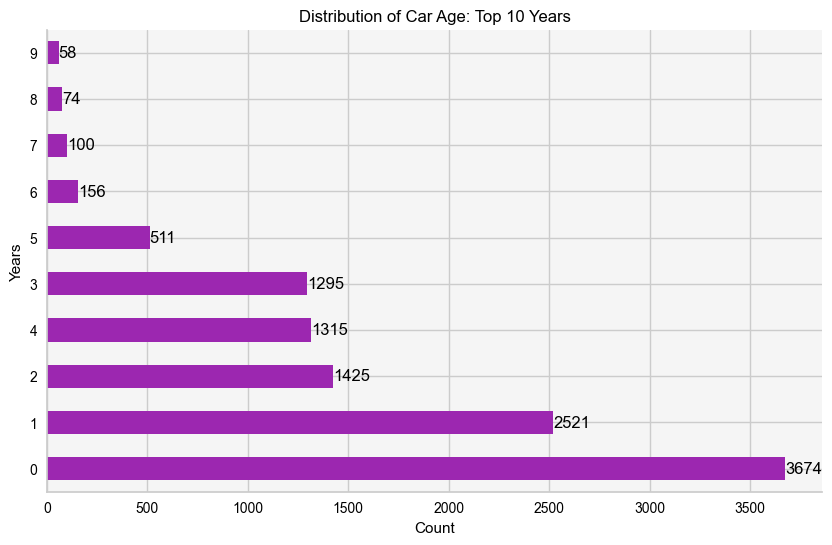

In [38]:

top_10_years = data['Age(years)'].value_counts().head(10)

# Set the Seaborn style
sns.set_style("whitegrid")

# Define custom colors
bar_color = '#9c27b0'
text_color = 'black'
background_color = '#f5f5f5'

plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='barh', title='Distribution of Car Age: Top 10 Years', color=bar_color, edgecolor='none')

# Set the background color
ax.set_facecolor(background_color)

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(v, i, str(v), color=text_color, va='center')

# Customize the axes labels
plt.xlabel('Count', color=text_color)
plt.ylabel('Years', color=text_color)

# Customize the tick colors
ax.tick_params(axis='x', colors=text_color)
ax.tick_params(axis='y', colors=text_color)

# Remove the spines (borders) of the axes
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Set the title color
ax.title.set_color(text_color)

# Set the background color of the plot
plt.gca().set_facecolor(background_color)

plt.show()


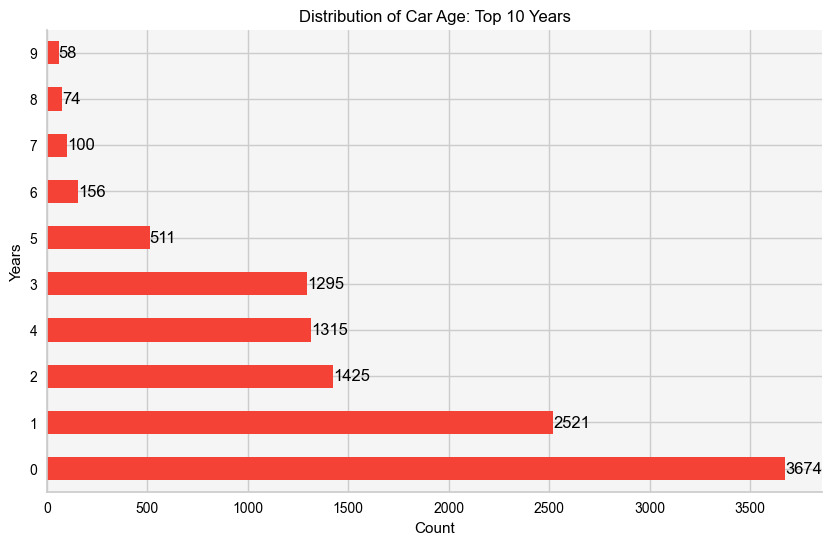

In [39]:
top_10_years = data['Age(years)'].value_counts().head(10)

# Set the Seaborn style
sns.set_style("whitegrid")

# Define custom colors
bar_color = '#f44336'
text_color = 'black'
background_color = '#f5f5f5'

plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='barh', title='Distribution of Car Age: Top 10 Years', color=bar_color, edgecolor='none')

# Set the background color
ax.set_facecolor(background_color)

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(v, i, str(v), color=text_color, va='center')

# Customize the axes labels
plt.xlabel('Count', color=text_color)
plt.ylabel('Years', color=text_color)

# Customize the tick colors
ax.tick_params(axis='x', colors=text_color)
ax.tick_params(axis='y', colors=text_color)

# Remove the spines (borders) of the axes
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Set the title color
ax.title.set_color(text_color)

# Set the background color of the plot
plt.gca().set_facecolor(background_color)

plt.show()


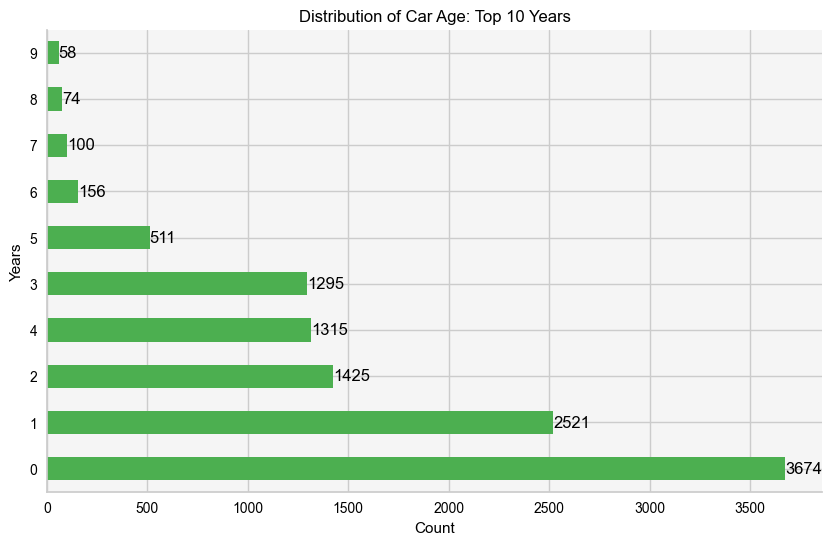

In [36]:

top_10_years = data['Age(years)'].value_counts().head(10)

# Set the Seaborn style
sns.set_style("whitegrid")

# Define custom colors
bar_color = '#4caf50'
text_color = 'black'
background_color = '#f5f5f5'

plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='barh', title='Distribution of Car Age: Top 10 Years', color=bar_color, edgecolor='none')

# Set the background color
ax.set_facecolor(background_color)

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(v, i, str(v), color=text_color, va='center')

# Customize the axes labels
plt.xlabel('Count', color=text_color)
plt.ylabel('Years', color=text_color)

# Customize the tick colors
ax.tick_params(axis='x', colors=text_color)
ax.tick_params(axis='y', colors=text_color)

# Remove the spines (borders) of the axes
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Set the title color
ax.title.set_color(text_color)

# Set the background color of the plot
plt.gca().set_facecolor(background_color)

plt.show()


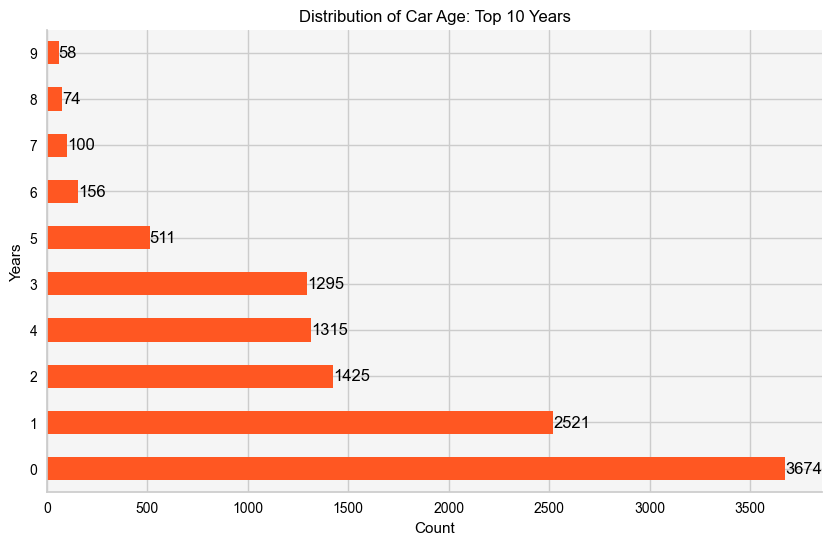

In [35]:

top_10_years = data['Age(years)'].value_counts().head(10)

# Set the Seaborn style
sns.set_style("whitegrid")

# Define custom colors
bar_color = '#ff5722'
text_color = 'black'
background_color = '#f5f5f5'

plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='barh', title='Distribution of Car Age: Top 10 Years', color=bar_color, edgecolor='none')

# Set the background color
ax.set_facecolor(background_color)

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(v, i, str(v), color=text_color, va='center')

# Customize the axes labels
plt.xlabel('Count', color=text_color)
plt.ylabel('Years', color=text_color)

# Customize the tick colors
ax.tick_params(axis='x', colors=text_color)
ax.tick_params(axis='y', colors=text_color)

# Remove the spines (borders) of the axes
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Set the title color
ax.title.set_color(text_color)

# Set the background color of the plot
plt.gca().set_facecolor(background_color)

plt.show()


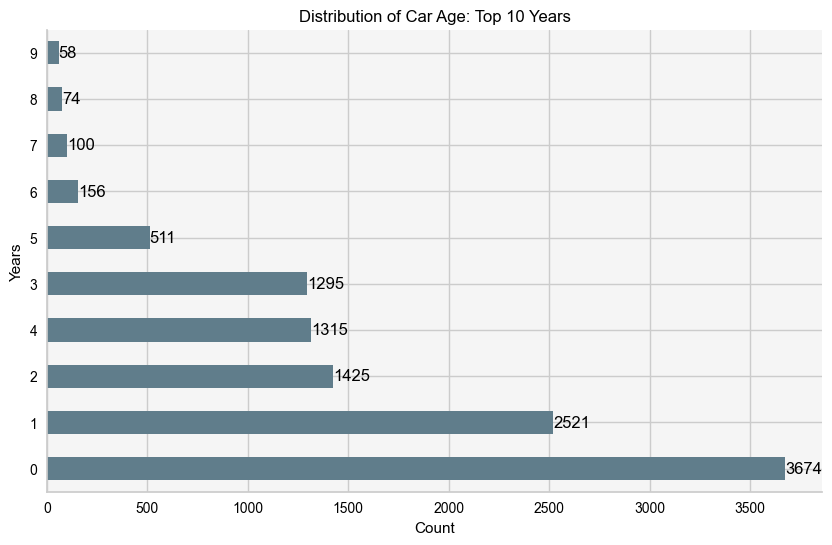

In [40]:
top_10_years = data['Age(years)'].value_counts().head(10)

# Set the Seaborn style
sns.set_style("whitegrid")

# Define custom colors
bar_color = '#607d8b'
text_color = 'black'
background_color = '#f5f5f5'

plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='barh', title='Distribution of Car Age: Top 10 Years', color=bar_color, edgecolor='none')

# Set the background color
ax.set_facecolor(background_color)

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(v, i, str(v), color=text_color, va='center')

# Customize the axes labels
plt.xlabel('Count', color=text_color)
plt.ylabel('Years', color=text_color)

# Customize the tick colors
ax.tick_params(axis='x', colors=text_color)
ax.tick_params(axis='y', colors=text_color)

# Remove the spines (borders) of the axes
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Set the title color
ax.title.set_color(text_color)

# Set the background color of the plot
plt.gca().set_facecolor(background_color)

plt.show()


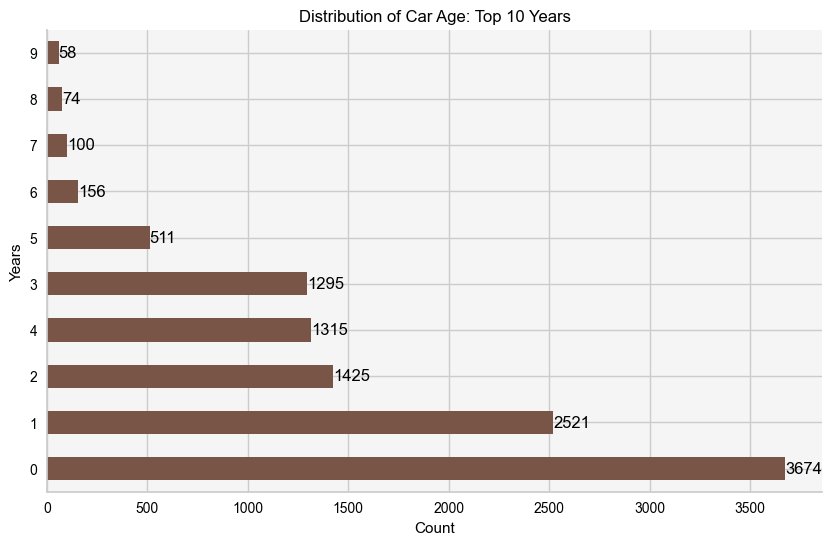

In [41]:

top_10_years = data['Age(years)'].value_counts().head(10)

# Set the Seaborn style
sns.set_style("whitegrid")

# Define custom colors
bar_color = '#795548'
text_color = 'black'
background_color = '#f5f5f5'

plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='barh', title='Distribution of Car Age: Top 10 Years', color=bar_color, edgecolor='none')

# Set the background color
ax.set_facecolor(background_color)

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(v, i, str(v), color=text_color, va='center')

# Customize the axes labels
plt.xlabel('Count', color=text_color)
plt.ylabel('Years', color=text_color)

# Customize the tick colors
ax.tick_params(axis='x', colors=text_color)
ax.tick_params(axis='y', colors=text_color)

# Remove the spines (borders) of the axes
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Set the title color
ax.title.set_color(text_color)

# Set the background color of the plot
plt.gca().set_facecolor(background_color)

plt.show()


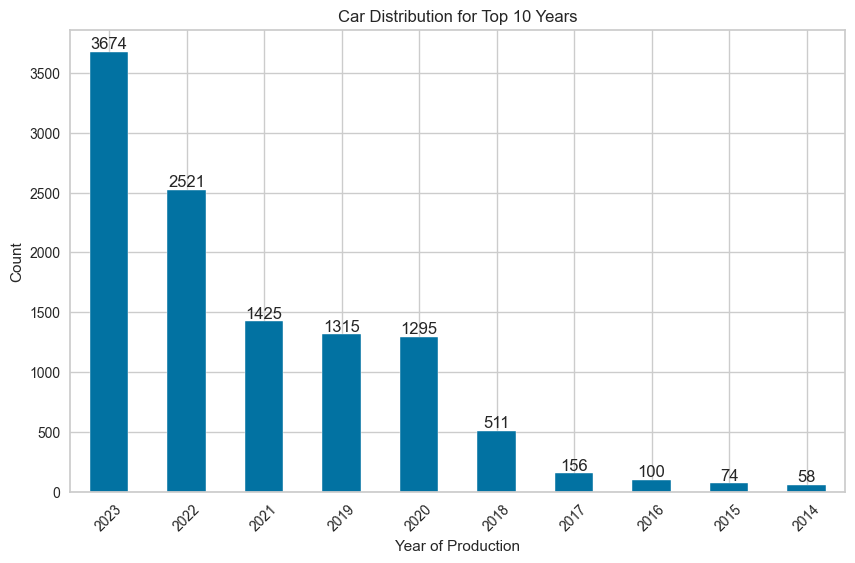

In [71]:
# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Get the top 10 years by car count
top_10_years = data['Year'].value_counts().head(10)

# Create a bar plot for car distribution
plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='bar')

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(i, v, str(v), ha='center', va='bottom')

# Customize the axes labels and title
plt.xlabel('Year of Production')
plt.ylabel('Count')
plt.title('Car Distribution for Top 10 Years')

# Rotate the x-axis tick labels for better visibility
plt.xticks(rotation=45)

plt.show()


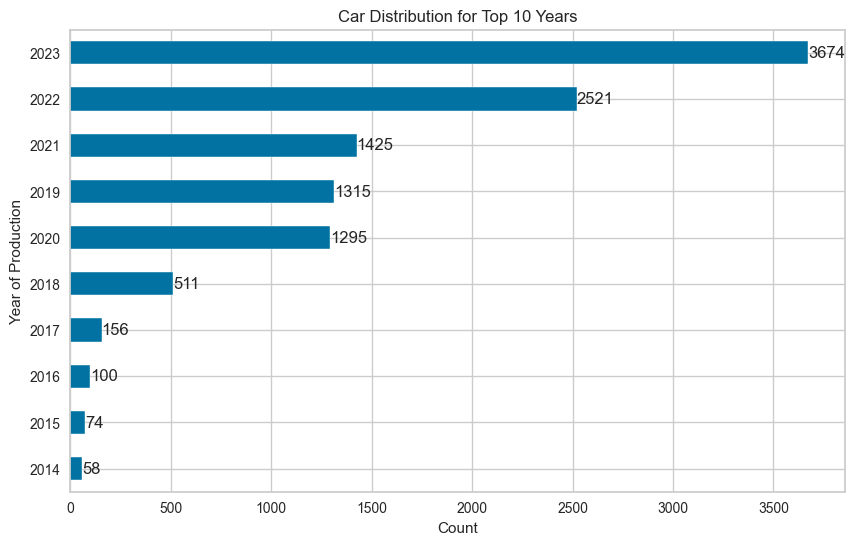

In [72]:

# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Get the top 10 years by car count
top_10_years = data['Year'].value_counts().sort_values().tail(10)

# Create a horizontal bar plot for car distribution
plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='barh')

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(v, i, str(v), ha='left', va='center')

# Customize the axes labels and title
plt.xlabel('Count')
plt.ylabel('Year of Production')
plt.title('Car Distribution for Top 10 Years')

plt.show()


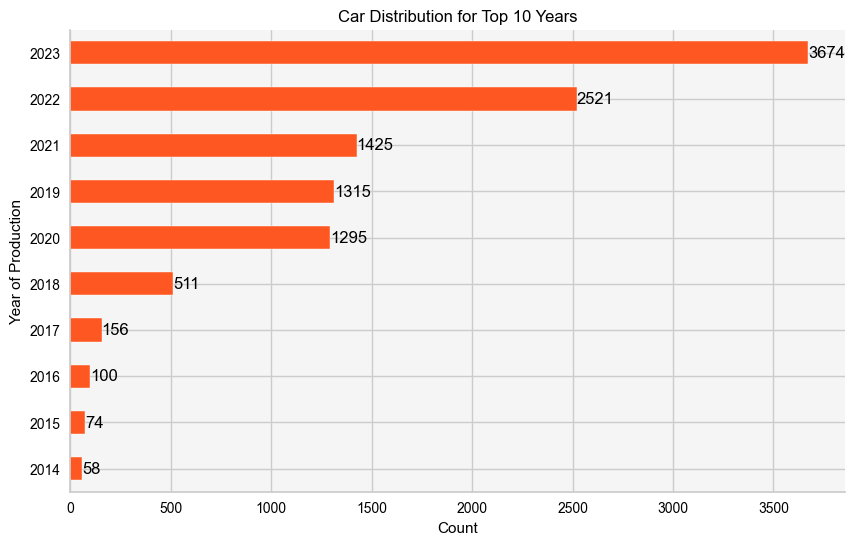

In [73]:

# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Get the top 10 years by car count
top_10_years = data['Year'].value_counts().sort_values().tail(10)

# Define custom colors
bar_color = '#ff5722'
text_color = 'black'
background_color = '#f5f5f5'

# Create a horizontal bar plot for car distribution
plt.figure(figsize=(10, 6))
ax = top_10_years.plot(kind='barh', color=bar_color)

# Add value labels to the bars
for i, v in enumerate(top_10_years):
    ax.text(v, i, str(v), ha='left', va='center', color=text_color)

# Customize the axes labels and title
plt.xlabel('Count', color=text_color)
plt.ylabel('Year of Production', color=text_color)
plt.title('Car Distribution for Top 10 Years', color=text_color)

# Set the background color
plt.gca().set_facecolor(background_color)

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the y-axis
ax.tick_params(left=False)

# Customize the tick colors
ax.tick_params(axis='x', colors=text_color)
ax.tick_params(axis='y', colors=text_color)

plt.show()


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">Fuel Type Distribution</p>

Text(0.5, 1.0, 'Fuel Type Distribution')

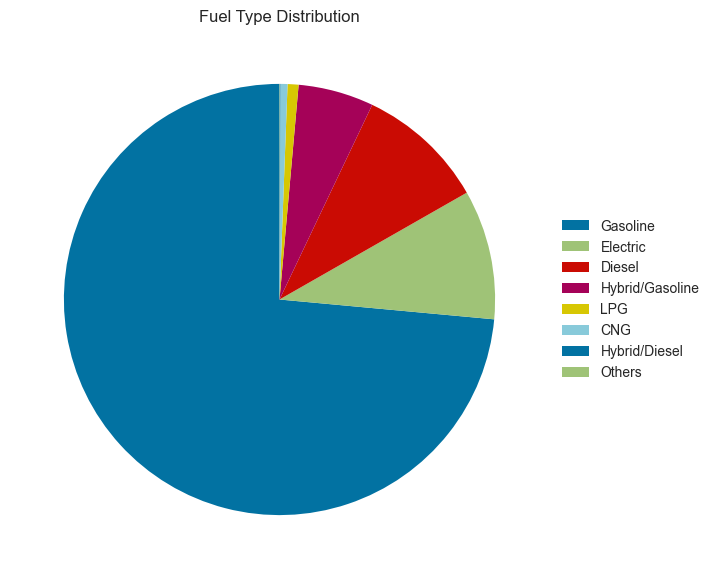

In [4]:
# code to plot the pie chart
fuel_type_counts = data['Fuel type'].value_counts()
fig, ax = plt.subplots(figsize=(7, 7))
wedges, _ = ax.pie(fuel_type_counts, labels=None, startangle=90)

# Create a legend
ax.legend(wedges, fuel_type_counts.index, loc='center left', bbox_to_anchor=(1, 0.5))

# Display the chart
plt.gca().set_title("Fuel Type Distribution")


Text(0.5, 1.0, 'Fuel Type Distribution')

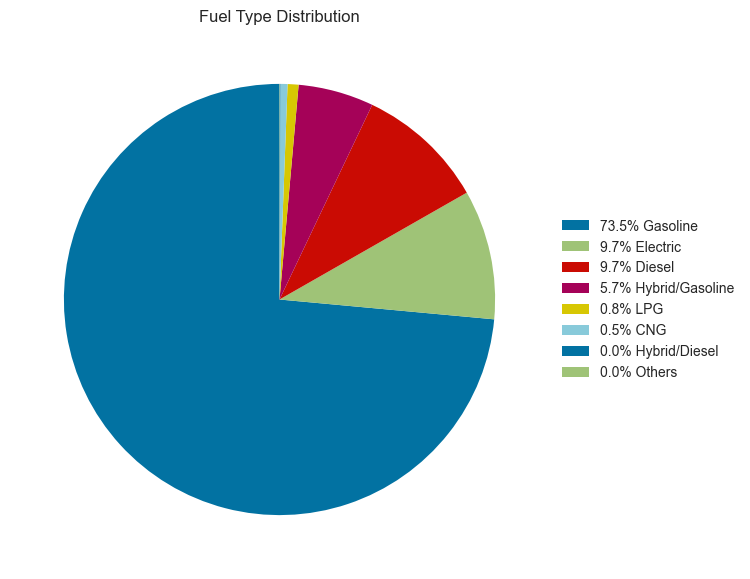

In [16]:
# code to plot the pie chart
fuel_type_counts = data['Fuel type'].value_counts()
fig, ax = plt.subplots(figsize=(7, 7))
wedges, _ = ax.pie(fuel_type_counts, labels=[None] * len(fuel_type_counts), startangle=90)

# Create a legend with percentage labels
ax.legend(wedges, [f'{p:.1f}% {l}' for p, l in zip(percentages, fuel_type_counts.index)],
          loc='center left', bbox_to_anchor=(1, 0.5))

# Display the chart
plt.gca().set_title("Fuel Type Distribution")


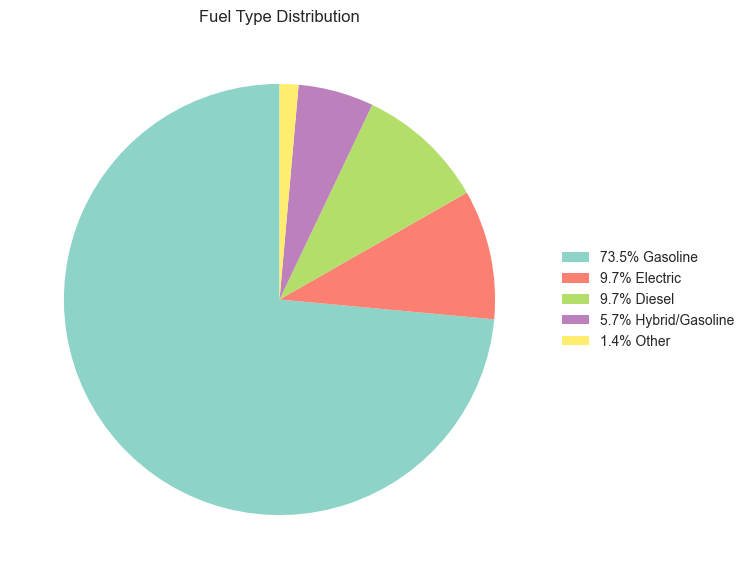

In [14]:

fuel_type_counts = data['Fuel type'].value_counts()

# Calculate percentages
percentages = fuel_type_counts / fuel_type_counts.sum() * 100

# Sort the labels based on percentage in descending order
sorted_labels = fuel_type_counts.index[np.argsort(-percentages)]

# Extract the top 4 labels and percentages
top_labels = sorted_labels[:4]
top_percentages = percentages[:4]

# Calculate the percentage for the "Other" category
other_percentage = percentages[4:].sum()

# Create the labels for the pie chart with percentages
pie_labels = [f'{p:.1f}% {l}' for p, l in zip(top_percentages, top_labels)]
pie_labels.append(f'{other_percentage:.1f}% Other')

# Create a color palette with muted colors
colors = plt.cm.Set3(np.linspace(0, 1, len(pie_labels)))

# Create the pie chart
fig, ax = plt.subplots(figsize=(7, 7))
wedges, _ = ax.pie([*top_percentages, other_percentage], labels=None, startangle=90, colors=colors)

# Create a legend with the specified labels
ax.legend(wedges, pie_labels, loc='center left', bbox_to_anchor=(1, 0.5))

# Display the chart
plt.gca().set_title("Fuel Type Distribution")
plt.show()


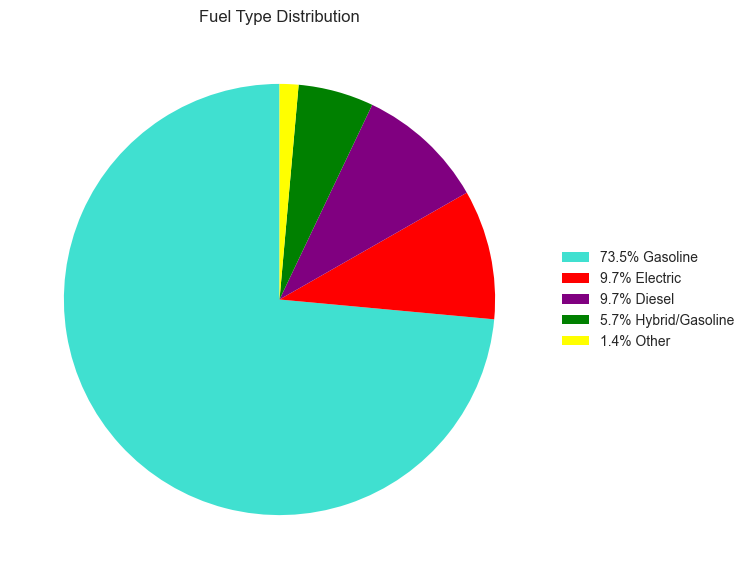

In [4]:

fuel_type_counts = data['Fuel type'].value_counts()

# Calculate percentages
percentages = fuel_type_counts / fuel_type_counts.sum() * 100

# Sort the labels based on percentage in descending order
sorted_labels = fuel_type_counts.index[np.argsort(-percentages)]

# Extract the top 4 labels and percentages
top_labels = sorted_labels[:4]
top_percentages = percentages[:4]

# Calculate the percentage for the "Other" category
other_percentage = percentages[4:].sum()

# Create the labels for the pie chart with percentages
pie_labels = [f'{p:.1f}% {l}' for p, l in zip(top_percentages, top_labels)]
pie_labels.append(f'{other_percentage:.1f}% Other')

# Create a color palette with assigned colors for each fuel type
color_palette = {
    'Gasoline': 'turquoise',
    'Electric': 'red',
    'Diesel': 'purple',
    'Hybrid/Gasoline': 'green',
    'Other': 'yellow'
}

# Retrieve the colors for each fuel type
colors = [color_palette.get(label.split()[-1], 'gray') for label in top_labels]
colors.append(color_palette['Other'])

# Create the pie chart
fig, ax = plt.subplots(figsize=(7, 7))
wedges, _ = ax.pie([*top_percentages, other_percentage], labels=None, startangle=90, colors=colors)

# Create a legend with the specified labels
ax.legend(wedges, pie_labels, loc='center left', bbox_to_anchor=(1, 0.5))

# Display the chart
plt.gca().set_title("Fuel Type Distribution")
plt.show()


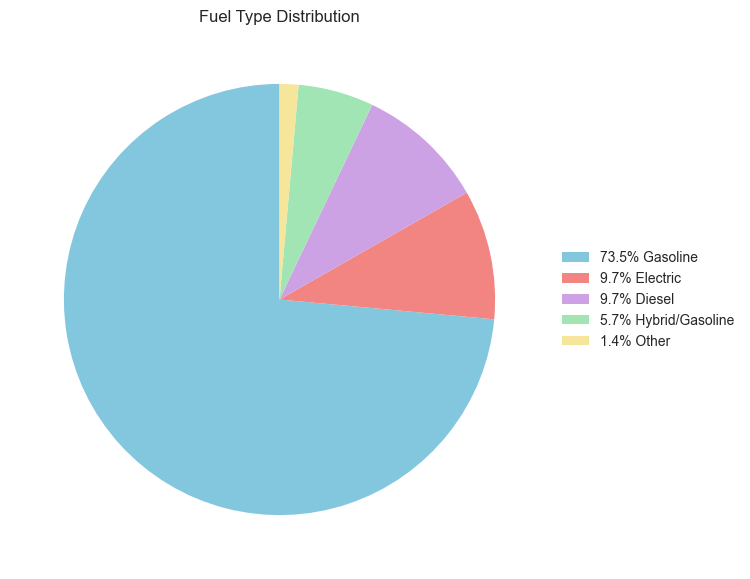

In [5]:

fuel_type_counts = data['Fuel type'].value_counts()

# Calculate percentages
percentages = fuel_type_counts / fuel_type_counts.sum() * 100

# Sort the labels based on percentage in descending order
sorted_labels = fuel_type_counts.index[np.argsort(-percentages)]

# Extract the top 4 labels and percentages
top_labels = sorted_labels[:4]
top_percentages = percentages[:4]

# Calculate the percentage for the "Other" category
other_percentage = percentages[4:].sum()

# Create the labels for the pie chart with percentages
pie_labels = [f'{p:.1f}% {l}' for p, l in zip(top_percentages, top_labels)]
pie_labels.append(f'{other_percentage:.1f}% Other')

# Create a color palette with assigned colors for each fuel type
color_palette = {
    'Gasoline': '#83c7df',       # Turquoise
    'Electric': '#f28482',       # Red
    'Diesel': '#cda2e5',         # Purple
    'Hybrid/Gasoline': '#a2e5b5', # Green
    'Other': '#f5e69c'            # Yellow
}

# Retrieve the colors for each fuel type
colors = [color_palette.get(label.split()[-1], 'gray') for label in top_labels]
colors.append(color_palette['Other'])

# Create the pie chart
fig, ax = plt.subplots(figsize=(7, 7))
wedges, _ = ax.pie([*top_percentages, other_percentage], labels=None, startangle=90, colors=colors)

# Create a legend with the specified labels
ax.legend(wedges, pie_labels, loc='center left', bbox_to_anchor=(1, 0.5))

# Display the chart
plt.gca().set_title("Fuel Type Distribution")
plt.show()


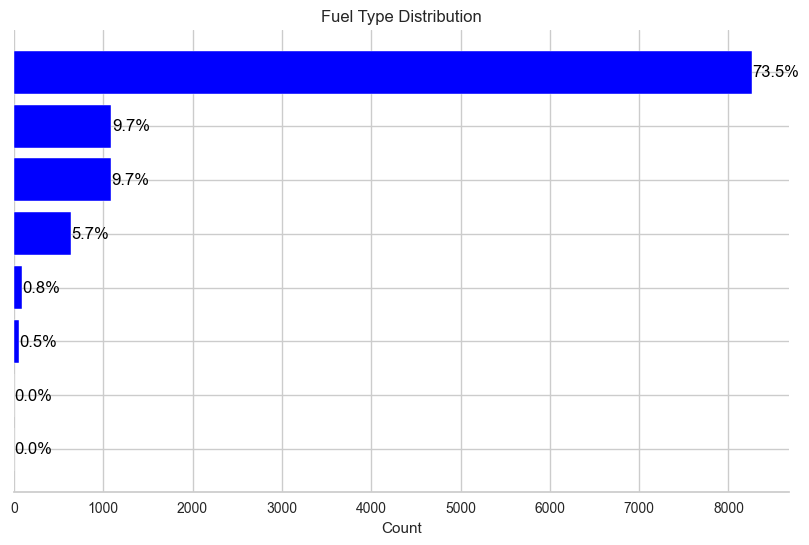

In [48]:
fuel_type_counts = data['Fuel type'].value_counts()

fig, ax = plt.subplots(figsize=(10, 6))

# Create horizontal bar chart
bars = ax.barh(range(len(fuel_type_counts)), fuel_type_counts.values, color='blue')

# Add percentages next to each bar
for i, bar in enumerate(bars):
    value = fuel_type_counts.values[i]
    percentage = (value / fuel_type_counts.sum()) * 100
    
    # Add percentage next to the bar
    ax.text(value + 5, i, f'{percentage:.1f}%', va='center', color='black')

# Set the y-axis ticks and labels
ax.set_yticks(range(len(fuel_type_counts)))
ax.set_yticklabels([])  # Remove y-axis labels

# Set the x-axis label
ax.set_xlabel('Count')

# Set the title
ax.set_title('Fuel Type Distribution')

# Invert the y-axis to show the bars from top to bottom
ax.invert_yaxis()

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)

# Hide tick marks on the x-axis
ax.tick_params(bottom=False)

plt.show()


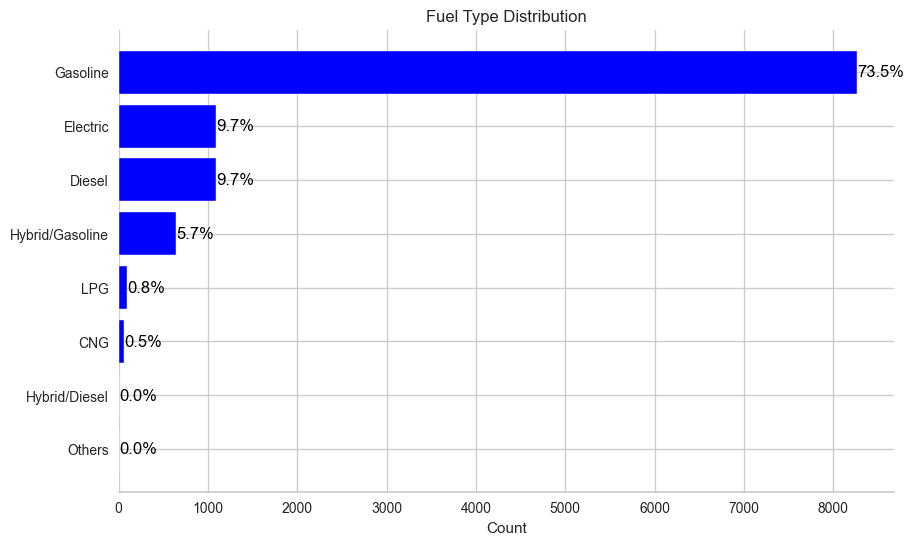

In [57]:
fuel_type_counts = data['Fuel type'].value_counts()

fig, ax = plt.subplots(figsize=(10, 6))

# Create horizontal bar chart
bars = ax.barh(range(len(fuel_type_counts)), fuel_type_counts.values, color='blue')

# Add percentages next to each bar
for i, bar in enumerate(bars):
    value = fuel_type_counts.values[i]
    percentage = (value / fuel_type_counts.sum()) * 100
    
    # Add percentage next to the bar
    ax.text(value + 5, i, f'{percentage:.1f}%', va='center', color='black')

# Set the y-axis ticks and labels
ax.set_yticks(range(len(fuel_type_counts)))
ax.set_yticklabels(fuel_type_counts.index)  # Set y-axis labels as fuel types

# Set the x-axis label
ax.set_xlabel('Count')

# Set the title
ax.set_title('Fuel Type Distribution')

# Invert the y-axis to show the bars from top to bottom
ax.invert_yaxis()

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)

# Hide tick marks on the x-axis
ax.tick_params(bottom=False)

plt.show()


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">Gearbox Type Distribution</p>

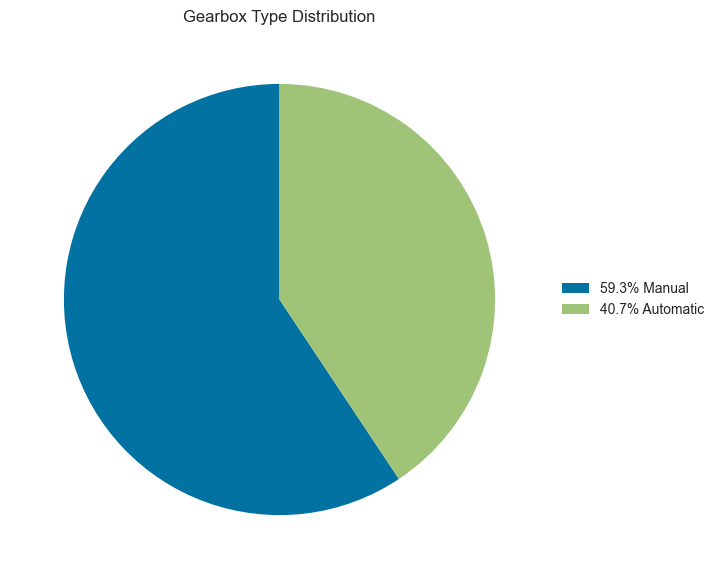

In [19]:
gearbox_type_counts = data['Gearbox'].value_counts()
fig, ax = plt.subplots(figsize=(7, 7))
wedges, _ = ax.pie(gearbox_type_counts, labels=[None] * len(gearbox_type_counts), startangle=90)
percentages = gearbox_type_counts / gearbox_type_counts.sum() * 100
ax.legend(wedges, [f'{p:.1f}% {l}' for p, l in zip(percentages, gearbox_type_counts.index)],
          loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().set_title("Gearbox Type Distribution")
plt.show()

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">Average fuel consumption for each fuel type</p>

In [11]:
average_fuel_consumption = data.groupby('Fuel type')['Fuel consumption (l/100km - comb.)'].mean()

# Print the average fuel consumption for each fuel type
print(average_fuel_consumption)

Fuel type
CNG                3.588333
Diesel             4.959006
Electric           0.000000
Gasoline           5.216650
Hybrid/Diesel      5.550000
Hybrid/Gasoline    3.698585
LPG                6.376087
Others             4.133333
Name: Fuel consumption (l/100km - comb.), dtype: float64


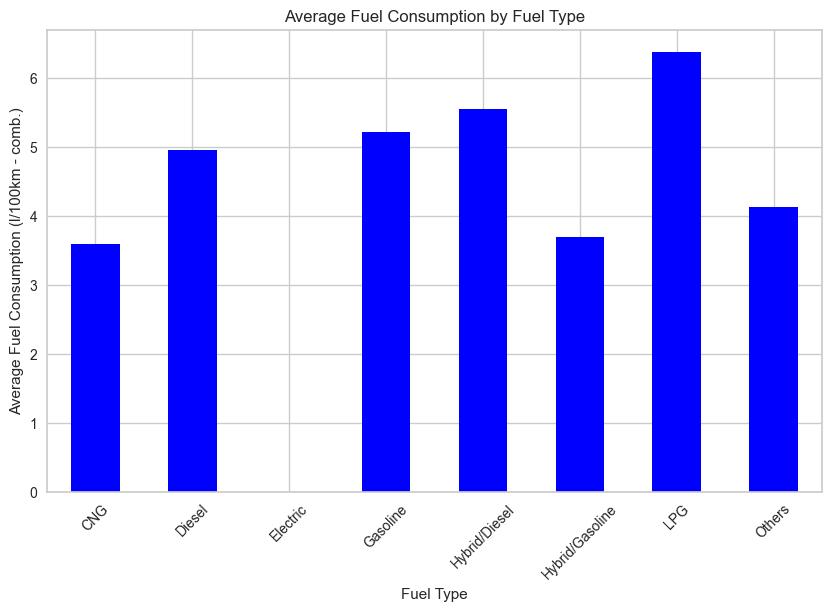

In [22]:

plt.figure(figsize=(10, 6))
average_fuel_consumption.plot(kind='bar', color='blue')
plt.xlabel('Fuel Type')
plt.ylabel('Average Fuel Consumption (l/100km - comb.)')
plt.title('Average Fuel Consumption by Fuel Type')
plt.xticks(rotation=45)
plt.show()


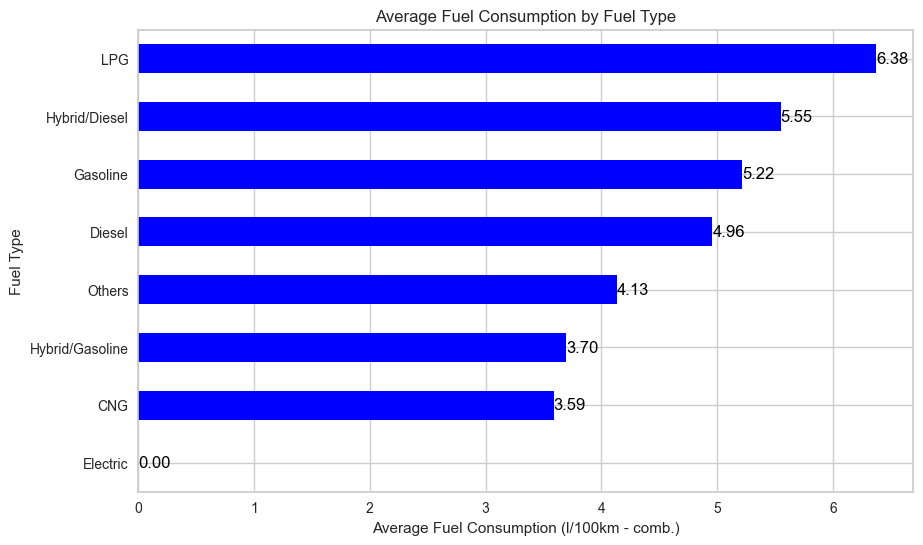

In [23]:
plt.figure(figsize=(10, 6))
average_fuel_consumption.sort_values().plot(kind='barh', color='blue')
plt.xlabel('Average Fuel Consumption (l/100km - comb.)')
plt.ylabel('Fuel Type')
plt.title('Average Fuel Consumption by Fuel Type')

# Add value labels to the bars
for i, v in enumerate(average_fuel_consumption.sort_values()):
    plt.text(v, i, f'{v:.2f}', color='black', va='center')

plt.show()


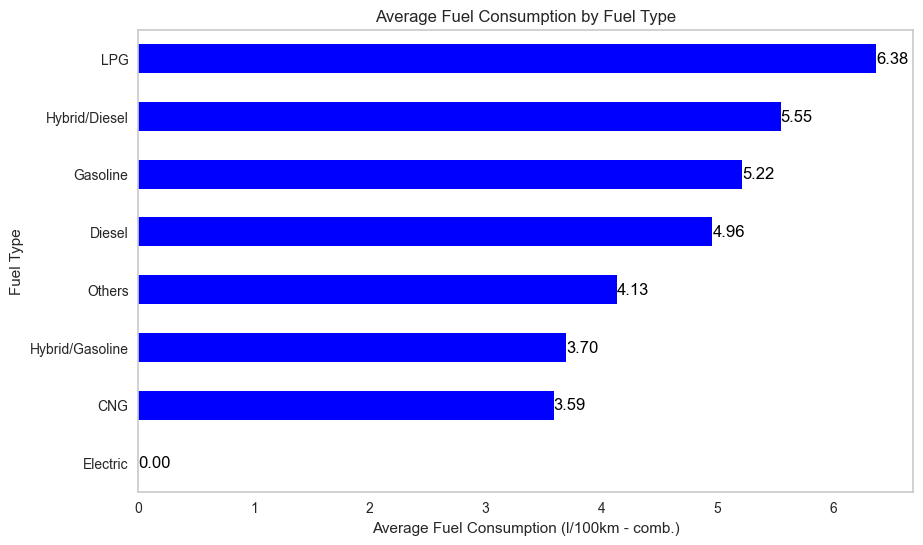

In [12]:
plt.figure(figsize=(10, 6))
average_fuel_consumption.sort_values().plot(kind='barh', color='blue')
plt.xlabel('Average Fuel Consumption (l/100km - comb.)')
plt.ylabel('Fuel Type')
plt.title('Average Fuel Consumption by Fuel Type')

# Remove gridlines
plt.grid(False)

# Add value labels to the bars
for i, v in enumerate(average_fuel_consumption.sort_values()):
    plt.text(v, i, f'{v:.2f}', color='black', va='center')

plt.show()


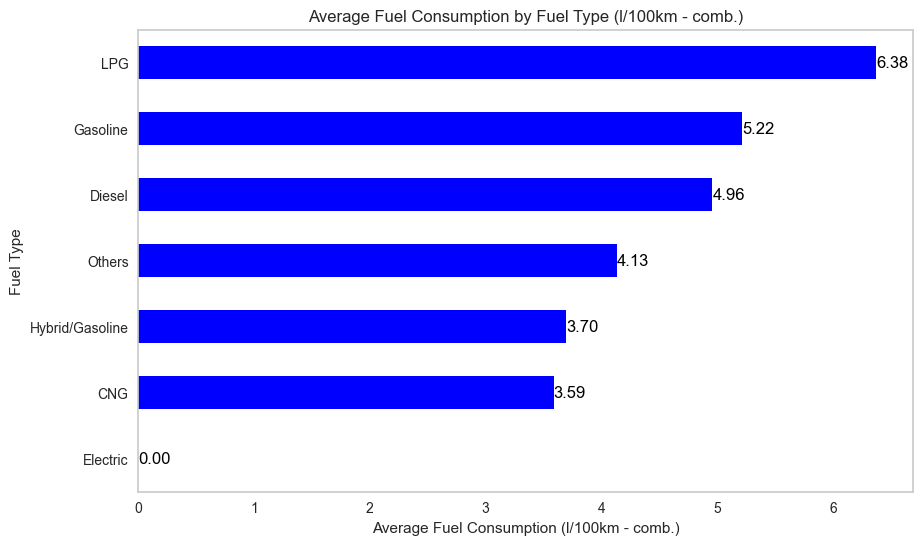

In [13]:
# Filter the average fuel consumption series to exclude "Hybrid/Diesel" category
average_fuel_consumption_filtered = average_fuel_consumption[average_fuel_consumption.index != "Hybrid/Diesel"]

# Create a bar chart to visualize the average fuel consumption
plt.figure(figsize=(10, 6))
average_fuel_consumption_filtered.sort_values().plot(kind='barh', color='blue')
plt.xlabel('Average Fuel Consumption (l/100km - comb.)')
plt.ylabel('Fuel Type')
plt.title('Average Fuel Consumption by Fuel Type (l/100km - comb.)')

# Remove gridlines
plt.grid(False)

# Add value labels to the bars
for i, v in enumerate(average_fuel_consumption_filtered.sort_values()):
    plt.text(v, i, f'{v:.2f}', color='black', va='center')

plt.show()


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">Average CO2 emissions for each fuel type</p>

In [7]:
average_co2_emissions = data.groupby('Fuel type')['CO2 emissions (g CO2/km - comb.)'].mean()

# Print the average CO2 emissions for each fuel type
print(average_co2_emissions)

Fuel type
CNG                 93.950000
Diesel             130.941122
Electric             0.000000
Gasoline           118.939852
Hybrid/Diesel      146.000000
Hybrid/Gasoline     68.918239
LPG                120.891304
Others              81.000000
Name: CO2 emissions (g CO2/km - comb.), dtype: float64


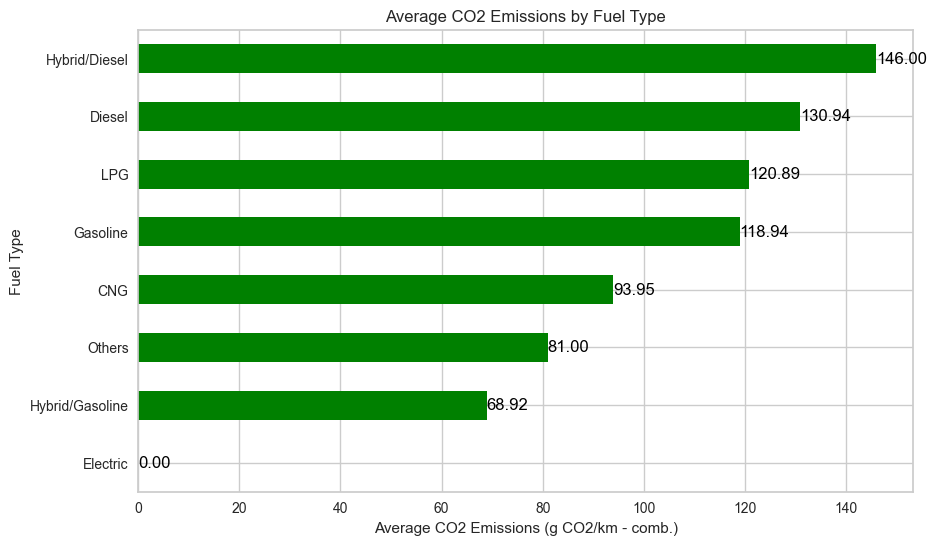

In [25]:
# Create a bar chart to visualize the average CO2 emissions
plt.figure(figsize=(10, 6))
average_co2_emissions.sort_values().plot(kind='barh', color='green')
plt.xlabel('Average CO2 Emissions (g CO2/km - comb.)')
plt.ylabel('Fuel Type')
plt.title('Average CO2 Emissions by Fuel Type')

# Add value labels to the bars
for i, v in enumerate(average_co2_emissions.sort_values()):
    plt.text(v, i, f'{v:.2f}', color='black', va='center')

plt.show()

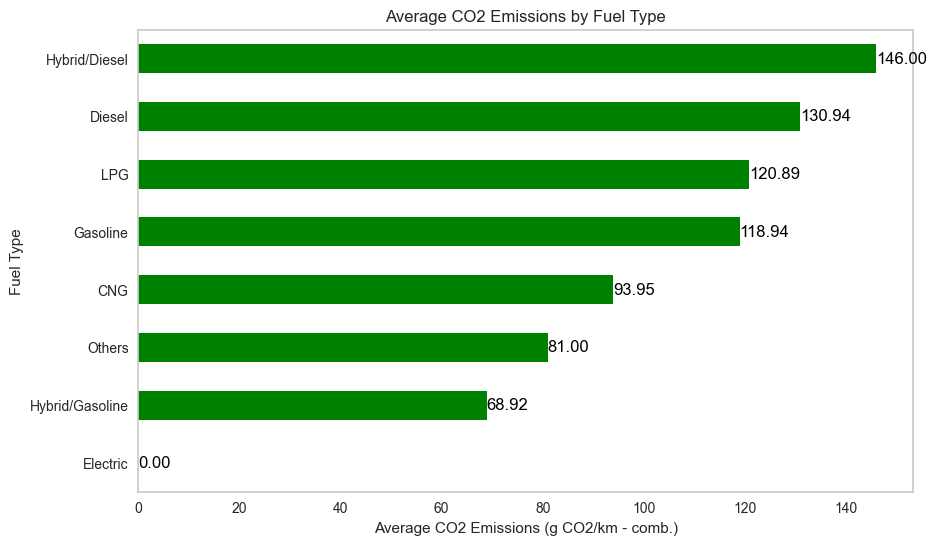

In [14]:
# Create a bar chart to visualize the average CO2 emissions
plt.figure(figsize=(10, 6))
average_co2_emissions.sort_values().plot(kind='barh', color='green')
plt.xlabel('Average CO2 Emissions (g CO2/km - comb.)')
plt.ylabel('Fuel Type')
plt.title('Average CO2 Emissions by Fuel Type')

# Remove gridlines
plt.grid(False)

# Add value labels to the bars
for i, v in enumerate(average_co2_emissions.sort_values()):
    plt.text(v, i, f'{v:.2f}', color='black', va='center')

plt.show()


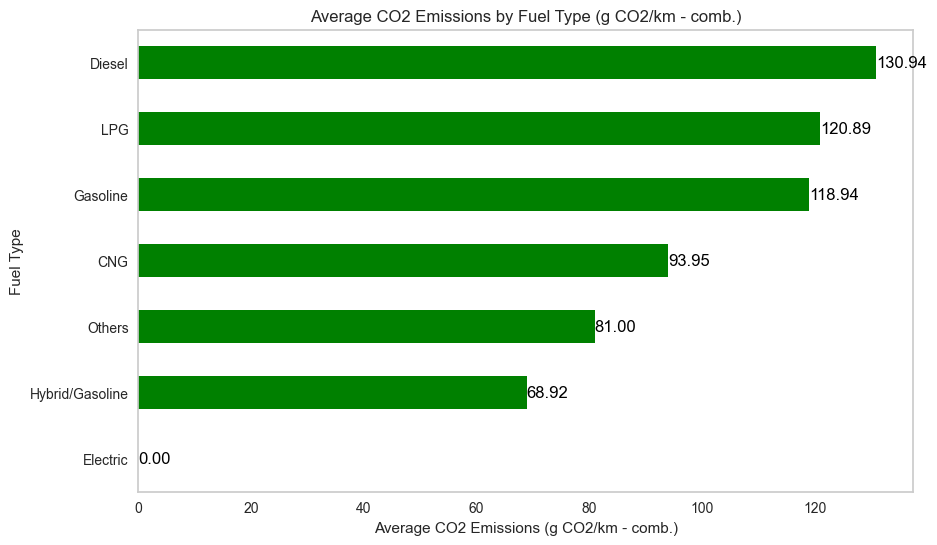

In [9]:
# Filter the average CO2 emissions series to exclude "Hybrid/Diesel" category
average_co2_emissions_filtered = average_co2_emissions[average_co2_emissions.index != "Hybrid/Diesel"]

# Create a bar chart to visualize the average CO2 emissions
plt.figure(figsize=(10, 6))
average_co2_emissions_filtered.sort_values().plot(kind='barh', color='green')
plt.xlabel('Average CO2 Emissions (g CO2/km - comb.)')
plt.ylabel('Fuel Type')
plt.title('Average CO2 Emissions by Fuel Type (g CO2/km - comb.)')

# Remove gridlines
plt.grid(False)

# Add value labels to the bars
for i, v in enumerate(average_co2_emissions_filtered.sort_values()):
    plt.text(v, i, f'{v:.2f}', color='black', va='center')

plt.show()


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">Average Fuel Consumption for Each Year</p>

In [49]:
average_fuel_consumption = data.groupby('Age(years)')['Fuel consumption (l/100km - comb.)'].mean()

print(average_fuel_consumption)


Age(years)
0      4.804143
1      4.757795
2      3.950807
3      4.042008
4      4.674144
5      4.738356
6      4.986538
7      4.875000
8      5.160811
9      5.374138
10     5.283333
11     5.804762
12     5.652632
13     5.755556
14     7.050000
15     6.400000
16     8.028571
17     7.150000
18     6.200000
21    15.400000
23     9.700000
Name: Fuel consumption (l/100km - comb.), dtype: float64


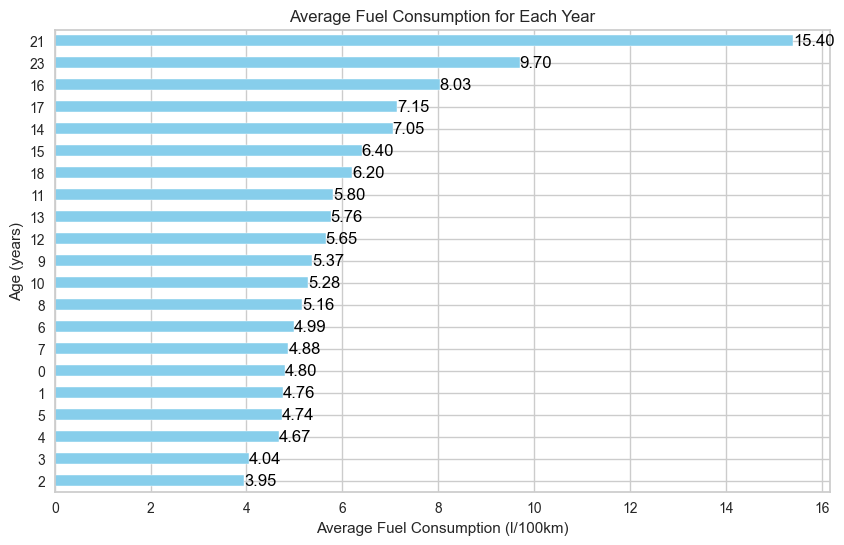

In [50]:

average_fuel_consumption = data.groupby('Age(years)')['Fuel consumption (l/100km - comb.)'].mean()
average_fuel_consumption = average_fuel_consumption.sort_values()  # Sort the values in ascending order

plt.figure(figsize=(10, 6))
ax = average_fuel_consumption.plot(kind='barh', color='skyblue')

# Add value labels to the bars
for i, v in enumerate(average_fuel_consumption):
    ax.text(v, i, f'{v:.2f}', color='black', va='center')

plt.xlabel('Average Fuel Consumption (l/100km)')
plt.ylabel('Age (years)')
plt.title('Average Fuel Consumption for Each Year')
plt.show()


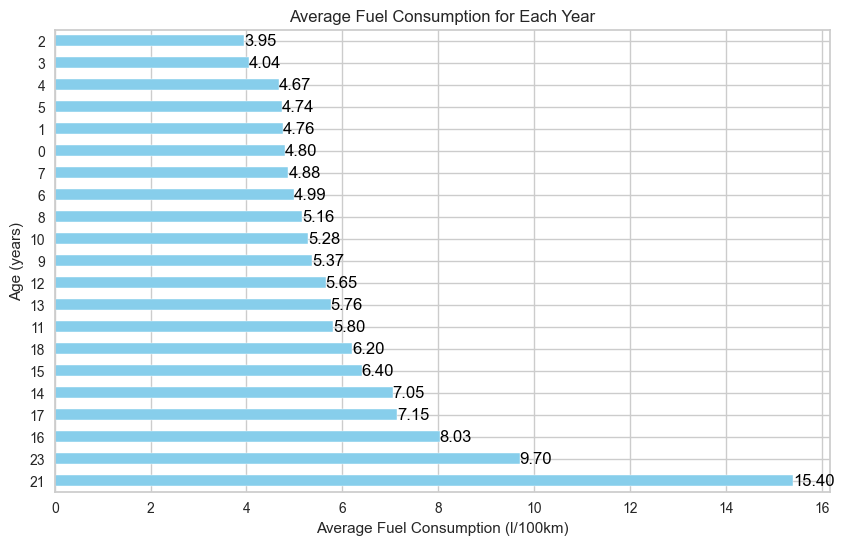

In [51]:
average_fuel_consumption = data.groupby('Age(years)')['Fuel consumption (l/100km - comb.)'].mean()
average_fuel_consumption = average_fuel_consumption.sort_values(ascending=False)  # Sort the values in descending order

plt.figure(figsize=(10, 6))
ax = average_fuel_consumption.plot(kind='barh', color='skyblue')

# Add value labels to the bars
for i, v in enumerate(average_fuel_consumption):
    ax.text(v, i, f'{v:.2f}', color='black', va='center')

plt.xlabel('Average Fuel Consumption (l/100km)')
plt.ylabel('Age (years)')
plt.title('Average Fuel Consumption for Each Year')
plt.show()


In [64]:
# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average fuel consumption for each year
average_fuel_consumption = data.groupby('Year')['Fuel consumption (l/100km - comb.)'].mean()

# Print the average fuel consumption for each year
print(average_fuel_consumption)


Year
2000     9.700000
2002    15.400000
2005     6.200000
2006     7.150000
2007     8.028571
2008     6.400000
2009     7.050000
2010     5.755556
2011     5.652632
2012     5.804762
2013     5.283333
2014     5.374138
2015     5.160811
2016     4.875000
2017     4.986538
2018     4.738356
2019     4.674144
2020     4.042008
2021     3.950807
2022     4.757795
2023     4.804143
Name: Fuel consumption (l/100km - comb.), dtype: float64


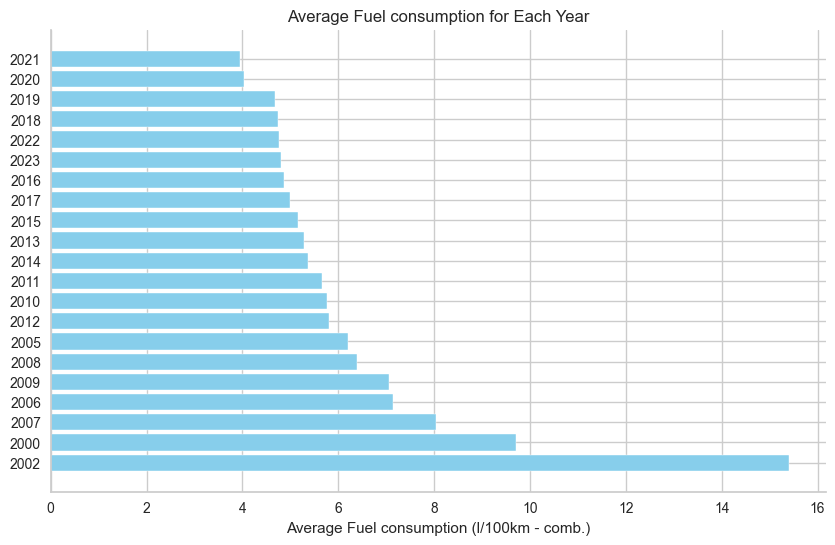

In [68]:

# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average fuel_consumption for each year
average_fuel_consumption = data.groupby('Year')['Fuel consumption (l/100km - comb.)'].mean()

# Sort the average fuel_consumption in ascending order
average_fuel_consumption_sorted = average_fuel_consumption.sort_values()

# Create a horizontal bar plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.barh(range(len(average_fuel_consumption_sorted)), average_fuel_consumption_sorted.values, color='skyblue')

# Set the y-axis ticks and labels
ax.set_yticks(range(len(average_fuel_consumption_sorted)))
ax.set_yticklabels(average_fuel_consumption_sorted.index)

# Set the x-axis label
ax.set_xlabel('Average Fuel consumption (l/100km - comb.)')

# Set the title
ax.set_title('Average Fuel consumption for Each Year')

# Invert the y-axis to show the bars from top to bottom
ax.invert_yaxis()

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the x-axis
ax.tick_params(bottom=False)

plt.show()

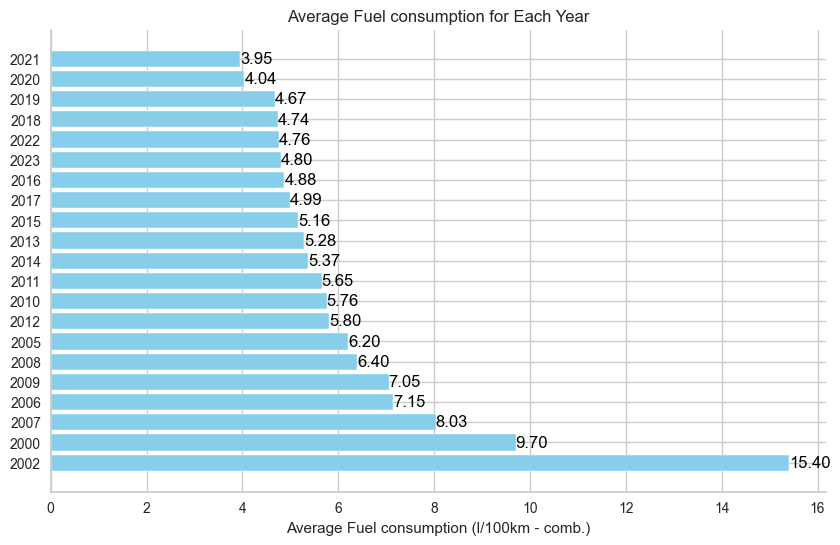

In [69]:

# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average fuel_consumption for each year
average_fuel_consumption = data.groupby('Year')['Fuel consumption (l/100km - comb.)'].mean()

# Sort the average fuel_consumption in ascending order
average_fuel_consumption_sorted = average_fuel_consumption.sort_values()

# Create a horizontal bar plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.barh(range(len(average_fuel_consumption_sorted)), average_fuel_consumption_sorted.values, color='skyblue')

# Set the y-axis ticks and labels
ax.set_yticks(range(len(average_fuel_consumption_sorted)))
ax.set_yticklabels(average_fuel_consumption_sorted.index)

# Set the x-axis label
ax.set_xlabel('Average Fuel consumption (l/100km - comb.)')

# Set the title
ax.set_title('Average Fuel consumption for Each Year')

# Invert the y-axis to show the bars from top to bottom
ax.invert_yaxis()

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the x-axis
ax.tick_params(bottom=False)

# Add values at the end of each bar
for i, bar in enumerate(bars):
    value = average_fuel_consumption_sorted.values[i]
    ax.text(value, i, f'{value:.2f}', va='center', color='black')

plt.show()


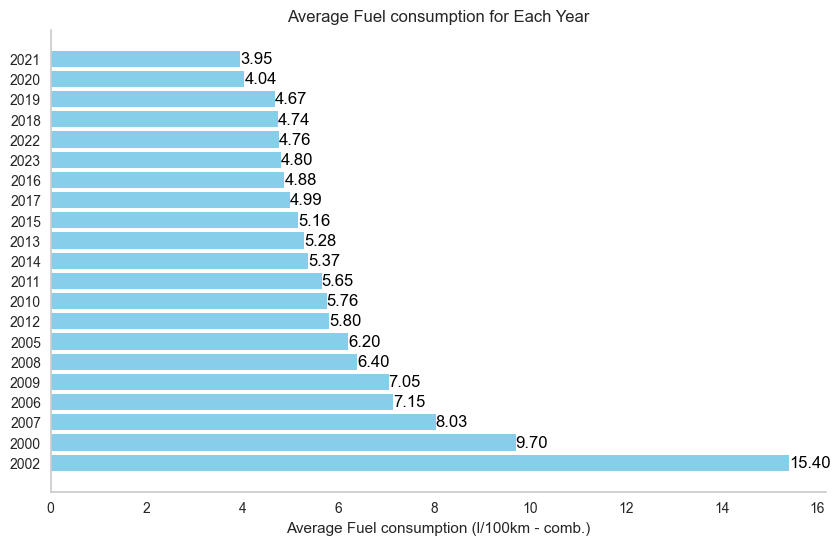

In [5]:
# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average fuel_consumption for each year
average_fuel_consumption = data.groupby('Year')['Fuel consumption (l/100km - comb.)'].mean()

# Sort the average fuel_consumption in ascending order
average_fuel_consumption_sorted = average_fuel_consumption.sort_values()

# Create a horizontal bar plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.barh(range(len(average_fuel_consumption_sorted)), average_fuel_consumption_sorted.values, color='skyblue')

# Set the y-axis ticks and labels
ax.set_yticks(range(len(average_fuel_consumption_sorted)))
ax.set_yticklabels(average_fuel_consumption_sorted.index)

# Set the x-axis label
ax.set_xlabel('Average Fuel consumption (l/100km - comb.)')

# Set the title
ax.set_title('Average Fuel consumption for Each Year')

# Invert the y-axis to show the bars from top to bottom
ax.invert_yaxis()

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the x-axis
ax.tick_params(bottom=False)

# Add values at the end of each bar
for i, bar in enumerate(bars):
    value = average_fuel_consumption_sorted.values[i]
    ax.text(value, i, f'{value:.2f}', va='center', color='black')

# Remove gridlines
ax.grid(False)

plt.show()


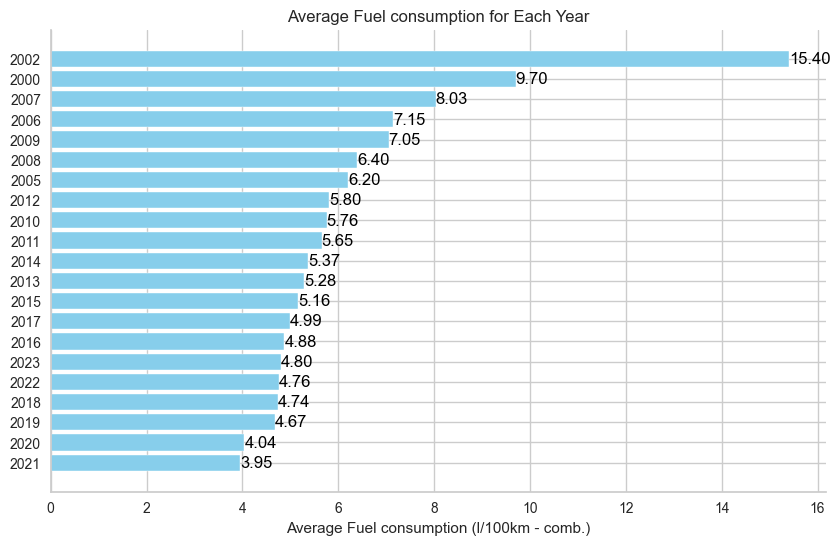

In [70]:

# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average fuel_consumption for each year
average_fuel_consumption = data.groupby('Year')['Fuel consumption (l/100km - comb.)'].mean()

# Sort the average fuel_consumption in ascending order
average_fuel_consumption_sorted = average_fuel_consumption.sort_values(ascending=False)

# Create a horizontal bar plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.barh(range(len(average_fuel_consumption_sorted)), average_fuel_consumption_sorted.values, color='skyblue')

# Set the y-axis ticks and labels
ax.set_yticks(range(len(average_fuel_consumption_sorted)))
ax.set_yticklabels(average_fuel_consumption_sorted.index)

# Set the x-axis label
ax.set_xlabel('Average Fuel consumption (l/100km - comb.)')

# Set the title
ax.set_title('Average Fuel consumption for Each Year')

# Invert the y-axis to show the bars from top to bottom
ax.invert_yaxis()

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the x-axis
ax.tick_params(bottom=False)

# Add values at the end of each bar
for i, bar in enumerate(bars):
    value = average_fuel_consumption_sorted.values[i]
    ax.text(value, i, f'{value:.2f}', va='center', color='black')

plt.show()


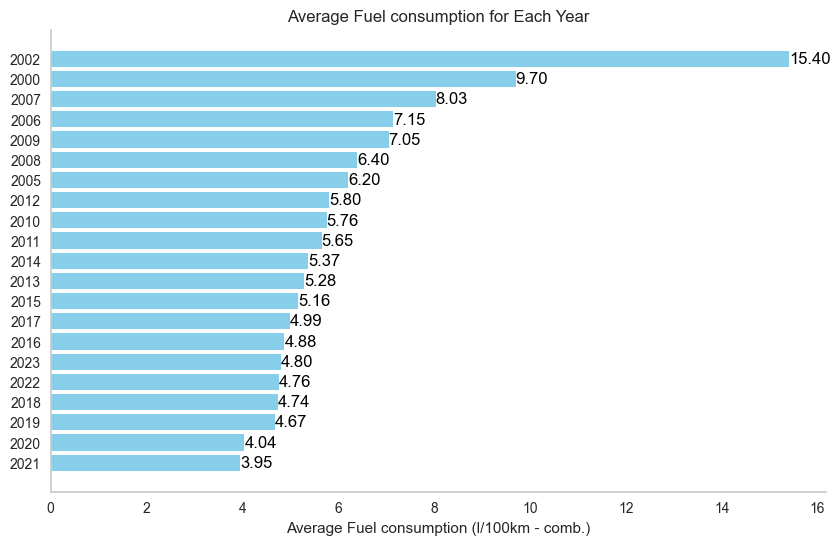

In [4]:

# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average fuel_consumption for each year
average_fuel_consumption = data.groupby('Year')['Fuel consumption (l/100km - comb.)'].mean()

# Sort the average fuel_consumption in ascending order
average_fuel_consumption_sorted = average_fuel_consumption.sort_values(ascending=False)

# Create a horizontal bar plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.barh(range(len(average_fuel_consumption_sorted)), average_fuel_consumption_sorted.values, color='skyblue')

# Set the y-axis ticks and labels
ax.set_yticks(range(len(average_fuel_consumption_sorted)))
ax.set_yticklabels(average_fuel_consumption_sorted.index)

# Set the x-axis label
ax.set_xlabel('Average Fuel consumption (l/100km - comb.)')

# Set the title
ax.set_title('Average Fuel consumption for Each Year')

# Invert the y-axis to show the bars from top to bottom
ax.invert_yaxis()

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the x-axis
ax.tick_params(bottom=False)

# Add values at the end of each bar
for i, bar in enumerate(bars):
    value = average_fuel_consumption_sorted.values[i]
    ax.text(value, i, f'{value:.2f}', va='center', color='black')

# Remove gridlines
ax.grid(False)

plt.show()


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">Average CO2 Emissions for Each Year</p>

In [52]:
average_co2_emissions = data.groupby('Age(years)')['CO2 emissions (g CO2/km - comb.)'].mean()

print(average_co2_emissions)


Age(years)
0     110.035656
1     108.578342
2      86.849123
3      93.979923
4     109.929278
5     110.870841
6     117.012821
7     114.660000
8     123.581081
9     128.051724
10    126.194444
11    137.190476
12    135.631579
13    138.111111
14    167.625000
15    159.500000
16    202.142857
17    187.500000
18    147.000000
21    366.000000
23    232.000000
Name: CO2 emissions (g CO2/km - comb.), dtype: float64


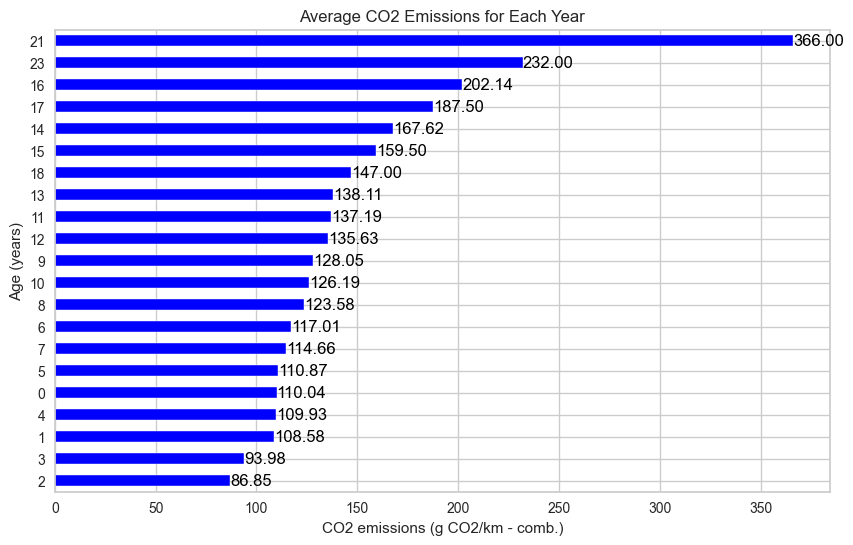

In [54]:

average_fuel_consumption = data.groupby('Age(years)')['CO2 emissions (g CO2/km - comb.)'].mean()
average_fuel_consumption = average_fuel_consumption.sort_values()  # Sort the values in ascending order

plt.figure(figsize=(10, 6))
ax = average_fuel_consumption.plot(kind='barh', color='blue')

# Add value labels to the bars
for i, v in enumerate(average_fuel_consumption):
    ax.text(v, i, f'{v:.2f}', color='black', va='center')

plt.xlabel('CO2 emissions (g CO2/km - comb.)')
plt.ylabel('Age (years)')
plt.title('Average CO2 Emissions for Each Year')
plt.show()

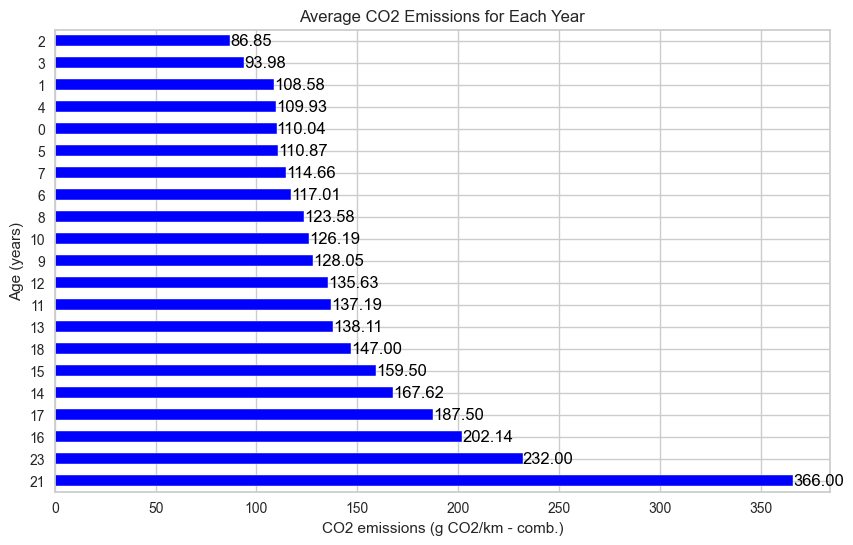

In [55]:

average_fuel_consumption = data.groupby('Age(years)')['CO2 emissions (g CO2/km - comb.)'].mean()
average_fuel_consumption = average_fuel_consumption.sort_values(ascending=False)  # Sort the values in ascending order

plt.figure(figsize=(10, 6))
ax = average_fuel_consumption.plot(kind='barh', color='blue')

# Add value labels to the bars
for i, v in enumerate(average_fuel_consumption):
    ax.text(v, i, f'{v:.2f}', color='black', va='center')

plt.xlabel('CO2 emissions (g CO2/km - comb.)')
plt.ylabel('Age (years)')
plt.title('Average CO2 Emissions for Each Year')
plt.show()

In [58]:
# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average CO2 emissions for each year
average_co2_emissions = data.groupby('Year')['CO2 emissions (g CO2/km - comb.)'].mean()

# Print the average CO2 emissions for each year
print(average_co2_emissions)


Year
2000    232.000000
2002    366.000000
2005    147.000000
2006    187.500000
2007    202.142857
2008    159.500000
2009    167.625000
2010    138.111111
2011    135.631579
2012    137.190476
2013    126.194444
2014    128.051724
2015    123.581081
2016    114.660000
2017    117.012821
2018    110.870841
2019    109.929278
2020     93.979923
2021     86.849123
2022    108.578342
2023    110.035656
Name: CO2 emissions (g CO2/km - comb.), dtype: float64


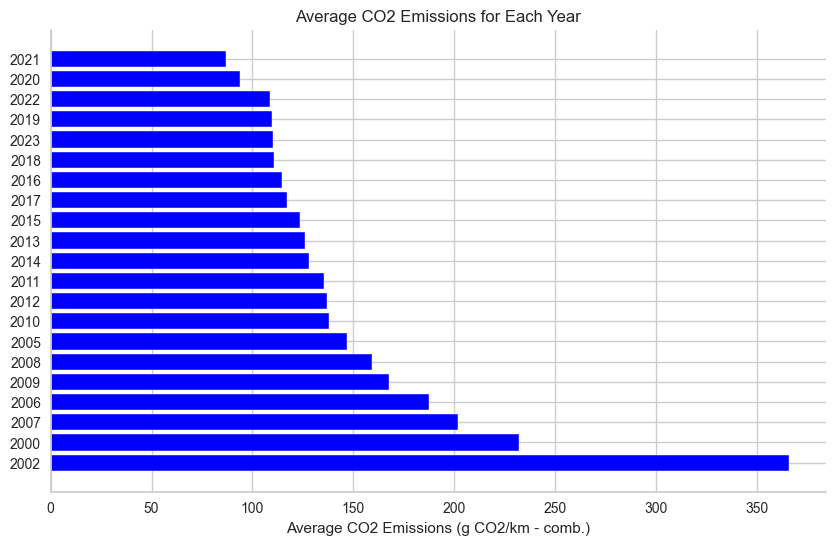

In [61]:


# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average CO2 emissions for each year
average_co2_emissions = data.groupby('Year')['CO2 emissions (g CO2/km - comb.)'].mean()

# Sort the average CO2 emissions in ascending order
average_co2_emissions_sorted = average_co2_emissions.sort_values()

# Create a horizontal bar plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.barh(range(len(average_co2_emissions_sorted)), average_co2_emissions_sorted.values, color='blue')

# Set the y-axis ticks and labels
ax.set_yticks(range(len(average_co2_emissions_sorted)))
ax.set_yticklabels(average_co2_emissions_sorted.index)

# Set the x-axis label
ax.set_xlabel('Average CO2 Emissions (g CO2/km - comb.)')

# Set the title
ax.set_title('Average CO2 Emissions for Each Year')

# Invert the y-axis to show the bars from top to bottom
ax.invert_yaxis()

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the x-axis
ax.tick_params(bottom=False)

plt.show()



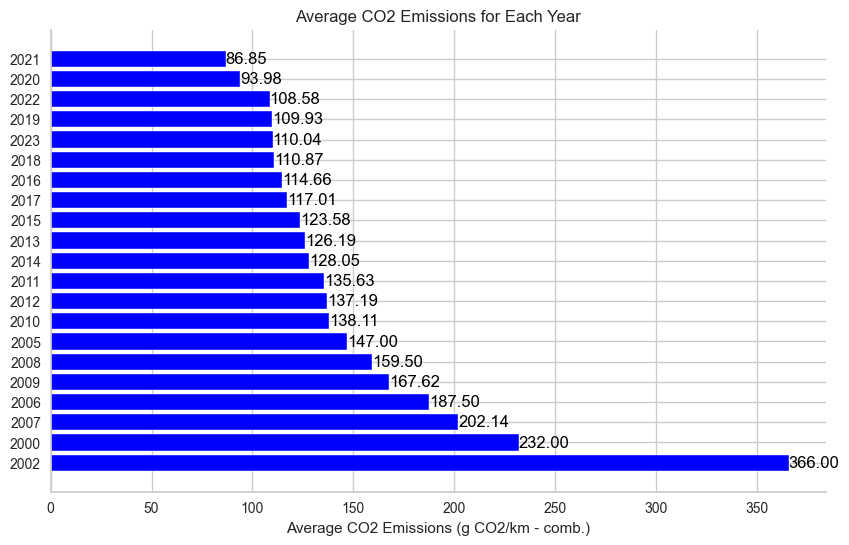

In [62]:
# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average CO2 emissions for each year
average_co2_emissions = data.groupby('Year')['CO2 emissions (g CO2/km - comb.)'].mean()

# Sort the average CO2 emissions in ascending order
average_co2_emissions_sorted = average_co2_emissions.sort_values()

# Create a horizontal bar plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.barh(range(len(average_co2_emissions_sorted)), average_co2_emissions_sorted.values, color='blue')

# Set the y-axis ticks and labels
ax.set_yticks(range(len(average_co2_emissions_sorted)))
ax.set_yticklabels(average_co2_emissions_sorted.index)

# Set the x-axis label
ax.set_xlabel('Average CO2 Emissions (g CO2/km - comb.)')

# Set the title
ax.set_title('Average CO2 Emissions for Each Year')

# Invert the y-axis to show the bars from top to bottom
ax.invert_yaxis()

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the x-axis
ax.tick_params(bottom=False)

# Add values at the end of each bar
for i, bar in enumerate(bars):
    value = average_co2_emissions_sorted.values[i]
    ax.text(value, i, f'{value:.2f}', va='center', color='black')

plt.show()


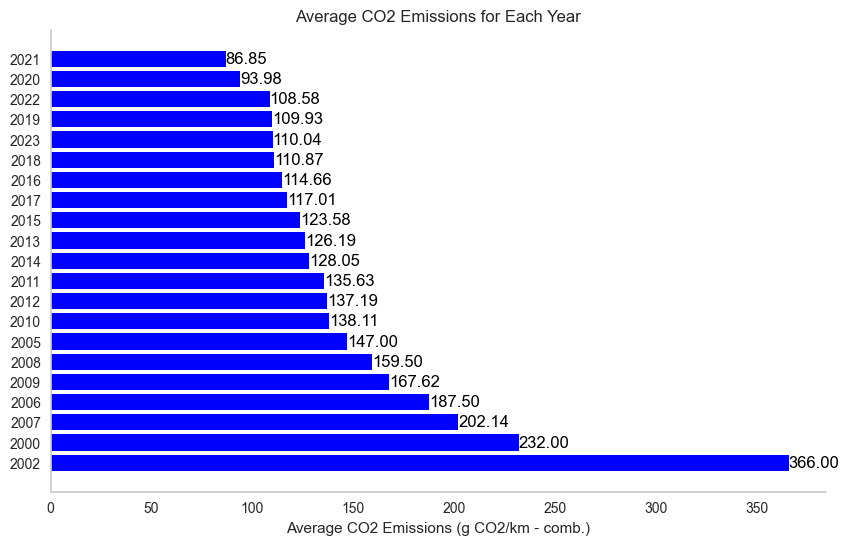

In [6]:
# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average CO2 emissions for each year
average_co2_emissions = data.groupby('Year')['CO2 emissions (g CO2/km - comb.)'].mean()

# Sort the average CO2 emissions in ascending order
average_co2_emissions_sorted = average_co2_emissions.sort_values()

# Create a horizontal bar plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.barh(range(len(average_co2_emissions_sorted)), average_co2_emissions_sorted.values, color='blue')

# Set the y-axis ticks and labels
ax.set_yticks(range(len(average_co2_emissions_sorted)))
ax.set_yticklabels(average_co2_emissions_sorted.index)

# Set the x-axis label
ax.set_xlabel('Average CO2 Emissions (g CO2/km - comb.)')

# Set the title
ax.set_title('Average CO2 Emissions for Each Year')

# Invert the y-axis to show the bars from top to bottom
ax.invert_yaxis()

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the x-axis
ax.tick_params(bottom=False)

# Remove gridlines
ax.grid(False)

# Add values at the end of each bar
for i, bar in enumerate(bars):
    value = average_co2_emissions_sorted.values[i]
    ax.text(value, i, f'{value:.2f}', va='center', color='black')

plt.show()


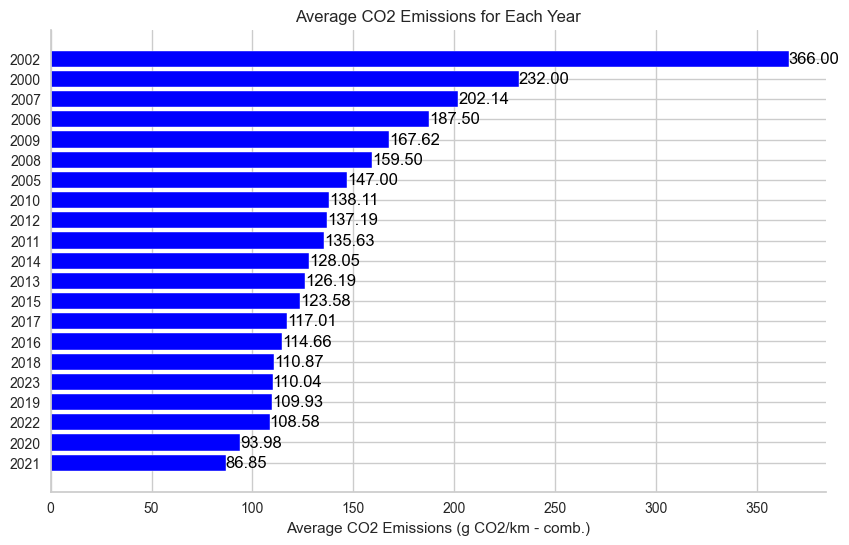

In [63]:
# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average CO2 emissions for each year
average_co2_emissions = data.groupby('Year')['CO2 emissions (g CO2/km - comb.)'].mean()

# Sort the average CO2 emissions in ascending order
average_co2_emissions_sorted = average_co2_emissions.sort_values(ascending=False)

# Create a horizontal bar plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.barh(range(len(average_co2_emissions_sorted)), average_co2_emissions_sorted.values, color='blue')

# Set the y-axis ticks and labels
ax.set_yticks(range(len(average_co2_emissions_sorted)))
ax.set_yticklabels(average_co2_emissions_sorted.index)

# Set the x-axis label
ax.set_xlabel('Average CO2 Emissions (g CO2/km - comb.)')

# Set the title
ax.set_title('Average CO2 Emissions for Each Year')

# Invert the y-axis to show the bars from top to bottom
ax.invert_yaxis()

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the x-axis
ax.tick_params(bottom=False)

# Add values at the end of each bar
for i, bar in enumerate(bars):
    value = average_co2_emissions_sorted.values[i]
    ax.text(value, i, f'{value:.2f}', va='center', color='black')

plt.show()


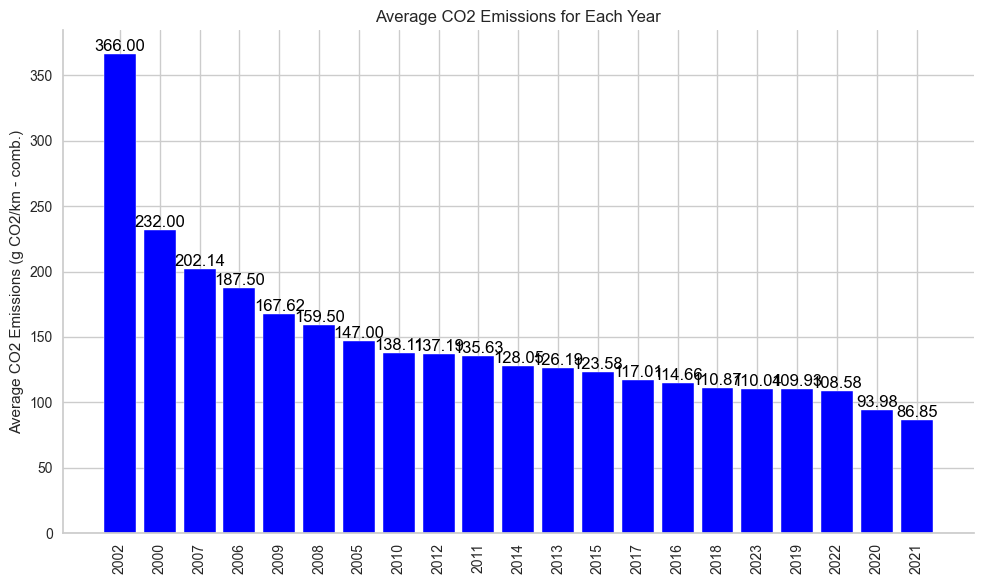

In [75]:
# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average CO2 emissions for each year
average_co2_emissions = data.groupby('Year')['CO2 emissions (g CO2/km - comb.)'].mean()

# Sort the average CO2 emissions in ascending order
average_co2_emissions_sorted = average_co2_emissions.sort_values(ascending=False)

# Create a vertical bar plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.bar(range(len(average_co2_emissions_sorted)), average_co2_emissions_sorted.values, color='blue')

# Set the x-axis ticks and labels
ax.set_xticks(range(len(average_co2_emissions_sorted)))
ax.set_xticklabels(average_co2_emissions_sorted.index, rotation=90)

# Set the y-axis label
ax.set_ylabel('Average CO2 Emissions (g CO2/km - comb.)')

# Set the title
ax.set_title('Average CO2 Emissions for Each Year')

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the y-axis
ax.tick_params(left=False)

# Add values at the end of each bar
for i, bar in enumerate(bars):
    value = average_co2_emissions_sorted.values[i]
    ax.text(i, value, f'{value:.2f}', ha='center', va='bottom', color='black')

plt.tight_layout()
plt.show()


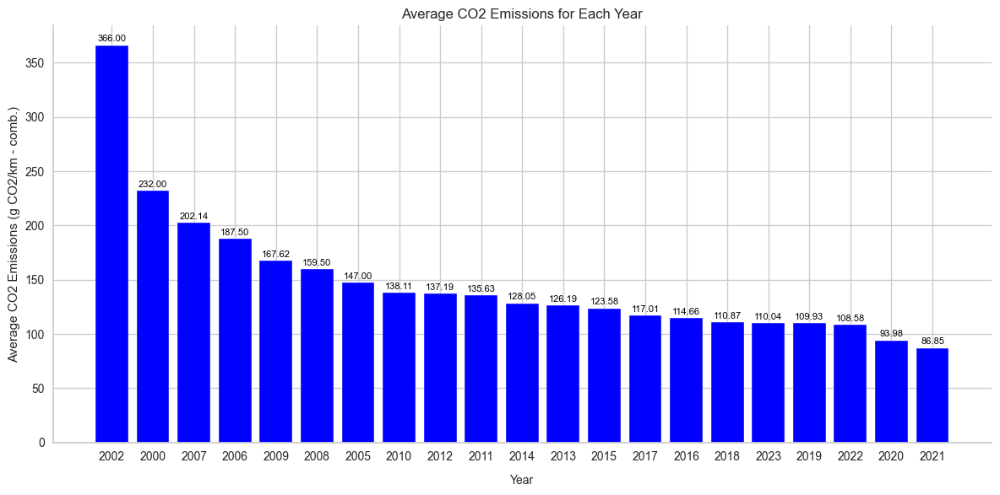

In [76]:
# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average CO2 emissions for each year
average_co2_emissions = data.groupby('Year')['CO2 emissions (g CO2/km - comb.)'].mean()

# Sort the average CO2 emissions in ascending order
average_co2_emissions_sorted = average_co2_emissions.sort_values(ascending=False)

# Create a vertical bar plot with wider bars
fig, ax = plt.subplots(figsize=(12, 6))
bars = ax.bar(range(len(average_co2_emissions_sorted)), average_co2_emissions_sorted.values, width=0.8, color='blue')

# Set the x-axis ticks and labels
ax.set_xticks(range(len(average_co2_emissions_sorted)))
ax.set_xticklabels(average_co2_emissions_sorted.index, rotation=0)

# Set the y-axis label
ax.set_ylabel('Average CO2 Emissions (g CO2/km - comb.)')

# Set the title
ax.set_title('Average CO2 Emissions for Each Year')

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the y-axis
ax.tick_params(left=False)

# Add values above each bar with smaller font size
for i, bar in enumerate(bars):
    value = average_co2_emissions_sorted.values[i]
    ax.text(i, value + 2, f'{value:.2f}', ha='center', va='bottom', fontsize=8, color='black')

# Add a horizontal label for years
ax.text(0.5, -0.1, 'Year', transform=ax.transAxes, ha='center', fontsize=10)

plt.tight_layout()
plt.show()


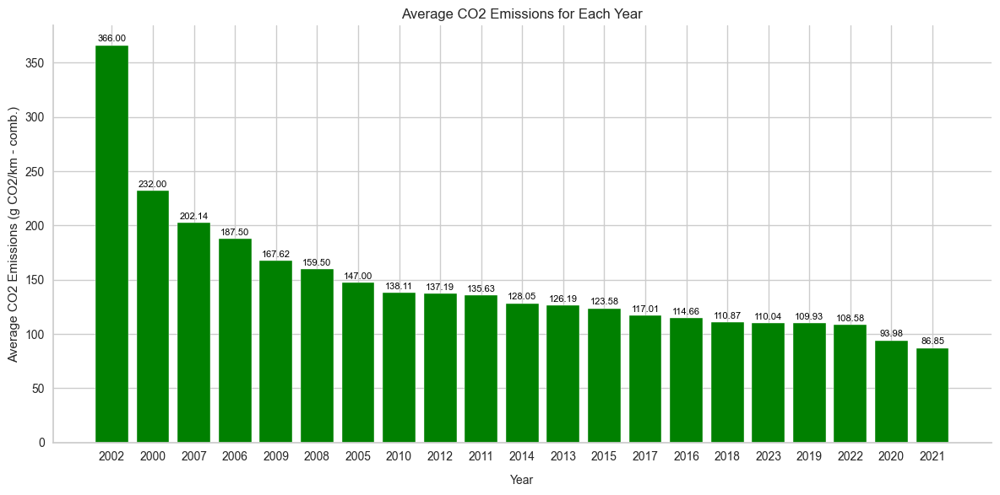

In [77]:
# Extract the year from the "Year of production" column
data['Year'] = pd.to_datetime(data['Year of production']).dt.year

# Calculate the average CO2 emissions for each year
average_co2_emissions = data.groupby('Year')['CO2 emissions (g CO2/km - comb.)'].mean()

# Sort the average CO2 emissions in ascending order
average_co2_emissions_sorted = average_co2_emissions.sort_values(ascending=False)

# Create a vertical bar plot with wider bars
fig, ax = plt.subplots(figsize=(12, 6))
bars = ax.bar(range(len(average_co2_emissions_sorted)), average_co2_emissions_sorted.values, width=0.8, color='green')

# Set the x-axis ticks and labels
ax.set_xticks(range(len(average_co2_emissions_sorted)))
ax.set_xticklabels(average_co2_emissions_sorted.index, rotation=0)

# Set the y-axis label
ax.set_ylabel('Average CO2 Emissions (g CO2/km - comb.)')

# Set the title
ax.set_title('Average CO2 Emissions for Each Year')

# Remove spines (borders) from the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Hide tick marks on the y-axis
ax.tick_params(left=False)

# Add values above each bar with smaller font size
for i, bar in enumerate(bars):
    value = average_co2_emissions_sorted.values[i]
    ax.text(i, value + 2, f'{value:.2f}', ha='center', va='bottom', fontsize=8, color='black')

# Add a horizontal label for years
ax.text(0.5, -0.1, 'Year', transform=ax.transAxes, ha='center', fontsize=10)

plt.tight_layout()
plt.show()


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">FREQUENCY DISTRIBUTION OF NUMERICAL VARIABLES</p>

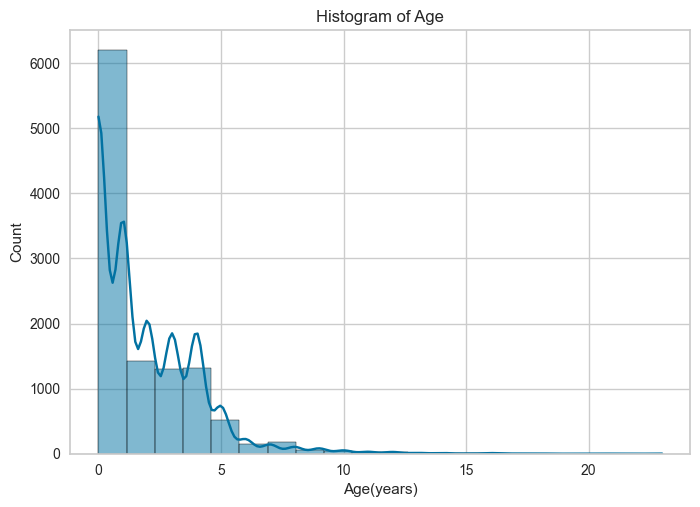

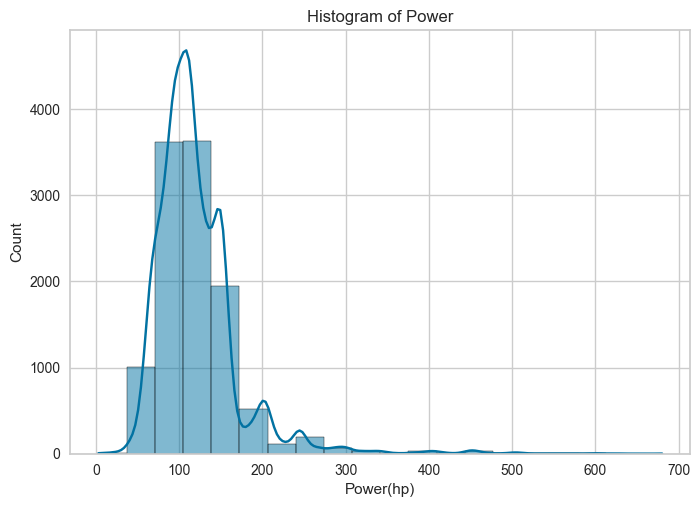

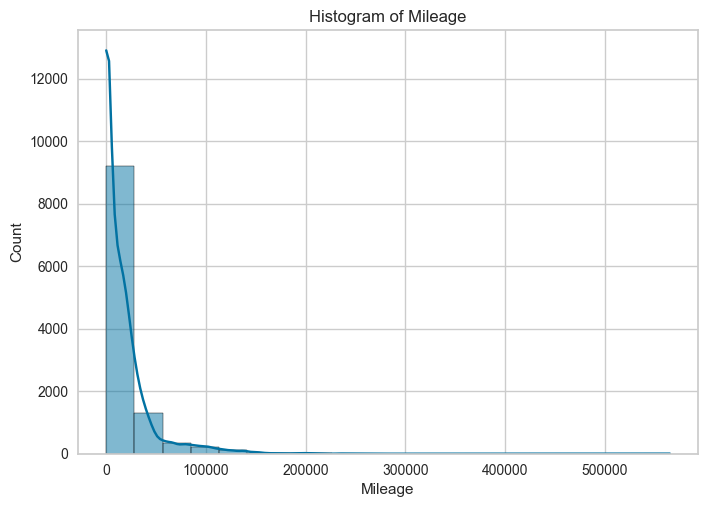

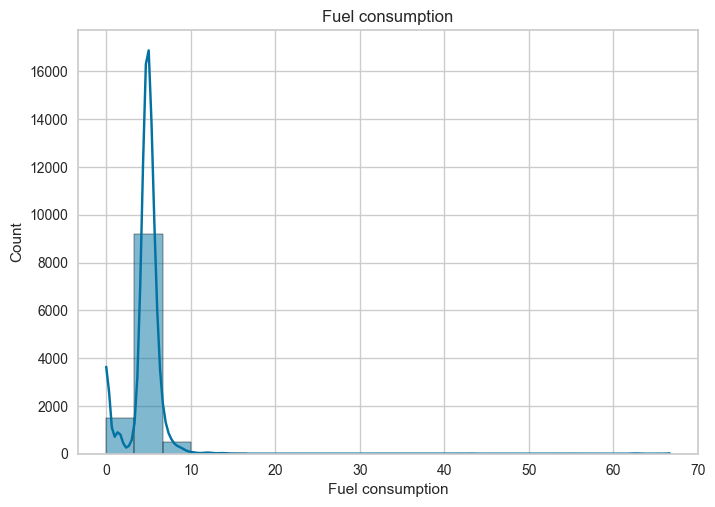

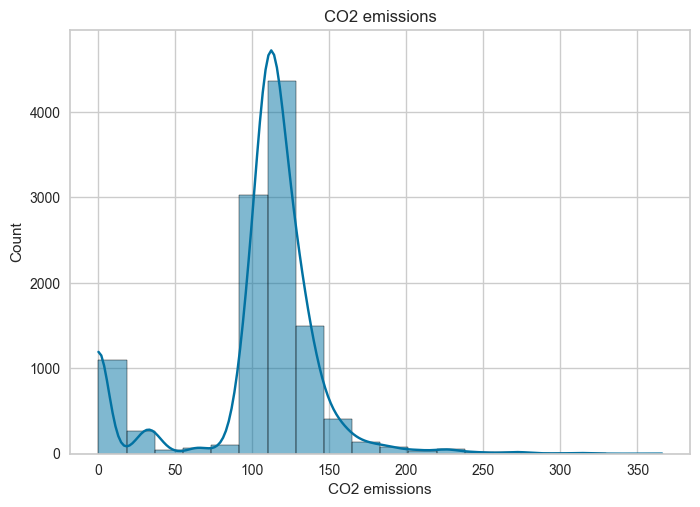

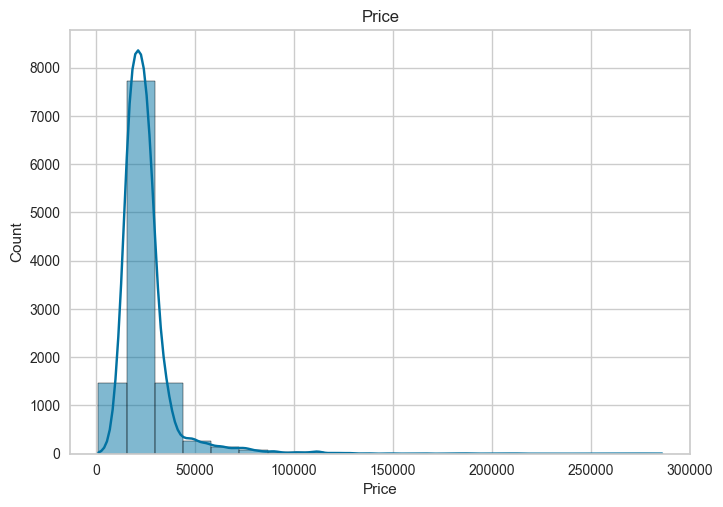

In [60]:
# Histogram for Age(years)
sns.histplot(data=data, x='Age(years)', bins=20, kde=True)
plt.title('Histogram of Age')
plt.xlabel('Age(years)')
plt.ylabel('Count')
plt.show()

# Histogram for Power(hp)
sns.histplot(data=data, x='Power(hp)', bins=20, kde=True)
plt.title('Histogram of Power')
plt.xlabel('Power(hp)')
plt.ylabel('Count')
plt.show()

# Histogram for Mileage(km)
sns.histplot(data=data, x='Mileage(km)', bins=20, kde=True)
plt.title('Histogram of Mileage')
plt.xlabel('Mileage')
plt.ylabel('Count')
plt.show()

# Histogram for Fuel consumption (l/100km - comb.)
sns.histplot(data=data, x='Fuel consumption (l/100km - comb.)', bins=20, kde=True)
plt.title('Fuel consumption')
plt.xlabel('Fuel consumption')
plt.ylabel('Count')
plt.show()

# Histogram for CO2 emissions (g CO2/km - comb.)
sns.histplot(data=data, x='CO2 emissions (g CO2/km - comb.)', bins=20, kde=True)
plt.title('CO2 emissions')
plt.xlabel('CO2 emissions')
plt.ylabel('Count')
plt.show()

# Histogram for Price(€)
sns.histplot(data=data, x='Price(€)', bins=20, kde=True)
plt.title('Price')
plt.xlabel('Price')
plt.ylabel('Count')
plt.show()

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">AGE</p>

<Axes: xlabel='Age(years)', ylabel='Density'>

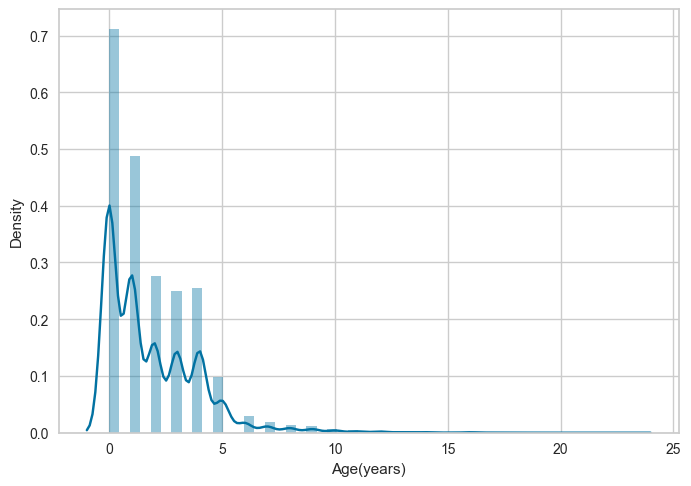

In [61]:
sns.distplot(data['Age(years)'])

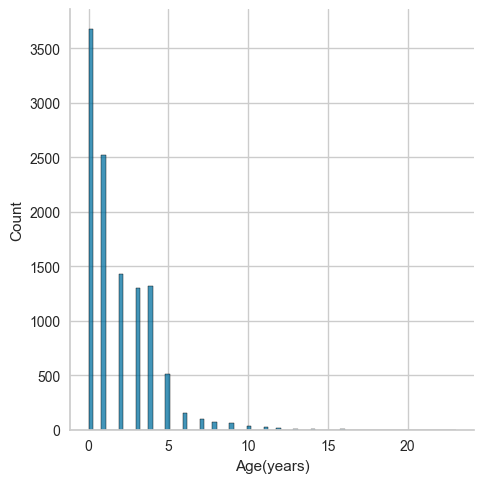

In [62]:
sns.displot(data['Age(years)'])

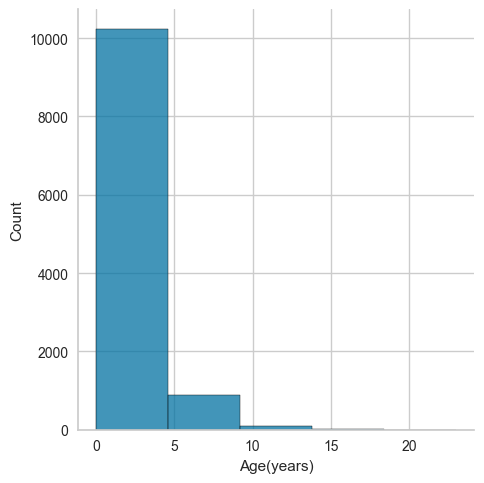

In [63]:
sns.displot(data['Age(years)'], bins=5)

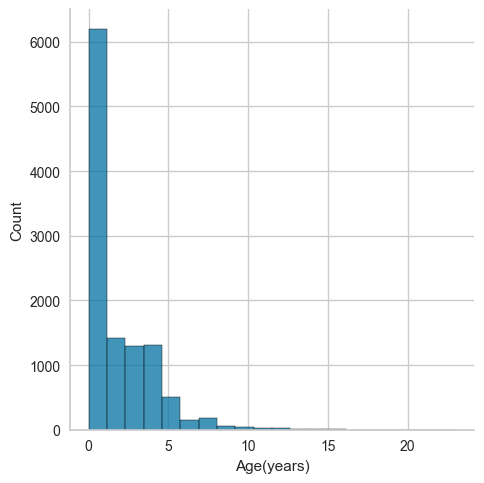

In [64]:
sns.displot(data['Age(years)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">POWER</p>

<Axes: xlabel='Power(hp)', ylabel='Density'>

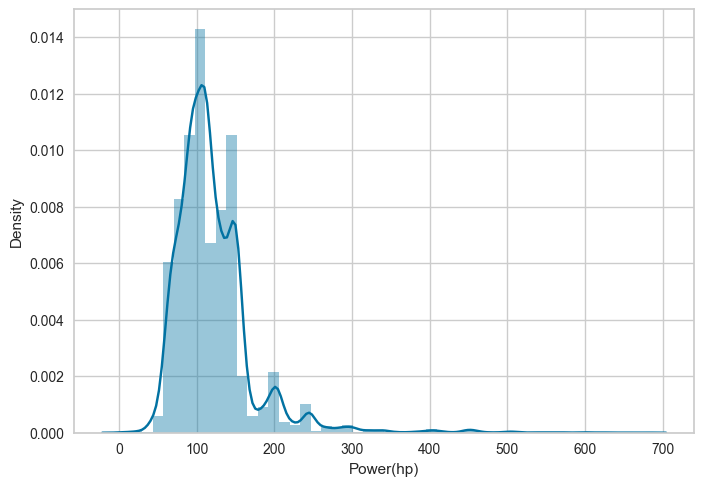

In [65]:
sns.distplot(data['Power(hp)'])

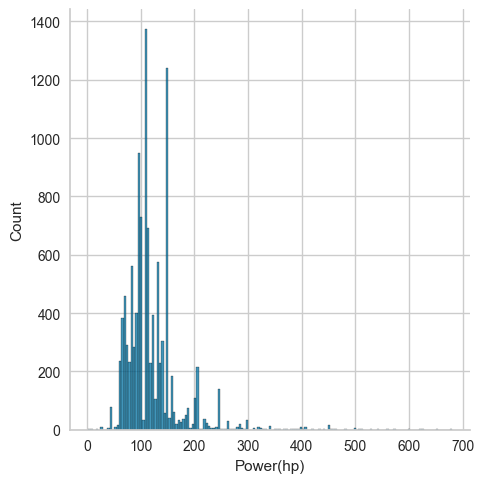

In [66]:
sns.displot(data['Power(hp)'])

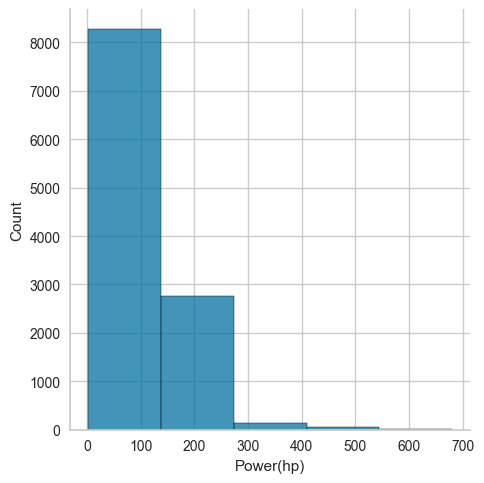

In [67]:
sns.displot(data['Power(hp)'], bins=5)

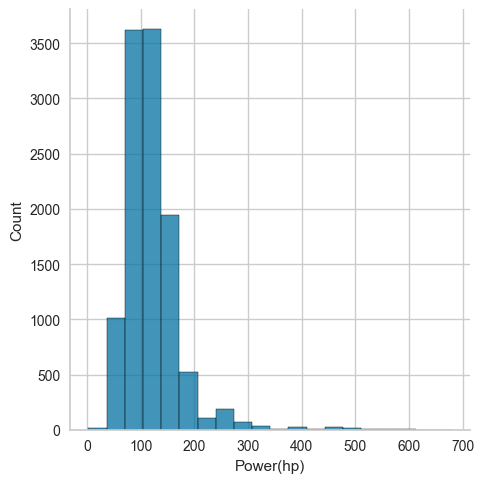

In [68]:
sns.displot(data['Power(hp)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">MILEAGE</p>

<Axes: xlabel='Mileage(km)', ylabel='Density'>

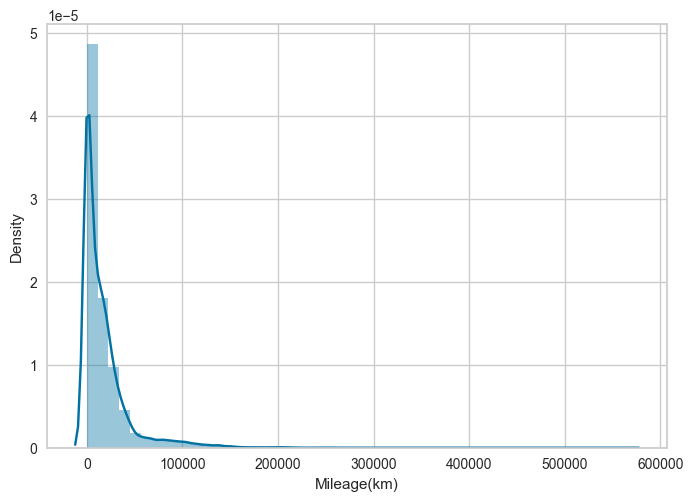

In [69]:
sns.distplot(data['Mileage(km)'])

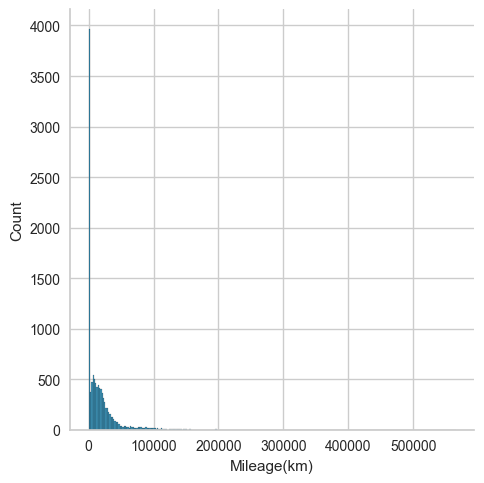

In [70]:
sns.displot(data['Mileage(km)'])

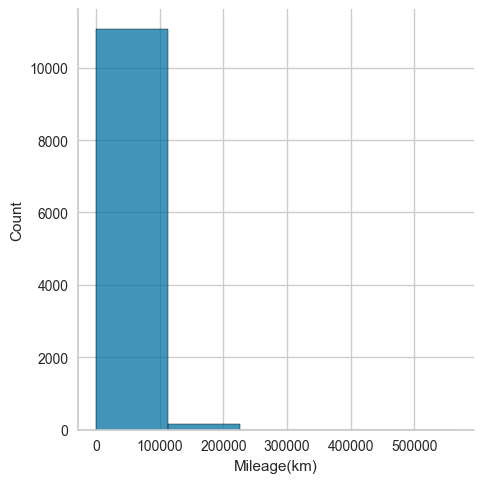

In [71]:
sns.displot(data['Mileage(km)'], bins=5)

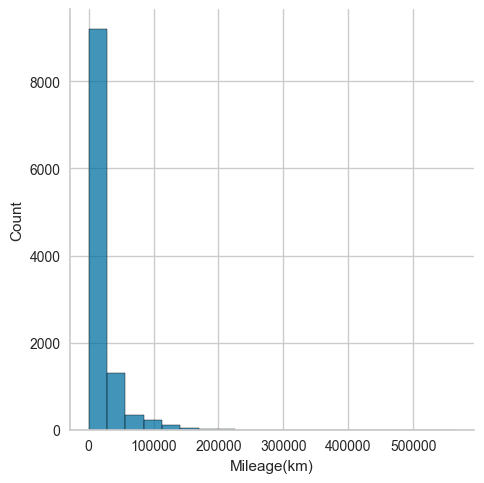

In [72]:
sns.displot(data['Mileage(km)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">FUEL CONSUMPTION</p>

<Axes: xlabel='Fuel consumption (l/100km - comb.)', ylabel='Density'>

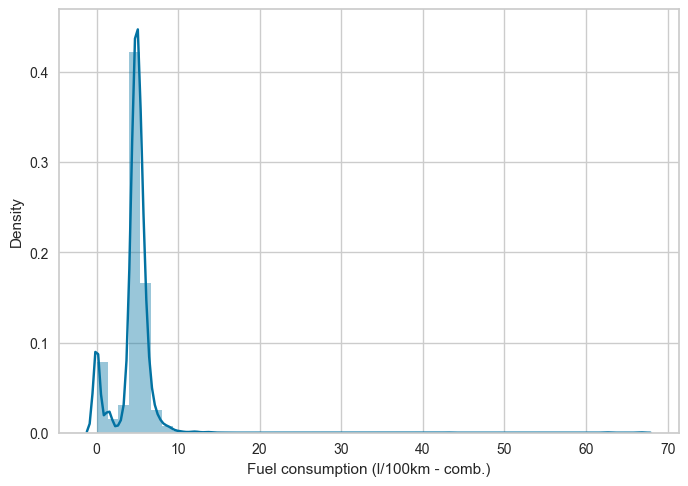

In [73]:
sns.distplot(data['Fuel consumption (l/100km - comb.)'])

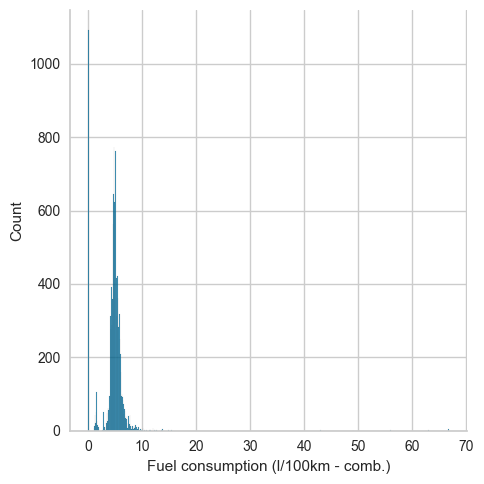

In [74]:
sns.displot(data['Fuel consumption (l/100km - comb.)'])

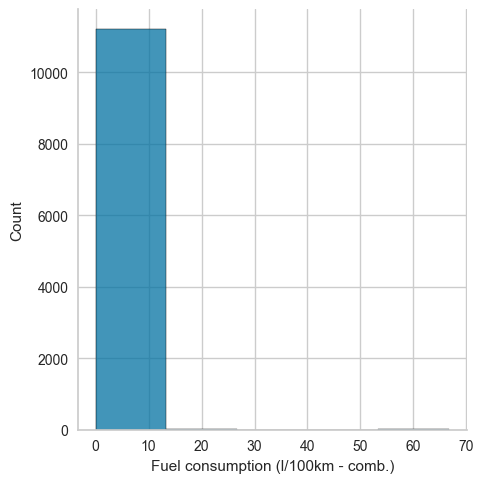

In [75]:
sns.displot(data['Fuel consumption (l/100km - comb.)'], bins=5)

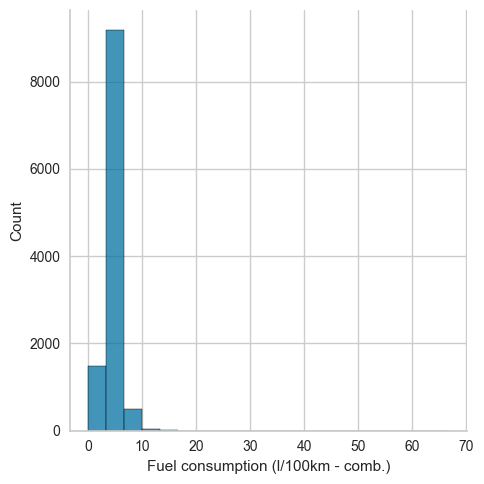

In [76]:
sns.displot(data['Fuel consumption (l/100km - comb.)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">CO2 emissions</p>

<Axes: xlabel='CO2 emissions (g CO2/km - comb.)', ylabel='Density'>

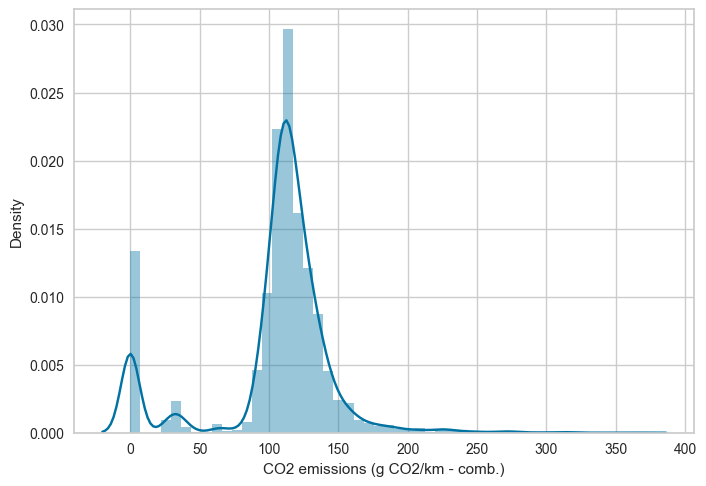

In [77]:
sns.distplot(data['CO2 emissions (g CO2/km - comb.)'])

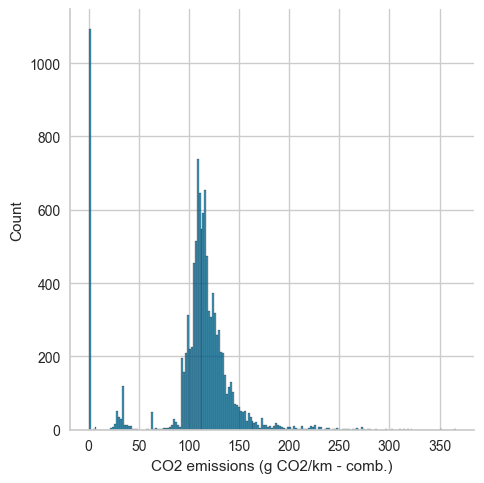

In [78]:
sns.displot(data['CO2 emissions (g CO2/km - comb.)'])

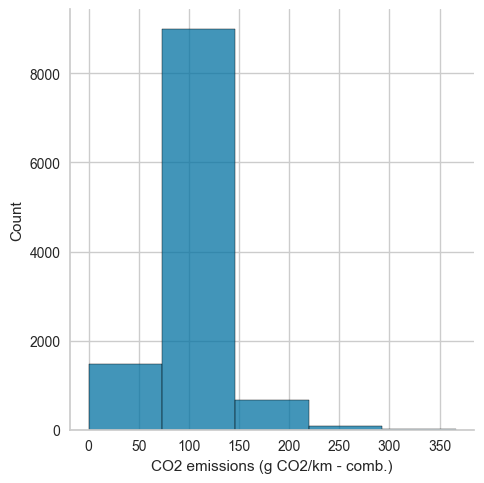

In [79]:
sns.displot(data['CO2 emissions (g CO2/km - comb.)'], bins=5)

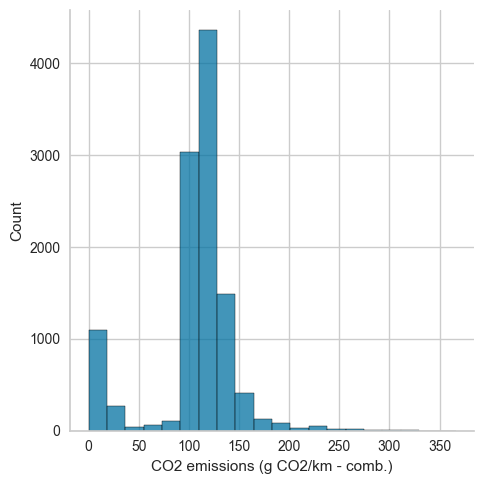

In [80]:
sns.displot(data['CO2 emissions (g CO2/km - comb.)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">PRICE</p>

<Axes: xlabel='Price(€)', ylabel='Density'>

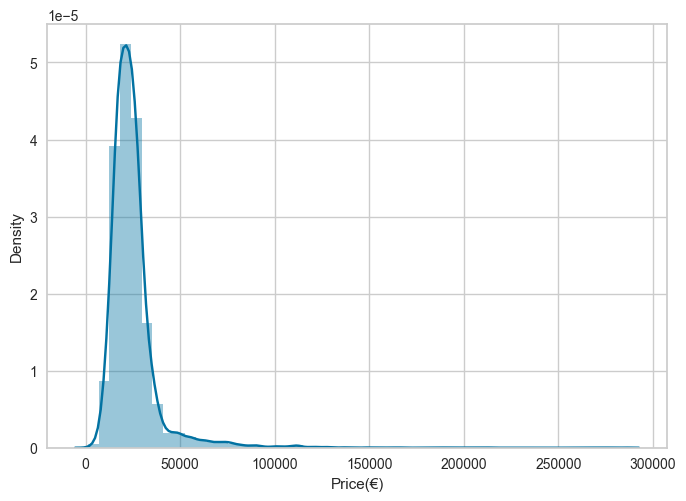

In [81]:
sns.distplot(data['Price(€)'])

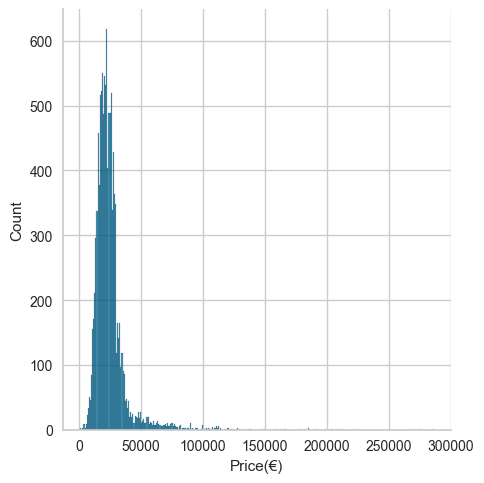

In [82]:
sns.displot(data['Price(€)'])

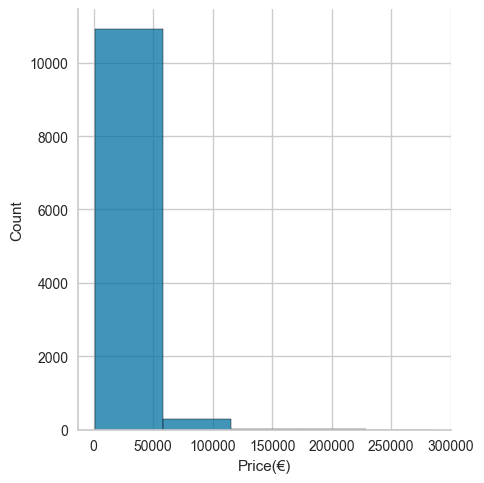

In [83]:
sns.displot(data['Price(€)'], bins=5)

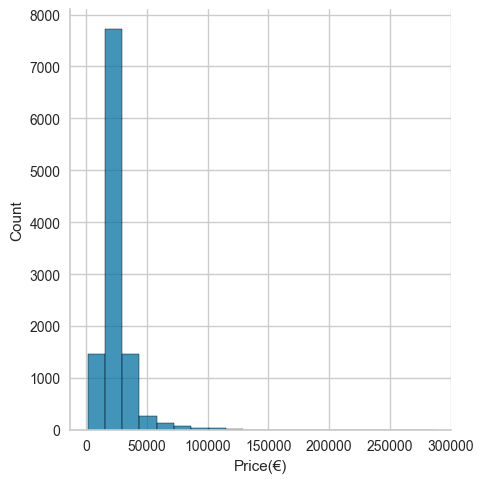

In [84]:
sns.displot(data['Price(€)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">PARAMETERS OF NUMERICAL VARIABLES </p>

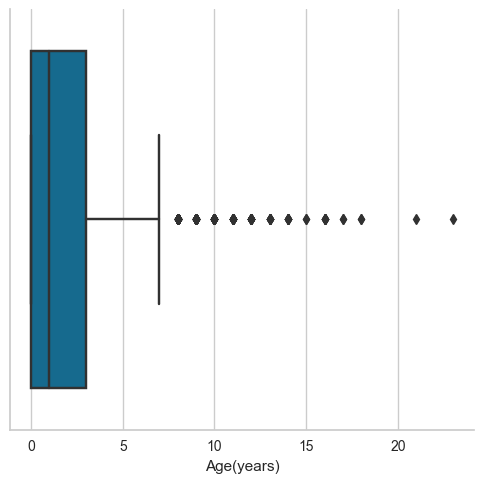

In [85]:
sns.catplot(x='Age(years)', kind= 'box', data= data)

In [86]:
# Use describe() method to get summary statistics of the Age(years) column
desc = data['Age(years)'].describe()

# Print the summary statistics
print(desc)

count    11237.00000
mean         1.87995
std          2.11647
min          0.00000
25%          0.00000
50%          1.00000
75%          3.00000
max         23.00000
Name: Age(years), dtype: float64


In [87]:
# Compute summary statistics of the Age(years) column
mileage_stats = data['Age(years)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  7.5


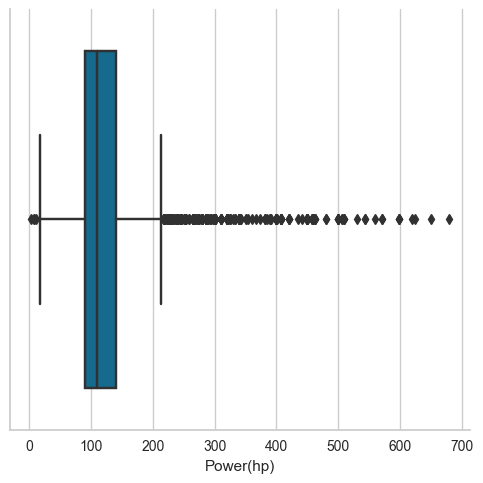

In [88]:
sns.catplot(x='Power(hp)', kind= 'box', data= data)

In [89]:
# Use describe() method to get summary statistics of the Power(hp) column
desc = data['Power(hp)'].describe()

# Print the summary statistics
print(desc)

count    11237.000000
mean       121.020201
std         52.436057
min          3.000000
25%         91.000000
50%        110.000000
75%        140.000000
max        680.000000
Name: Power(hp), dtype: float64


In [90]:
# Compute summary statistics of the Power(hp) column
mileage_stats = data['Power(hp)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)


Upper whisker:  213.5


In [91]:
# Compute summary statistics of the Power(hp) column
mileage_stats = data['Power(hp)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the lower whisker
lower_whisker = Q1 - 1.5 * IQR

# Print the lower whisker
print("Lower whisker: ", lower_whisker)


Lower whisker:  17.5


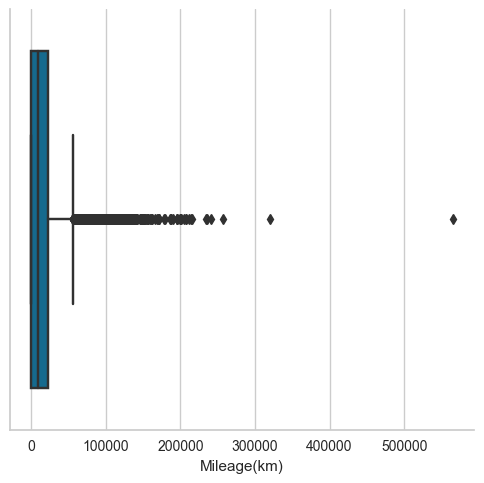

In [92]:
sns.catplot(x='Mileage(km)', kind= 'box', data= data)

In [93]:
# Use describe() method to get summary statistics of the Mileage column
desc = data['Mileage(km)'].describe()

# Print the summary statistics
print(desc)

count     11237.000000
mean      17101.676070
std       26286.442247
min           0.000000
25%          15.000000
50%        9000.000000
75%       22328.000000
max      565317.000000
Name: Mileage(km), dtype: float64


In [94]:
# Compute summary statistics of the Mileage column
mileage_stats = data['Mileage(km)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  55797.5


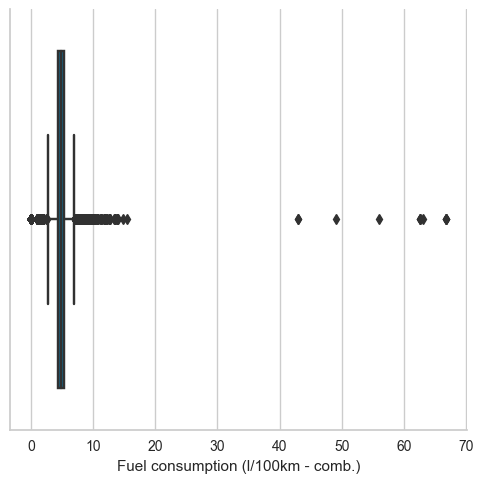

In [95]:
sns.catplot(x='Fuel consumption (l/100km - comb.)', kind= 'box', data= data)

In [96]:
# Use describe() method to get summary statistics of the Fuel consumption column
desc = data['Fuel consumption (l/100km - comb.)'].describe()

# Print the summary statistics
print(desc)

count    11237.000000
mean         4.599486
std          2.584382
min          0.000000
25%          4.300000
50%          4.900000
75%          5.400000
max         66.700000
Name: Fuel consumption (l/100km - comb.), dtype: float64


In [97]:
# Compute summary statistics of the Fuel consumption column
mileage_stats = data['Fuel consumption (l/100km - comb.)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  7.050000000000001


In [98]:
# Compute summary statistics of the Power(hp) column
mileage_stats = data['Fuel consumption (l/100km - comb.)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the lower whisker
lower_whisker = Q1 - 1.5 * IQR

# Print the lower whisker
print("Lower whisker: ", lower_whisker)


Lower whisker:  2.649999999999999


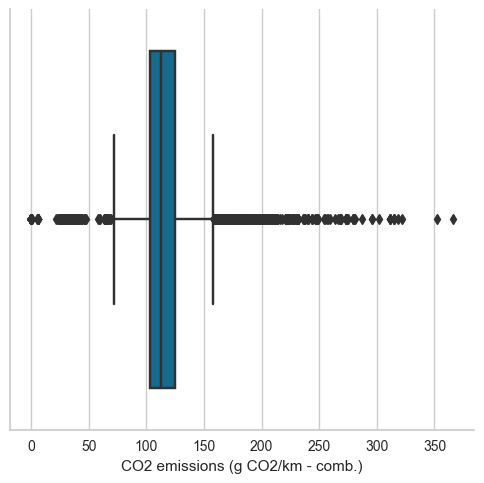

In [99]:
sns.catplot(x='CO2 emissions (g CO2/km - comb.)', kind= 'box', data= data)

In [100]:
# Use describe() method to get summary statistics of the CO2 emissions column
desc = data['CO2 emissions (g CO2/km - comb.)'].describe()

# Print the summary statistics
print(desc)

count    11237.000000
mean       105.593219
std         43.433777
min          0.000000
25%        103.000000
50%        113.000000
75%        125.000000
max        366.000000
Name: CO2 emissions (g CO2/km - comb.), dtype: float64


In [101]:
# Compute summary statistics of the CO2 emissions column
mileage_stats = data['CO2 emissions (g CO2/km - comb.)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  158.0


In [102]:
# Compute summary statistics of the Power(hp) column
mileage_stats = data['CO2 emissions (g CO2/km - comb.)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the lower whisker
lower_whisker = Q1 - 1.5 * IQR

# Print the lower whisker
print("Lower whisker: ", lower_whisker)


Lower whisker:  70.0


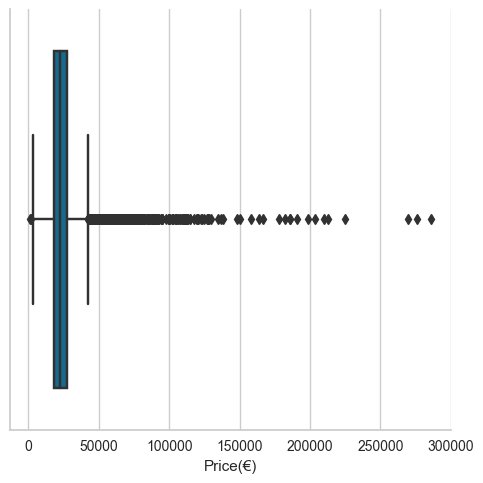

In [103]:
sns.catplot(x='Price(€)', kind= 'box', data= data)

In [104]:
# Use describe() method to get summary statistics of the price column
desc = data['Price(€)'].describe()

# Print the summary statistics
print(desc)

count     11237.000000
mean      24912.219632
std       14366.926331
min        1150.000000
25%       17876.000000
50%       22548.000000
75%       27700.000000
max      285900.000000
Name: Price(€), dtype: float64


In [105]:
# Compute summary statistics of the price column
mileage_stats = data['Price(€)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  42436.0


In [106]:
# Compute summary statistics of the Power(hp) column
mileage_stats = data['Price(€)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the lower whisker
lower_whisker = Q1 - 1.5 * IQR

# Print the lower whisker
print("Lower whisker: ", lower_whisker)


Lower whisker:  3140.0


At the end of the first part boxplots graphically displayed where the outliers are, and I also execute code to calculate outliers mathematically.

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">FILTERING DATA TO REMOVE OUTLIERS</p>

In the second part, I first removed outliers (which I determined at the end of the first part of the analysis) and save the filtered dana for further analysis. 
Then I performed identical analysis to visualize and compare how much the data set has changed with outliers removed.

In [107]:
data = pd.read_csv('C:/Users/Ivan/Desktop/Hey.car/ALL/4.from_base.csv')
data['Year of production'] = pd.to_datetime(data['Year of production'])

print("Number of datapoints:", len(data))
display(data.head(10))  
display(data.tail(10)) 

Number of datapoints: 11237


,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location
0,Volkswagen up,e-up!,2018-02-01,5,82,Electric,Automatic,14577,0.0,0,14750,Bayreuth
1,Ford Ka,Ka Black White 1.2l Klima+SHZ+Tel.Vorb. PDC+ZV,2019-05-01,4,86,Gasoline,Manual,12747,5.0,114,11530,Erbach
2,Hyundai i10,Intro,2021-01-01,2,67,Gasoline,Manual,3620,4.5,104,14998,Wölfersheim
3,Lada Kalina,Cross Luxus,2017-10-01,6,98,Gasoline,Manual,11270,6.7,154,8950,Neuss
4,Volkswagen Golf Variant,Golf Variant VII 1.0 Trendline BMT TSI Navi,2020-02-01,3,116,Gasoline,Manual,5000,4.9,113,19990,Vordorf
5,Skoda Citigo,Cool Edition,2019-03-01,4,60,Gasoline,Manual,28500,4.1,96,10880,Kreuzwertheim
6,Seat Leon,Style,2020-12-01,3,131,Gasoline,Manual,12790,5.1,117,21940,Nürnberg
7,Toyota Aygo,Aygo X 1.0 VVT-i 72 CVT ACC SmartCo Kam Klim,2023-04-01,0,72,Gasoline,Automatic,10,4.8,110,17188,Freiburg
8,Nissan Pixo,Pixo AUTOMATIK+SITZHEIZUNG+EINPARKHILFE,2011-09-01,12,68,Gasoline,Automatic,11000,5.2,122,8976,Dietztenbach
9,Fiat 500,Cult,2023-05-01,0,69,Hybrid/Gasoline,Manual,10,5.5,93,18390,Köln


,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location
11227,Polestar 2,POLESTAR 2 Standard Range Single Motor,2022-11-01,1,231,Electric,Automatic,6200,0.0,0,42950,Herne
11228,Renault Grand Scenic,Limited,2023-04-01,0,140,Gasoline,Automatic,0,6.3,136,39939,Chemnitz
11229,Opel Corsa,Corsa E 120 Jahre *CarPlay*SHZ*PDC*Klima*Lenkr...,2019-06-01,4,69,Gasoline,Manual,18889,5.6,148,12740,Dormagen
11230,Volkswagen Golf,GTE,2021-01-01,2,245,Hybrid/Gasoline,Automatic,27201,1.5,34,29980,Bendorf
11231,Volkswagen Golf Variant,Comfortline,2018-07-01,5,150,Gasoline,Automatic,90500,4.9,112,18960,Aach
11232,Volkswagen Golf,Golf VIII 2.0 TDI DSG Active AHK/NAVI/KAMERA/ACC,2022-09-01,1,150,Diesel,Automatic,9309,3.8,101,31998,Mayen
11233,Audi Q5,S line,2023-03-01,0,204,Diesel,Automatic,2601,5.4,142,65990,Aachen
11234,Volkswagen up,colour up! sandstorm yellow,2019-05-01,4,60,Gasoline,Manual,25990,4.2,95,11990,Bremerhaven
11235,Renault Clio,Business Edition,2022-09-01,1,91,Gasoline,Manual,8061,5.1,117,17990,Berlin
11236,Opel Corsa,Corsa,2022-03-01,1,101,Gasoline,Manual,6329,5.3,123,18440,Berlin


In [110]:
# Filter the data to remove outliers in Age(years)
data = data[data['Age(years)'] <= 7.5]

# Filter the data to remove outliers in Power(hp)
data = data[(data['Power(hp)'] >= 17.5) & (data['Power(hp)'] <= 213.5)]

# Filter the data to remove outliers in Mileage(km)
data = data[data['Mileage(km)'] <= 55797.5]

# Filter the data to remove outliers in Fuel consumption (l/100km - comb.)
data = data[(data['Fuel consumption (l/100km - comb.)'] >= 2.6) & (data['Fuel consumption (l/100km - comb.)'] <= 7)]

# Filter the data to remove outliers in CO2 emissions (g CO2/km - comb.)
data = data[(data['CO2 emissions (g CO2/km - comb.)'] >= 70) & (data['CO2 emissions (g CO2/km - comb.)'] <= 158)]

# Filter the data to remove outliers in Price(€)
data = data[(data['Price(€)'] >= 3140) & (data['Price(€)'] <= 42436)]

data


,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location
1,Ford Ka,Ka Black White 1.2l Klima+SHZ+Tel.Vorb. PDC+ZV,2019-05-01,4,86,Gasoline,Manual,12747,5.0,114,11530,Erbach
2,Hyundai i10,Intro,2021-01-01,2,67,Gasoline,Manual,3620,4.5,104,14998,Wölfersheim
3,Lada Kalina,Cross Luxus,2017-10-01,6,98,Gasoline,Manual,11270,6.7,154,8950,Neuss
4,Volkswagen Golf Variant,Golf Variant VII 1.0 Trendline BMT TSI Navi,2020-02-01,3,116,Gasoline,Manual,5000,4.9,113,19990,Vordorf
5,Skoda Citigo,Cool Edition,2019-03-01,4,60,Gasoline,Manual,28500,4.1,96,10880,Kreuzwertheim
...,...,...,...,...,...,...,...,...,...,...,...,...
11229,Opel Corsa,Corsa E 120 Jahre *CarPlay*SHZ*PDC*Klima*Lenkr...,2019-06-01,4,69,Gasoline,Manual,18889,5.6,148,12740,Dormagen
11232,Volkswagen Golf,Golf VIII 2.0 TDI DSG Active AHK/NAVI/KAMERA/ACC,2022-09-01,1,150,Diesel,Automatic,9309,3.8,101,31998,Mayen
11234,Volkswagen up,colour up! sandstorm yellow,2019-05-01,4,60,Gasoline,Manual,25990,4.2,95,11990,Bremerhaven
11235,Renault Clio,Business Edition,2022-09-01,1,91,Gasoline,Manual,8061,5.1,117,17990,Berlin


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">SAVING FILTERED DATA SET</p>

In [111]:
data.to_csv(r'C:/Users/Ivan/Desktop/Hey.car/ALL/5.filtered.csv', index=False)

In [112]:
data = pd.read_csv('C:/Users/Ivan/Desktop/Hey.car/ALL/5.filtered.csv')
data['Year of production'] = pd.to_datetime(data['Year of production'])

print("Number of datapoints:", len(data))
display(data.head(10))  
display(data.tail(10)) 

Number of datapoints: 8290


,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location
0,Ford Ka,Ka Black White 1.2l Klima+SHZ+Tel.Vorb. PDC+ZV,2019-05-01,4,86,Gasoline,Manual,12747,5.0,114,11530,Erbach
1,Hyundai i10,Intro,2021-01-01,2,67,Gasoline,Manual,3620,4.5,104,14998,Wölfersheim
2,Lada Kalina,Cross Luxus,2017-10-01,6,98,Gasoline,Manual,11270,6.7,154,8950,Neuss
3,Volkswagen Golf Variant,Golf Variant VII 1.0 Trendline BMT TSI Navi,2020-02-01,3,116,Gasoline,Manual,5000,4.9,113,19990,Vordorf
4,Skoda Citigo,Cool Edition,2019-03-01,4,60,Gasoline,Manual,28500,4.1,96,10880,Kreuzwertheim
5,Seat Leon,Style,2020-12-01,3,131,Gasoline,Manual,12790,5.1,117,21940,Nürnberg
6,Toyota Aygo,Aygo X 1.0 VVT-i 72 CVT ACC SmartCo Kam Klim,2023-04-01,0,72,Gasoline,Automatic,10,4.8,110,17188,Freiburg
7,Fiat 500,Cult,2023-05-01,0,69,Hybrid/Gasoline,Manual,10,5.5,93,18390,Köln
8,Seat Ibiza,Style,2018-07-01,5,75,Gasoline,Manual,18050,4.9,112,12450,Beilngries
9,Seat Arona,Xcellence,2020-10-01,3,95,Diesel,Manual,11500,4.0,106,20930,Feldkirchen/Westerham


,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location
8280,Volkswagen T-Roc,T-Roc 1.0 TSI ACC*PDC*AHK*GJR*EL.FH*KLIMA*ZV,2018-04-01,5,116,Gasoline,Manual,18990,5.1,117,19990,Achim
8281,Mazda 3,3 G122 Homura *LED*Parkpilot*Kamera*Navi*CarPlay*,2023-04-01,0,120,Gasoline,Manual,0,5.1,119,25970,Düsseldorf
8282,Volkswagen T-Roc,T-Roc 1.0 TSI Life Navi LED SzHzg,2022-09-01,1,110,Gasoline,Manual,18700,5.2,118,23990,Karlsruhe
8283,Audi Sportback,A3 Sportback 35 TFSI S tronic 2x S line Matrix...,2022-08-01,1,150,Gasoline,Automatic,4468,4.8,111,36969,Eching
8284,Renault Grand Scenic,Limited,2023-04-01,0,140,Gasoline,Automatic,0,6.3,136,39939,Chemnitz
8285,Opel Corsa,Corsa E 120 Jahre *CarPlay*SHZ*PDC*Klima*Lenkr...,2019-06-01,4,69,Gasoline,Manual,18889,5.6,148,12740,Dormagen
8286,Volkswagen Golf,Golf VIII 2.0 TDI DSG Active AHK/NAVI/KAMERA/ACC,2022-09-01,1,150,Diesel,Automatic,9309,3.8,101,31998,Mayen
8287,Volkswagen up,colour up! sandstorm yellow,2019-05-01,4,60,Gasoline,Manual,25990,4.2,95,11990,Bremerhaven
8288,Renault Clio,Business Edition,2022-09-01,1,91,Gasoline,Manual,8061,5.1,117,17990,Berlin
8289,Opel Corsa,Corsa,2022-03-01,1,101,Gasoline,Manual,6329,5.3,123,18440,Berlin


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">ANALYZING DATA WITHOUT OUTLIERS</p>

In [113]:
data.shape

(8290, 12)

In [114]:
data.dtypes

Model                                         object
Edition                                       object
Year of production                    datetime64[ns]
Age(years)                                     int64
Power(hp)                                      int64
Fuel type                                     object
Gearbox                                       object
Mileage(km)                                    int64
Fuel consumption (l/100km - comb.)           float64
CO2 emissions (g CO2/km - comb.)               int64
Price(€)                                       int64
Location                                      object
dtype: object

In [115]:
data.describe()

,Age(years),Power(hp),Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€)
count,8290.00000,8290.000000,8290.000000,8290.000000,8290.000000,8290.000000
mean,1.61351,110.704946,12087.011339,5.007304,115.765259,22529.381182
std,1.64454,28.691705,13144.872899,0.625094,13.635108,6139.544703
min,0.00000,53.000000,0.000000,2.800000,72.000000,7900.000000
25%,0.00000,91.000000,15.000000,4.600000,107.000000,17950.000000
50%,1.00000,110.000000,8260.500000,5.000000,114.000000,22249.500000
75%,3.00000,131.000000,19979.000000,5.400000,124.000000,26490.000000
max,7.00000,207.000000,55556.000000,7.000000,158.000000,42330.000000


In [117]:
data.isnull().sum()

Model                                   0
Edition                               214
Year of production                      0
Age(years)                              0
Power(hp)                               0
Fuel type                               0
Gearbox                                 0
Mileage(km)                             0
Fuel consumption (l/100km - comb.)      0
CO2 emissions (g CO2/km - comb.)        0
Price(€)                                0
Location                                0
dtype: int64

In [118]:
print(data.columns)

Index(['Model', 'Edition', 'Year of production', 'Age(years)', 'Power(hp)',
       'Fuel type', 'Gearbox', 'Mileage(km)',
       'Fuel consumption (l/100km - comb.)',
       'CO2 emissions (g CO2/km - comb.)', 'Price(€)', 'Location'],
      dtype='object')


In [119]:
data.columns

Index(['Model', 'Edition', 'Year of production', 'Age(years)', 'Power(hp)',
       'Fuel type', 'Gearbox', 'Mileage(km)',
       'Fuel consumption (l/100km - comb.)',
       'CO2 emissions (g CO2/km - comb.)', 'Price(€)', 'Location'],
      dtype='object')

In [120]:
data.nunique()

Model                                  215
Edition                               3348
Year of production                      87
Age(years)                               8
Power(hp)                               76
Fuel type                                7
Gearbox                                  2
Mileage(km)                           4247
Fuel consumption (l/100km - comb.)      50
CO2 emissions (g CO2/km - comb.)        83
Price(€)                              2661
Location                               854
dtype: int64

In [121]:
data['Model'].unique()

array(['Ford Ka', 'Hyundai i10', 'Lada Kalina', 'Volkswagen Golf Variant',
       'Skoda Citigo', 'Seat Leon', 'Toyota Aygo', 'Fiat 500',
       'Seat Ibiza', 'Seat Arona', 'Renault Clio', 'Kia Picanto',
       'Volkswagen Polo', 'Dacia Sandero', 'Volkswagen up', 'MINI One',
       'Ford Transit Courier', 'Skoda Fabia', 'Mitsubishi Space Star',
       'Volkswagen Golf', 'Skoda Kamiq', 'Ford Fiesta', 'Kia Rio',
       'Opel Corsa', 'Renault Captur', 'Dacia Jogger',
       'Volkswagen T-Cross', 'Dacia Duster', 'Peugeot 108',
       'Skoda Octavia', 'Suzuki Vitara', 'Ford Focus', 'Citroën C1',
       'Nissan Micra', 'Fiat 500C', 'Opel Crossland X', 'Toyota Yaris',
       'Citroën C3', 'Renault Twingo', 'smart ForFour', 'Ford EcoSport',
       'Ford Puma', 'Seat Ateca', 'Mazda 2', 'smart ForTwo',
       'Dacia Lodgy', 'Opel Mokka', 'Suzuki Swift', 'Skoda Scala',
       'Renault Kangoo', 'Opel Crossland', 'Volkswagen T-Roc',
       'Hyundai i20', 'Fiat Doblo', 'Skoda Superb', 'Hyundai i30',

In [122]:
data['Age(years)'].unique()

array([4, 2, 6, 3, 0, 5, 1, 7], dtype=int64)

In [123]:
data['Gearbox'].unique()

array(['Manual', 'Automatic'], dtype=object)

In [124]:
data['Fuel type'].unique()

array(['Gasoline', 'Hybrid/Gasoline', 'Diesel', 'LPG', 'CNG', 'Others',
       'Hybrid/Diesel'], dtype=object)

In [125]:
data['Fuel consumption (l/100km - comb.)'].unique()

array([5.  , 4.5 , 6.7 , 4.9 , 4.1 , 5.1 , 4.8 , 5.5 , 4.  , 4.2 , 4.3 ,
       4.7 , 5.4 , 5.6 , 5.2 , 4.4 , 7.  , 5.7 , 3.7 , 4.6 , 5.9 , 5.8 ,
       3.8 , 3.4 , 5.3 , 6.  , 3.5 , 2.9 , 6.6 , 6.3 , 6.4 , 3.2 , 6.1 ,
       6.2 , 3.9 , 3.3 , 6.8 , 3.6 , 6.9 , 6.5 , 2.8 , 5.43, 6.34, 3.  ,
       3.1 , 4.96, 6.26, 6.05, 4.74, 4.87])

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">CORRELATION MATRIX OF DATASET</p>

<Axes: >

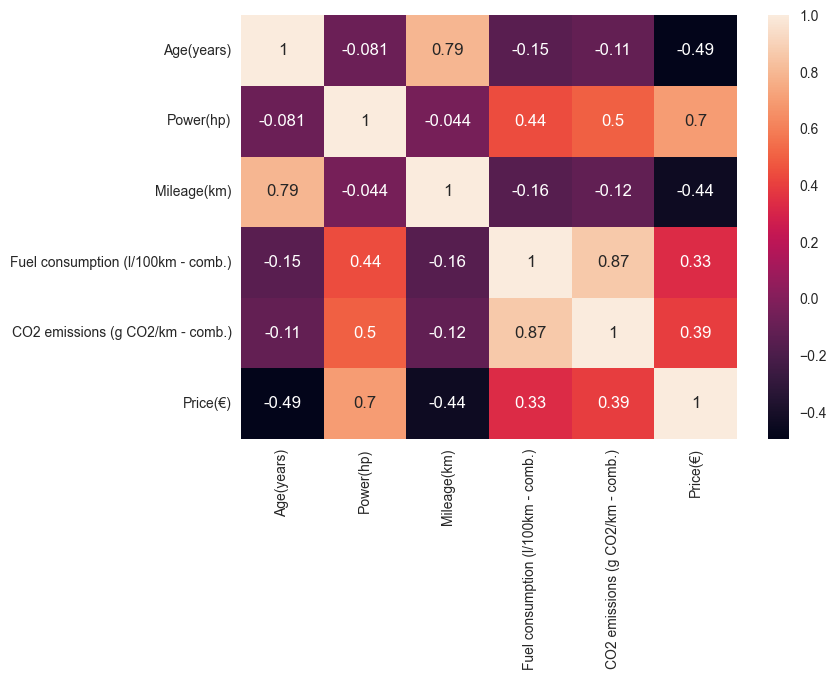

In [126]:
corelation = data.corr()
sns.heatmap(corelation, xticklabels=corelation.columns, yticklabels=corelation.columns
            ,annot=True)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">VISUALIZING DISTRIBUTION OF VARIABLES</p>

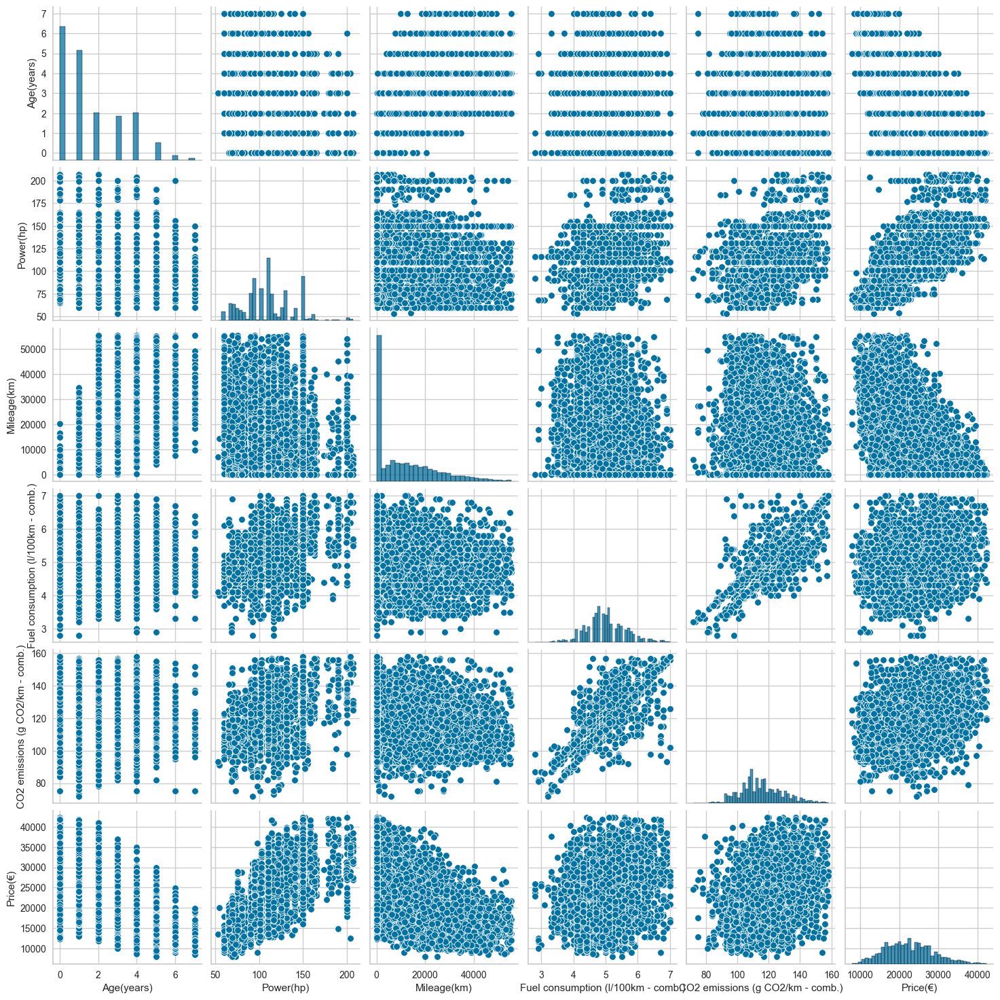

In [127]:
sns.pairplot(data)

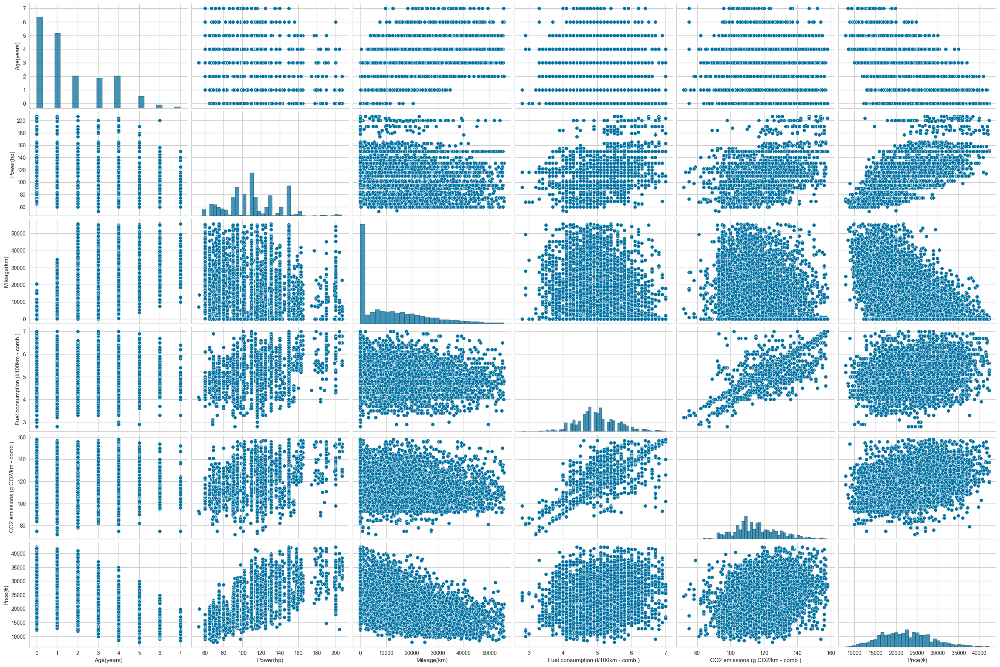

In [128]:
sns.pairplot(data, height=3, aspect=1.5)

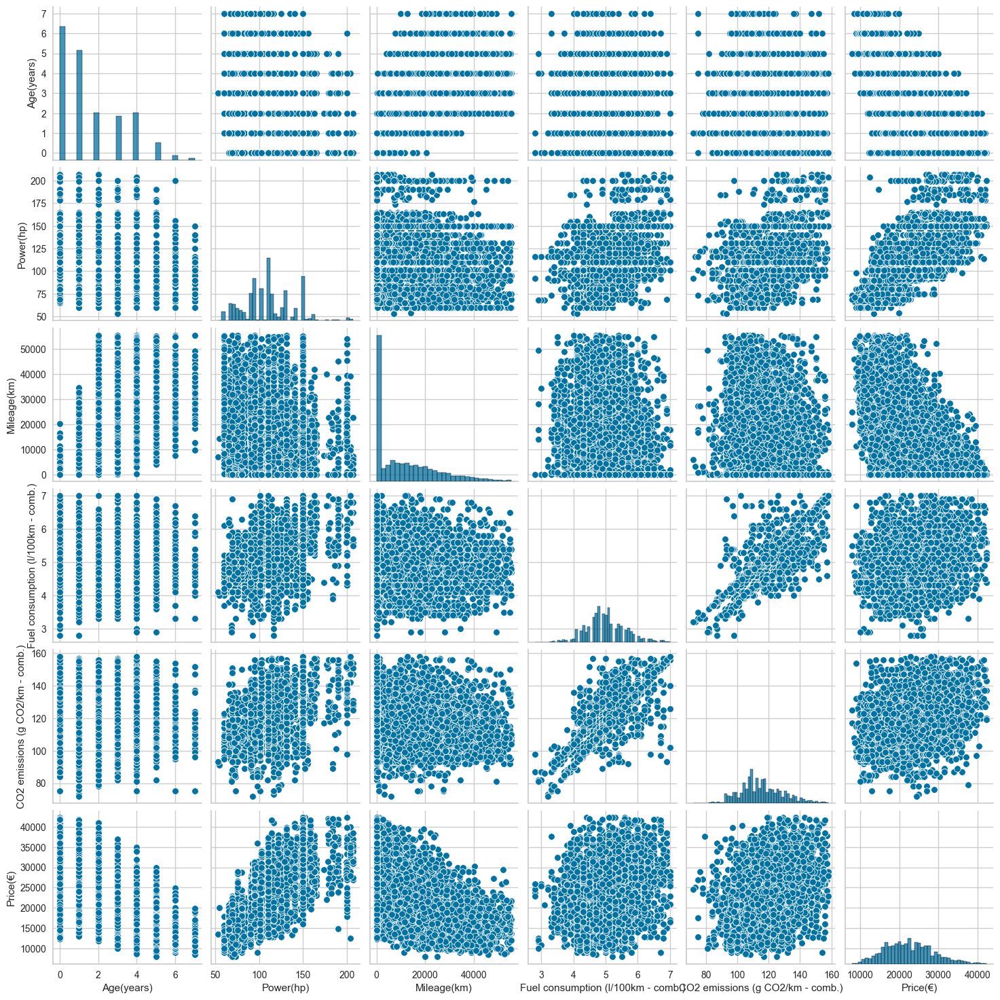

In [129]:
# Select the numerical columns you want to include in the plot
numerical_columns = ['Age(years)', 'Power(hp)', 'Mileage(km)', 'Fuel consumption (l/100km - comb.)', 'CO2 emissions (g CO2/km - comb.)', 'Price(€)']

# Create a DataFrame with only the selected numerical columns
numerical_data = data[numerical_columns]

# Generate the pairplot for all combinations of numerical columns
sns.pairplot(numerical_data)

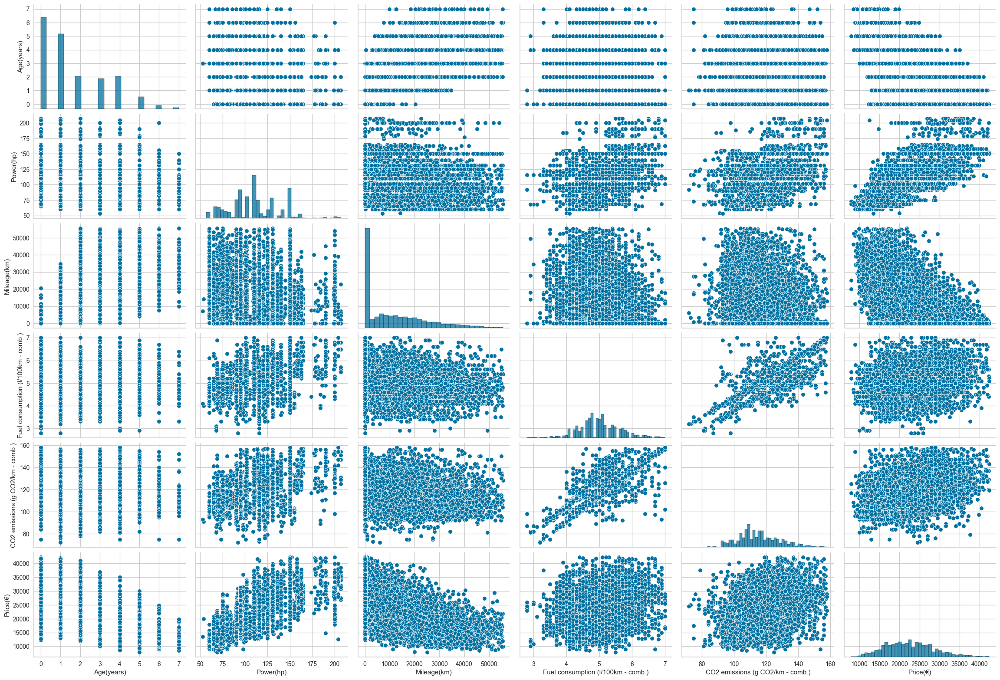

In [130]:
# Select the numerical columns you want to include in the plot
numerical_columns = ['Age(years)', 'Power(hp)', 'Mileage(km)', 'Fuel consumption (l/100km - comb.)', 'CO2 emissions (g CO2/km - comb.)', 'Price(€)']

# Create a DataFrame with only the selected numerical columns
numerical_data = data[numerical_columns]

# Generate the pairplot for all combinations of numerical columns
plot = sns.pairplot(numerical_data)

# Adjust the figure size
plot.fig.set_size_inches(24, 16)

# Rotate the x-axis labels
plt.xticks(rotation=45)

# Show the plot
plt.show()

In [131]:
# List of numerical columns
columns = ['Age(years)', 'Power(hp)', 'Mileage(km)', 'Fuel consumption (l/100km - comb.)',
           'CO2 emissions (g CO2/km - comb.)', 'Price(€)']

# Generate separate sns.relplot codes for each combination
for x_column in columns:
    for y_column in columns:
        if x_column != y_column:
            code = "sns.relplot(x='{}', y='{}', hue='Price(€)', data=data)".format(x_column, y_column)
            print(code)

sns.relplot(x='Age(years)', y='Power(hp)', hue='Price(€)', data=data)
sns.relplot(x='Age(years)', y='Mileage(km)', hue='Price(€)', data=data)
sns.relplot(x='Age(years)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)
sns.relplot(x='Age(years)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)
sns.relplot(x='Age(years)', y='Price(€)', hue='Price(€)', data=data)
sns.relplot(x='Power(hp)', y='Age(years)', hue='Price(€)', data=data)
sns.relplot(x='Power(hp)', y='Mileage(km)', hue='Price(€)', data=data)
sns.relplot(x='Power(hp)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)
sns.relplot(x='Power(hp)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)
sns.relplot(x='Power(hp)', y='Price(€)', hue='Price(€)', data=data)
sns.relplot(x='Mileage(km)', y='Age(years)', hue='Price(€)', data=data)
sns.relplot(x='Mileage(km)', y='Power(hp)', hue='Price(€)', data=data)
sns.relplot(x='Mileage(km)', y='Fuel consumption (l/100km - com

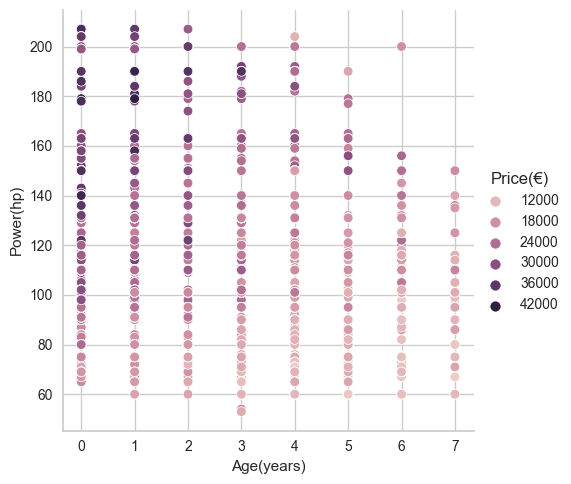

In [132]:
sns.relplot(x='Age(years)', y='Power(hp)', hue='Price(€)', data=data)


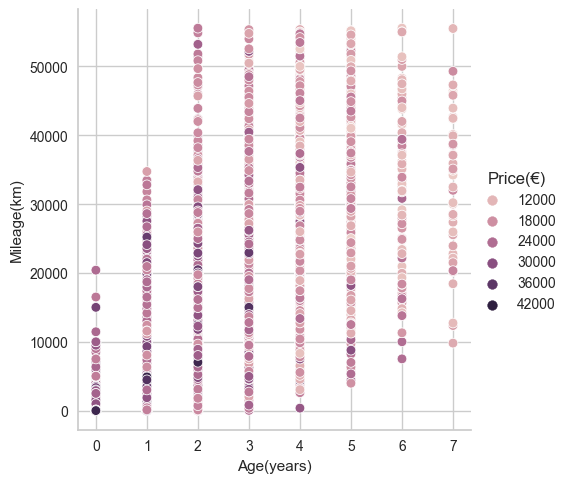

In [133]:
sns.relplot(x='Age(years)', y='Mileage(km)', hue='Price(€)', data=data)


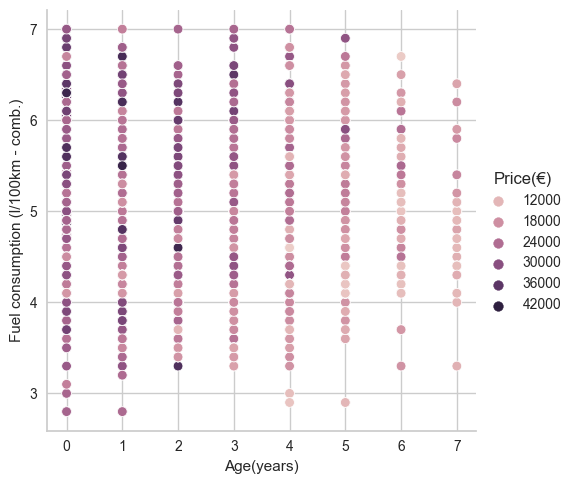

In [134]:
sns.relplot(x='Age(years)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)


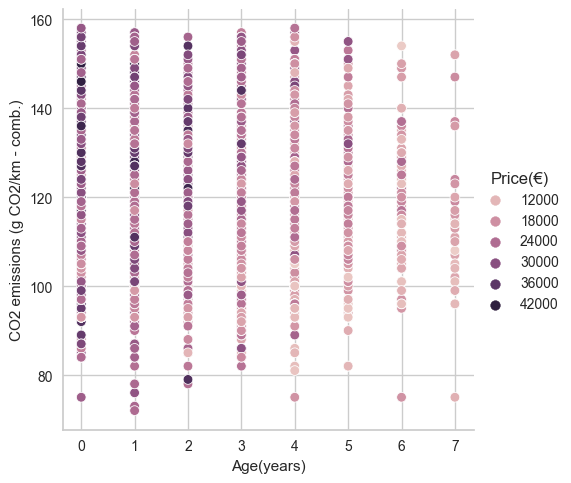

In [135]:
sns.relplot(x='Age(years)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)


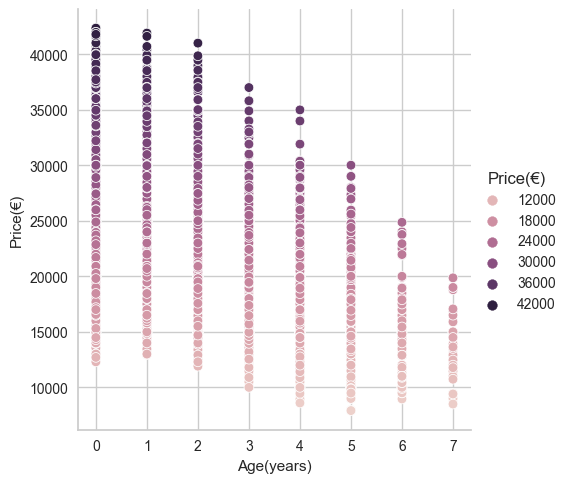

In [136]:
sns.relplot(x='Age(years)', y='Price(€)', hue='Price(€)', data=data)


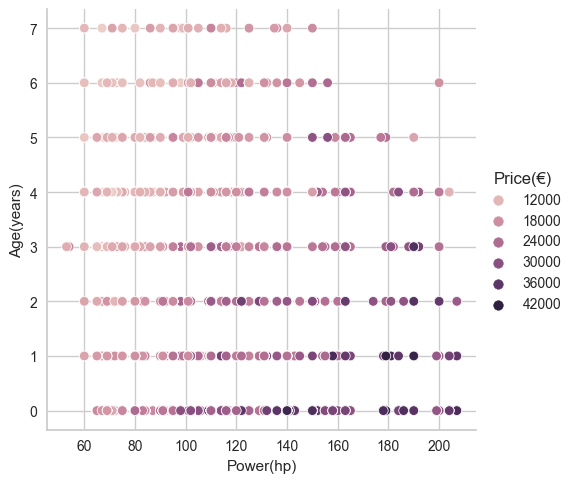

In [137]:
sns.relplot(x='Power(hp)', y='Age(years)', hue='Price(€)', data=data)


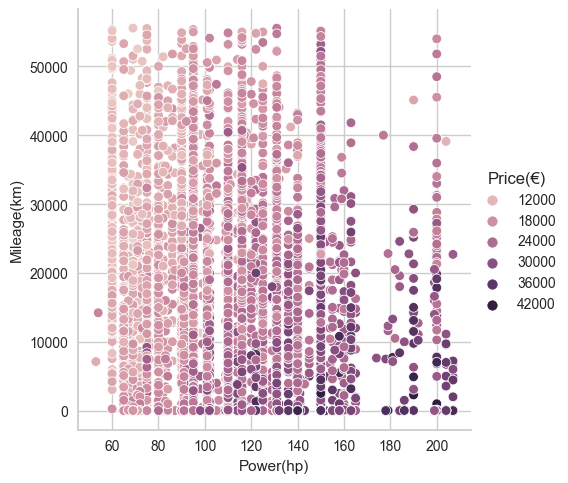

In [138]:
sns.relplot(x='Power(hp)', y='Mileage(km)', hue='Price(€)', data=data)


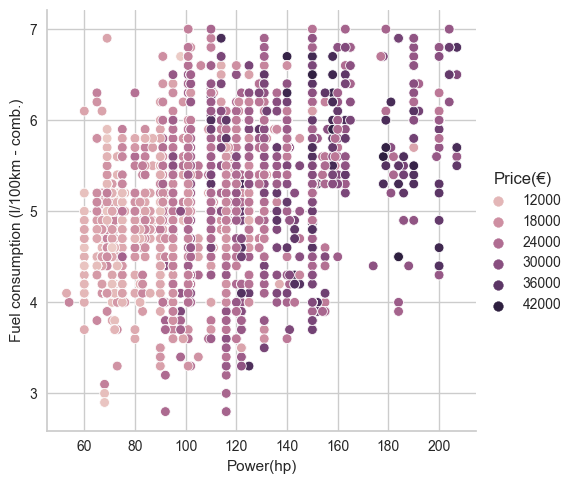

In [139]:
sns.relplot(x='Power(hp)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)


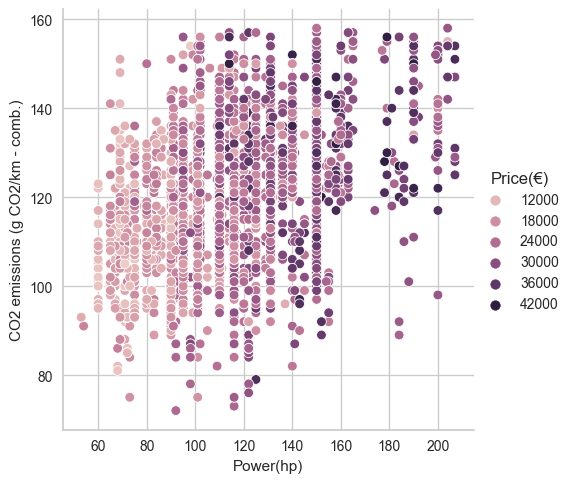

In [140]:
sns.relplot(x='Power(hp)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)


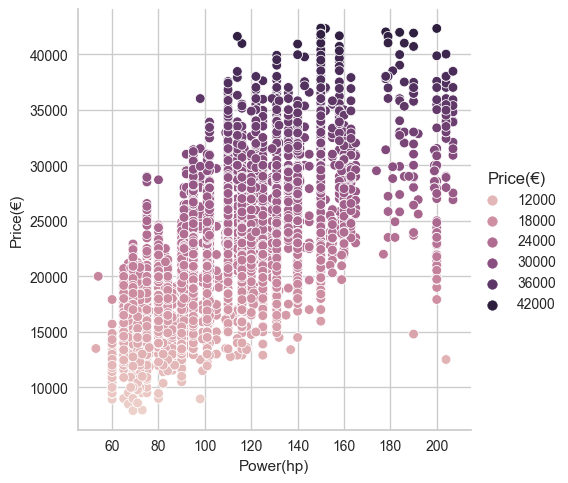

In [141]:
sns.relplot(x='Power(hp)', y='Price(€)', hue='Price(€)', data=data)


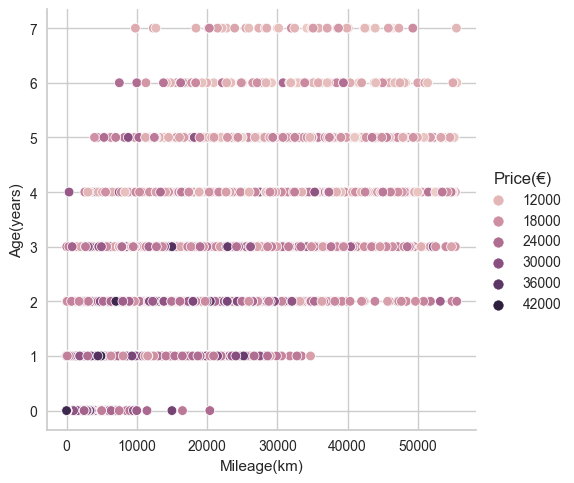

In [142]:
sns.relplot(x='Mileage(km)', y='Age(years)', hue='Price(€)', data=data)


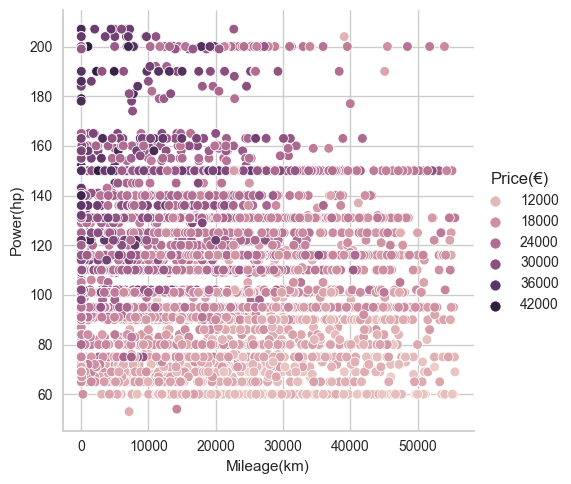

In [143]:
sns.relplot(x='Mileage(km)', y='Power(hp)', hue='Price(€)', data=data)


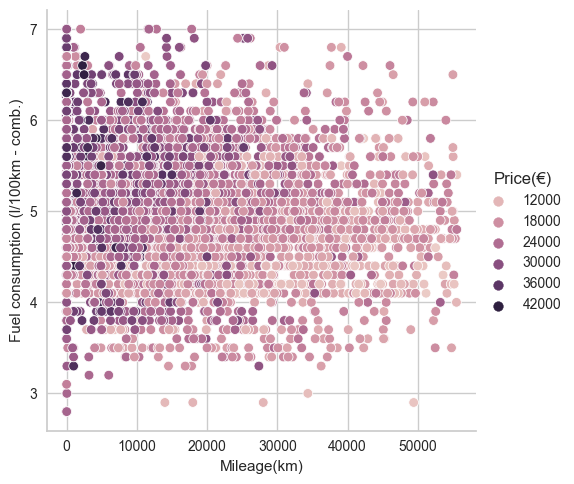

In [144]:
sns.relplot(x='Mileage(km)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)


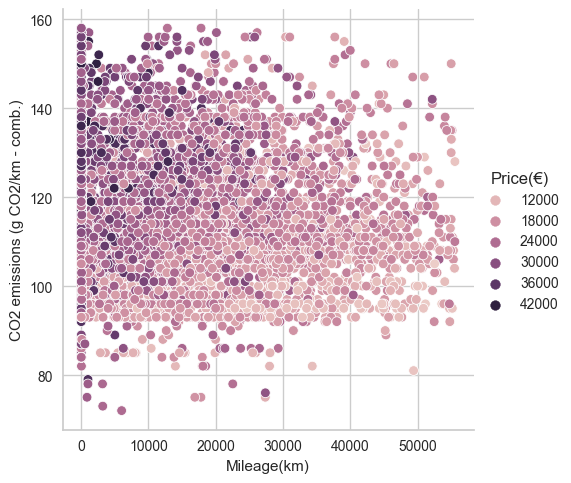

In [145]:
sns.relplot(x='Mileage(km)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)


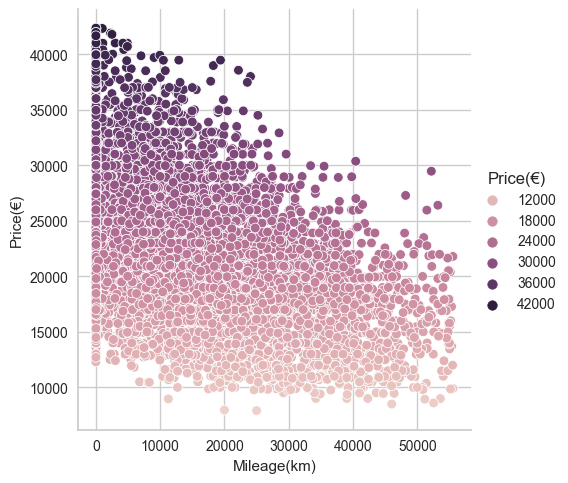

In [146]:
sns.relplot(x='Mileage(km)', y='Price(€)', hue='Price(€)', data=data)


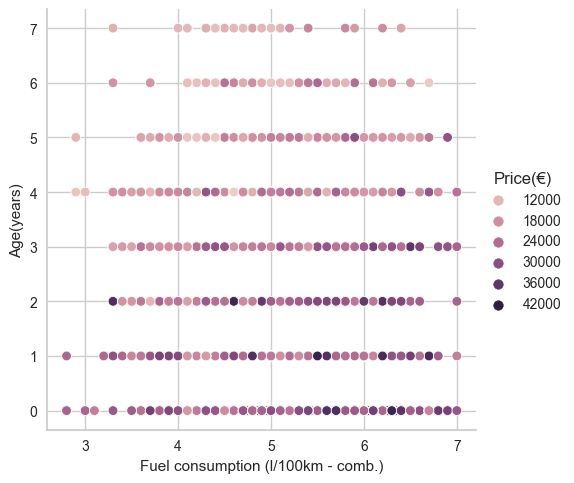

In [147]:
sns.relplot(x='Fuel consumption (l/100km - comb.)', y='Age(years)', hue='Price(€)', data=data)


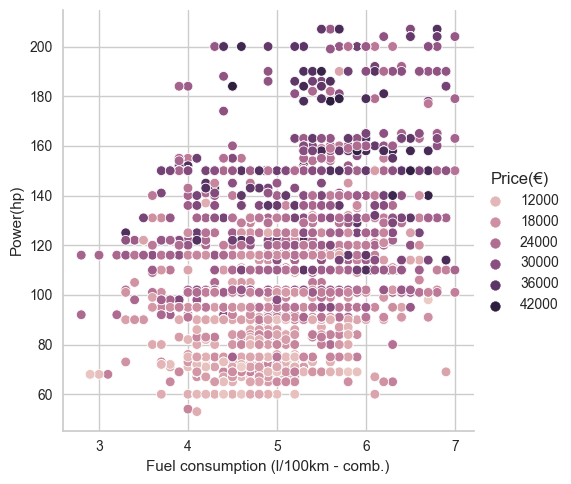

In [148]:
sns.relplot(x='Fuel consumption (l/100km - comb.)', y='Power(hp)', hue='Price(€)', data=data)


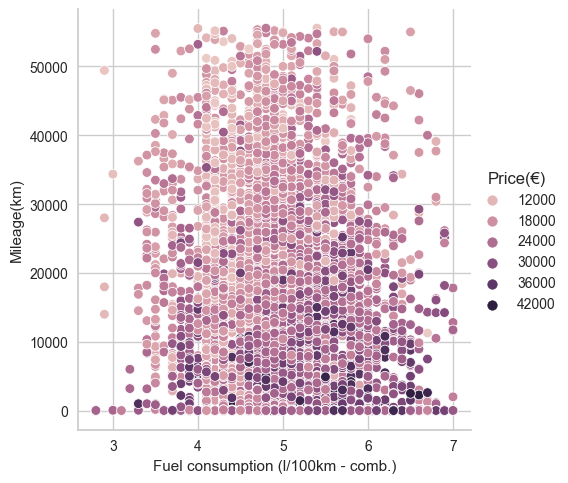

In [149]:
sns.relplot(x='Fuel consumption (l/100km - comb.)', y='Mileage(km)', hue='Price(€)', data=data)


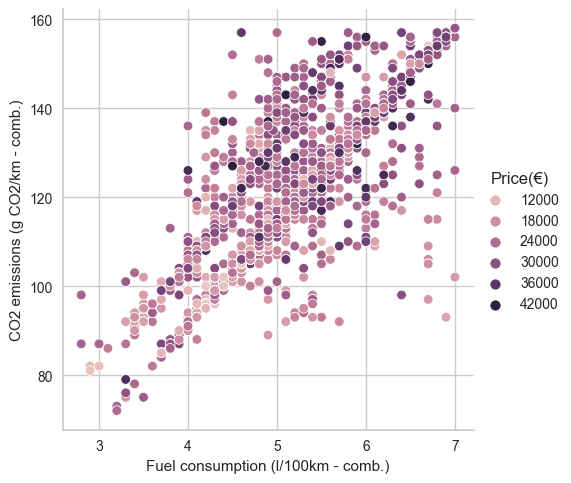

In [150]:
sns.relplot(x='Fuel consumption (l/100km - comb.)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)


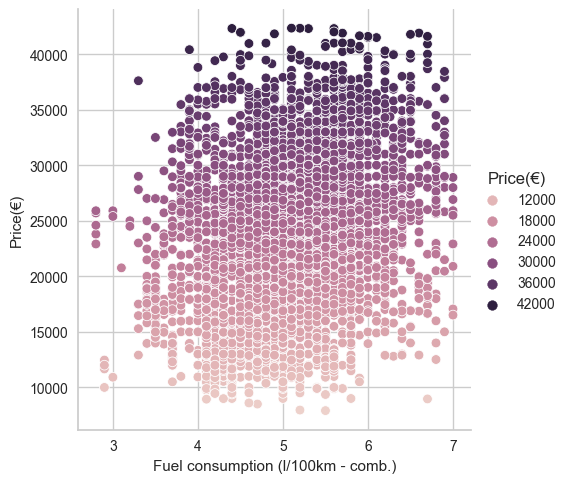

In [151]:
sns.relplot(x='Fuel consumption (l/100km - comb.)', y='Price(€)', hue='Price(€)', data=data)


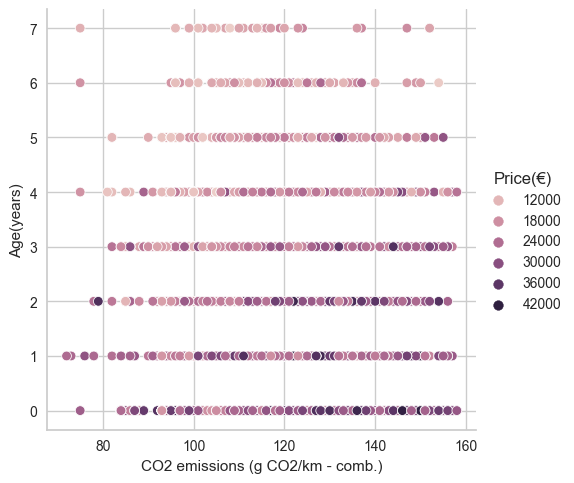

In [152]:
sns.relplot(x='CO2 emissions (g CO2/km - comb.)', y='Age(years)', hue='Price(€)', data=data)


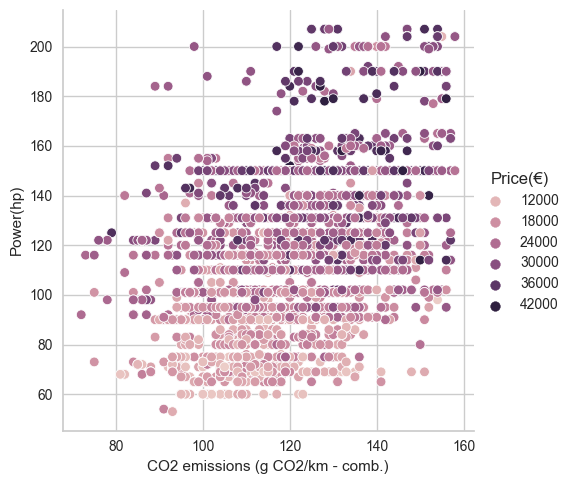

In [153]:
sns.relplot(x='CO2 emissions (g CO2/km - comb.)', y='Power(hp)', hue='Price(€)', data=data)


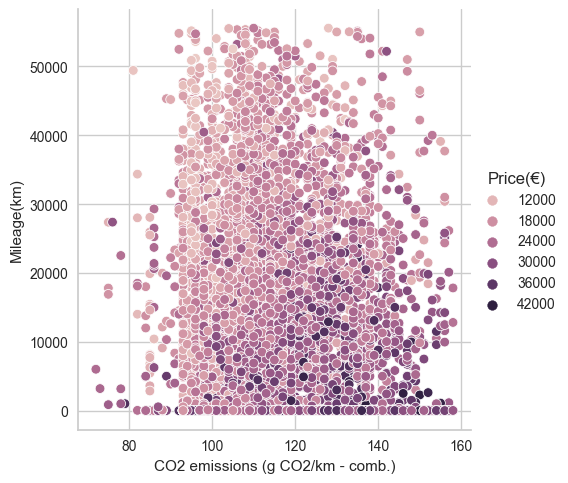

In [154]:
sns.relplot(x='CO2 emissions (g CO2/km - comb.)', y='Mileage(km)', hue='Price(€)', data=data)


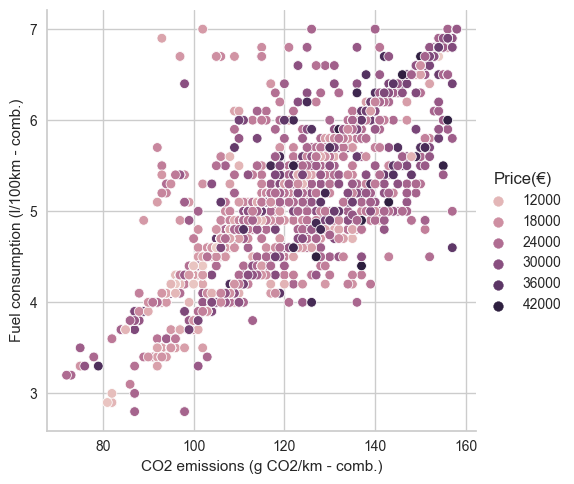

In [155]:
sns.relplot(x='CO2 emissions (g CO2/km - comb.)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)


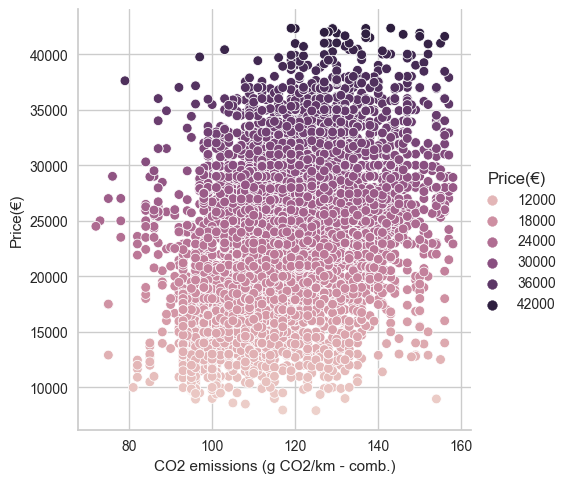

In [156]:
sns.relplot(x='CO2 emissions (g CO2/km - comb.)', y='Price(€)', hue='Price(€)', data=data)


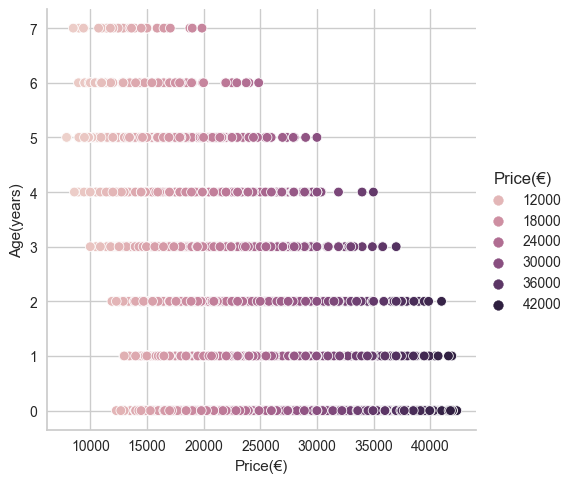

In [157]:
sns.relplot(x='Price(€)', y='Age(years)', hue='Price(€)', data=data)


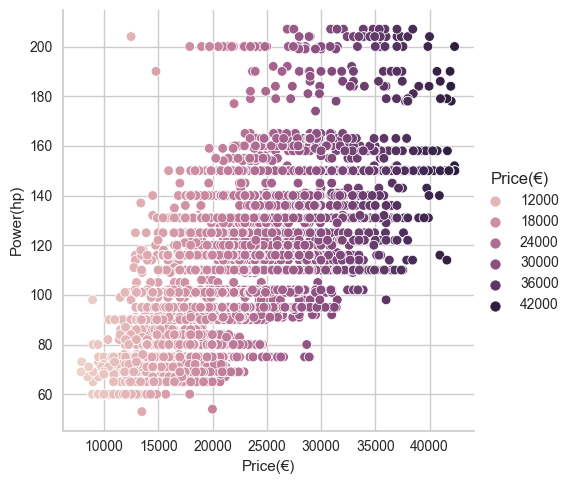

In [158]:
sns.relplot(x='Price(€)', y='Power(hp)', hue='Price(€)', data=data)


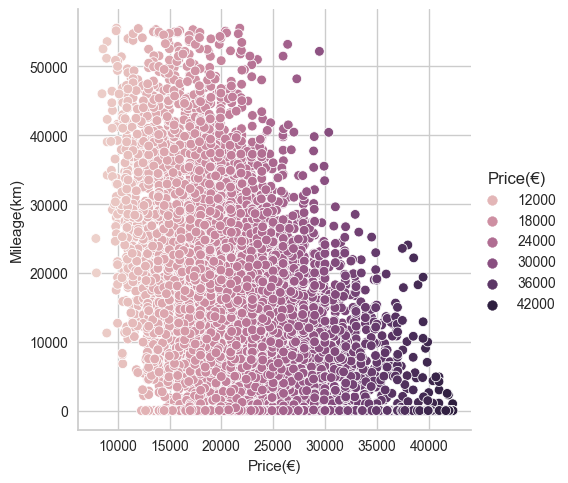

In [159]:
sns.relplot(x='Price(€)', y='Mileage(km)', hue='Price(€)', data=data)


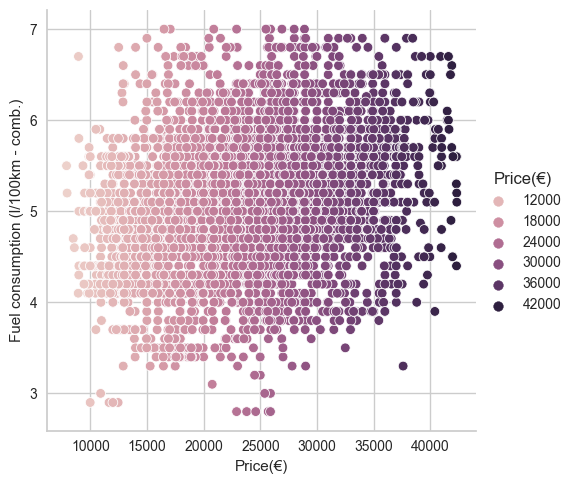

In [160]:
sns.relplot(x='Price(€)', y='Fuel consumption (l/100km - comb.)', hue='Price(€)', data=data)


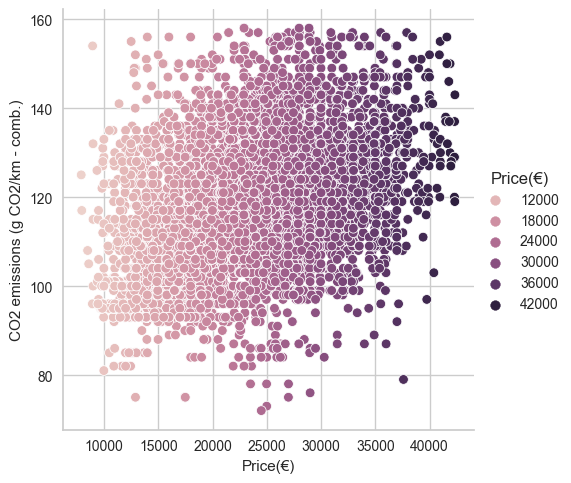

In [161]:
sns.relplot(x='Price(€)', y='CO2 emissions (g CO2/km - comb.)', hue='Price(€)', data=data)

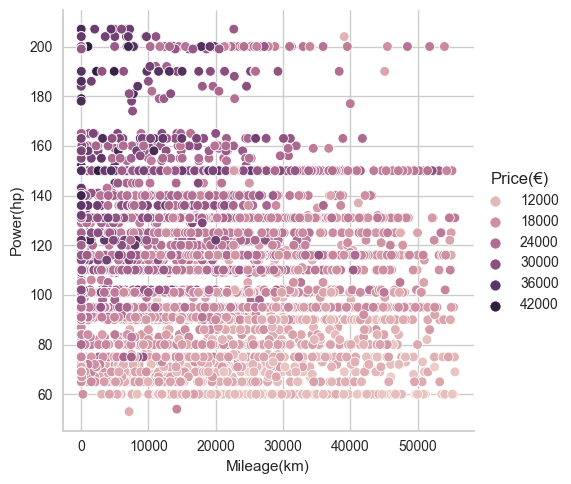

In [162]:
#moji stari plotovi tu pocinju
sns.relplot(x= 'Mileage(km)', y='Power(hp)', hue='Price(€)', data=data)

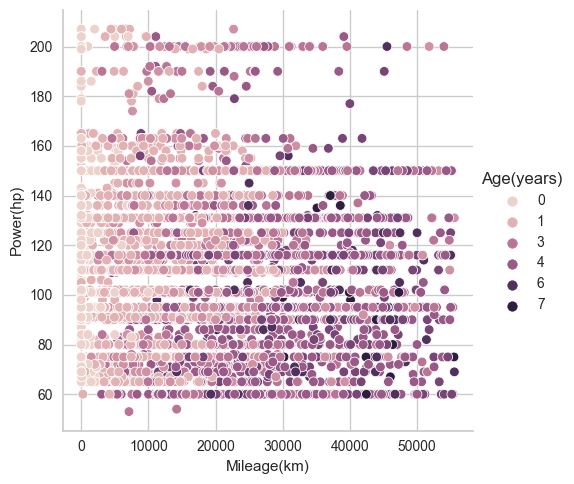

In [163]:
sns.relplot(x= 'Mileage(km)', y='Power(hp)', hue='Age(years)', data=data)

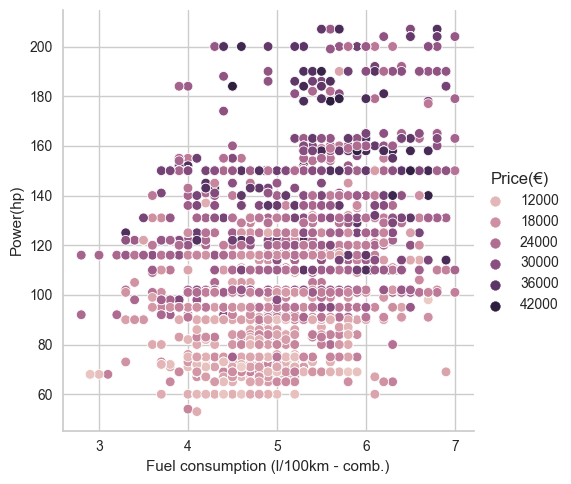

In [164]:
sns.relplot(x= 'Fuel consumption (l/100km - comb.)', y='Power(hp)', hue='Price(€)', data=data)

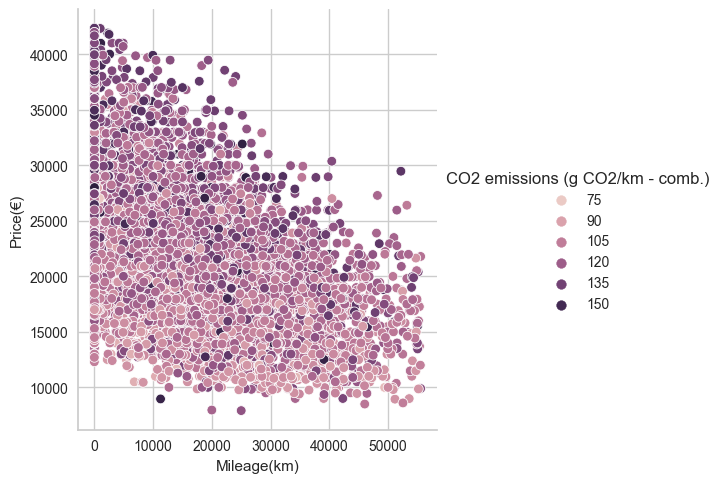

In [165]:
sns.relplot(x= 'Mileage(km)', y='Price(€)', hue='CO2 emissions (g CO2/km - comb.)', data=data)

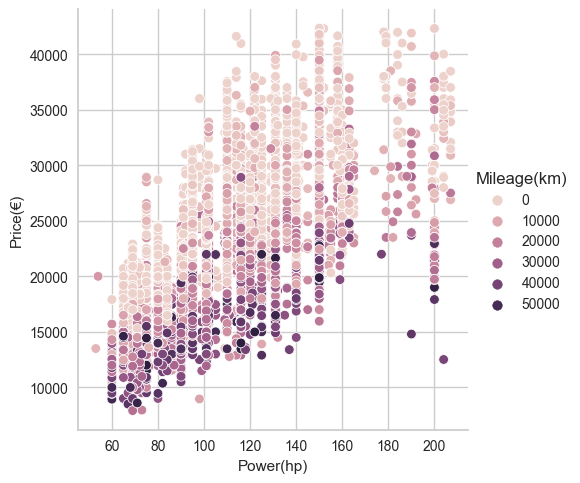

In [166]:
sns.relplot(x= 'Power(hp)', y='Price(€)', hue='Mileage(km)', data=data)

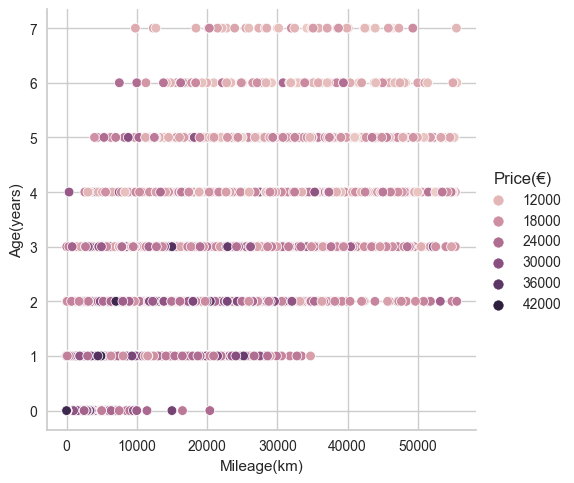

In [167]:
sns.relplot(x= 'Mileage(km)', y='Age(years)', hue='Price(€)', data=data)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">FREQUENCY DISTRIBUTION OF NUMERICAL VARIABLES</p>

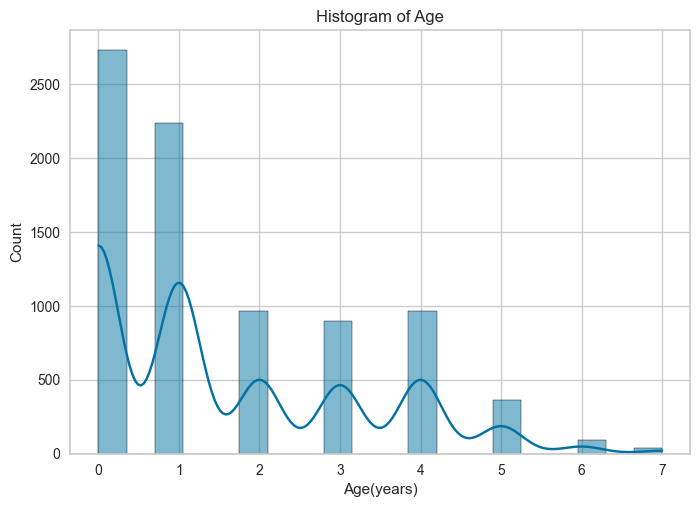

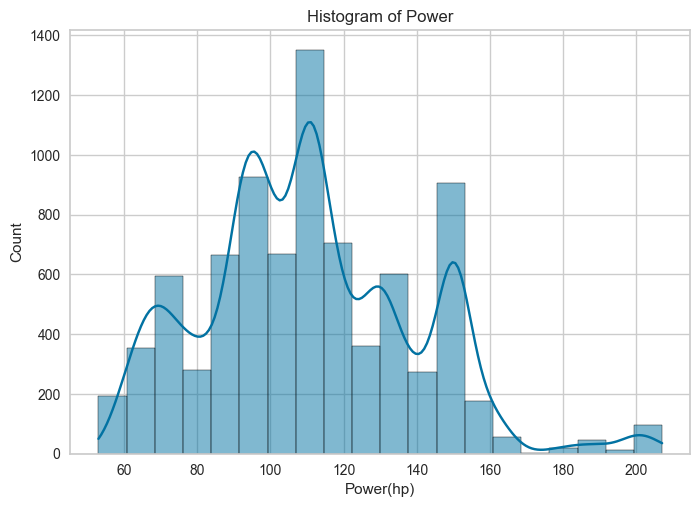

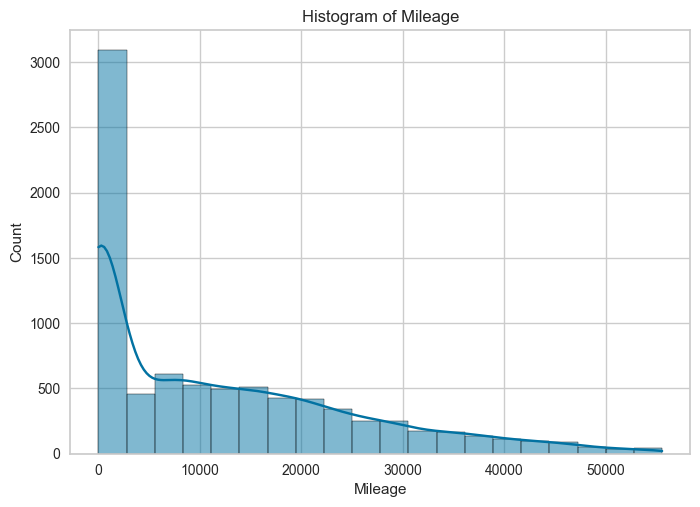

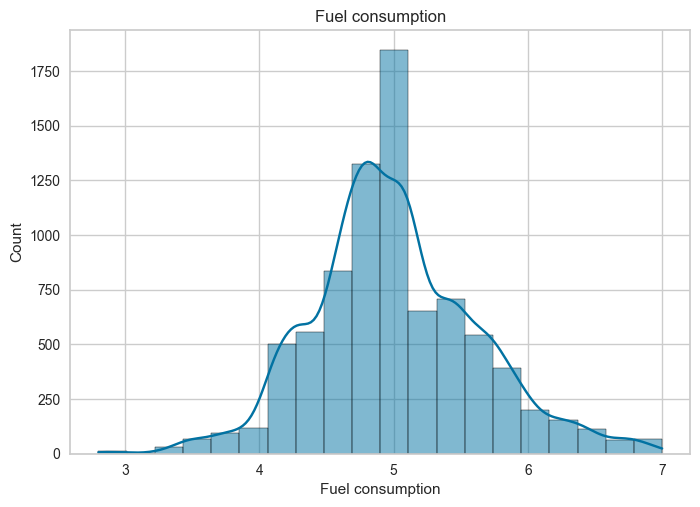

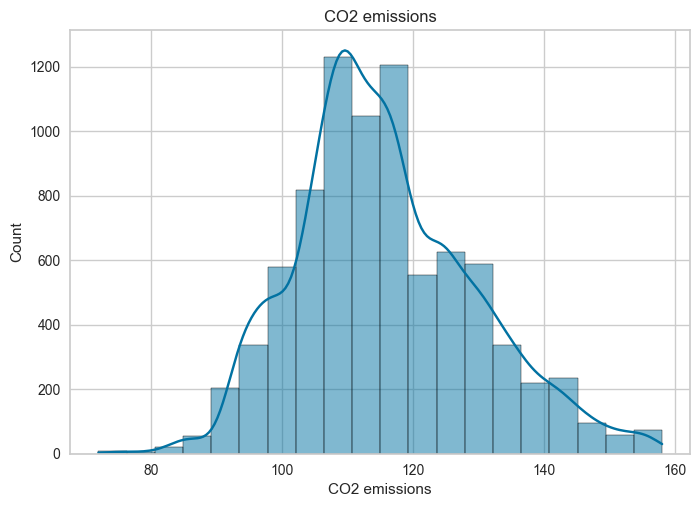

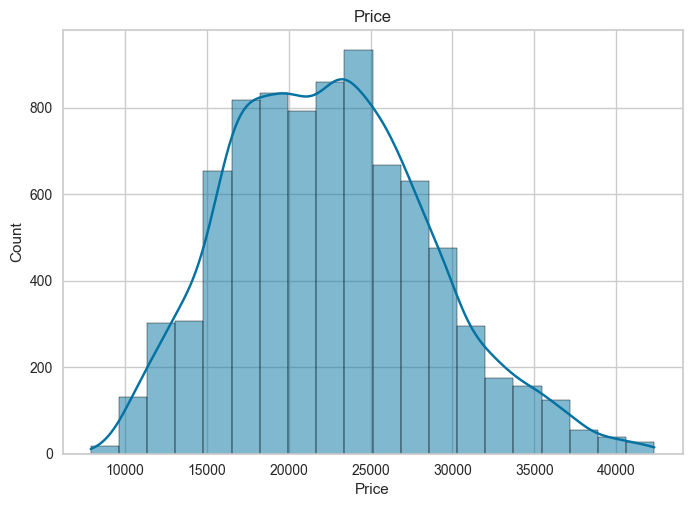

In [168]:
# Histogram for Age(years)
sns.histplot(data=data, x='Age(years)', bins=20, kde=True)
plt.title('Histogram of Age')
plt.xlabel('Age(years)')
plt.ylabel('Count')
plt.show()

# Histogram for Power(hp)
sns.histplot(data=data, x='Power(hp)', bins=20, kde=True)
plt.title('Histogram of Power')
plt.xlabel('Power(hp)')
plt.ylabel('Count')
plt.show()

# Histogram for Mileage(km)
sns.histplot(data=data, x='Mileage(km)', bins=20, kde=True)
plt.title('Histogram of Mileage')
plt.xlabel('Mileage')
plt.ylabel('Count')
plt.show()

# Histogram for Fuel consumption (l/100km - comb.)
sns.histplot(data=data, x='Fuel consumption (l/100km - comb.)', bins=20, kde=True)
plt.title('Fuel consumption')
plt.xlabel('Fuel consumption')
plt.ylabel('Count')
plt.show()

# Histogram for CO2 emissions (g CO2/km - comb.)
sns.histplot(data=data, x='CO2 emissions (g CO2/km - comb.)', bins=20, kde=True)
plt.title('CO2 emissions')
plt.xlabel('CO2 emissions')
plt.ylabel('Count')
plt.show()

# Histogram for Price(€)
sns.histplot(data=data, x='Price(€)', bins=20, kde=True)
plt.title('Price')
plt.xlabel('Price')
plt.ylabel('Count')
plt.show()

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">AGE</p>

<Axes: xlabel='Age(years)', ylabel='Density'>

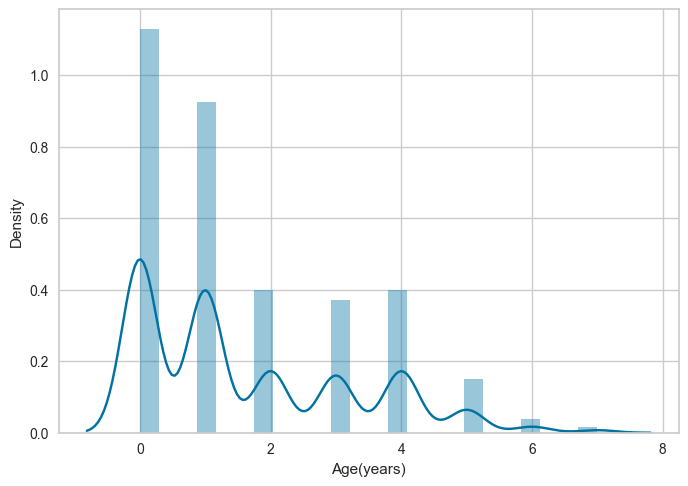

In [169]:
sns.distplot(data['Age(years)'])

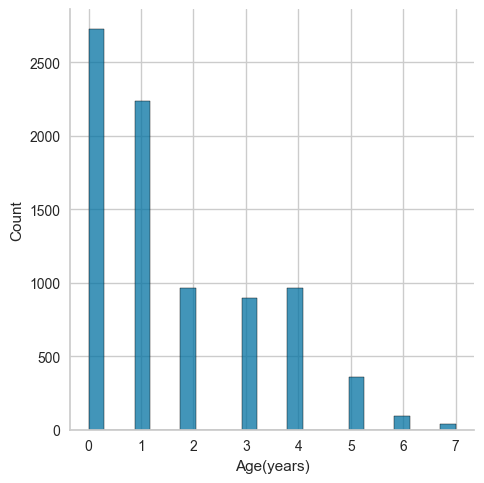

In [170]:
sns.displot(data['Age(years)'])

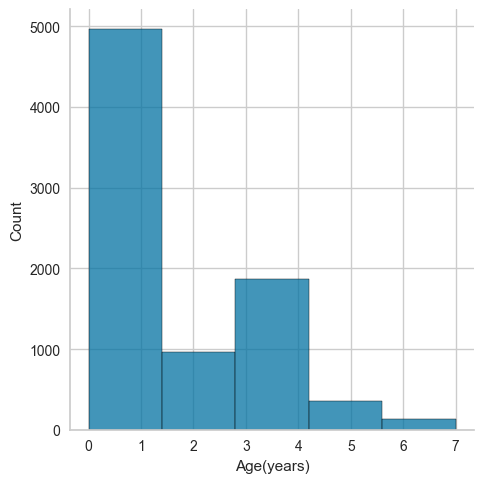

In [171]:
sns.displot(data['Age(years)'], bins=5)

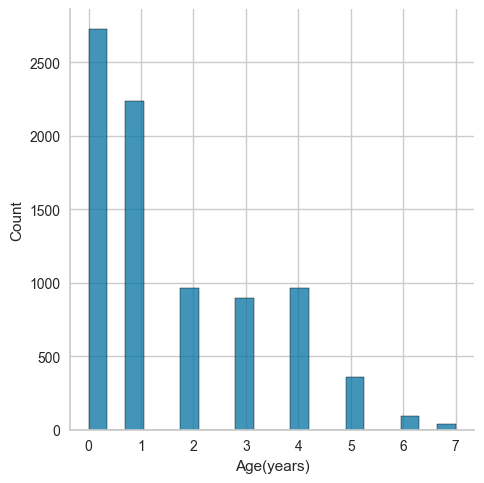

In [172]:
sns.displot(data['Age(years)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">POWER</p>

<Axes: xlabel='Power(hp)', ylabel='Density'>

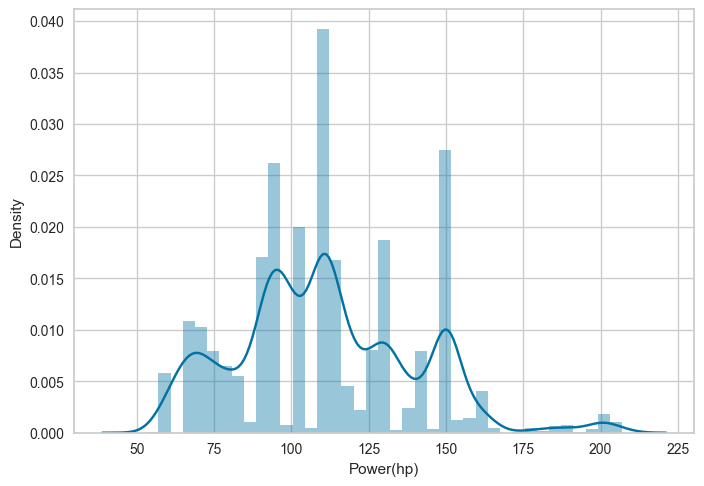

In [173]:
sns.distplot(data['Power(hp)'])

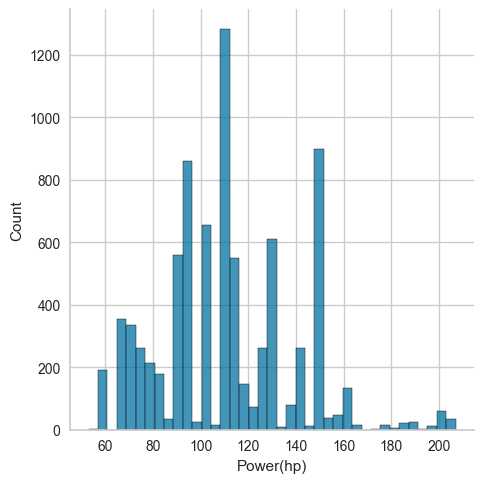

In [174]:
sns.displot(data['Power(hp)'])

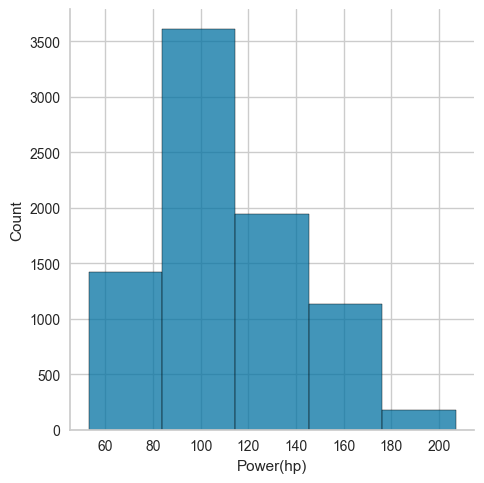

In [175]:
sns.displot(data['Power(hp)'], bins=5)

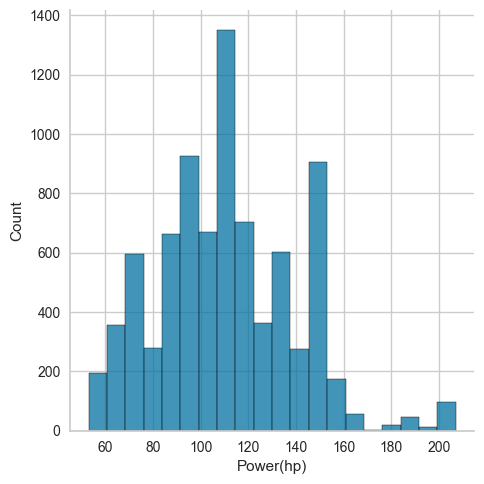

In [176]:
sns.displot(data['Power(hp)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">MILEAGE</p>

<Axes: xlabel='Mileage(km)', ylabel='Density'>

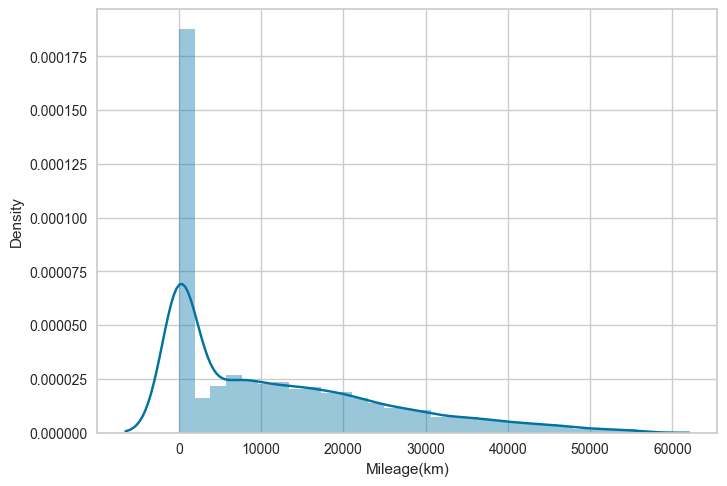

In [177]:
sns.distplot(data['Mileage(km)'])

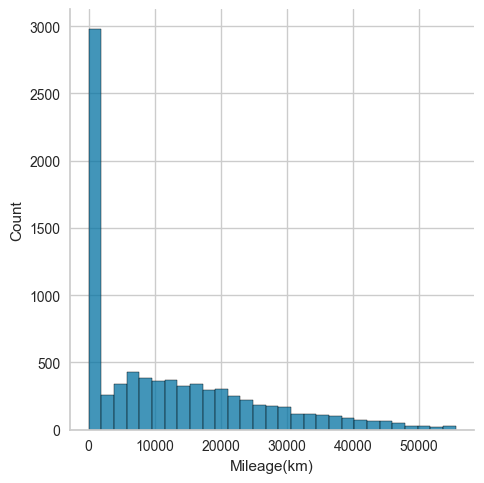

In [178]:
sns.displot(data['Mileage(km)'])

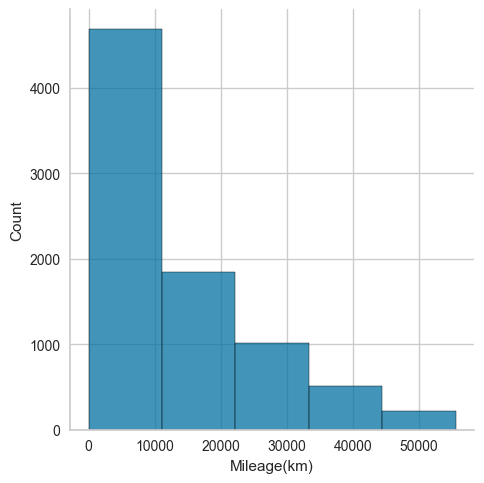

In [179]:
sns.displot(data['Mileage(km)'], bins=5)

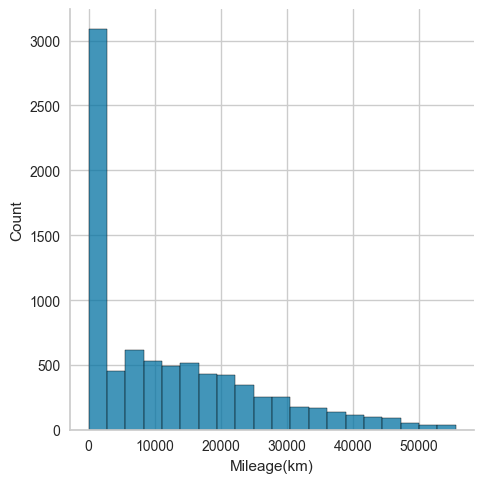

In [180]:
sns.displot(data['Mileage(km)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">FUEL CONSUMPTION</p>

<Axes: xlabel='Fuel consumption (l/100km - comb.)', ylabel='Density'>

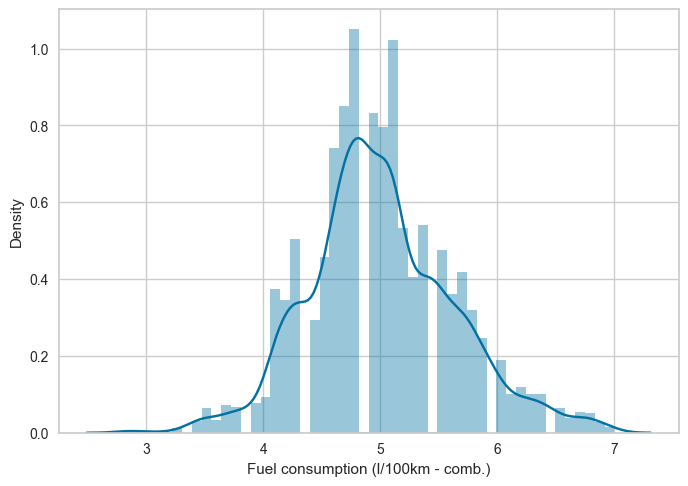

In [181]:
sns.distplot(data['Fuel consumption (l/100km - comb.)'])

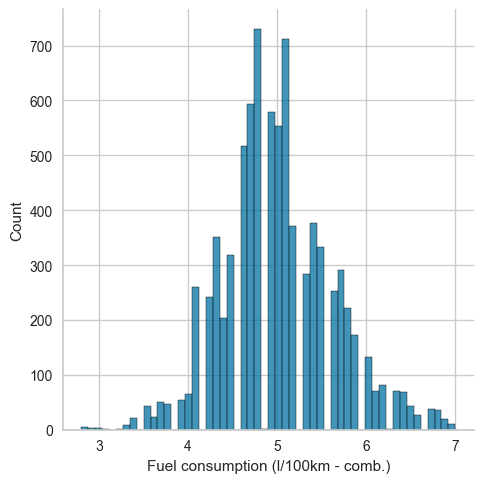

In [183]:
sns.displot(data['Fuel consumption (l/100km - comb.)'])

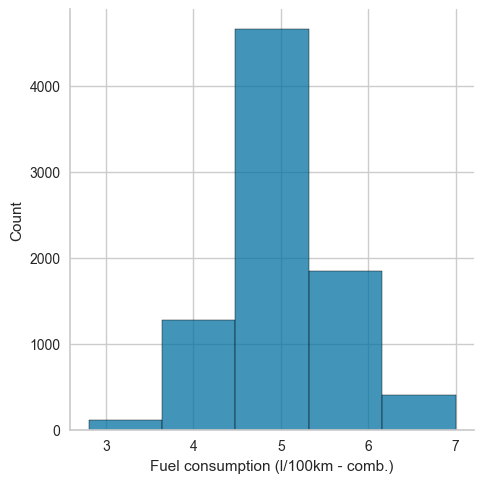

In [184]:
sns.displot(data['Fuel consumption (l/100km - comb.)'], bins=5)

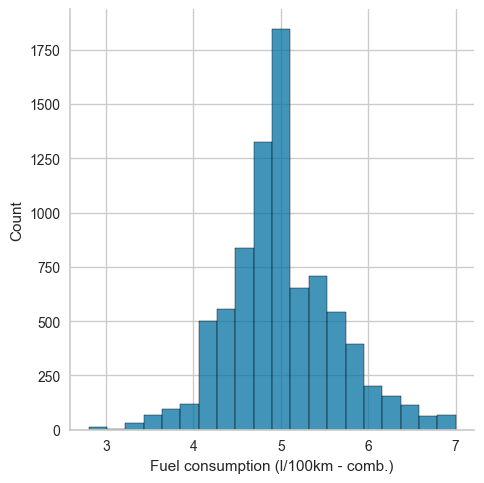

In [185]:
sns.displot(data['Fuel consumption (l/100km - comb.)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">CO2 emissions</p>

<Axes: xlabel='CO2 emissions (g CO2/km - comb.)', ylabel='Density'>

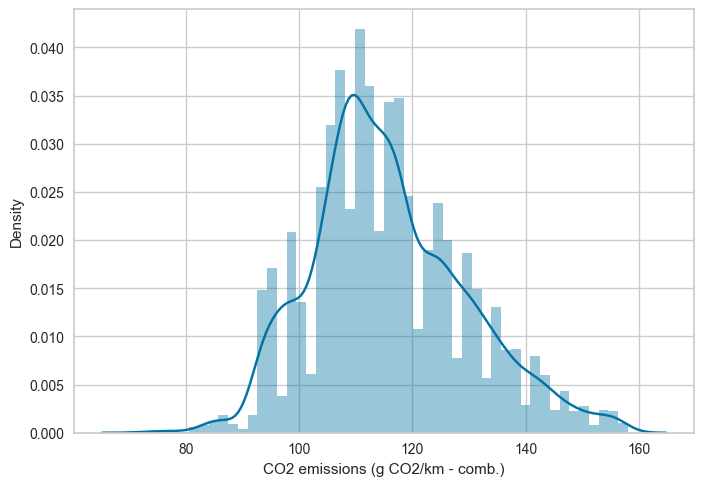

In [186]:
sns.distplot(data['CO2 emissions (g CO2/km - comb.)'])

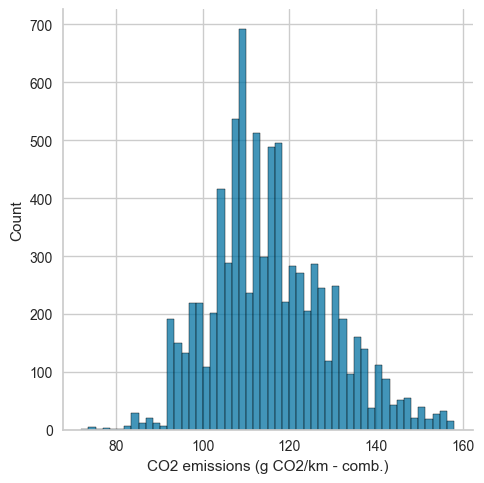

In [187]:
sns.displot(data['CO2 emissions (g CO2/km - comb.)'])

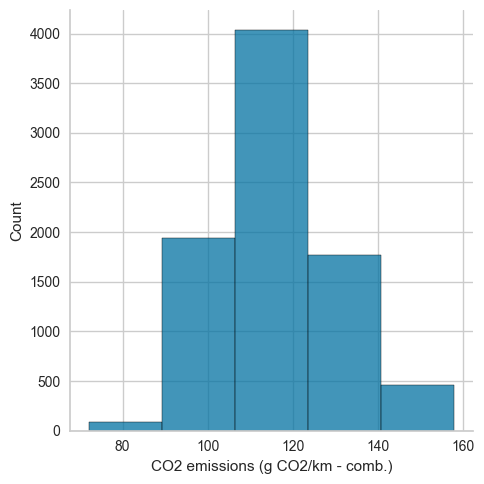

In [188]:
sns.displot(data['CO2 emissions (g CO2/km - comb.)'], bins=5)

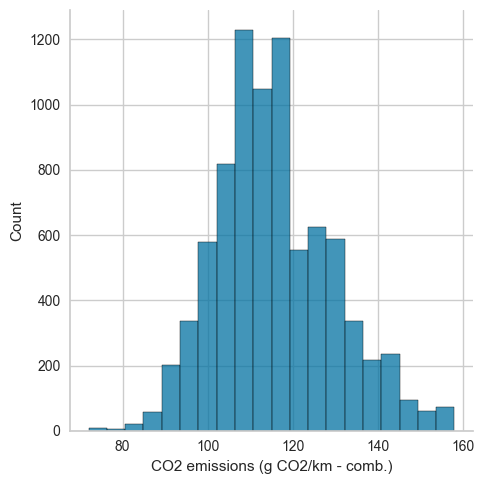

In [189]:
sns.displot(data['CO2 emissions (g CO2/km - comb.)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">PRICE</p>

<Axes: xlabel='Price(€)', ylabel='Density'>

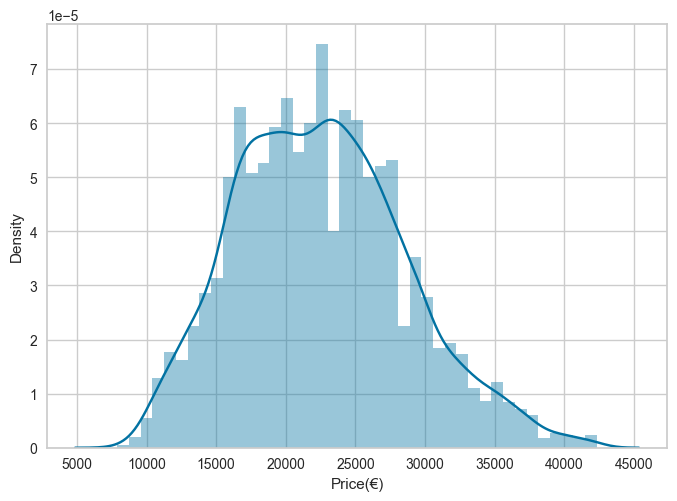

In [190]:
sns.distplot(data['Price(€)'])

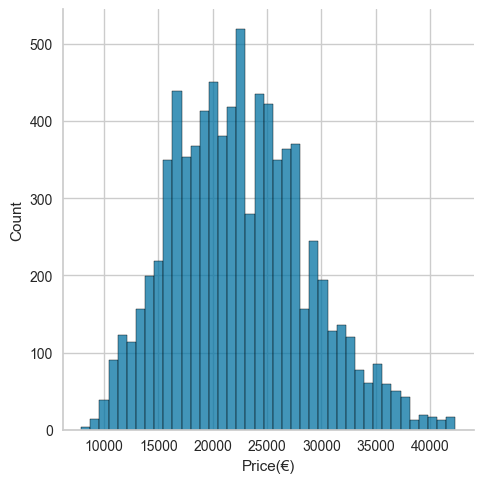

In [191]:
sns.displot(data['Price(€)'])

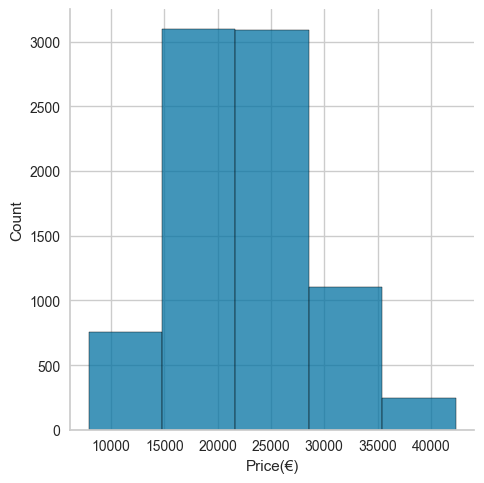

In [192]:
sns.displot(data['Price(€)'], bins=5)

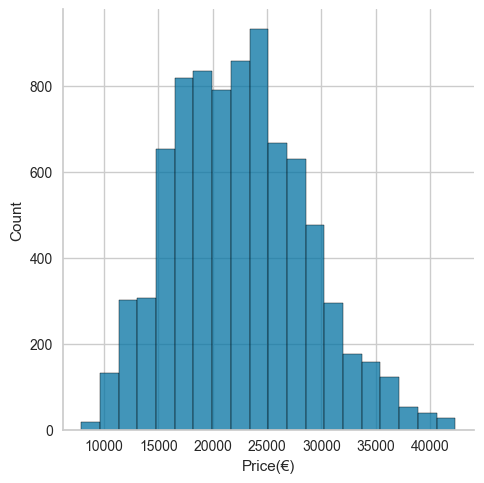

In [193]:
sns.displot(data['Price(€)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">PARAMETERS OF NUMERICAL VARIABLES </p>

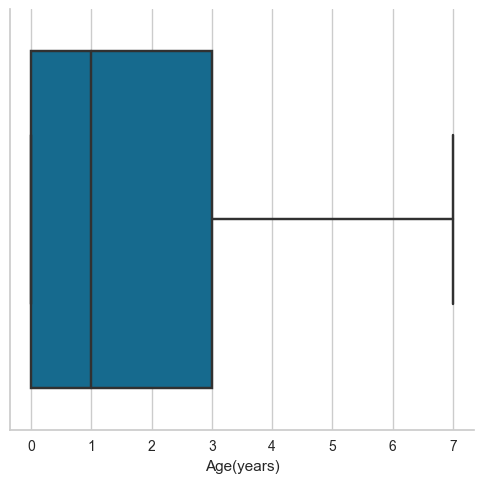

In [194]:
sns.catplot(x='Age(years)', kind= 'box', data= data)

In [195]:
# Use describe() method to get summary statistics of the Age(years) column
desc = data['Age(years)'].describe()

# Print the summary statistics
print(desc)

count    8290.00000
mean        1.61351
std         1.64454
min         0.00000
25%         0.00000
50%         1.00000
75%         3.00000
max         7.00000
Name: Age(years), dtype: float64


In [196]:
# Compute summary statistics of the Age(years) column
mileage_stats = data['Age(years)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  7.5


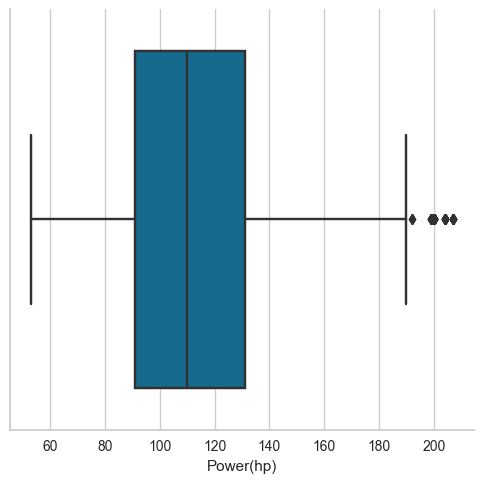

In [197]:
sns.catplot(x='Power(hp)', kind= 'box', data= data)

In [198]:
# Use describe() method to get summary statistics of the Power(hp) column
desc = data['Power(hp)'].describe()

# Print the summary statistics
print(desc)

count    8290.000000
mean      110.704946
std        28.691705
min        53.000000
25%        91.000000
50%       110.000000
75%       131.000000
max       207.000000
Name: Power(hp), dtype: float64


In [199]:
# Compute summary statistics of the Power(hp) column
mileage_stats = data['Power(hp)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)


Upper whisker:  191.0


In [200]:
# Compute summary statistics of the Power(hp) column
mileage_stats = data['Power(hp)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the lower whisker
lower_whisker = Q1 - 1.5 * IQR

# Print the lower whisker
print("Lower whisker: ", lower_whisker)


Lower whisker:  31.0


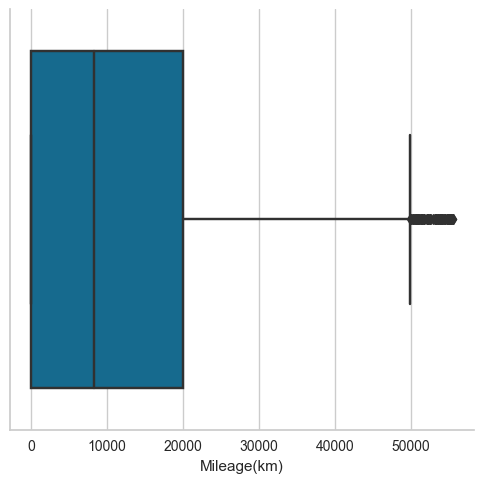

In [201]:
sns.catplot(x='Mileage(km)', kind= 'box', data= data)

In [202]:
# Use describe() method to get summary statistics of the Mileage column
desc = data['Mileage(km)'].describe()

# Print the summary statistics
print(desc)

count     8290.000000
mean     12087.011339
std      13144.872899
min          0.000000
25%         15.000000
50%       8260.500000
75%      19979.000000
max      55556.000000
Name: Mileage(km), dtype: float64


In [203]:
# Compute summary statistics of the Mileage column
mileage_stats = data['Mileage(km)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  49925.0


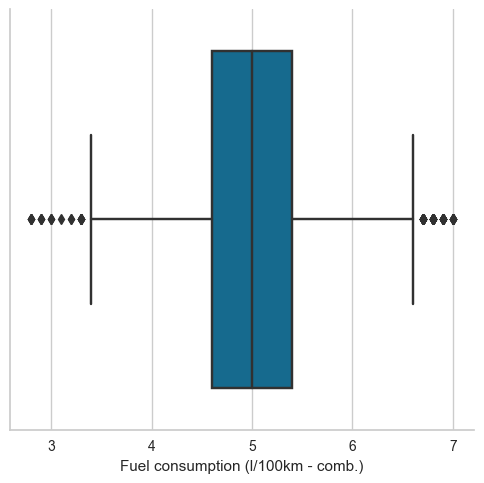

In [204]:
sns.catplot(x='Fuel consumption (l/100km - comb.)', kind= 'box', data= data)

In [205]:
# Use describe() method to get summary statistics of the Fuel consumption column
desc = data['Fuel consumption (l/100km - comb.)'].describe()

# Print the summary statistics
print(desc)

count    8290.000000
mean        5.007304
std         0.625094
min         2.800000
25%         4.600000
50%         5.000000
75%         5.400000
max         7.000000
Name: Fuel consumption (l/100km - comb.), dtype: float64


In [206]:
# Compute summary statistics of the Fuel consumption column
mileage_stats = data['Fuel consumption (l/100km - comb.)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  6.600000000000001


In [207]:
# Compute summary statistics of the Power(hp) column
mileage_stats = data['Fuel consumption (l/100km - comb.)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the lower whisker
lower_whisker = Q1 - 1.5 * IQR

# Print the lower whisker
print("Lower whisker: ", lower_whisker)


Lower whisker:  3.3999999999999986


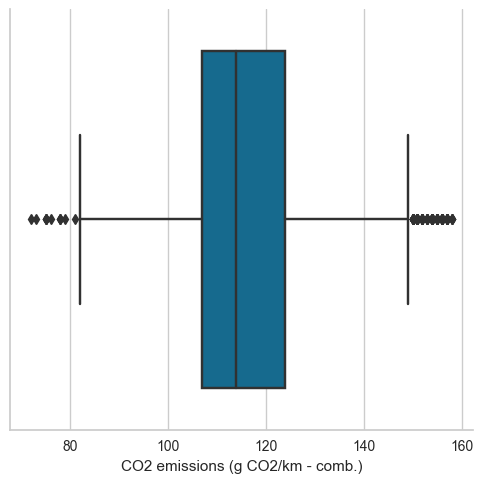

In [208]:
sns.catplot(x='CO2 emissions (g CO2/km - comb.)', kind= 'box', data= data)

In [209]:
# Use describe() method to get summary statistics of the CO2 emissions column
desc = data['CO2 emissions (g CO2/km - comb.)'].describe()

# Print the summary statistics
print(desc)

count    8290.000000
mean      115.765259
std        13.635108
min        72.000000
25%       107.000000
50%       114.000000
75%       124.000000
max       158.000000
Name: CO2 emissions (g CO2/km - comb.), dtype: float64


In [210]:
# Compute summary statistics of the CO2 emissions column
mileage_stats = data['CO2 emissions (g CO2/km - comb.)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  149.5


In [211]:
# Compute summary statistics of the Power(hp) column
mileage_stats = data['CO2 emissions (g CO2/km - comb.)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the lower whisker
lower_whisker = Q1 - 1.5 * IQR

# Print the lower whisker
print("Lower whisker: ", lower_whisker)


Lower whisker:  81.5


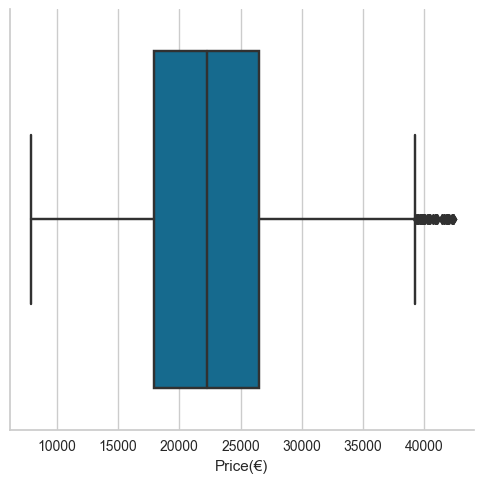

In [212]:
sns.catplot(x='Price(€)', kind= 'box', data= data)

In [213]:
# Use describe() method to get summary statistics of the price column
desc = data['Price(€)'].describe()

# Print the summary statistics
print(desc)

count     8290.000000
mean     22529.381182
std       6139.544703
min       7900.000000
25%      17950.000000
50%      22249.500000
75%      26490.000000
max      42330.000000
Name: Price(€), dtype: float64


In [214]:
# Compute summary statistics of the price column
mileage_stats = data['Price(€)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  39300.0


In [215]:
# Compute summary statistics of the Power(hp) column
mileage_stats = data['Price(€)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the lower whisker
lower_whisker = Q1 - 1.5 * IQR

# Print the lower whisker
print("Lower whisker: ", lower_whisker)


Lower whisker:  5140.0


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">LOADING DATA</p>

 In the third and last part, I mostly relied on the example we worked on in the class. 
Based on what we did, I applied it to my dataset to get a better insight and apply in practice what we did in class. 
    For this part, I saved the data set as analysis.csv.

In [216]:
#Loading the dataset
data = pd.read_csv('C:/Users/Ivan/Desktop/Hey.car/ALL/5.filtered.csv')
data['Year of production'] = pd.to_datetime(data['Year of production'])

print("Number of datapoints:", len(data))
display(data.head(10))  
display(data.tail(10)) 

Number of datapoints: 8290


,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location
0,Ford Ka,Ka Black White 1.2l Klima+SHZ+Tel.Vorb. PDC+ZV,2019-05-01,4,86,Gasoline,Manual,12747,5.0,114,11530,Erbach
1,Hyundai i10,Intro,2021-01-01,2,67,Gasoline,Manual,3620,4.5,104,14998,Wölfersheim
2,Lada Kalina,Cross Luxus,2017-10-01,6,98,Gasoline,Manual,11270,6.7,154,8950,Neuss
3,Volkswagen Golf Variant,Golf Variant VII 1.0 Trendline BMT TSI Navi,2020-02-01,3,116,Gasoline,Manual,5000,4.9,113,19990,Vordorf
4,Skoda Citigo,Cool Edition,2019-03-01,4,60,Gasoline,Manual,28500,4.1,96,10880,Kreuzwertheim
5,Seat Leon,Style,2020-12-01,3,131,Gasoline,Manual,12790,5.1,117,21940,Nürnberg
6,Toyota Aygo,Aygo X 1.0 VVT-i 72 CVT ACC SmartCo Kam Klim,2023-04-01,0,72,Gasoline,Automatic,10,4.8,110,17188,Freiburg
7,Fiat 500,Cult,2023-05-01,0,69,Hybrid/Gasoline,Manual,10,5.5,93,18390,Köln
8,Seat Ibiza,Style,2018-07-01,5,75,Gasoline,Manual,18050,4.9,112,12450,Beilngries
9,Seat Arona,Xcellence,2020-10-01,3,95,Diesel,Manual,11500,4.0,106,20930,Feldkirchen/Westerham


,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location
8280,Volkswagen T-Roc,T-Roc 1.0 TSI ACC*PDC*AHK*GJR*EL.FH*KLIMA*ZV,2018-04-01,5,116,Gasoline,Manual,18990,5.1,117,19990,Achim
8281,Mazda 3,3 G122 Homura *LED*Parkpilot*Kamera*Navi*CarPlay*,2023-04-01,0,120,Gasoline,Manual,0,5.1,119,25970,Düsseldorf
8282,Volkswagen T-Roc,T-Roc 1.0 TSI Life Navi LED SzHzg,2022-09-01,1,110,Gasoline,Manual,18700,5.2,118,23990,Karlsruhe
8283,Audi Sportback,A3 Sportback 35 TFSI S tronic 2x S line Matrix...,2022-08-01,1,150,Gasoline,Automatic,4468,4.8,111,36969,Eching
8284,Renault Grand Scenic,Limited,2023-04-01,0,140,Gasoline,Automatic,0,6.3,136,39939,Chemnitz
8285,Opel Corsa,Corsa E 120 Jahre *CarPlay*SHZ*PDC*Klima*Lenkr...,2019-06-01,4,69,Gasoline,Manual,18889,5.6,148,12740,Dormagen
8286,Volkswagen Golf,Golf VIII 2.0 TDI DSG Active AHK/NAVI/KAMERA/ACC,2022-09-01,1,150,Diesel,Automatic,9309,3.8,101,31998,Mayen
8287,Volkswagen up,colour up! sandstorm yellow,2019-05-01,4,60,Gasoline,Manual,25990,4.2,95,11990,Bremerhaven
8288,Renault Clio,Business Edition,2022-09-01,1,91,Gasoline,Manual,8061,5.1,117,17990,Berlin
8289,Opel Corsa,Corsa,2022-03-01,1,101,Gasoline,Manual,6329,5.3,123,18440,Berlin


In [217]:
data.to_csv(r'C:/Users/Ivan/Desktop/Hey.car/ALL/6.analysis.csv', index=False)

In [220]:
#Loading the dataset
data = pd.read_csv('C:/Users/Ivan/Desktop/Hey.car/ALL/6.analysis.csv')
data['Year of production'] = pd.to_datetime(data['Year of production'])

print("Number of datapoints:", len(data))
display(data.head(10))  
display(data.tail(10)) 

Number of datapoints: 8290


,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location
0,Ford Ka,Ka Black White 1.2l Klima+SHZ+Tel.Vorb. PDC+ZV,2019-05-01,4,86,Gasoline,Manual,12747,5.0,114,11530,Erbach
1,Hyundai i10,Intro,2021-01-01,2,67,Gasoline,Manual,3620,4.5,104,14998,Wölfersheim
2,Lada Kalina,Cross Luxus,2017-10-01,6,98,Gasoline,Manual,11270,6.7,154,8950,Neuss
3,Volkswagen Golf Variant,Golf Variant VII 1.0 Trendline BMT TSI Navi,2020-02-01,3,116,Gasoline,Manual,5000,4.9,113,19990,Vordorf
4,Skoda Citigo,Cool Edition,2019-03-01,4,60,Gasoline,Manual,28500,4.1,96,10880,Kreuzwertheim
5,Seat Leon,Style,2020-12-01,3,131,Gasoline,Manual,12790,5.1,117,21940,Nürnberg
6,Toyota Aygo,Aygo X 1.0 VVT-i 72 CVT ACC SmartCo Kam Klim,2023-04-01,0,72,Gasoline,Automatic,10,4.8,110,17188,Freiburg
7,Fiat 500,Cult,2023-05-01,0,69,Hybrid/Gasoline,Manual,10,5.5,93,18390,Köln
8,Seat Ibiza,Style,2018-07-01,5,75,Gasoline,Manual,18050,4.9,112,12450,Beilngries
9,Seat Arona,Xcellence,2020-10-01,3,95,Diesel,Manual,11500,4.0,106,20930,Feldkirchen/Westerham


,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location
8280,Volkswagen T-Roc,T-Roc 1.0 TSI ACC*PDC*AHK*GJR*EL.FH*KLIMA*ZV,2018-04-01,5,116,Gasoline,Manual,18990,5.1,117,19990,Achim
8281,Mazda 3,3 G122 Homura *LED*Parkpilot*Kamera*Navi*CarPlay*,2023-04-01,0,120,Gasoline,Manual,0,5.1,119,25970,Düsseldorf
8282,Volkswagen T-Roc,T-Roc 1.0 TSI Life Navi LED SzHzg,2022-09-01,1,110,Gasoline,Manual,18700,5.2,118,23990,Karlsruhe
8283,Audi Sportback,A3 Sportback 35 TFSI S tronic 2x S line Matrix...,2022-08-01,1,150,Gasoline,Automatic,4468,4.8,111,36969,Eching
8284,Renault Grand Scenic,Limited,2023-04-01,0,140,Gasoline,Automatic,0,6.3,136,39939,Chemnitz
8285,Opel Corsa,Corsa E 120 Jahre *CarPlay*SHZ*PDC*Klima*Lenkr...,2019-06-01,4,69,Gasoline,Manual,18889,5.6,148,12740,Dormagen
8286,Volkswagen Golf,Golf VIII 2.0 TDI DSG Active AHK/NAVI/KAMERA/ACC,2022-09-01,1,150,Diesel,Automatic,9309,3.8,101,31998,Mayen
8287,Volkswagen up,colour up! sandstorm yellow,2019-05-01,4,60,Gasoline,Manual,25990,4.2,95,11990,Bremerhaven
8288,Renault Clio,Business Edition,2022-09-01,1,91,Gasoline,Manual,8061,5.1,117,17990,Berlin
8289,Opel Corsa,Corsa,2022-03-01,1,101,Gasoline,Manual,6329,5.3,123,18440,Berlin


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">DATA SCREENING</p>

Given that I cleaned the data and removed outliers in the previous steps, I did not deal with it much. 
For this reason, instead of data cleaning, I called it data screening. 
In this step, I examined the information related to the dataset that I have.

In [221]:
#Information on features 
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8290 entries, 0 to 8289
Data columns (total 12 columns):
 #   Column                              Non-Null Count  Dtype         
---  ------                              --------------  -----         
 0   Model                               8290 non-null   object        
 1   Edition                             8076 non-null   object        
 2   Year of production                  8290 non-null   datetime64[ns]
 3   Age(years)                          8290 non-null   int64         
 4   Power(hp)                           8290 non-null   int64         
 5   Fuel type                           8290 non-null   object        
 6   Gearbox                             8290 non-null   object        
 7   Mileage(km)                         8290 non-null   int64         
 8   Fuel consumption (l/100km - comb.)  8290 non-null   float64       
 9   CO2 emissions (g CO2/km - comb.)    8290 non-null   int64         
 10  Price(€)                

In [223]:
data['Year of production'] = pd.to_datetime(data['Year of production'])
dates = []
for i in data['Year of production']:
    i = i.date()
    dates.append(i)  
#Dates of the newest and oldest auto in advertisements
print("The newest auto in advertisements:",max(dates))
print("The oldest auto in advertisements:",min(dates))

The newest auto in advertisements: 2023-05-01
The oldest auto in advertisements: 2016-03-01


In [224]:
dates

[datetime.date(2019, 5, 1),
 datetime.date(2021, 1, 1),
 datetime.date(2017, 10, 1),
 datetime.date(2020, 2, 1),
 datetime.date(2019, 3, 1),
 datetime.date(2020, 12, 1),
 datetime.date(2023, 4, 1),
 datetime.date(2023, 5, 1),
 datetime.date(2018, 7, 1),
 datetime.date(2020, 10, 1),
 datetime.date(2022, 4, 1),
 datetime.date(2020, 1, 1),
 datetime.date(2023, 4, 1),
 datetime.date(2022, 3, 1),
 datetime.date(2023, 4, 1),
 datetime.date(2023, 4, 1),
 datetime.date(2019, 11, 1),
 datetime.date(2023, 4, 1),
 datetime.date(2023, 4, 1),
 datetime.date(2022, 4, 1),
 datetime.date(2023, 4, 1),
 datetime.date(2023, 3, 1),
 datetime.date(2019, 8, 1),
 datetime.date(2023, 4, 1),
 datetime.date(2023, 4, 1),
 datetime.date(2019, 10, 1),
 datetime.date(2019, 10, 1),
 datetime.date(2022, 8, 1),
 datetime.date(2020, 4, 1),
 datetime.date(2023, 4, 1),
 datetime.date(2023, 4, 1),
 datetime.date(2019, 11, 1),
 datetime.date(2018, 12, 1),
 datetime.date(2022, 5, 1),
 datetime.date(2023, 4, 1),
 datetime.da

In [225]:
days = []
d1 = max(dates) 
print(d1)
for i in dates:
    delta = d1 - i
    days.append(delta)
data["Old_in_days"] = days
data["Old_in_days"] = pd.to_numeric(data["Old_in_days"], errors="coerce")

2023-05-01


In [226]:
data["Old_in_days"]

0       126230400000000000
1        73440000000000000
2       176083200000000000
3       102384000000000000
4       131500800000000000
               ...        
8285    123552000000000000
8286     20908800000000000
8287    126230400000000000
8288     20908800000000000
8289     36806400000000000
Name: Old_in_days, Length: 8290, dtype: int64

Exploring the unique values in the categorical features to get a clear idea of the data.

In [229]:
print("Total categories in the feature \"Model\":\n", data["Model"].value_counts(), "\n")
print("Total categories in the feature \"Fuel type\":\n", data["Fuel type"].value_counts(), "\n")
print("Total categories in the feature Gearbox:\n", data["Gearbox"].value_counts(), "\n")
print("Total categories in the feature \"Location\":\n", data["Location"].value_counts())

Total categories in the feature "Model":
 Volkswagen Polo         575
Volkswagen T-Cross      495
Volkswagen Golf         370
Opel Corsa              352
Volkswagen up           350
                       ... 
Abarth 500                1
Fiat Scudo                1
Skoda Superb              1
MINI Cooper S Cabrio      1
Renault Talisman          1
Name: Model, Length: 215, dtype: int64 

Total categories in the feature "Fuel type":
 Gasoline           7371
Diesel              538
Hybrid/Gasoline     257
LPG                  64
CNG                  58
Others                1
Hybrid/Diesel         1
Name: Fuel type, dtype: int64 

Total categories in the feature Gearbox:
 Manual       5875
Automatic    2415
Name: Gearbox, dtype: int64 

Total categories in the feature "Location":
 Berlin        265
Hamburg       192
Köln          141
Essen         130
Düsseldorf    126
             ... 
Emden           1
Erding          1
Tuttlingen      1
Hünxe           1
Achim           1
Name: Locati

In [230]:
print("Total categories in the feature Model:\n", data["Model"].value_counts())

Total categories in the feature Model:
 Volkswagen Polo         575
Volkswagen T-Cross      495
Volkswagen Golf         370
Opel Corsa              352
Volkswagen up           350
                       ... 
Abarth 500                1
Fiat Scudo                1
Skoda Superb              1
MINI Cooper S Cabrio      1
Renault Talisman          1
Name: Model, Length: 215, dtype: int64


To take a look at the broader view of the data I will plot some of the selected features.

Relative Plot Of Some Selected Features: A Data Subset


<Figure size 800x550 with 0 Axes>

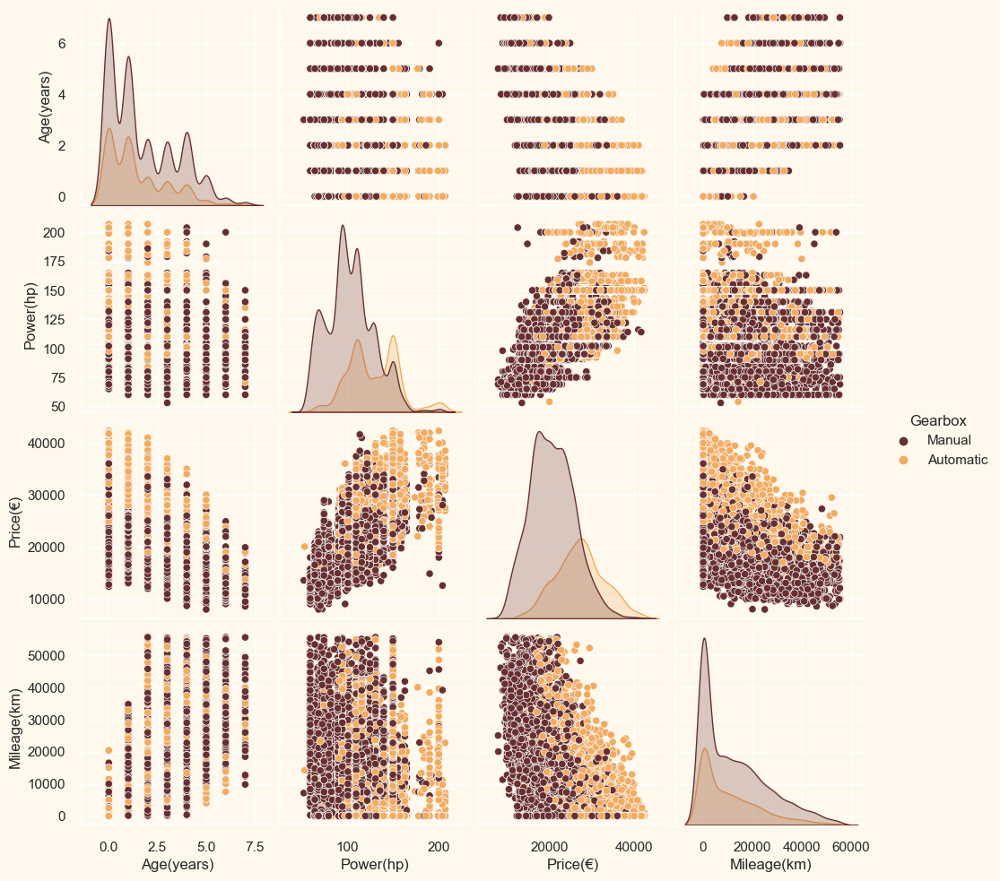

In [231]:
sns.set(rc={"axes.facecolor":"#FFF9ED","figure.facecolor":"#FFF9ED"})
pallet = ["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60"]
cmap = colors.ListedColormap(["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60"])
#Plotting following features
To_Plot = [ "Age(years)", "Gearbox", "Power(hp)", "Price(€)", "Mileage(km)",]
print("Relative Plot Of Some Selected Features: A Data Subset")
plt.figure()
sns.pairplot(data[To_Plot], hue= "Gearbox",palette= (["#682F2F","#F3AB60"]))
#Taking hue 
plt.show()

Same plot in simpler form

<Figure size 800x550 with 0 Axes>

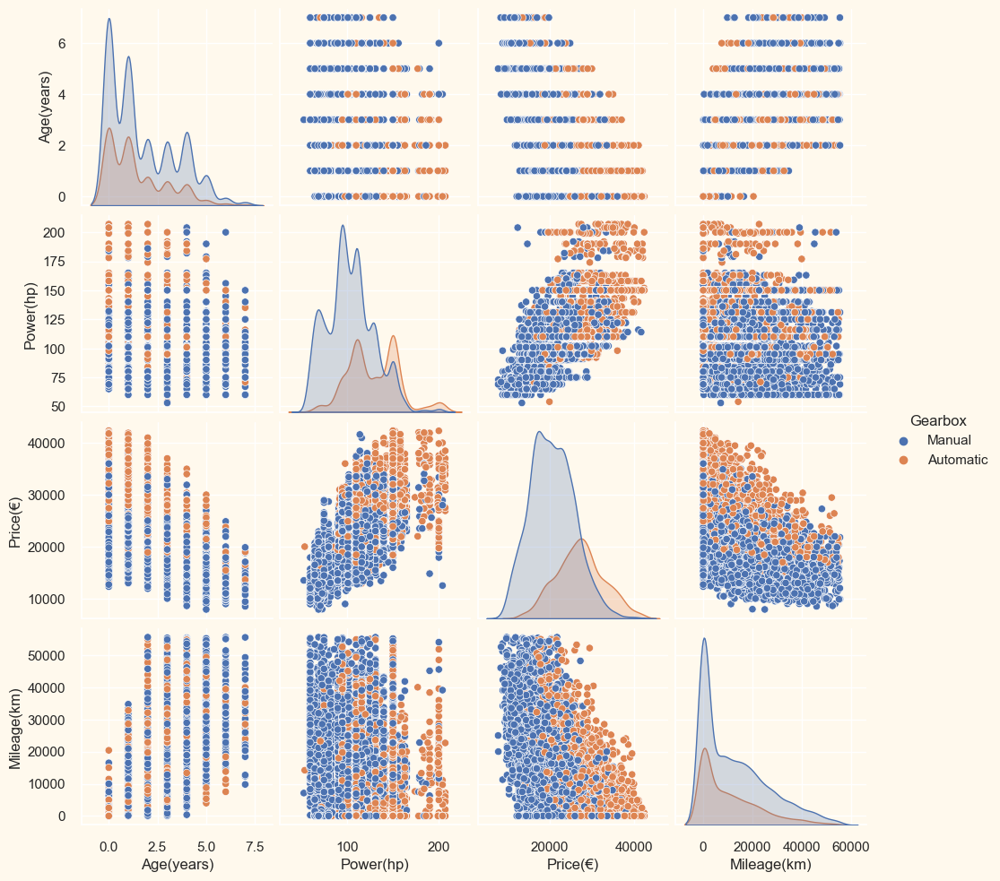

In [232]:
To_Plot = [ "Age(years)", "Gearbox", "Power(hp)", "Price(€)", "Mileage(km)",]
plt.figure()
sns.pairplot(data[To_Plot], hue= "Gearbox")
plt.show()

Relative Plot Of Some Selected Features: A Data Subset


<Figure size 800x550 with 0 Axes>

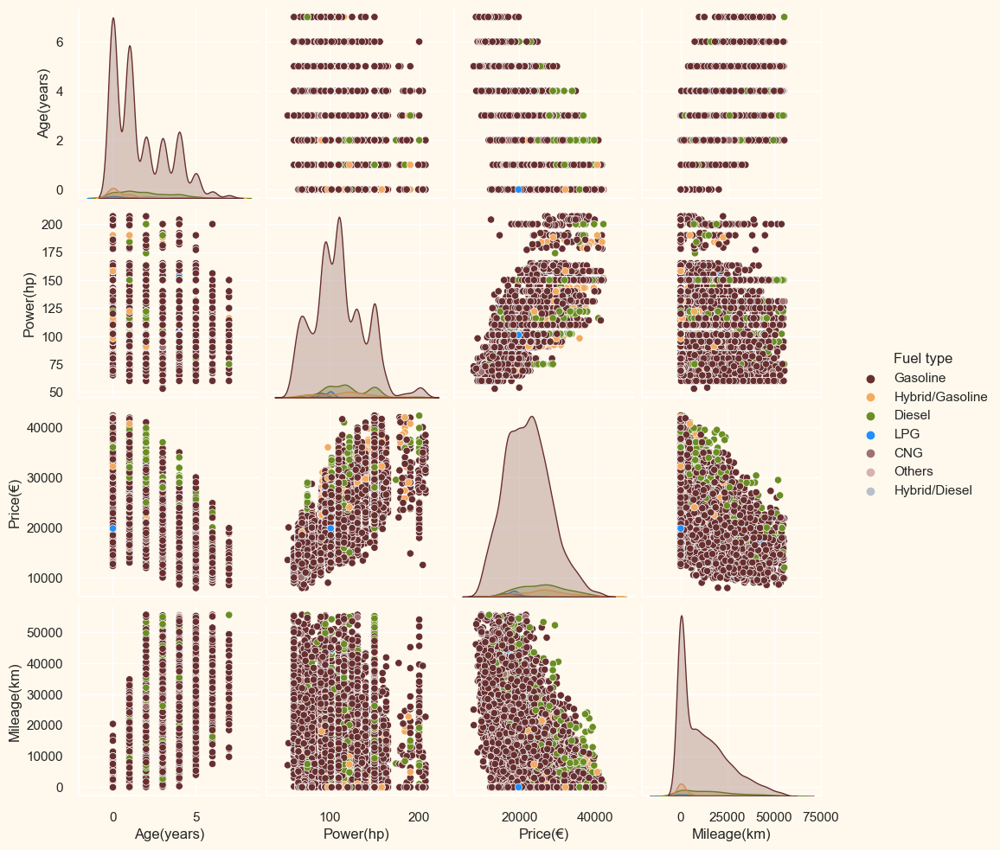

In [236]:
sns.set(rc={"axes.facecolor":"#FFF9ED","figure.facecolor":"#FFF9ED"})
pallet = ["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60", "#6B8E23", "#1E90FF"]
cmap = colors.ListedColormap(["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60", "#6B8E23", "#1E90FF"])
#Plotting following features
To_Plot = [ "Age(years)", "Fuel type", "Power(hp)", "Price(€)", "Mileage(km)",]
print("Relative Plot Of Some Selected Features: A Data Subset")
plt.figure()
sns.pairplot(data[To_Plot], hue= "Fuel type",palette= (["#682F2F","#F3AB60", "#6B8E23", "#1E90FF", "#9E726F", "#D6B2B1", "#B9C0C9",]))
#Taking hue 
plt.show()

<Figure size 800x550 with 0 Axes>

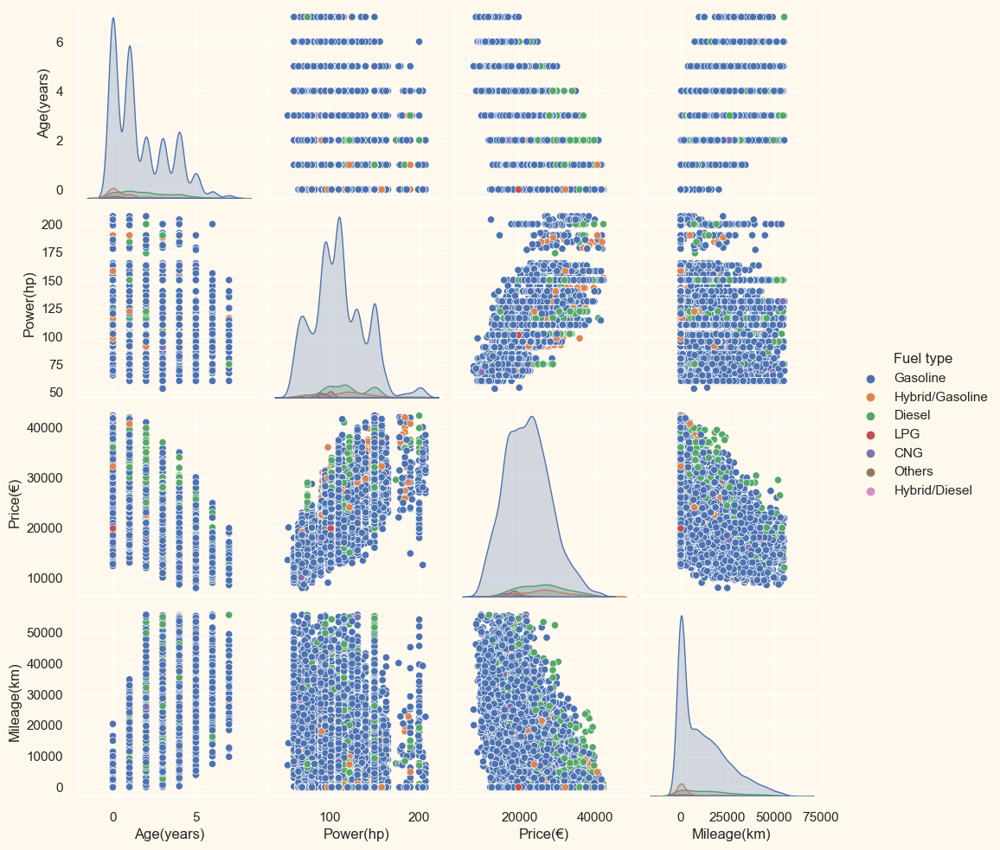

In [237]:
To_Plot = [ "Age(years)", "Fuel type", "Power(hp)", "Price(€)", "Mileage(km)",]
plt.figure()
sns.pairplot(data[To_Plot], hue= "Fuel type")
plt.show()

The correlation amongst the features (excluding the categorical attributes at this point)

<Axes: >

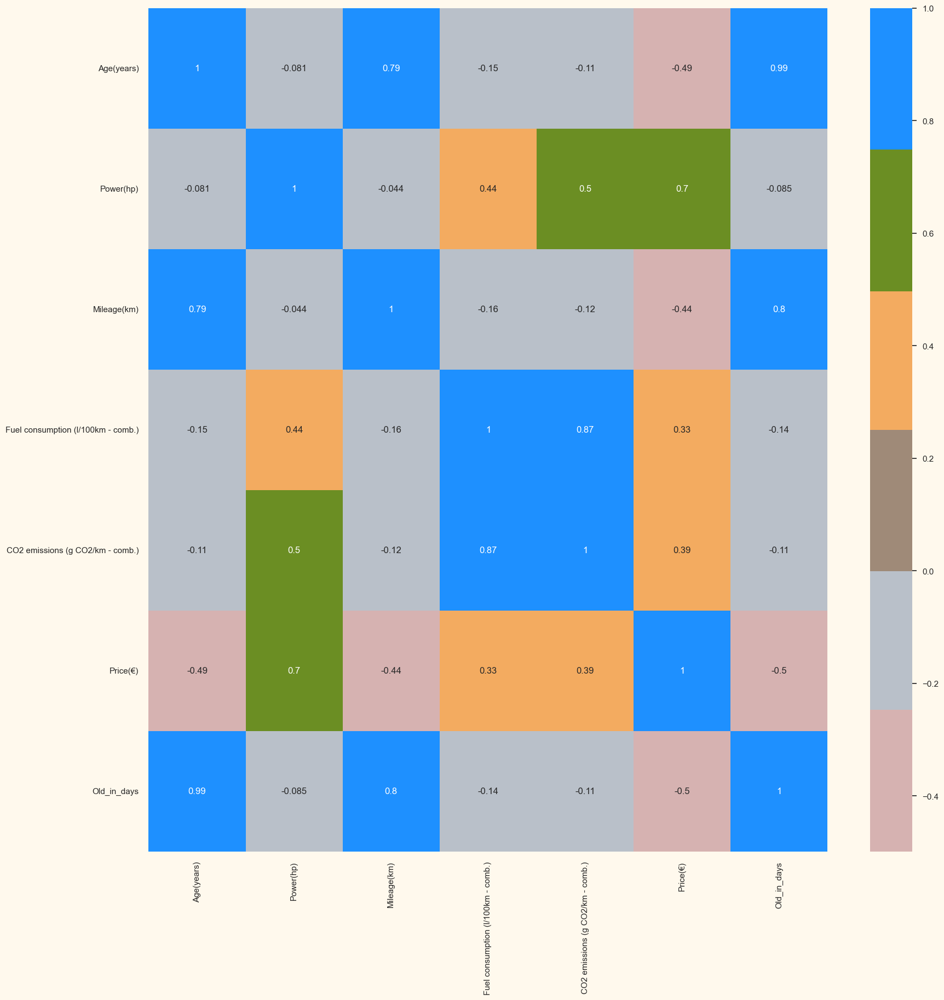

In [238]:
#correlation matrix
corrmat= data.corr()
plt.figure(figsize=(20,20))  
sns.heatmap(corrmat,annot=True, cmap=cmap, center=0)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">DATA PREPROCESSING</p>

Data preprocessing in Jupyter Notebook refers to the steps taken to transform and prepare the data before performing any analysis or modeling. It involves converting categorical data (such as text or labels) into numerical format, scaling the numerical features to a consistent range, and reducing the dimensionality of the data.

Label encoding is a technique used to convert categorical data into numerical data. It assigns a unique numerical value to each category, allowing algorithms to process the data more effectively. The LabelEncoder class from the scikit-learn library is commonly used in Python to perform label encoding.

Scaling the features involves adjusting the numerical values of different features to a standardized range. This is done using techniques like standard scaling, which subtracts the mean and divides by the standard deviation, resulting in a mean of zero and a standard deviation of one. Scaling ensures that all features have a similar influence on the analysis, preventing any one feature from dominating the results.

Dimensionality reduction is the process of reducing the number of features in the dataset while preserving important information. This is done to simplify the dataset and eliminate irrelevant or redundant features. By creating a subset dataframe, the dimensionality of the data is reduced, making it more manageable for further analysis or modeling.

Overall, data preprocessing is an essential step in data analysis and machine learning tasks as it helps clean, transform, and prepare the data for meaningful insights and accurate modeling.








In [240]:
# Create a LabelEncoder instance
le = LabelEncoder()

# Fit the LabelEncoder to the Fuel type categorical variable
le.fit(data["Model"])

# Get the unique categories and their numerical values
categories = le.classes_
values = le.transform(categories)

# Print the mapping of categories to numerical values
print("Mapping of categories to numerical values for Model:")
for i in range(len(categories)):
    print(f"{categories[i]} -> {values[i]}")

Mapping of categories to numerical values for Model:
Abarth 500 -> 0
Abarth 595 -> 1
Abarth 595 Competizione -> 2
Abarth 595 Turismo -> 3
Abarth 595C -> 4
Audi A1 -> 5
Audi A3 -> 6
Audi A4 -> 7
Audi Q2 -> 8
Audi Q3 -> 9
Audi Sportback -> 10
BMW 116 -> 11
BMW 118 -> 12
BMW 218 -> 13
BMW 320 -> 14
BMW X1 -> 15
BMW X2 -> 16
CUPRA Formentor -> 17
CUPRA Leon -> 18
Citroën Berlingo -> 19
Citroën C1 -> 20
Citroën C3 -> 21
Citroën C3 Aircross -> 22
Citroën C4 -> 23
Citroën C4 Cactus -> 24
Citroën C5 -> 25
DS Automobiles DS 3 -> 26
Dacia Dokker -> 27
Dacia Duster -> 28
Dacia Jogger -> 29
Dacia Lodgy -> 30
Dacia Logan -> 31
Dacia Sandero -> 32
Fiat 500 -> 33
Fiat 500C -> 34
Fiat 500L -> 35
Fiat 500X -> 36
Fiat Doblo -> 37
Fiat Fiorino -> 38
Fiat Panda -> 39
Fiat Scudo -> 40
Fiat Tipo -> 41
Ford B-Max -> 42
Ford C-Max -> 43
Ford Courier -> 44
Ford EcoSport -> 45
Ford Fiesta -> 46
Ford Focus -> 47
Ford Grand C-Max -> 48
Ford Grand Tourneo -> 49
Ford Ka -> 50
Ford Kuga -> 51
Ford Mondeo -> 52
Ford 

In [241]:
# Create a LabelEncoder instance
le = LabelEncoder()

# Fit the LabelEncoder to the Fuel type categorical variable
le.fit(data["Edition"])

# Get the unique categories and their numerical values
categories = le.classes_
values = le.transform(categories)

# Print the mapping of categories to numerical values
print("Mapping of categories to numerical values for Edition:")
for i in range(len(categories)):
    print(f"{categories[i]} -> {values[i]}")

Mapping of categories to numerical values for Edition:
(RED) -> 0
108 -> 1
108 1.0 VTi Active KLIMA NSW ZV ESP el.FH BLUETOOTH -> 2
108 3T VTi 72 Style -> 3
118 -> 4
118 i Harman Kardon NAVI Sportsitze LED -> 5
118 i Sport Line LED/NAVI/KLIMA/Shadow Line -> 6
118i Advantage WLAN Tempomat Shz PDC -> 7
118i Sport Line DAB LED WLAN Tempomat Shz PDC -> 8
120 Jahre -> 9
2 1.5 SKYACTIV-G 90 Kizoku LED CARPLAY/ANDROID -> 10
2 1.5 VVT-i CVT Agile Hybrid *3 x PDC+DRCC+LED* -> 11
2 1.5L e-SKYACTIV G 90 Homura NAVI SHZ PDC -> 12
2 2023 1.5 115PS M-Hybrid Homura Aka  *360Grad Kamera/ACC/Keyless/Head-Up/ACAA* -> 13
2 2023 1.5 75 PS Prime-Line *LED-Scheinwerfer / CarPlay / Android Auto / Bluetooth* -> 14
2 2023 1.5 90PS Autom. Homura  *Rückfahrkamera/SHZ/Tempomat/ACAA/Bluetooth* -> 15
2 2023 1.5 90PS M-Hybrid Homura  *Rückfahrkamera/SHZ/Tempomat/ACAA/Bluetooth* -> 16
2 2023 1.5L 90PS M-Hybrid  CENTER-LINE CONV *Tempomat/PDC/SHZ/ACAA* -> 17
2 Agile Comfort-u.Safety-Paket -> 18
2 Hybrid 1.5 VVT-i 116 

In [242]:
# Create a LabelEncoder instance
le = LabelEncoder()

# Fit the LabelEncoder to the Fuel type categorical variable
le.fit(data["Fuel type"])

# Get the unique categories and their numerical values
categories = le.classes_
values = le.transform(categories)

# Print the mapping of categories to numerical values
print("Mapping of categories to numerical values for Fuel type:")
for i in range(len(categories)):
    print(f"{categories[i]} -> {values[i]}")

Mapping of categories to numerical values for Fuel type:
CNG -> 0
Diesel -> 1
Gasoline -> 2
Hybrid/Diesel -> 3
Hybrid/Gasoline -> 4
LPG -> 5
Others -> 6


In [243]:
# Create a LabelEncoder instance
le = LabelEncoder()

# Fit the LabelEncoder to the Fuel type categorical variable
le.fit(data["Gearbox"])

# Get the unique categories and their numerical values
categories = le.classes_
values = le.transform(categories)

# Print the mapping of categories to numerical values
print("Mapping of categories to numerical values for Gearbox:")
for i in range(len(categories)):
    print(f"{categories[i]} -> {values[i]}")

Mapping of categories to numerical values for Gearbox:
Automatic -> 0
Manual -> 1


In [244]:
# Create a LabelEncoder instance
le = LabelEncoder()

# Fit the LabelEncoder to the Fuel type categorical variable
le.fit(data["Location"])

# Get the unique categories and their numerical values
categories = le.classes_
values = le.transform(categories)

# Print the mapping of categories to numerical values
print("Mapping of categories to numerical values for Location:")
for i in range(len(categories)):
    print(f"{categories[i]} -> {values[i]}")

Mapping of categories to numerical values for Location:
92521, Schwarzenfeld -> 0
Aach -> 1
Aachen -> 2
Aalen -> 3
Achern -> 4
Achim -> 5
Ahaus -> 6
Ahlen -> 7
Ahrensburg -> 8
Ahrensfelde -> 9
Albbruck -> 10
Albstadt -> 11
Aldingen -> 12
Alfeld -> 13
Alsdorf -> 14
Alsfeld -> 15
Altdorf -> 16
Altenburg -> 17
Altenkirchen -> 18
Altentreptow -> 19
Altmittweida -> 20
Altötting -> 21
Alzey -> 22
Amelinghausen -> 23
Andernach -> 24
Andervenne -> 25
Annaberg Buchholz -> 26
Ansbach -> 27
Apolda -> 28
Arnsberg -> 29
Arnstadt -> 30
Artern -> 31
Aschaffenburg -> 32
Ascheberg -> 33
Aschersleben -> 34
Auerbach -> 35
Augsburg -> 36
Aurich -> 37
Backnang -> 38
Bad Aibling -> 39
Bad Arolsen -> 40
Bad Berleburg -> 41
Bad Camberg -> 42
Bad Driburg -> 43
Bad Frankenhausen -> 44
Bad Harzburg -> 45
Bad Hersfeld -> 46
Bad Homburg -> 47
Bad Honnef -> 48
Bad Kissingen -> 49
Bad Kreuznach -> 50
Bad Langensalza -> 51
Bad Nauheim -> 52
Bad Oeynhausen -> 53
Bad Oldesloe -> 54
Bad Rappenau -> 55
Bad Reichenhall ->

In [245]:
from sklearn.preprocessing import LabelEncoder

# Creating an example categorical feature
categories = ['Red', 'Green', 'Blue', 'Red', 'Green', 'Green']

# Creating an instance of the LabelEncoder
le = LabelEncoder()

# Fitting and transforming the categorical feature using the LabelEncoder
encoded_categories = le.fit_transform(categories)

print(encoded_categories)

[2 1 0 2 1 1]


Scaling the features is a common preprocessing step in machine learning that helps to standardize the range of the features. The StandardScaler class from the scikit-learn library can be used to scale the features using the standard scaler. 

In [246]:
from sklearn.preprocessing import StandardScaler
import numpy as np

# Creating an example dataset with two features
X = np.array([[10, 20], [30, 40], [50, 60]])
X

array([[10, 20],
       [30, 40],
       [50, 60]])

In [247]:
# Creating an instance of the StandardScaler
scaler = StandardScaler()

# Fitting and transforming the dataset using the StandardScaler
X_scaled = scaler.fit_transform(X)

print(X_scaled)

[[-1.22474487 -1.22474487]
 [ 0.          0.        ]
 [ 1.22474487  1.22474487]]


In [248]:
#Get list of categorical variables
s = (data.dtypes == 'object')
object_cols = list(s[s].index)

print("Categorical variables in the dataset:", object_cols)

Categorical variables in the dataset: ['Model', 'Edition', 'Fuel type', 'Gearbox', 'Location']


In [249]:
print("Total categories in the feature Model:\n", data["Model"].value_counts())

Total categories in the feature Model:
 Volkswagen Polo         575
Volkswagen T-Cross      495
Volkswagen Golf         370
Opel Corsa              352
Volkswagen up           350
                       ... 
Abarth 500                1
Fiat Scudo                1
Skoda Superb              1
MINI Cooper S Cabrio      1
Renault Talisman          1
Name: Model, Length: 215, dtype: int64


In [256]:
print("Total categories in the feature Edition:\n", data["Edition"].value_counts())

Total categories in the feature Edition:
 Style                                                       509
Life                                                        183
Comfortline                                                 157
Intens                                                      153
ACTIVE                                                      153
                                                           ... 
Golf Sportsvan 1.0 TSI DSG JOIN NAVI APP ACC SHZ              1
T-Cross 1.0 TSI OPF -ACTIVE- DSG   Navi/ SHZ/ GJR             1
Formentor 1.5 TSI 150 DSG VollLED Kam SHZ PDC                 1
Swace 1.8 Hybrid Comfort+ *KLIMA*CARPLAY*RÜCKFAHRKAMERA*      1
Corsa                                                         1
Name: Edition, Length: 3348, dtype: int64


In [257]:
print("Total categories in the feature Year of production:\n", data["Year of production"].value_counts())

Total categories in the feature Year of production:
 2023-04-01    1934
2023-03-01     345
2022-03-01     317
2022-09-01     262
2022-02-01     228
              ... 
2016-04-01       2
2017-02-01       2
2016-10-01       2
2016-07-01       1
2016-08-01       1
Name: Year of production, Length: 87, dtype: int64


In [252]:
print("Total categories in the feature Age(years):\n", data["Age(years)"].value_counts())

Total categories in the feature Age(years):
 0    2727
1    2238
4     967
2     966
3     898
5     360
6      94
7      40
Name: Age(years), dtype: int64


In [254]:
print("Total categories in the feature Power(hp):\n", data["Power(hp)"].value_counts())

Total categories in the feature Power(hp):
 110    1262
150     899
95      857
101     541
131     513
       ... 
151       1
54        1
53        1
135       1
188       1
Name: Power(hp), Length: 76, dtype: int64


In [253]:
print("Total categories in the feature Fuel type:\n", data["Fuel type"].value_counts())

Total categories in the feature Fuel type:
 Gasoline           7371
Diesel              538
Hybrid/Gasoline     257
LPG                  64
CNG                  58
Others                1
Hybrid/Diesel         1
Name: Fuel type, dtype: int64


In [121]:
print("Total categories in the feature Gearbox:\n", data["Gearbox"].value_counts())

Total categories in the feature Gearbox:
 Automatic    1908
Manual        689
Name: Gearbox, dtype: int64


In [258]:
print("Total categories in the feature Mileage(km):\n", data["Mileage(km)"].value_counts())

Total categories in the feature Mileage(km):
 10       771
0        725
15       226
5        150
20       136
        ... 
26983      1
28130      1
28858      1
7814       1
8061       1
Name: Mileage(km), Length: 4247, dtype: int64


In [255]:
print("Total categories in the feature Fuel consumption (l/100km - comb.):\n", data["Fuel consumption (l/100km - comb.)"].value_counts())

Total categories in the feature Fuel consumption (l/100km - comb.):
 4.80    730
5.10    712
4.70    593
4.90    578
5.00    554
4.60    516
5.40    376
5.20    371
4.30    351
5.50    332
4.50    319
5.70    291
5.30    283
4.10    260
5.60    252
4.20    241
5.80    222
4.40    204
5.90    172
6.00    131
6.20     82
6.10     70
6.30     70
6.40     69
4.00     65
3.90     54
3.70     51
3.80     46
3.50     44
6.50     44
6.70     37
6.80     36
6.60     27
3.60     23
3.40     22
6.90     20
7.00     11
3.30      9
2.80      5
2.90      4
3.00      3
3.20      2
5.43      1
6.34      1
3.10      1
4.96      1
6.26      1
6.05      1
4.74      1
4.87      1
Name: Fuel consumption (l/100km - comb.), dtype: int64


In [259]:
print("Total categories in the feature CO2 emissions (g CO2/km - comb.):\n", data["CO2 emissions (g CO2/km - comb.)"].value_counts())

Total categories in the feature CO2 emissions (g CO2/km - comb.):
 110    361
108    356
109    331
117    305
116    303
      ... 
73       1
79       1
76       1
72       1
81       1
Name: CO2 emissions (g CO2/km - comb.), Length: 83, dtype: int64


In [260]:
print("Total categories in the feature Price(€):\n", data["Price(€)"].value_counts())

Total categories in the feature Price(€):
 16990    88
19990    87
18990    84
20990    74
22990    67
         ..
16295     1
29631     1
36190     1
27387     1
31998     1
Name: Price(€), Length: 2661, dtype: int64


In [261]:
print("Total categories in the feature Location:\n", data["Location"].value_counts())

Total categories in the feature Location:
 Berlin        265
Hamburg       192
Köln          141
Essen         130
Düsseldorf    126
             ... 
Emden           1
Erding          1
Tuttlingen      1
Hünxe           1
Achim           1
Name: Location, Length: 854, dtype: int64


In [262]:
#Label Encoding the object dtypes.
LE=LabelEncoder()
for i in object_cols:
    data[i]=data[[i]].apply(LE.fit_transform)
    
print("All features are now numerical")

All features are now numerical


LabelEncoder() is a class from the scikit-learn library in Python that is used to perform label encoding on categorical data. Label encoding is a process of converting categorical data into numerical data.

The LabelEncoder() class has two main methods: fit() and transform().

The fit() method takes a list or array of categorical data as input and learns the mapping between the categories and the numerical labels. The mapping is stored in the classes_ attribute of the LabelEncoder object.

The transform() method takes a list or array of categorical data as input and uses the learned mapping to convert the categories into numerical labels. The output is a new array of numerical labels that can be used for machine learning algorithms that require numerical data.

In [263]:
data

,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location,Old_in_days
0,50,1720,2019-05-01,4,86,2,1,12747,5.0,114,11530,212,126230400000000000
1,68,1631,2021-01-01,2,67,2,1,3620,4.5,104,14998,839,73440000000000000
2,82,888,2017-10-01,6,98,2,1,11270,6.7,154,8950,559,176083200000000000
3,199,1566,2020-02-01,3,116,2,1,5000,4.9,113,19990,775,102384000000000000
4,169,729,2019-03-01,4,60,2,1,28500,4.1,96,10880,429,131500800000000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8285,130,788,2019-06-01,4,69,2,1,18889,5.6,148,12740,176,123552000000000000
8286,197,1452,2022-09-01,1,150,1,0,9309,3.8,101,31998,501,20908800000000000
8287,210,3115,2019-05-01,4,60,2,1,25990,4.2,95,11990,124,126230400000000000
8288,151,464,2022-09-01,1,91,2,1,8061,5.1,117,17990,85,20908800000000000


In [264]:
for i in object_cols:
    le = LabelEncoder()
    data[i] = le.fit_transform(data[i])
    print(f"Mapping for {i}: {dict(zip(le.classes_, le.transform(le.classes_)))}")
    
print("All features are now numerical")

Mapping for Model: {0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13, 14: 14, 15: 15, 16: 16, 17: 17, 18: 18, 19: 19, 20: 20, 21: 21, 22: 22, 23: 23, 24: 24, 25: 25, 26: 26, 27: 27, 28: 28, 29: 29, 30: 30, 31: 31, 32: 32, 33: 33, 34: 34, 35: 35, 36: 36, 37: 37, 38: 38, 39: 39, 40: 40, 41: 41, 42: 42, 43: 43, 44: 44, 45: 45, 46: 46, 47: 47, 48: 48, 49: 49, 50: 50, 51: 51, 52: 52, 53: 53, 54: 54, 55: 55, 56: 56, 57: 57, 58: 58, 59: 59, 60: 60, 61: 61, 62: 62, 63: 63, 64: 64, 65: 65, 66: 66, 67: 67, 68: 68, 69: 69, 70: 70, 71: 71, 72: 72, 73: 73, 74: 74, 75: 75, 76: 76, 77: 77, 78: 78, 79: 79, 80: 80, 81: 81, 82: 82, 83: 83, 84: 84, 85: 85, 86: 86, 87: 87, 88: 88, 89: 89, 90: 90, 91: 91, 92: 92, 93: 93, 94: 94, 95: 95, 96: 96, 97: 97, 98: 98, 99: 99, 100: 100, 101: 101, 102: 102, 103: 103, 104: 104, 105: 105, 106: 106, 107: 107, 108: 108, 109: 109, 110: 110, 111: 111, 112: 112, 113: 113, 114: 114, 115: 115, 116: 116, 117: 117, 118: 118, 119: 119, 

In [265]:
print("Unique values for Model:", data["Model"].unique())
print("Unique values for Edition:", data["Edition"].unique())
print("Unique values for Fuel type:", data["Fuel type"].unique())
print("Unique values for Gearbox:", data["Gearbox"].unique())
print("Unique values for Location:", data["Location"].unique())

Unique values for Model: [ 50  68  82 199 169 165 187  33 164 162 151  74 202  32 210  94  58 170
 121 197 171  46  75 130 150  29 203  28 139 173 186  47  20 123  34 132
 191  21 161 213  45  53 163  97 214  30 137 185 175 155 131 204  69  37
 176  70  41 166 192  10 136 141  80  77 172  36  79 178  66 122   3 157
 180 133 183 128 195 104 207  76 198  84   5 140   1  63 208 100 182 190
 200  51  64   6  92  57  39 129   8 179 154 116 127 101 148  22  85 188
 125  23 209  43 118 184 108  96 158  27 119 189  17 168 135   9 149  11
  62 144 105 103  73  42 143 174  98 205 102 138  48  19 114 147  67 134
  81 153  86  65 109   0 142  90 120  12 126 145  88 201 212  95  83  55
  60 110 206 152 146   7 117 124  59 194  78 107  18  71 111 193  49 115
  52  25  16 177  13  72  31  40  56  91  24  38 113  61  44  87  15   4
  89  35   2  14  99 106  26 160 196 211 167  54  93 156 112 181 159]
Unique values for Edition: [1720 1631  888 ...  788 1452  756]
Unique values for Fuel type: [2 4 1 5 0

In [266]:
from sklearn.preprocessing import LabelEncoder

# Create a list of categorical data
dataSample = ['apple', 'banana', 'orange', 'banana', 'apple', 'orange']

# Create an instance of the LabelEncoder
le = LabelEncoder()

# Fit and transform the data using the LabelEncoder
encoded_data = le.fit_transform(dataSample)

# Print the encoded data
print(encoded_data)

[0 1 2 1 0 2]


In [268]:
# create a copy of data
ds = data.copy()

# create a subset of dataframe by dropping the 'Country code' feature
cols_del = ['Year of production']
ds = ds.drop(cols_del, axis=1)

# scaling the features
scaler = StandardScaler()
scaler.fit(ds)
scaled_ds = pd.DataFrame(scaler.transform(ds), columns=ds.columns)
print("All features are now scaled")

All features are now scaled


In [269]:
#Scaled data to be used for reducing the dimensionality
print("Dataframe to be used for further modelling:")
scaled_ds.head()

Dataframe to be used for further modelling:


,Model,Edition,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location,Old_in_days
0,-1.405207,-0.047877,1.451247,-0.861100,-0.012804,0.641143,0.050212,-0.011685,-0.129472,-1.791671,-0.743530,1.530753
1,-1.122510,-0.138666,0.235028,-1.523353,-0.012804,0.641143,-0.644169,-0.811613,-0.862917,-1.226774,1.931833,0.473390
2,-0.902634,-0.896596,2.667467,-0.442836,-0.012804,0.641143,-0.062158,2.708070,2.804308,-2.211923,0.737094,2.529278
3,0.934898,-0.204972,0.843138,0.184561,-0.012804,0.641143,-0.539179,-0.171671,-0.202817,-0.413636,1.658750,1.053123
4,0.463736,-1.058792,1.451247,-1.767340,-0.012804,0.641143,1.248698,-1.451556,-1.449673,-1.897549,0.182393,1.636317


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">EXPLORING CONVERTED DATA</p>

After converting the categorical variables into numerical ones, I made an brief exploration of the converted data.

In [270]:
# Encode the Model variable
le = LabelEncoder()
data["Model"] = le.fit_transform(data["Model"])

# Calculate the percentage of each category
counts = data["Model"].value_counts()
percentages = counts / counts.sum() * 100

# Print the percentages
print("Percentage of each numerical category in Model:")
print(percentages)


Percentage of each numerical category in Model:
202    6.936068
203    5.971049
197    4.463209
130    4.246080
210    4.221954
         ...   
0      0.012063
40     0.012063
176    0.012063
91     0.012063
159    0.012063
Name: Model, Length: 215, dtype: float64


In [271]:
# Encode the Edition variable
le = LabelEncoder()
data["Edition"] = le.fit_transform(data["Edition"])

# Calculate the percentage of each category
counts = data["Edition"].value_counts()
percentages = counts / counts.sum() * 100

# Print the percentages
print("Percentage of each numerical category in Model:")
print(percentages)


Percentage of each numerical category in Model:
2447    6.139928
3348    2.581423
1831    2.207479
724     1.893848
1630    1.845597
          ...   
1335    0.012063
2620    0.012063
1262    0.012063
2452    0.012063
756     0.012063
Name: Edition, Length: 3349, dtype: float64


In [135]:
# Encode the Gearbox variable
le = LabelEncoder()
data["Gearbox"] = le.fit_transform(data["Gearbox"])

# Calculate the percentage of each category
counts = data["Gearbox"].value_counts()
percentages = counts / counts.sum() * 100

# Print the percentages
print("Percentage of each numerical category in Gearbox:")
print(percentages)


Percentage of each numerical category in Gearbox:
0    73.469388
1    26.530612
Name: Gearbox, dtype: float64


<Axes: >

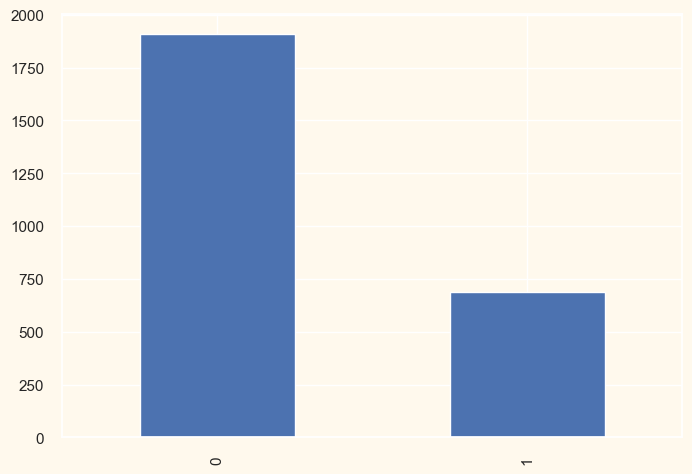

In [136]:
data["Gearbox"].value_counts().plot(kind="bar")

<Axes: xlabel='Gearbox', ylabel='Density'>

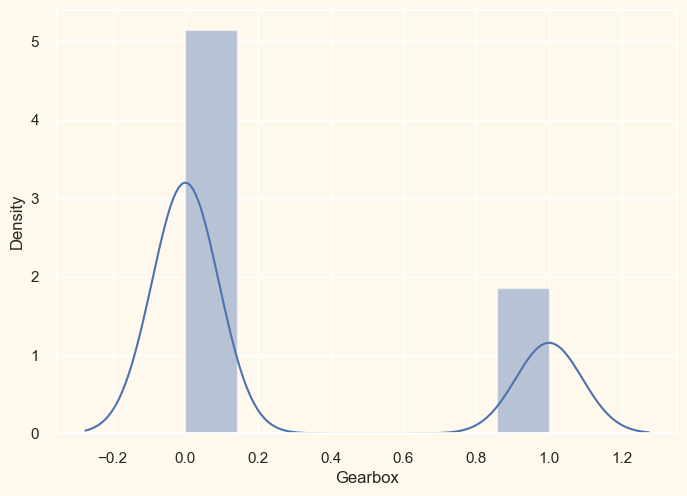

In [137]:
sns.distplot(data['Gearbox'])

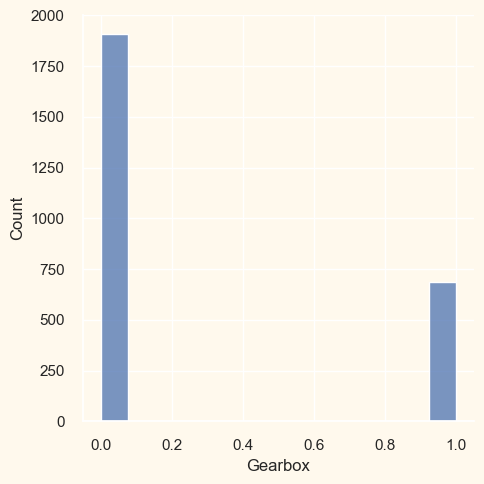

In [138]:
sns.displot(data['Gearbox'])

In [139]:
# Encode the Fuel type variable
le = LabelEncoder()
data["Fuel type"] = le.fit_transform(data["Fuel type"])

# Calculate the percentage of each category
counts = data["Fuel type"].value_counts()
percentages = counts / counts.sum() * 100

# Print the percentages
print("Percentage of each numerical category in Fuel type:")
print(percentages)

Percentage of each numerical category in Fuel type:
5    51.212938
1    28.956488
4    10.127070
2     9.125915
7     0.231036
3     0.192530
0     0.115518
6     0.038506
Name: Fuel type, dtype: float64


<Axes: >

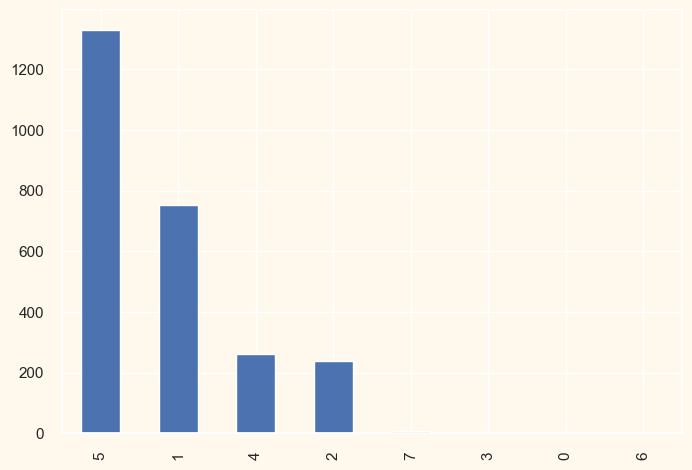

In [140]:
# Plot a bar chart of the counts of each category
data["Fuel type"].value_counts().plot(kind="bar")

<Axes: xlabel='Fuel type', ylabel='Density'>

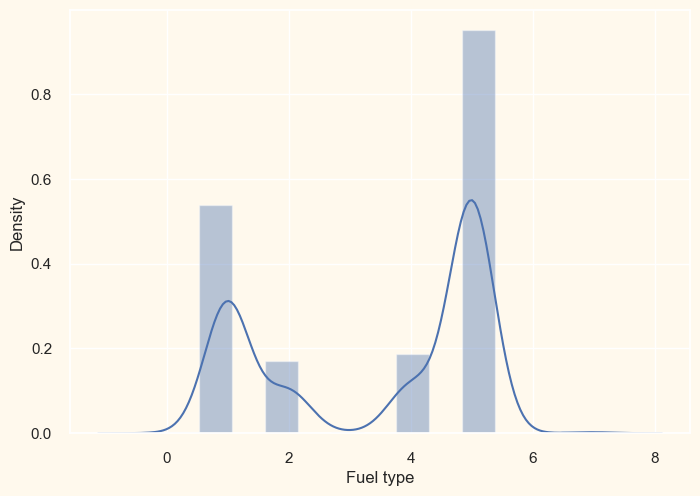

In [141]:
sns.distplot(data['Fuel type'])

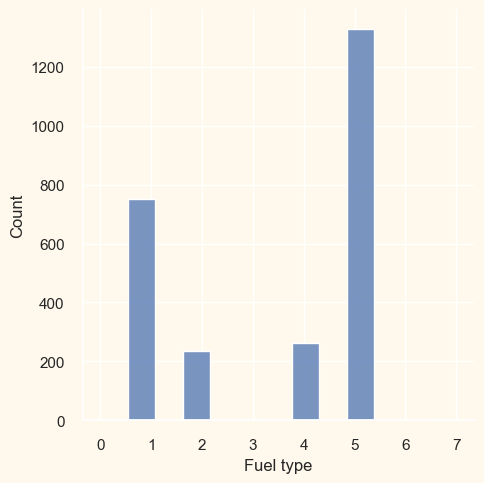

In [142]:
sns.displot(data['Fuel type'])

In [272]:
# Encode the Location variable
le = LabelEncoder()
data["Location"] = le.fit_transform(data["Location"])

# Calculate the percentage of each category
counts = data["Location"].value_counts()
percentages = counts / counts.sum() * 100

# Print the percentages
print("Percentage of each numerical category in Location:")
print(percentages)

Percentage of each numerical category in Location:
85     3.196622
323    2.316043
434    1.700844
221    1.568154
186    1.519903
         ...   
203    0.012063
213    0.012063
753    0.012063
384    0.012063
5      0.012063
Name: Location, Length: 854, dtype: float64


<Axes: >

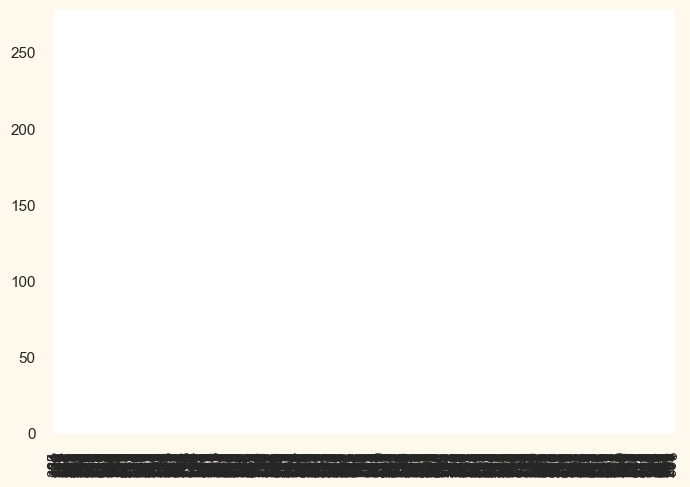

In [273]:
# Plot a bar chart of the counts of each category
data["Location"].value_counts().plot(kind="bar")

<Axes: xlabel='Location', ylabel='Density'>

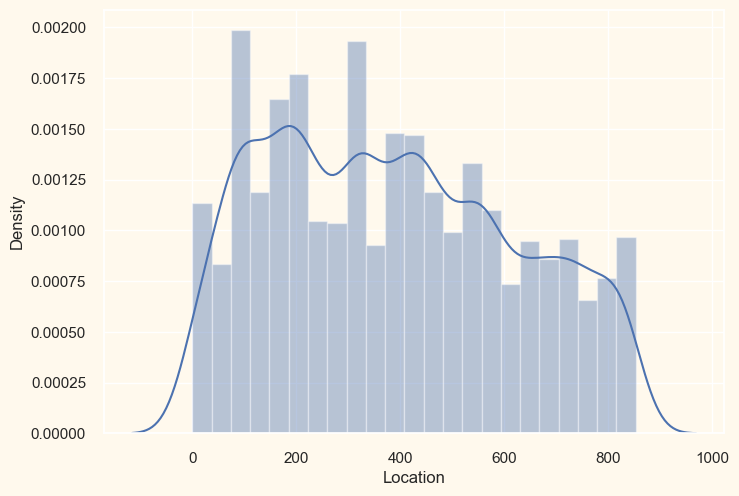

In [274]:
sns.distplot(data['Location'])

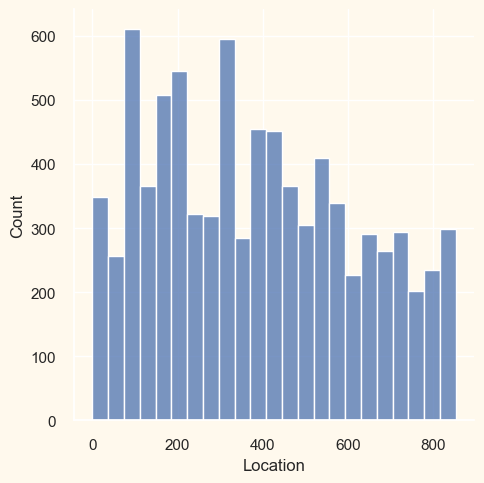

In [275]:
sns.displot(data['Location'])

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">DIMENSIONALITY REDUCTION</p>

In this problem, there are many factors on the basis of which the final classification will be done. These factors are basically attributes or features. The higher the number of features, the harder it is to work with it. Many of these features are correlated, and hence redundant. This is why I will be performing dimensionality reduction on the selected features before putting them through a classifier.
Dimensionality reduction is the process of reducing the number of random variables under consideration, by obtaining a set of principal variables.

Principal component analysis (PCA) is a technique for reducing the dimensionality of such datasets, increasing interpretability but at the same time minimizing information loss.

Steps in this section:

Dimensionality reduction with PCA
Plotting the reduced dataframe
Dimensionality reduction with PCA

For this project, I will be reducing the dimensions to 3.

Principal Component Analysis (PCA) is a technique used for dimensionality reduction and feature extraction in machine learning. PCA can be used to reduce the number of dimensions in a dataset while retaining as much of the original variance as possible. In Python, you can use the PCA class from the scikit-learn library to perform PCA. Here is an example of how to use PCA in Python:

In [283]:
from sklearn.decomposition import PCA
from sklearn.datasets import load_iris
import matplotlib.pyplot as plt

# Load the iris dataset
# https://archive.ics.uci.edu/ml/datasets/iris
iris = load_iris()
X = iris.data
print(X)
y = iris.target
print(y)

[[5.1 3.5 1.4 0.2]
 [4.9 3.  1.4 0.2]
 [4.7 3.2 1.3 0.2]
 [4.6 3.1 1.5 0.2]
 [5.  3.6 1.4 0.2]
 [5.4 3.9 1.7 0.4]
 [4.6 3.4 1.4 0.3]
 [5.  3.4 1.5 0.2]
 [4.4 2.9 1.4 0.2]
 [4.9 3.1 1.5 0.1]
 [5.4 3.7 1.5 0.2]
 [4.8 3.4 1.6 0.2]
 [4.8 3.  1.4 0.1]
 [4.3 3.  1.1 0.1]
 [5.8 4.  1.2 0.2]
 [5.7 4.4 1.5 0.4]
 [5.4 3.9 1.3 0.4]
 [5.1 3.5 1.4 0.3]
 [5.7 3.8 1.7 0.3]
 [5.1 3.8 1.5 0.3]
 [5.4 3.4 1.7 0.2]
 [5.1 3.7 1.5 0.4]
 [4.6 3.6 1.  0.2]
 [5.1 3.3 1.7 0.5]
 [4.8 3.4 1.9 0.2]
 [5.  3.  1.6 0.2]
 [5.  3.4 1.6 0.4]
 [5.2 3.5 1.5 0.2]
 [5.2 3.4 1.4 0.2]
 [4.7 3.2 1.6 0.2]
 [4.8 3.1 1.6 0.2]
 [5.4 3.4 1.5 0.4]
 [5.2 4.1 1.5 0.1]
 [5.5 4.2 1.4 0.2]
 [4.9 3.1 1.5 0.2]
 [5.  3.2 1.2 0.2]
 [5.5 3.5 1.3 0.2]
 [4.9 3.6 1.4 0.1]
 [4.4 3.  1.3 0.2]
 [5.1 3.4 1.5 0.2]
 [5.  3.5 1.3 0.3]
 [4.5 2.3 1.3 0.3]
 [4.4 3.2 1.3 0.2]
 [5.  3.5 1.6 0.6]
 [5.1 3.8 1.9 0.4]
 [4.8 3.  1.4 0.3]
 [5.1 3.8 1.6 0.2]
 [4.6 3.2 1.4 0.2]
 [5.3 3.7 1.5 0.2]
 [5.  3.3 1.4 0.2]
 [7.  3.2 4.7 1.4]
 [6.4 3.2 4.5 1.5]
 [6.9 3.1 4.

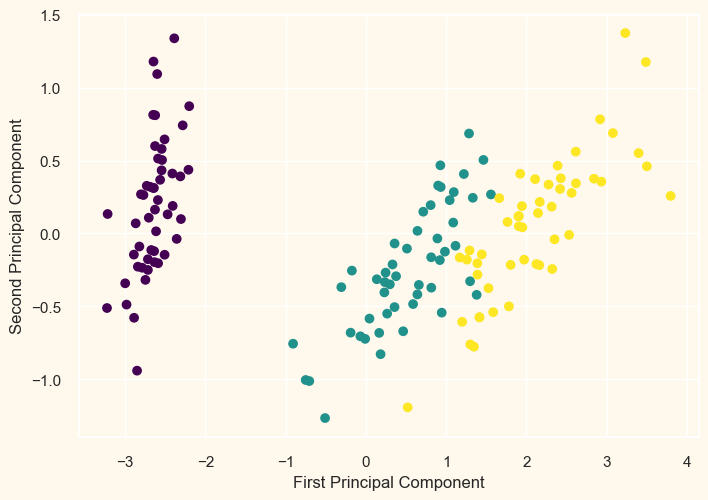

In [284]:
# Perform PCA on the dataset
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Plot the results
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='viridis')
plt.xlabel('First Principal Component')
plt.ylabel('Second Principal Component')
plt.show()

In [285]:
#Initiating PCA to reduce dimentions aka features to 3
pca = PCA(n_components=3)
pca.fit(scaled_ds)
PCA_ds = pd.DataFrame(pca.transform(scaled_ds), columns=(["col1","col2", "col3"]))
PCA_ds.describe().T

,count,mean,std,min,25%,50%,75%,max
col1,8290.0,-2.399903e-17,1.887451,-5.352182,-1.314548,-0.243751,1.259597,5.941562
col2,8290.0,-3.685565e-17,1.476684,-3.474926,-1.027135,-0.123702,0.997383,5.758311
col3,8290.0,1.339232e-18,1.150871,-3.878935,-0.675407,-0.031670,0.790734,4.398435


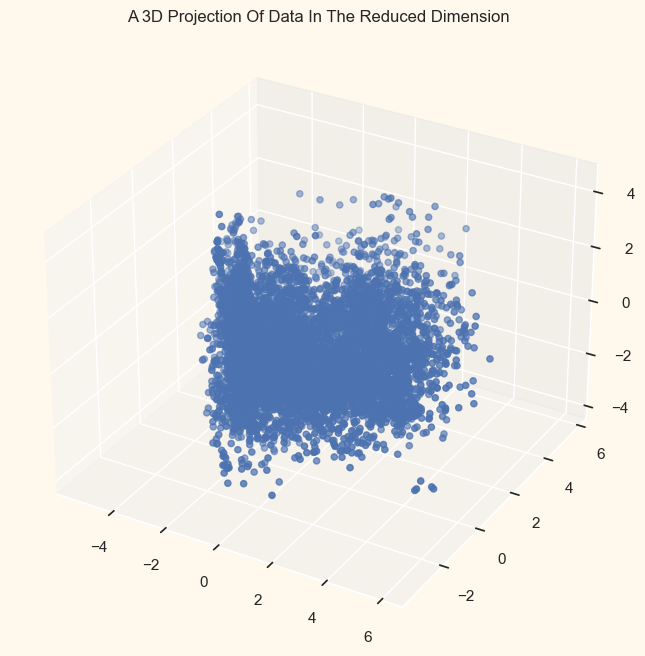

In [286]:
#A 3D Projection Of Data In The Reduced Dimension
x =PCA_ds["col1"]
y =PCA_ds["col2"]
z =PCA_ds["col3"]
#To plot
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(111, projection="3d")
ax.scatter(x,y,z, marker="o" )
ax.set_title("A 3D Projection Of Data In The Reduced Dimension")
plt.show()

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">CLUSTERING</p>

After reducing the attributes to three dimensions, I will perform clustering using a method called Agglomerative clustering. This method merges examples together until the desired number of clusters is reached.

Here are the steps involved in the clustering process:

Elbow Method: To determine the number of clusters, we use the elbow method. It plots the within-cluster sum of squares (WCSS) against the number of clusters and looks for a point where the rate of decrease in WCSS slows down, forming an "elbow" shape.

Clustering: We apply Agglomerative Clustering, which is a hierarchical clustering technique, to group the data into clusters based on similarity.

Examining the Clusters: We visualize the clusters formed using a scatter plot, which helps us understand the patterns and relationships between the data points within each cluster.

The elbow method helps us decide the optimal number of clusters by identifying the point on the plot where the decrease in WCSS levels off. However, it's important to note that the elbow method may not always provide a clear elbow point. In such cases, alternative methods like the silhouette method or gap statistic can be used to determine the optimal number of clusters.








In [287]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Generate random data
X = np.random.rand(100, 2)
X

array([[0.34080354, 0.93075733],
       [0.85841275, 0.42899403],
       [0.75087107, 0.75454287],
       [0.10312387, 0.90255291],
       [0.50525237, 0.82645747],
       [0.3200496 , 0.89552323],
       [0.38920168, 0.01083765],
       [0.90538198, 0.09128668],
       [0.31931364, 0.95006197],
       [0.95060715, 0.57343789],
       [0.63183721, 0.44844552],
       [0.29321077, 0.32866455],
       [0.67251846, 0.75237453],
       [0.79157904, 0.78961814],
       [0.0912061 , 0.4944203 ],
       [0.05755876, 0.54952888],
       [0.4415305 , 0.88770418],
       [0.35091501, 0.11706702],
       [0.14299168, 0.76151063],
       [0.61821806, 0.10112268],
       [0.08410681, 0.70096913],
       [0.07276301, 0.82186006],
       [0.70624223, 0.08134878],
       [0.08483771, 0.98663958],
       [0.3742708 , 0.37064215],
       [0.81279957, 0.94724858],
       [0.98600106, 0.75337819],
       [0.37625959, 0.08350072],
       [0.77714692, 0.55840425],
       [0.42422201, 0.90635439],
       [0.

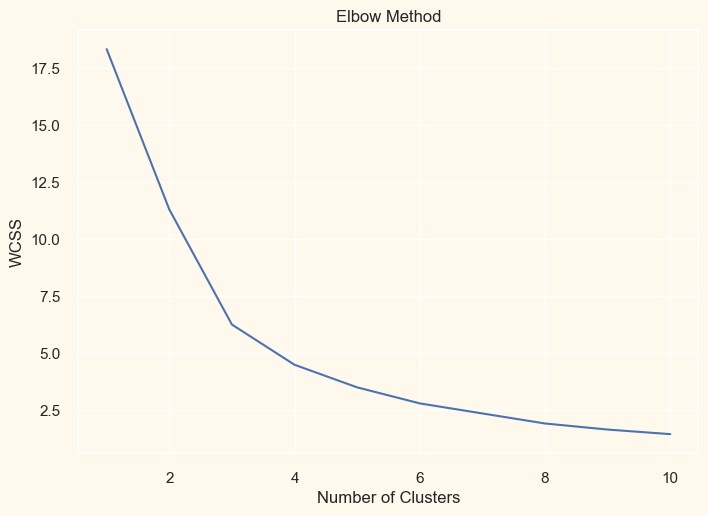

In [288]:
# Create a list to store WCSS values for each k
wcss = []

# Iterate over a range of k values
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)

# Plot the elbow curve
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

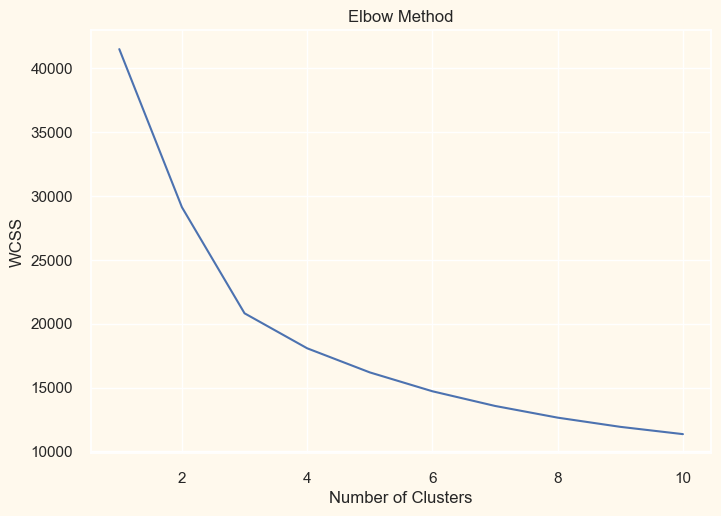

In [289]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Load data into a dataframe
df = pd.read_csv('C:/Users/Ivan/Desktop/Hey.car/ALL/6.analysis.csv')

# Extract the columns that you want to use for clustering
X = df[['Age(years)', 'Power(hp)', 'Mileage(km)', 'Fuel consumption (l/100km - comb.)', 'CO2 emissions (g CO2/km - comb.)']]

# Scale the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(X)

# Create a list to store WCSS values for each k
wcss = []

# Iterate over a range of k values
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(scaled_data)
    wcss.append(kmeans.inertia_)

# Plot the elbow curve
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

From the plot, it appears that the elbow point is around 3 clusters. 
Therefore, it can be concluded that the optimal number of clusters in this example is 3. However, the elbow method is not always definitive and may not always yield a clear elbow point, so it should also consider other methods for determining the optimal number of clusters.

Elbow Method to determine the number of clusters to be formed:


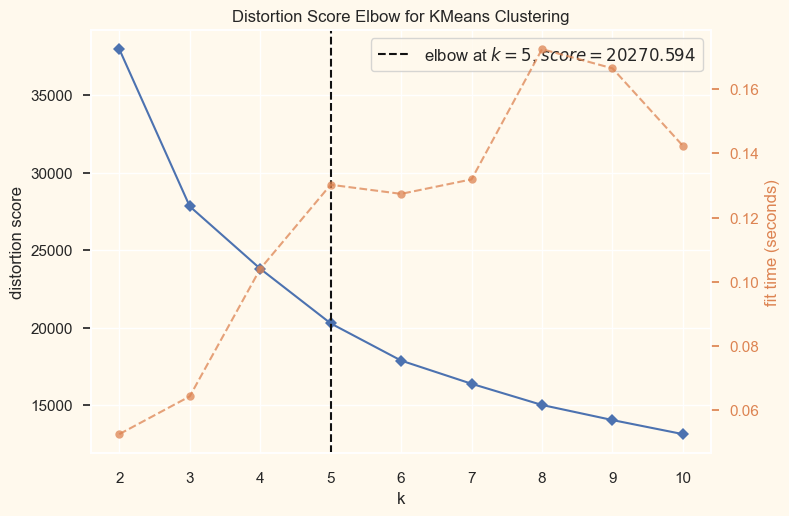

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [290]:
# Quick examination of elbow method to find numbers of clusters to make.
print('Elbow Method to determine the number of clusters to be formed:')
Elbow_M = KElbowVisualizer(KMeans(), k=10)
Elbow_M.fit(PCA_ds)
Elbow_M.show()

The above cell indicates that 5 will be an optimal number of clusters for this data. Next is fitting the Agglomerative Clustering Model to get the final clusters.

In [291]:
#Initiating the Agglomerative Clustering model 
AC = AgglomerativeClustering(n_clusters=5)
# fit model and predict clusters
yhat_AC = AC.fit_predict(PCA_ds)
PCA_ds["Clusters"] = yhat_AC
#Adding the Clusters feature to the orignal dataframe.
data["Clusters"]= yhat_AC

In [292]:
data

,Model,Edition,Year of production,Age(years),Power(hp),Fuel type,Gearbox,Mileage(km),Fuel consumption (l/100km - comb.),CO2 emissions (g CO2/km - comb.),Price(€),Location,Old_in_days,Clusters
0,50,1720,2019-05-01,4,86,2,1,12747,5.0,114,11530,212,126230400000000000,0
1,68,1631,2021-01-01,2,67,2,1,3620,4.5,104,14998,839,73440000000000000,1
2,82,888,2017-10-01,6,98,2,1,11270,6.7,154,8950,559,176083200000000000,0
3,199,1566,2020-02-01,3,116,2,1,5000,4.9,113,19990,775,102384000000000000,0
4,169,729,2019-03-01,4,60,2,1,28500,4.1,96,10880,429,131500800000000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8285,130,788,2019-06-01,4,69,2,1,18889,5.6,148,12740,176,123552000000000000,0
8286,197,1452,2022-09-01,1,150,1,0,9309,3.8,101,31998,501,20908800000000000,3
8287,210,3115,2019-05-01,4,60,2,1,25990,4.2,95,11990,124,126230400000000000,0
8288,151,464,2022-09-01,1,91,2,1,8061,5.1,117,17990,85,20908800000000000,1


Examining the clusters formed with the 3-D distribution of the clusters.

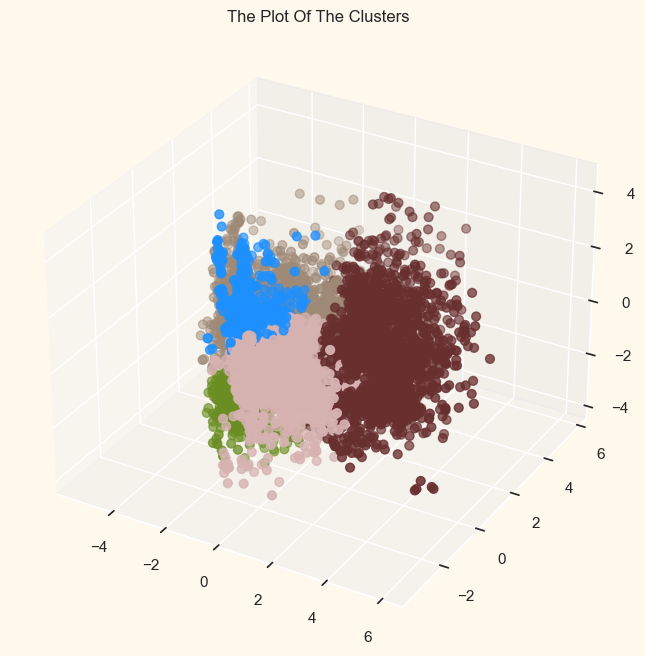

In [293]:
#Plotting the clusters
fig = plt.figure(figsize=(10,8))
ax = plt.subplot(111, projection='3d', label="bla")
ax.scatter(x, y, z, s=40, c=PCA_ds["Clusters"], marker='o', cmap = cmap )
ax.set_title("The Plot Of The Clusters")
plt.show()

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">EVALUATING MODELS</p>

Since this is an unsupervised clustering task, there is no a labeled feature to evaluate or score this model. The goal of this section is to examine the patterns within the clusters and understand their nature.

To achieve this performing exploratory data analysis on the clustered data and draw conclusions from it is necessary.

First, it will take to examine the distribution of data points within each cluster to understand how they are grouped together.

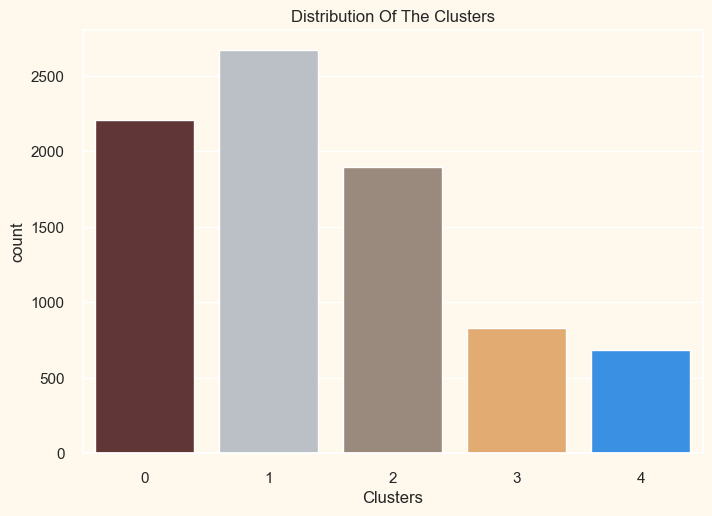

In [294]:
#Plotting countplot of clusters
pal = ["#682F2F","#B9C0C9", "#9F8A78","#F3AB60", "#1E90FF"]
pl = sns.countplot(x=data["Clusters"], palette= pal)
pl.set_title("Distribution Of The Clusters")
plt.show()

The clusters seem to be fairly distributed.

In [295]:
# Calculate the percentage of each cluster
counts = data["Clusters"].value_counts()
percentages = counts / counts.sum() * 100

# Print the percentages
print("Percentage of each cluster:")
print(percentages)

Percentage of each cluster:
1    32.219542
0    26.634499
2    22.870929
3    10.048251
4     8.226779
Name: Clusters, dtype: float64


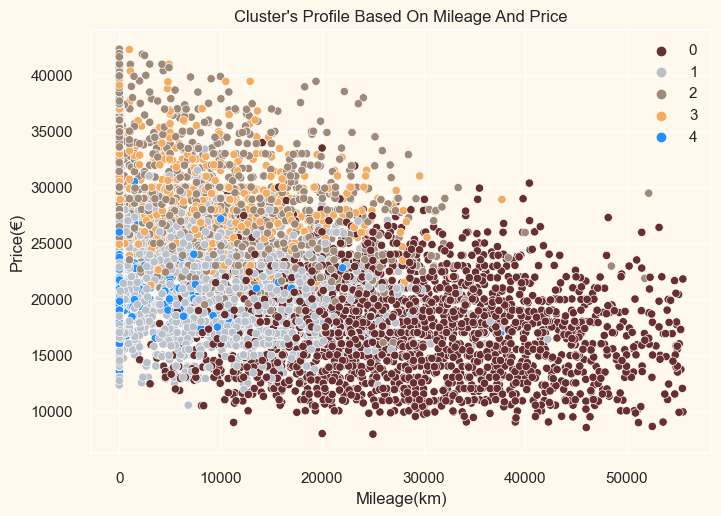

In [296]:
pl = sns.scatterplot(data = data,x=data["Mileage(km)"], y=data["Price(€)"],hue=data["Clusters"], palette= pal)
pl.set_title("Cluster's Profile Based On Mileage And Price")
plt.legend()
plt.show()

**Mileage vs  Price plot shows the clusters pattern**
* group 0: low to average price &  high milleage
* group 1: low to average price & low milleage
* group 2: high price & low milleage 
* group 3: high price & low milleage
* group 4: average price & low milleage


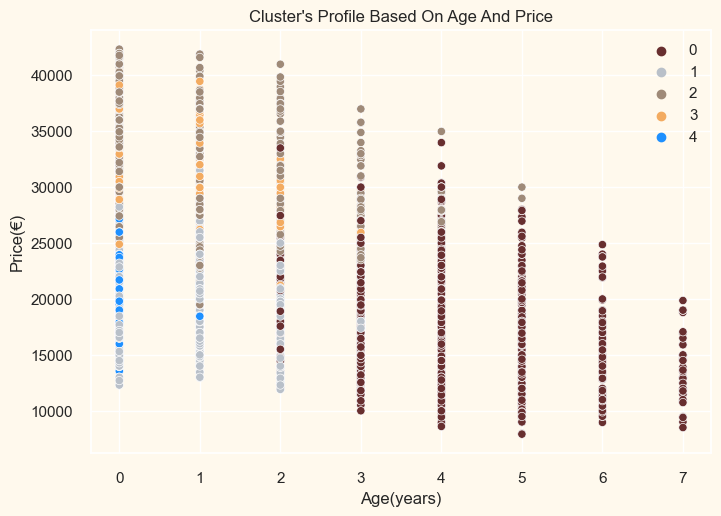

In [297]:
pl = sns.scatterplot(data = data,x=data["Age(years)"], y=data["Price(€)"],hue=data["Clusters"], palette= pal)
pl.set_title("Cluster's Profile Based On Age And Price")
plt.legend()
plt.show()

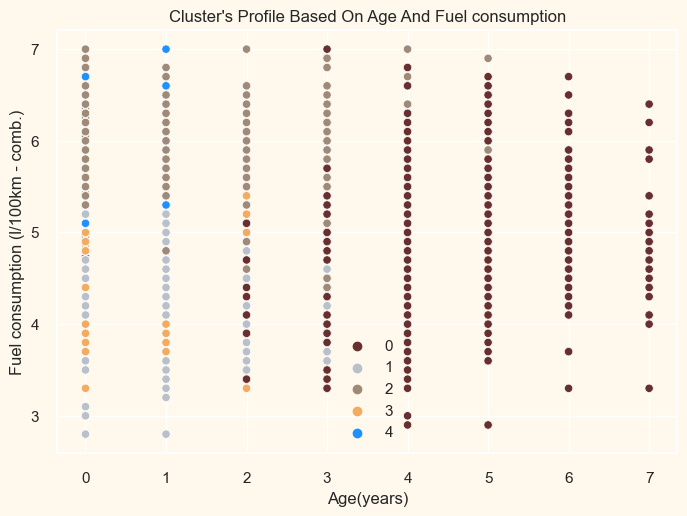

In [299]:
pl = sns.scatterplot(data = data,x=data["Age(years)"], y=data["Fuel consumption (l/100km - comb.)"],hue=data["Clusters"], palette= pal)
pl.set_title("Cluster's Profile Based On Age And Fuel consumption")
plt.legend()
plt.show()

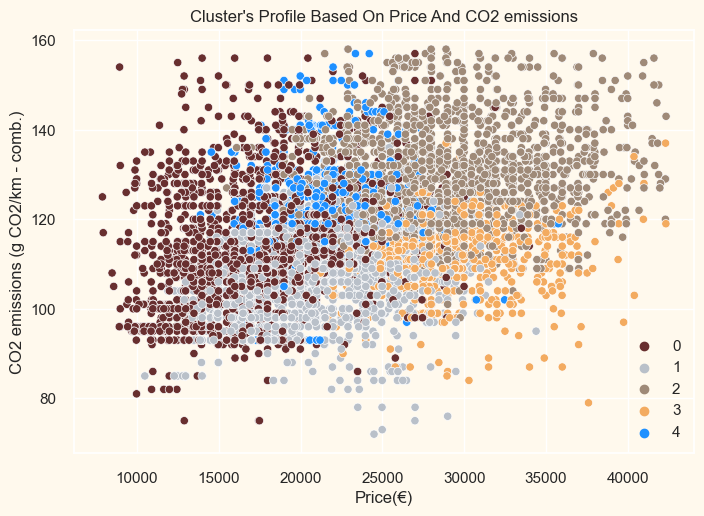

In [300]:
pl = sns.scatterplot(data = data,x=data["Price(€)"], y=data["CO2 emissions (g CO2/km - comb.)"],hue=data["Clusters"], palette= pal)
pl.set_title("Cluster's Profile Based On Price And CO2 emissions")
plt.legend()
plt.show()

**Price vs  CO2 emissions shows the clusters pattern**
* group 0: low price & average to high CO2 emissions
* group 1: average price & low CO2 emissions
* group 2: high price & high CO2 emissions 
* group 3: high price & low CO2 emissions 
* group 4: average price & high CO2 emissions


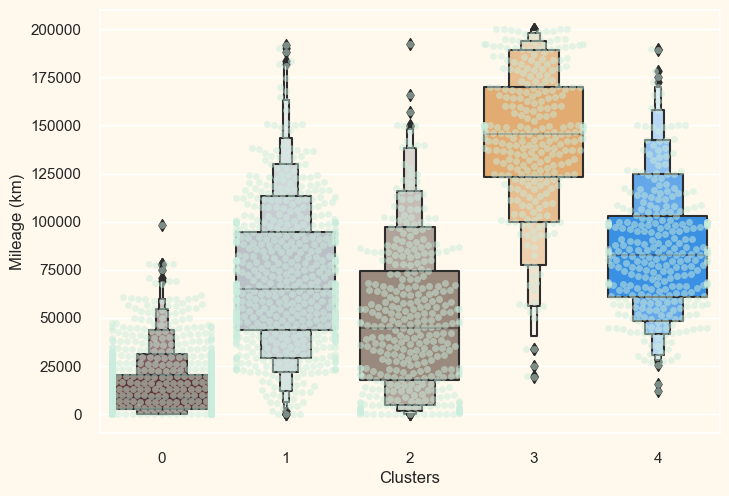

In [47]:
plt.figure()
pl=sns.swarmplot(x=data["Clusters"], y=data["Mileage(km)"], color= "#CBEDDD", alpha=0.5 )
pl=sns.boxenplot(x=data["Clusters"], y=data["Mileage(km)"], palette=pal)
plt.show()

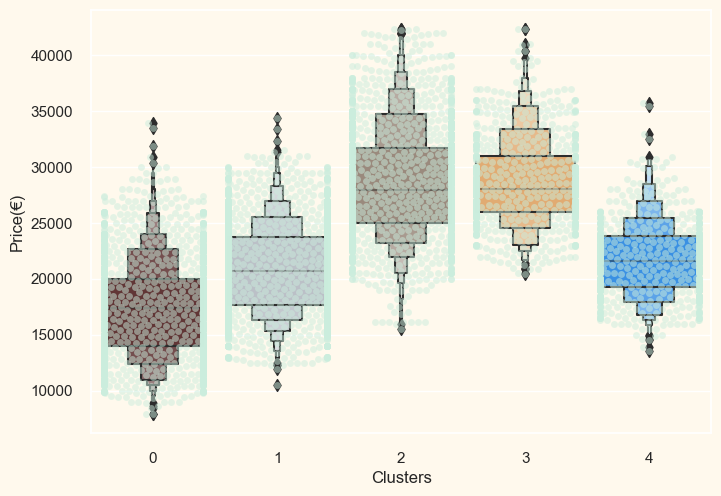

In [301]:
plt.figure()
pl=sns.swarmplot(x=data["Clusters"], y=data["Price(€)"], color= "#CBEDDD", alpha=0.5 )
pl=sns.boxenplot(x=data["Clusters"], y=data["Price(€)"], palette=pal)
plt.show()

From the above plot, it can be seen that cluster 2 is biggest set of automobiles closely followed by cluster 0.

<Figure size 800x550 with 0 Axes>

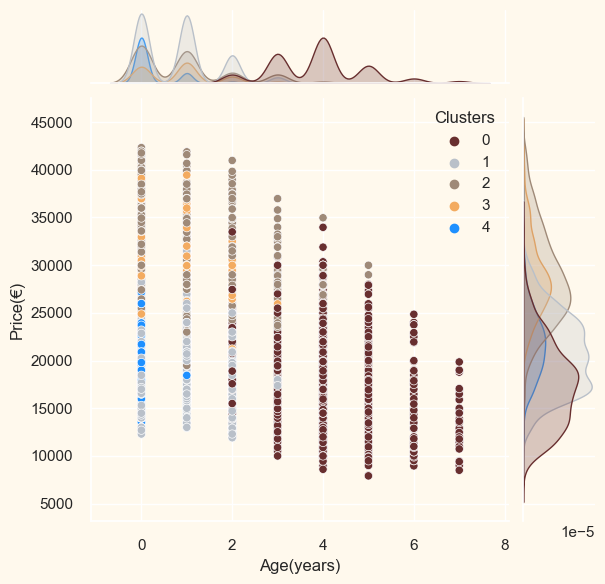

<Figure size 800x550 with 0 Axes>

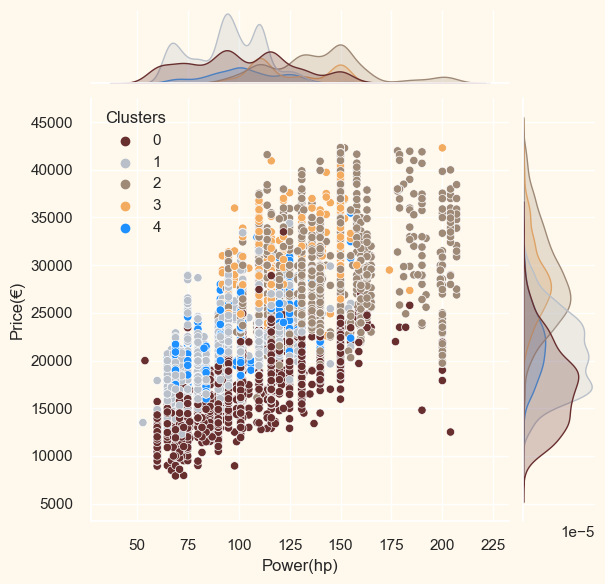

<Figure size 800x550 with 0 Axes>

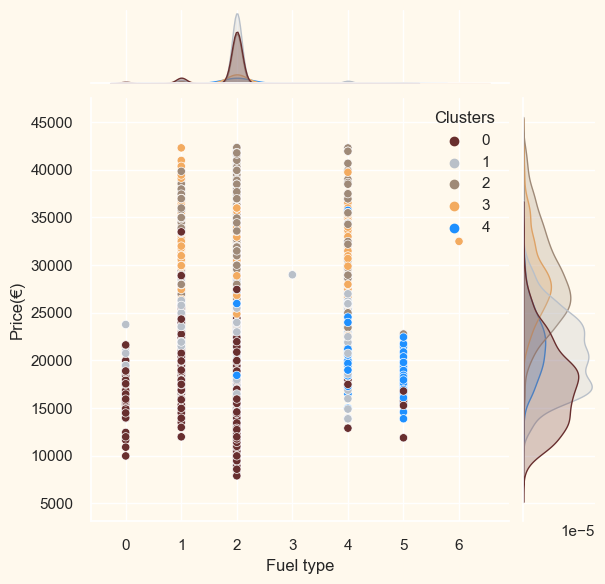

<Figure size 800x550 with 0 Axes>

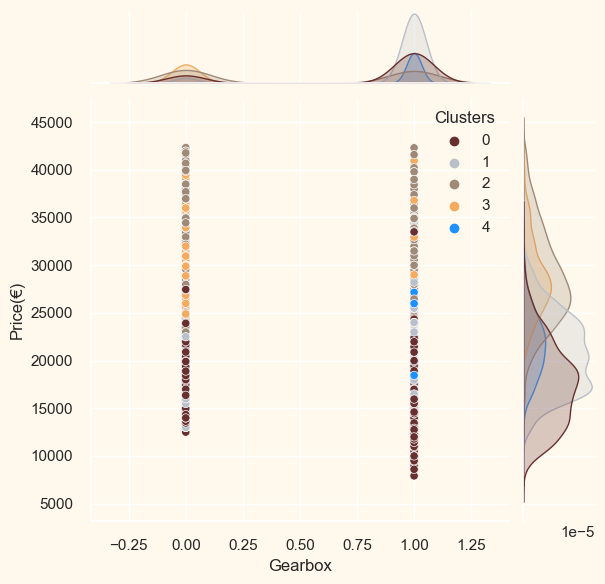

<Figure size 800x550 with 0 Axes>

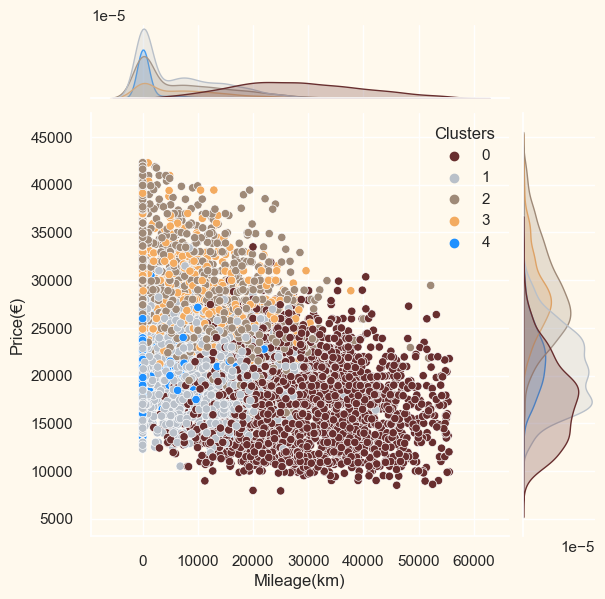

<Figure size 800x550 with 0 Axes>

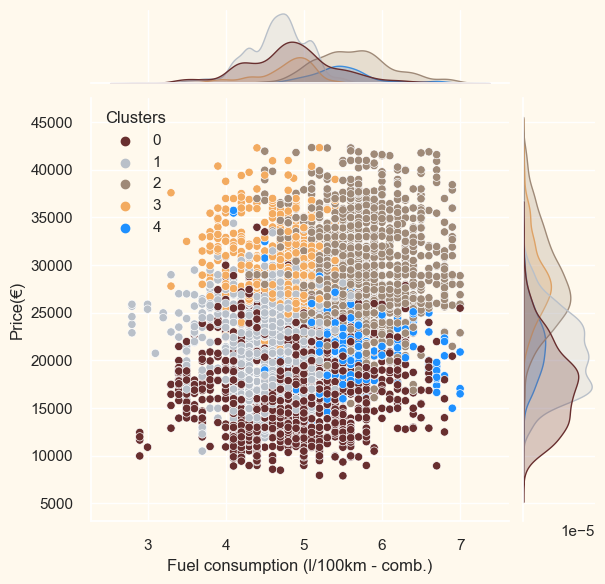

<Figure size 800x550 with 0 Axes>

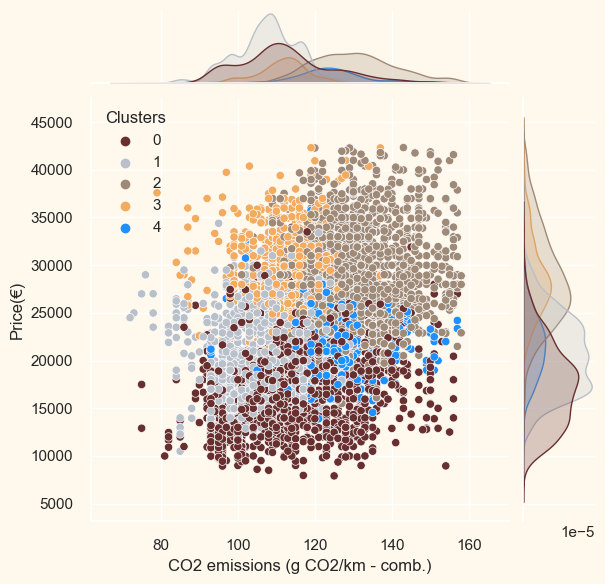

<Figure size 800x550 with 0 Axes>

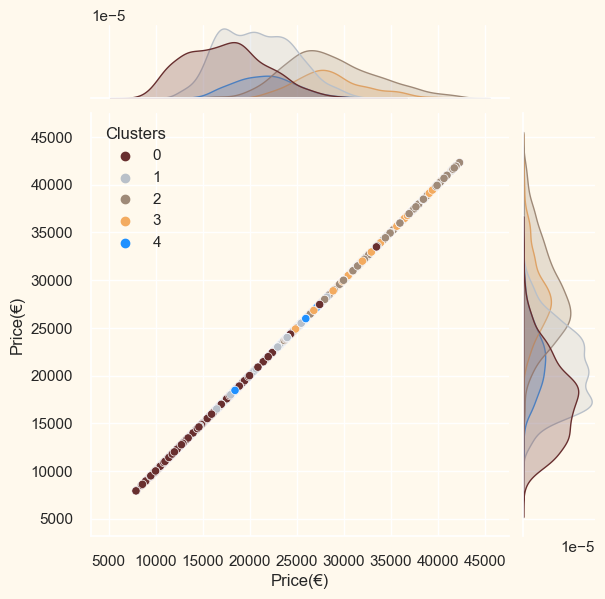

In [303]:
#for more details on the car features 
Features =["Age(years)", "Power(hp)", "Fuel type", "Gearbox",  "Mileage(km)", "Fuel consumption (l/100km - comb.)", "CO2 emissions (g CO2/km - comb.)", "Price(€)"] 

for i in Features:
    plt.figure()
    sns.jointplot(x=data[i],y = data["Price(€)"],hue=data["Clusters"], palette= pal)
    plt.show()

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">PROFILING</p>

Profiling the clusters formed and come to a conclusion about each of them

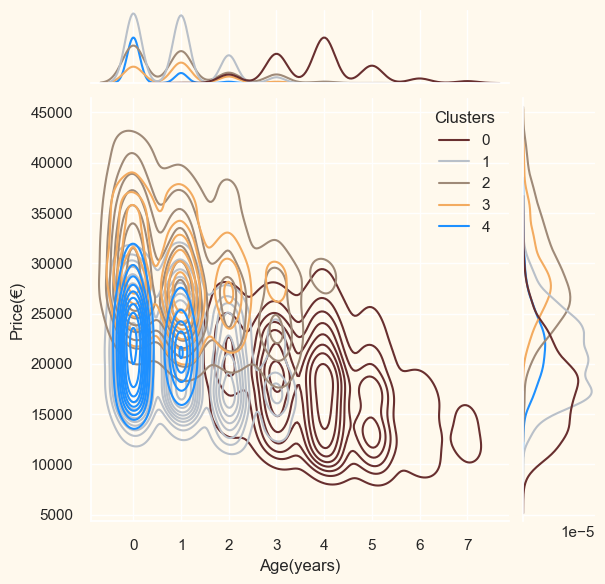

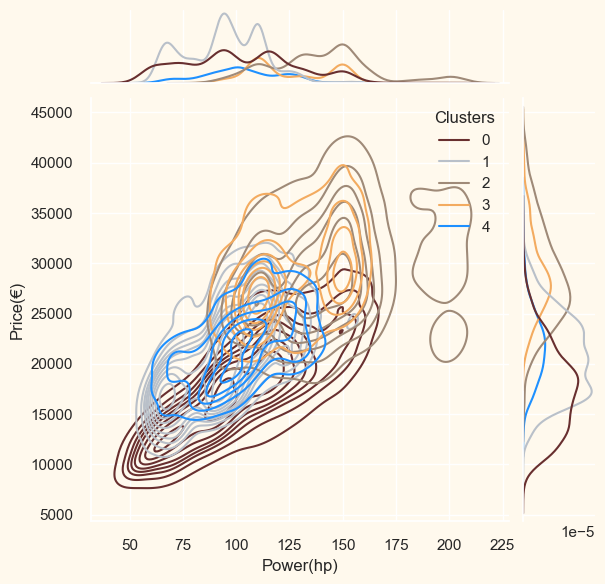

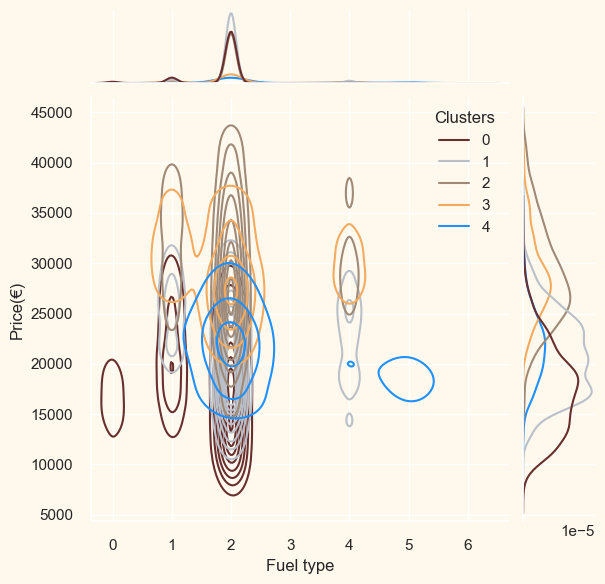

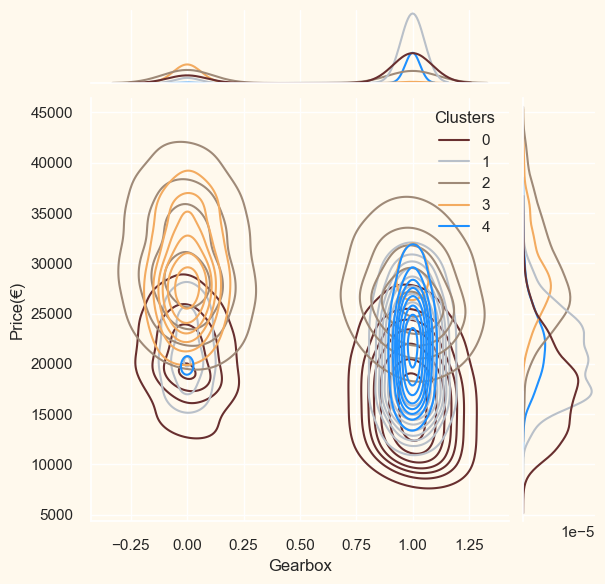

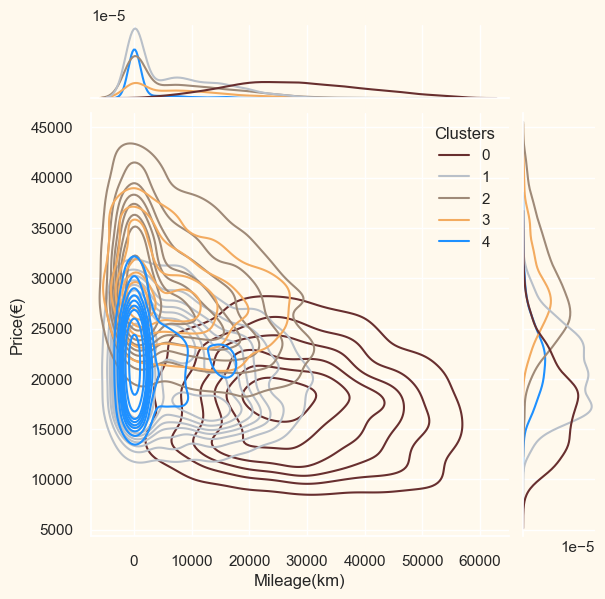

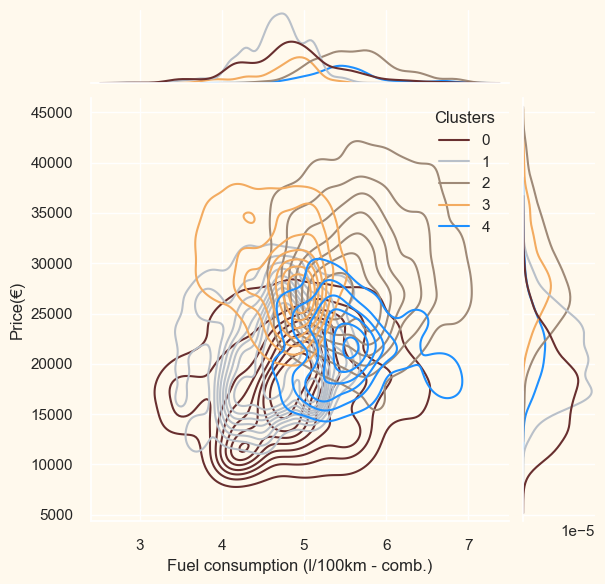

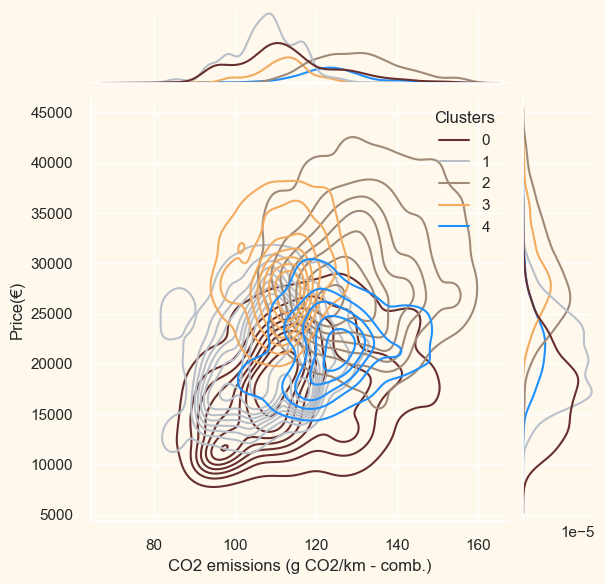

In [305]:
Variables = ["Age(years)", "Power(hp)", "Fuel type", "Gearbox",  "Mileage(km)", "Fuel consumption (l/100km - comb.)", "CO2 emissions (g CO2/km - comb.)"]

for i in Variables:
    sns.jointplot(x=data[i], y=data["Price(€)"], hue=data["Clusters"], kind="kde", palette=pal)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">CONCLUSION</p>

**Points to be noted:**

The following information can be deduced about the different clusters.

## About Cluster Number 0:
- Age is medium to high
- Power in this group is mostly low to medium, but in a smaller part it goes towards high
- Fuel type is mostly gasoline and diesel, but some CNG as well
- Gearbox is mostly manual with smaller share of automatic
- Mileage is scattered around the central part with a tendency towards high
- Fuel consumption is evenly distributed as well as CO2 emissions
- Price is definitely in bottom half


## About Cluster Number 1: 
- Age of the cars is mostly new with tendency to medium
- Power is low to medium
- Fuel type apart from diesel and gasoline is hybrid gasoline as well
- Gearbox is mostly manual with smaller share of automatic
- Mileage is low to medium
- Fuel consumption is scattered around the central part as well as CO2 emissions
- Price is low to medium

## About Cluster Number 2: 
- Age of the cars is mostly new with tendency to medium
- Power is definitely high
- Fuel type is mostly gasoline
- Gearbox is mostly automatic but there are manuals as well
- Mileage is distributed low to medium
- Fuel consumption is high as well as CO2 emissions
- Price starts from medium, but high is more prevalent

## About Cluster Number 3: 
- Age of the cars is mostly new with tendency to medium
- Power is grouped in central part of distribution with tendency to high
- Fuel type apart from diesel and gasoline is hybrid gasoline as well
- Gearbox is automatic
- Mileage is low
- Fuel consumption is low
- CO2 emissions starts at low but have tendency to medium
- Price is high

## About Cluster Number 4: 
- Age is low, it's a new cars, few years old at most 
- Power is distributed from low with strong tendency to the medium
- Fuel type is gasoline and LPG
- Gearbox is automatic
- Mileage is very low
- Fuel consumption is distributed mostly in high area
- CO2 emissions are mostly grouped at medium but have tendency to high
- Price is low to medium


The price of the car in euros and its power in are positively correlated in all clusters.


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">DATA ANALYTICS TASK</p>

• First I imported the libraries needed for data analytics.

• At the beginning, I imported the data and tried to explore and understand the data to get meaningful insights. 

• In the first part, I analyze quantitative numerical variables without deleting outliers so that I could compare
these early results with latter results from second part where outliers were removed. And to notice the difference 
myself between the results where outliers were not removed and the results where they were removed.

• I used correlation matrix of a dataset to determine how each variable in the dataset is related to every other variable. 
E.g. in my autoscout24 dataset price and power are positively correlated, while price and mileage are negatively correlated.

• With pairplot I visualized the relationships between numerical variables. With histogram, I explored the shape of data 
and the frequency of individual variables. Both showed outliers.

• At the end of the first part boxplots graphically displayed where the outliers are, and I also execute code to calculate outliers mathematically.

• In the second part, I first removed outliers and save the filtered dana for further analysis. Then I performed identical analysis
to visualize and compare how much the data set has changed.  Which rows has been removed as outliers is visible in JN file. 

• After removing extreme values variables now appear more tightly clustered around a central tendency and remaining data points 
are more similar to each other. Histograms shows data more evenly distributed.  Saved df into csv file autoscout24.filtered.csv 
(Number of rows: 2597).

• In the last part, I mostly relied on the example we worked on in the class. Based on what we did, I applied it to my dataset to get a
better insight and apply in practice what we did in class. For this part, I saved the data set as analysis.csv.

• Given that I cleaned the data and removed outliers in the previous steps, I did not deal with it much. For this reason, instead of data
cleaning, I called it data screening, what I did in this step was once again the verification of the data I have.

• For the rest, I followed the instructions from class, doing mostly the same analysis adapted to my data set. 
After converting the categorical variables into numerical ones, I made an short exploration of the converted data.

• Based on the example we did in class, I did almost all the steps, with some things differ in my case and some
steps not be applicable at all, but also there are some additional steps that I done with my data. 
